# Pregunta 1 


El problema analizado en esta pregunta es sobre el operador XOR. 

## Pregunta a)

Lo primero será compilar el código mostrado en la parte $a)$ con la cual se crearán 1000 datos de entrenamiento y 1000 datos de pruebas:

In [2]:
import numpy as np
from matplotlib import pyplot as plt
from sklearn import svm
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier as Tree
%matplotlib inline

def do_XOR(n=1000,noisy_n=100,svm=True):
  rng = np.random.RandomState(0)
  X_train = rng.uniform(low=-1.0,high=1.0,size=(n,2))
  Y_train = np.logical_xor(X_train[:,0] > 0, X_train[:,1] > 0)
  Y_train = 2*Y_train-1 if svm else Y_train
  X_noisy= rng.uniform(low=-0.8,high=0.2,size=(noisy_n,2)) #Ruido de sobreajuste
  Y_noisy = -1*np.logical_xor(X_noisy[:,0] > 0, X_noisy[:,1] > 0) + 1 #
  Y_noisy = 2*Y_noisy-1 if svm else Y_noisy
  X_train = np.vstack((X_train, X_noisy))
  Y_train = np.hstack((Y_train, Y_noisy))
  X_test = rng.uniform(low=-1.0,high=1.0,size=(n,2))
  Y_test = np.logical_xor(X_test[:,0] > 0, X_test[:,1] > 0)
  Y_test = 2*Y_test - 1 if svm else Y_test
  return X_train,Y_train,X_test,Y_test

X_train,Y_train,X_test,Y_test = do_XOR()



Para los datos de entrenamiento es importante considerar que se están agregando los 100 datos de ruido correspondientes al sobreajuste (10% de los datos totales de entrenamiento originales).
El gráfico que se forma es en base al siguiente código:

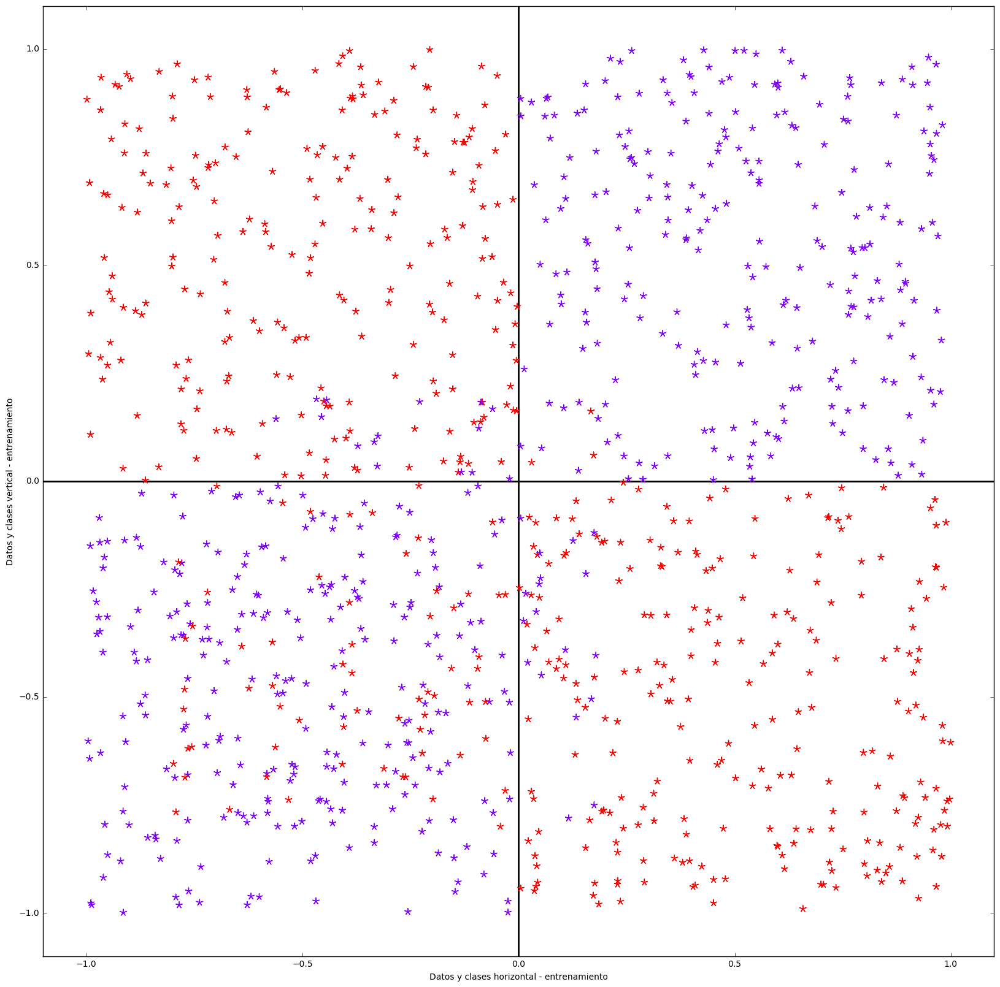

In [2]:
#Gráfico datos entrenamiento
f, axis = plt.subplots(1, 1, sharex='col', sharey='row',figsize=(20, 20))
entrenamiento = axis.scatter(X_train[:,0],X_train[:,1],s=60,c=Y_train,zorder=10, marker=(5,2), cmap='rainbow')
plt.axhline(y=0, xmin=-1, xmax=1, linewidth=2, color = 'k')
plt.axvline(x=0, ymin=-1, ymax = 1, linewidth=2, color = 'k')
plt.xlabel('Datos y clases horizontal - entrenamiento')
plt.ylabel('Datos y clases vertical - entrenamiento')
plt.axis([-1.1, 1.1, -1.1, 1.1])
plt.show()

Aqui se puede ver que varios valores "rojos" toman parte del cuadrante 3, recordar que estos datos provienen de los 100 datos de ruido.

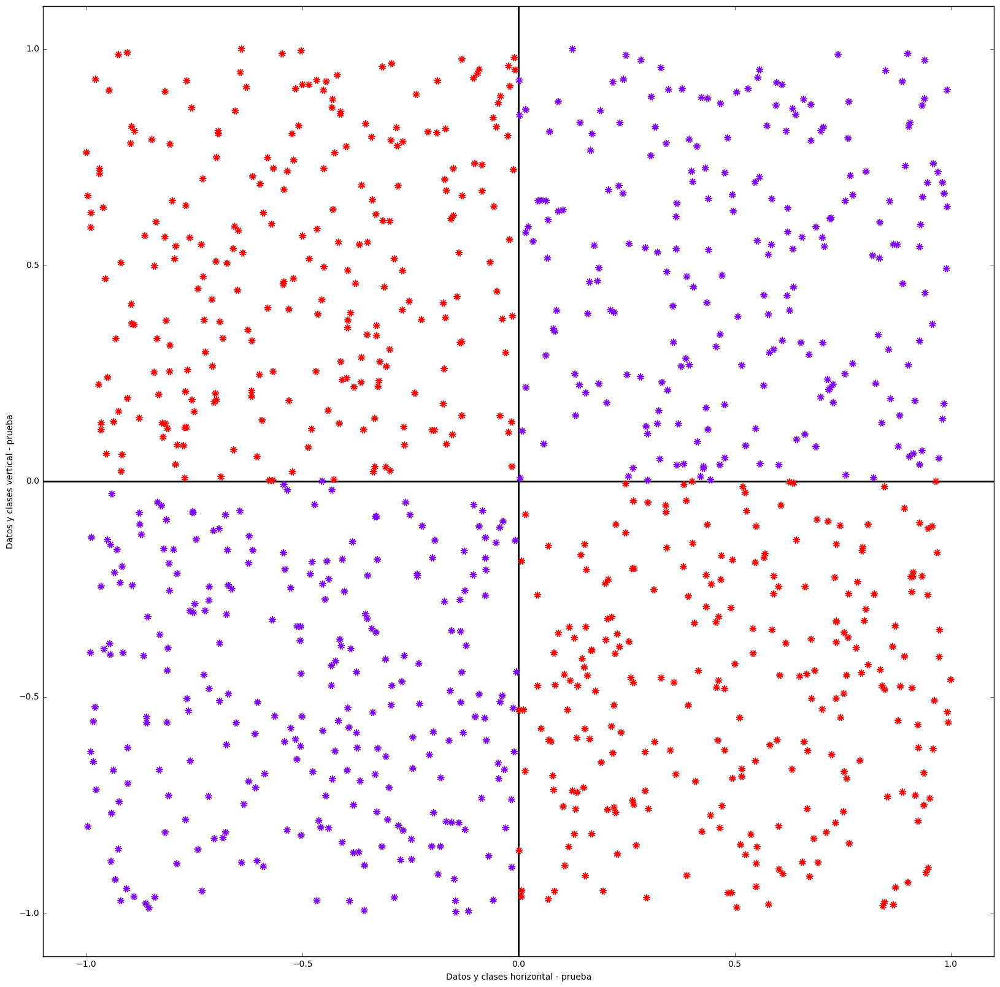

In [3]:
#Gráfico datos prueba
f, axis = plt.subplots(1, 1, sharex='col', sharey='row',figsize=(20, 20))
prueba = axis.scatter(X_test[:,0],X_test[:,1],s=60,c=Y_test,zorder=10, marker=(9,2), cmap='rainbow')
plt.axhline(y=0, xmin=-1, xmax=1, linewidth=2, color = 'k')
plt.axvline(x=0, ymin=-1, ymax = 1, linewidth=2, color = 'k')
plt.xlabel('Datos y clases horizontal - prueba')
plt.ylabel('Datos y clases vertical - prueba')
plt.axis([-1.1, 1.1, -1.1, 1.1])
plt.show()

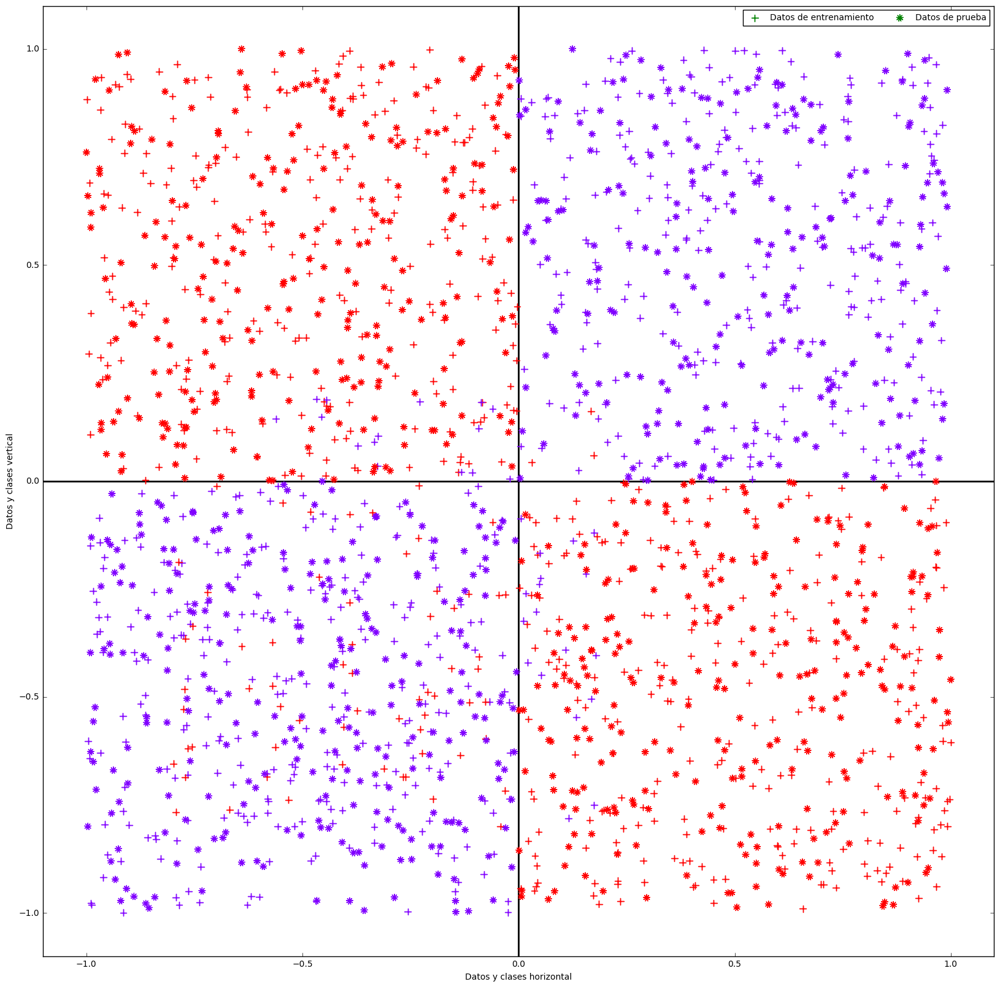

In [4]:
#Combinación datos de entrenamiento y de prueba
f, axis = plt.subplots(1, 1, sharex='col', sharey='row',figsize=(20, 20))
entrenamiento = axis.scatter(X_train[:,0],X_train[:,1],s=60,c=Y_train,zorder=10, marker=(4,2), cmap='rainbow')
prueba = axis.scatter(X_test[:,0],X_test[:,1],s=60,c=Y_test,zorder=10, marker=(9,2), cmap='rainbow')

plt.legend((entrenamiento,prueba),
           ('Datos de entrenamiento', 'Datos de prueba'),
           scatterpoints=1,
           loc='upper right',
           ncol=3,
           fontsize=10)

ax = plt.gca()
leg = ax.get_legend()
leg.legendHandles[0].set_color('green')
leg.legendHandles[1].set_color('green')


plt.axhline(y=0, xmin=-1, xmax=1, linewidth=2, color = 'k')
plt.axvline(x=0, ymin=-1, ymax = 1, linewidth=2, color = 'k')
plt.xlabel('Datos y clases horizontal')
plt.ylabel('Datos y clases vertical')
plt.axis([-1.1, 1.1, -1.1, 1.1])
plt.show()

Se pueden apreciar claramente 2 clases en estos gráficos, la clase de los "-1" ubicados en los cuadrantes 1 y 3, y la clase de los "1" ubicada en los cuadrantes 2 y 4. Conceptualmente se puede entender así:

|        Gráfico        | Eje horizontal negativo | Eje horizontal positivo |
|:---------------------:|:-----------------------:|:-----------------------:|
| Eje vertical positivo |         +,- = 1         |         +,+ = -1        |
| Eje vertical negativo |         -,- = -1        |         +,- = 1         |

Por consiguiente, el problema se denomina XOR ya que para 2 atributos se puede encontrar un OR exclusivo, significa que se cumplirá la condición (valor igual a 1 o verdadero si se aplica la lógica) si solo uno de los atributos posee el valor de 1, en caso contrario la condición será imcumplida (valor igual a -1 o falso si se mira desde el punto de vista de la lógica).

## Pregunta b)

Aquí se solicita demostrar que una SVM lineal no es capaz de resolver el problema. Primero que todo, se adjunta la función $plot$_$classifier$ que representa gráficamente la solución encontrada por la máquina de aprendizaje respectiva:

In [4]:
def plot_classifier(clf,X_train,Y_train,X_test,Y_test,model_type):
  f, axis = plt.subplots(1, 1, sharex='col', sharey='row',figsize=(20, 20))
  axis.scatter(X_train[:,0],X_train[:,1],s=60,c=Y_train,zorder=10, marker=(4,2), cmap='rainbow')
  axis.scatter(X_test[:,0],X_test[:,1],s=60,c=Y_test,zorder=10, marker=(9,2), cmap='rainbow')
  XX, YY = np.mgrid[-1:1:200j, -1:1:200j]
  if model_type == 'svm':
    Z = clf.decision_function(np.c_[XX.ravel(), YY.ravel()])
  elif model_type == 'tree':
    Z = clf.predict_proba(np.c_[XX.ravel(), YY.ravel()])[:,0]
  elif model_type == 'ann':
    Z = clf.predict(np.c_[XX.ravel(), YY.ravel()])
  else: raise ValueError('model type not supported')
  Z = Z.reshape(XX.shape)
  Zplot = Z > 0 if model_type == 'svm' else Z > 0.5
  axis.pcolormesh(XX, YY, Zplot ,cmap='cool')
  axis.contour(XX, YY, Z, alpha=1, colors=['k', 'k', 'k'],
                          linestyles=['--', '-', '--'],levels=[-1, 0, 1])
  plt.show()


Ahora se debe implementar la función SVM lineal para calcular las precisiones de los datos utilizados, para diferentes valores de C, a los cuales se le adjuntará el gráfico respectivo que marca la línea de separación de atributos propia de un SVM lineal:

Para C =  0.01
La precisión con los datos de entrenamiento es:  0.500909090909
La precisión con los datos de prueba es:  0.489


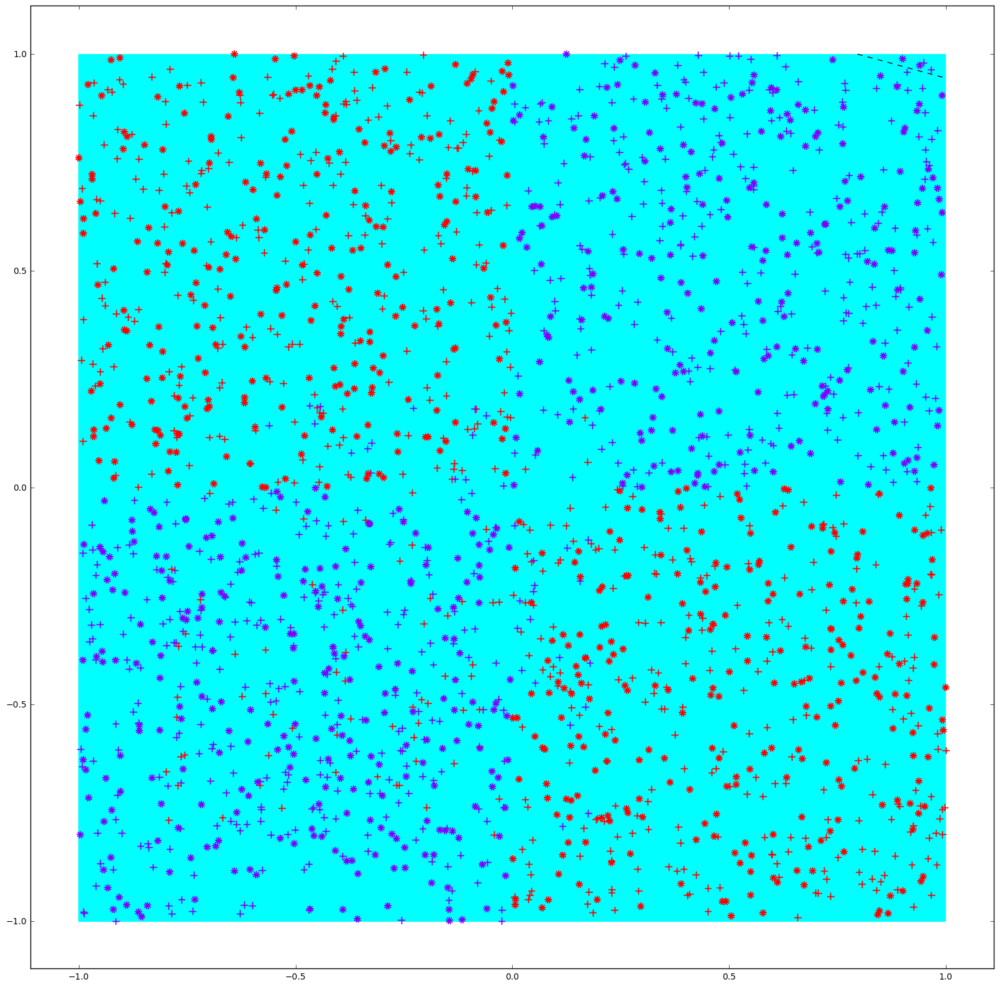



Para C =  0.1
La precisión con los datos de entrenamiento es:  0.546363636364
La precisión con los datos de prueba es:  0.524


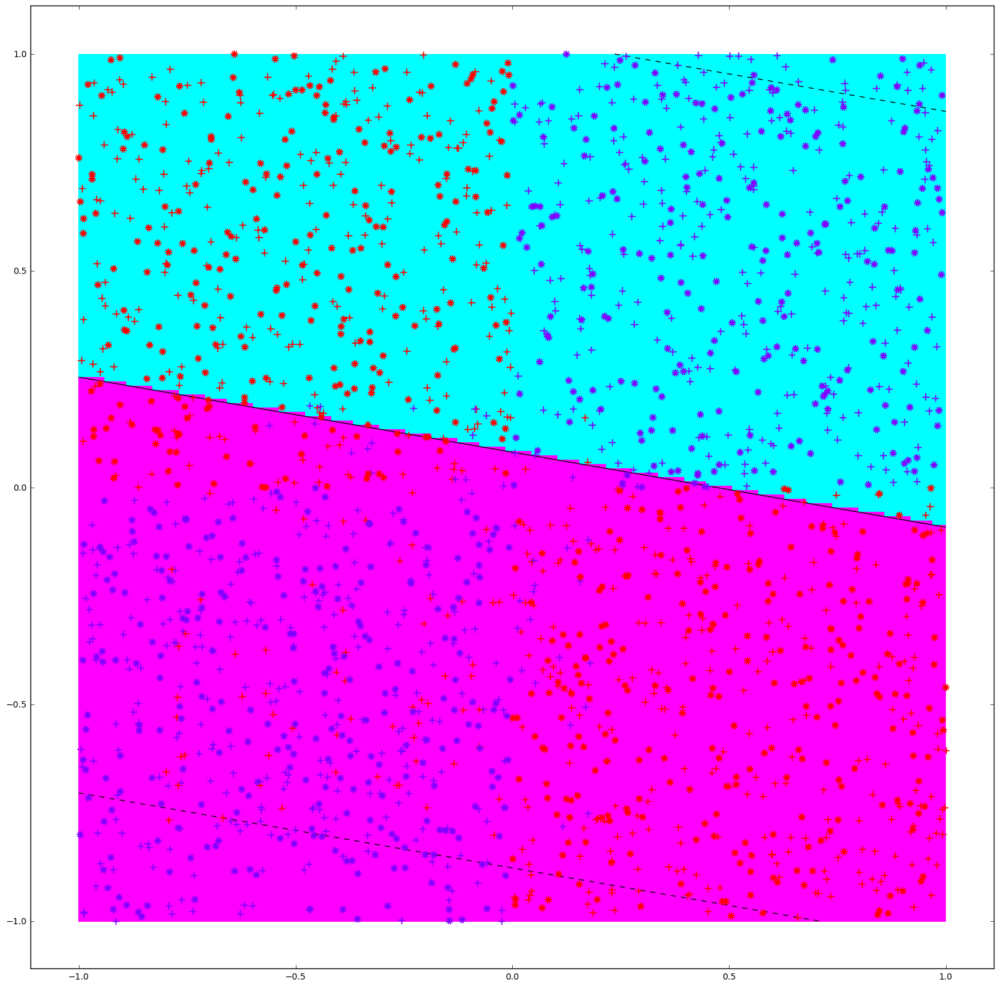



Para C =  1
La precisión con los datos de entrenamiento es:  0.543636363636
La precisión con los datos de prueba es:  0.519


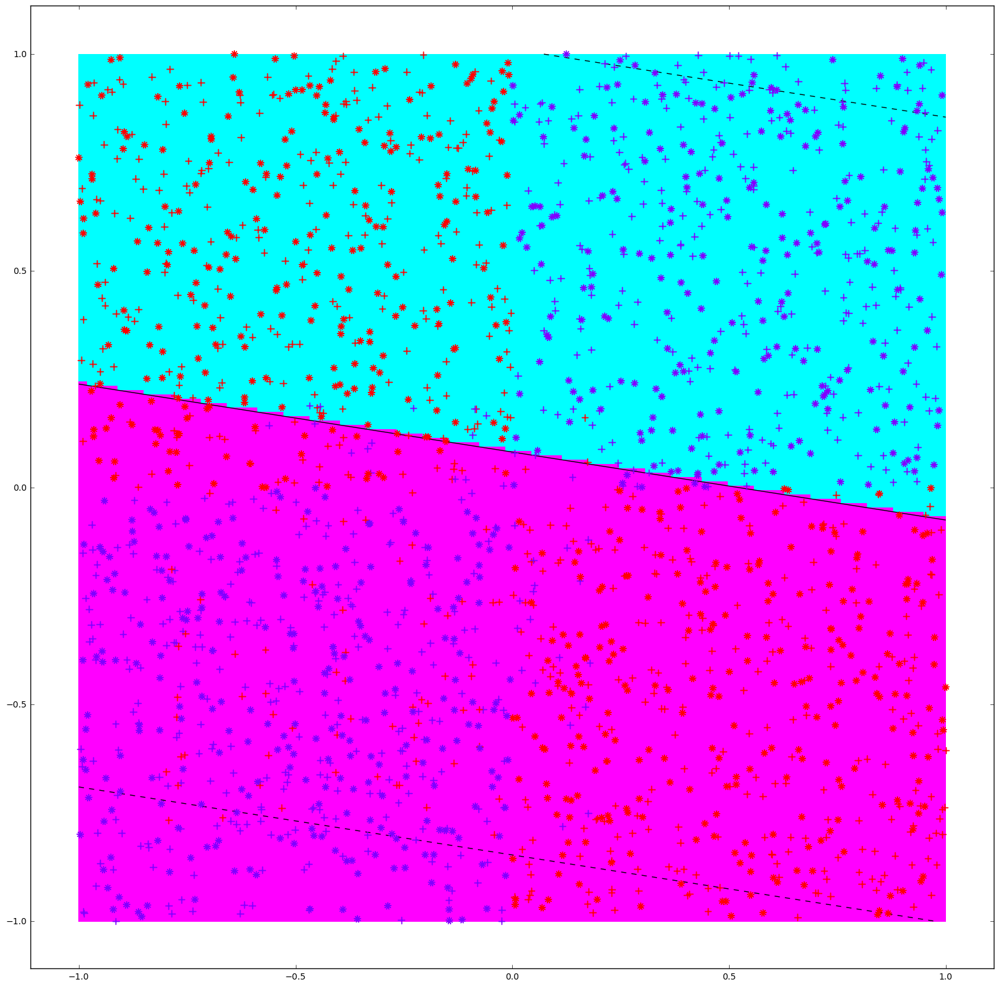



Para C =  10
La precisión con los datos de entrenamiento es:  0.545454545455
La precisión con los datos de prueba es:  0.522


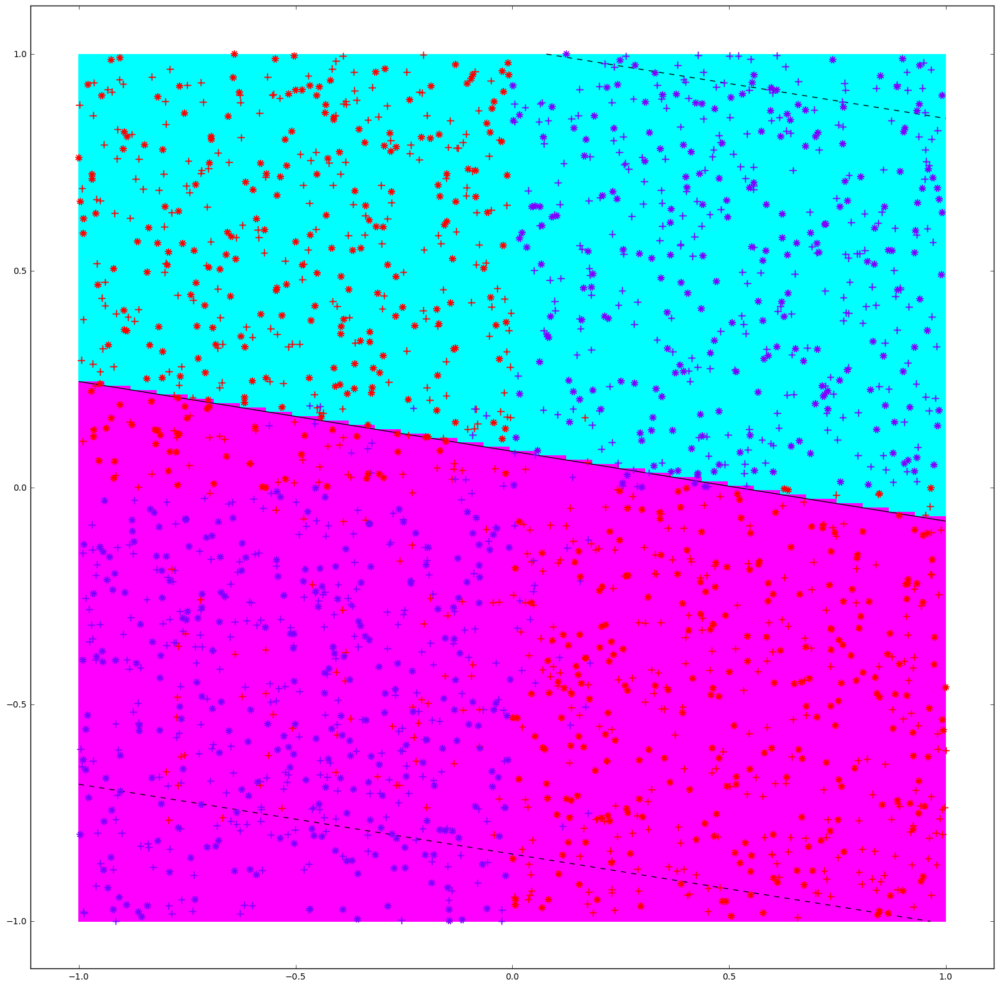



Para C =  100
La precisión con los datos de entrenamiento es:  0.545454545455
La precisión con los datos de prueba es:  0.522


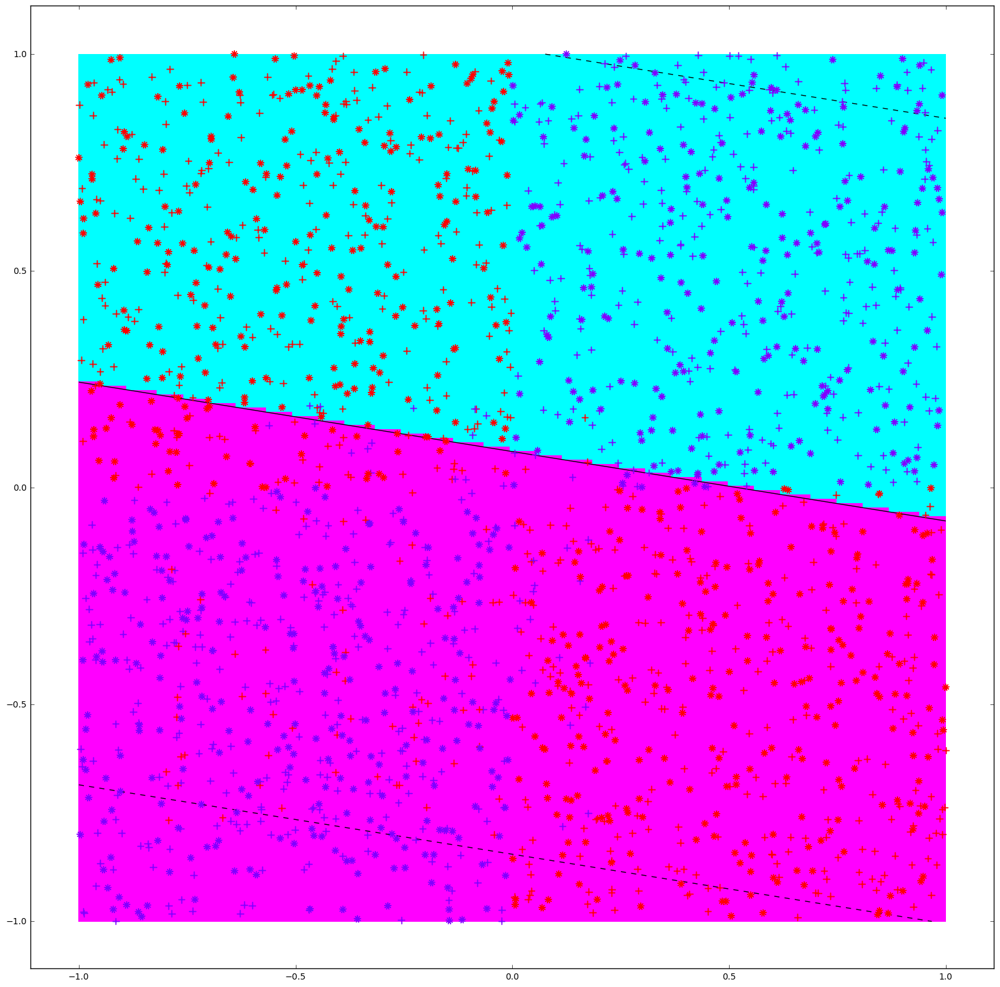



Para C =  1000
La precisión con los datos de entrenamiento es:  0.545454545455
La precisión con los datos de prueba es:  0.521


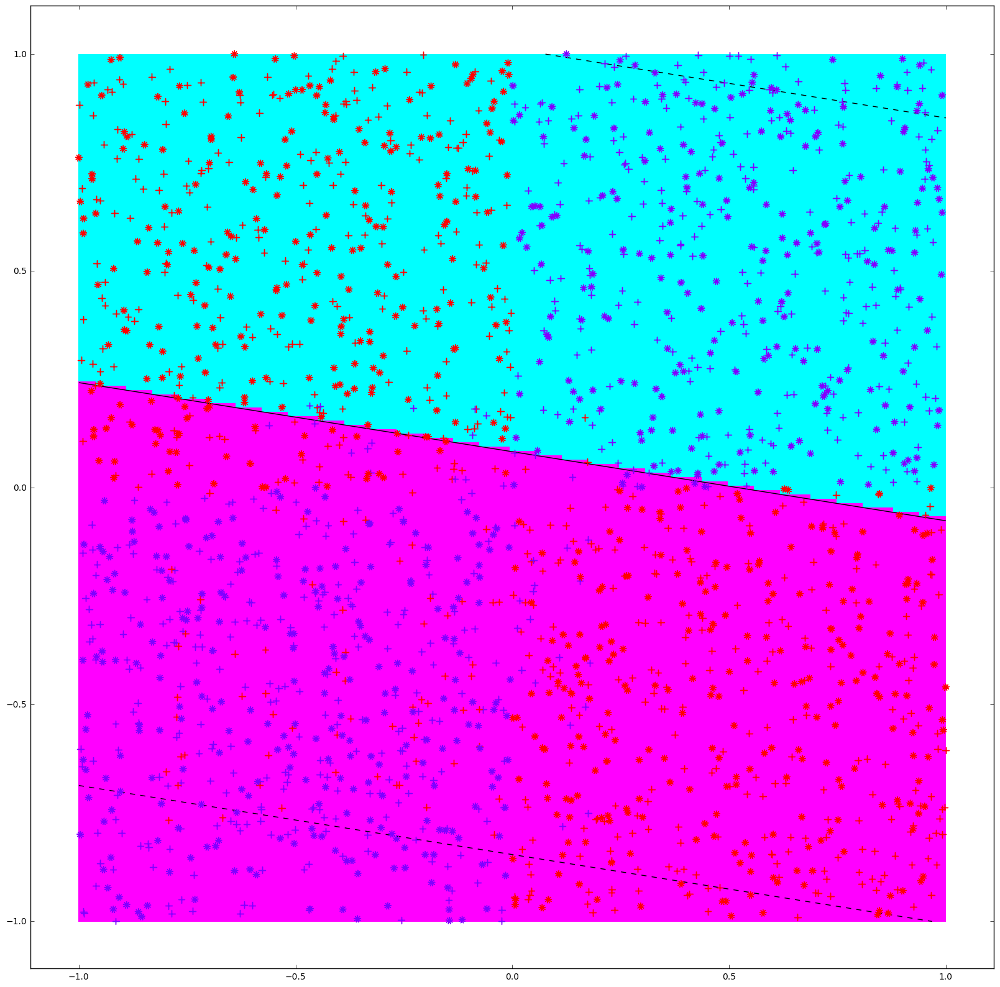



Para C =  10000
La precisión con los datos de entrenamiento es:  0.546363636364
La precisión con los datos de prueba es:  0.526


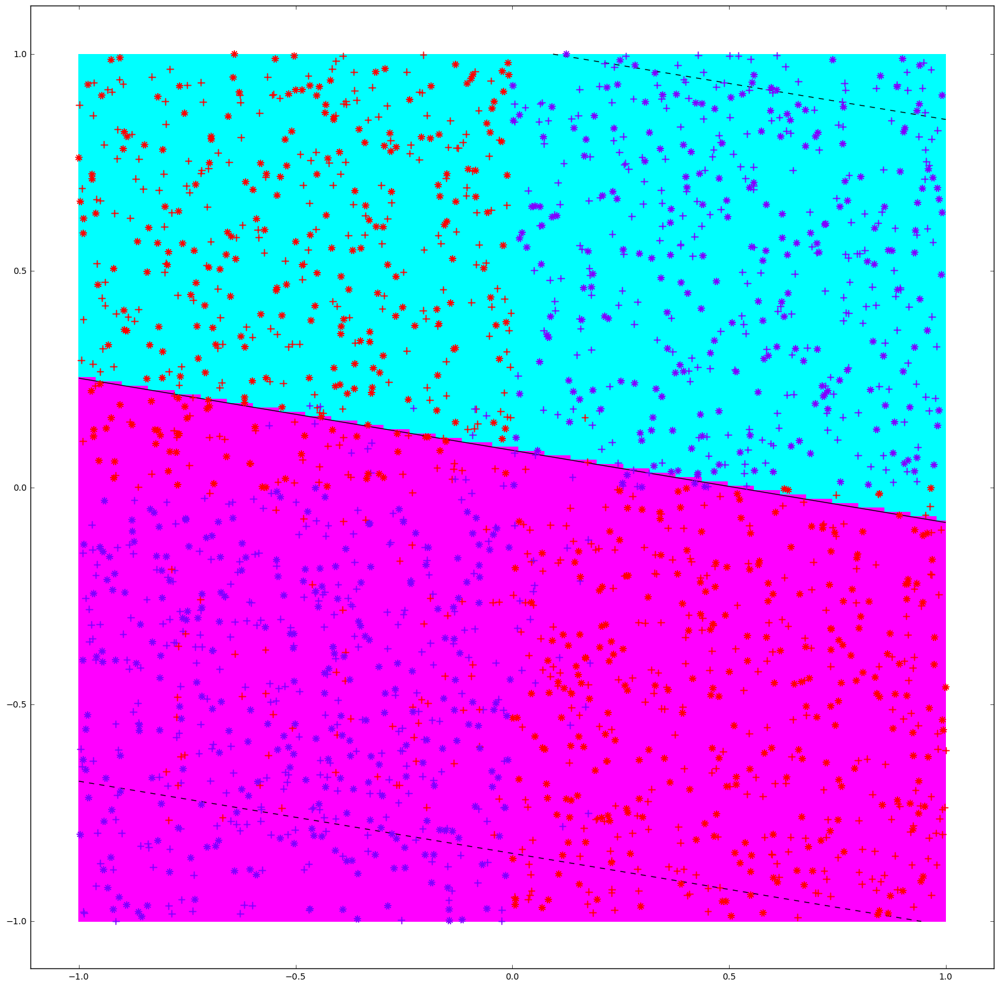

In [6]:
# Precisiones datos de entrenamiento y datos de prueba utilizando SVM lineal
# utilizando  svm.SVC
for k in range(-2,5):
    exp=10**k
    clf=svm.SVC(kernel='linear',C=exp,gamma=1)
    clf.fit(X_train, Y_train)
    precision_entrenamiento=clf.score(X_train, Y_train)
    precision_prueba=clf.score(X_test, Y_test)
    print "Para C = ", exp
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    plot_classifier(clf, X_train, Y_train, X_test, Y_test,'svm')
    print "\n"

Para C =  0.01
La precisión con los datos de entrenamiento es:  0.517272727273
La precisión con los datos de prueba es:  0.471


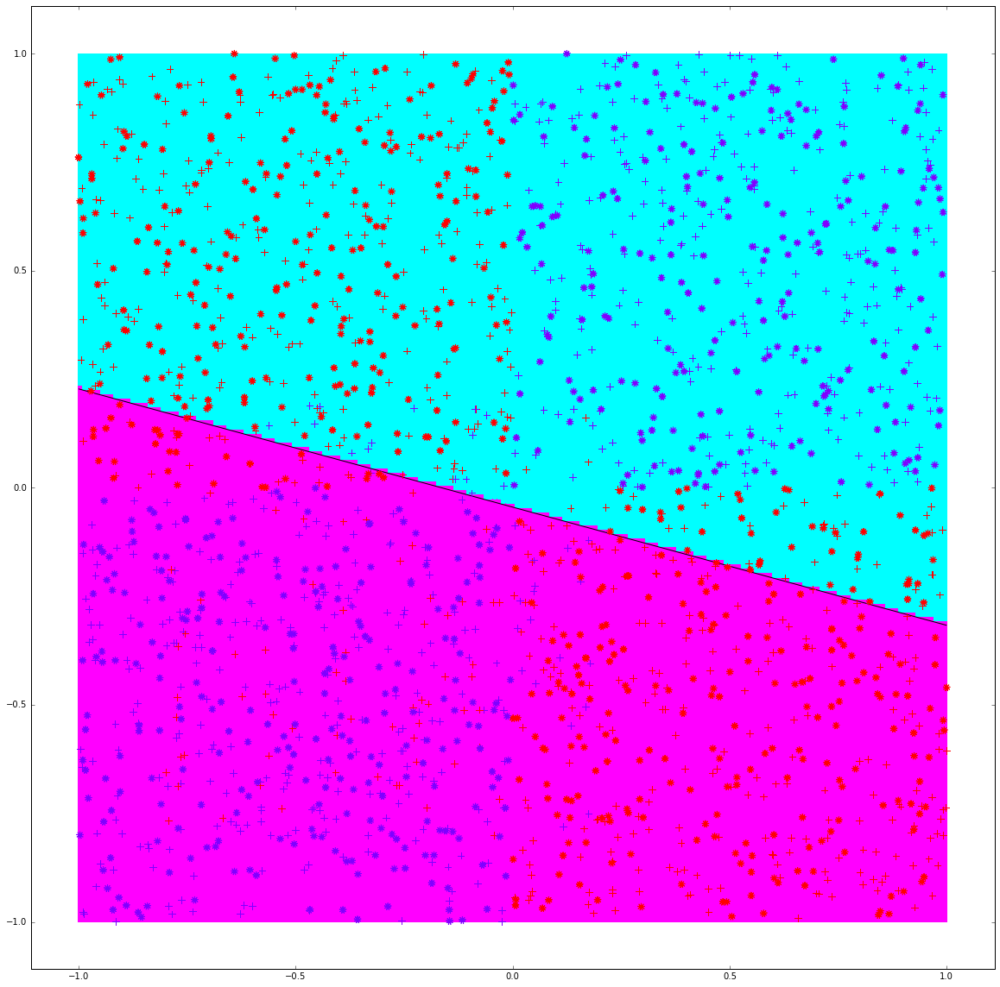



Para C =  0.1
La precisión con los datos de entrenamiento es:  0.517272727273
La precisión con los datos de prueba es:  0.471


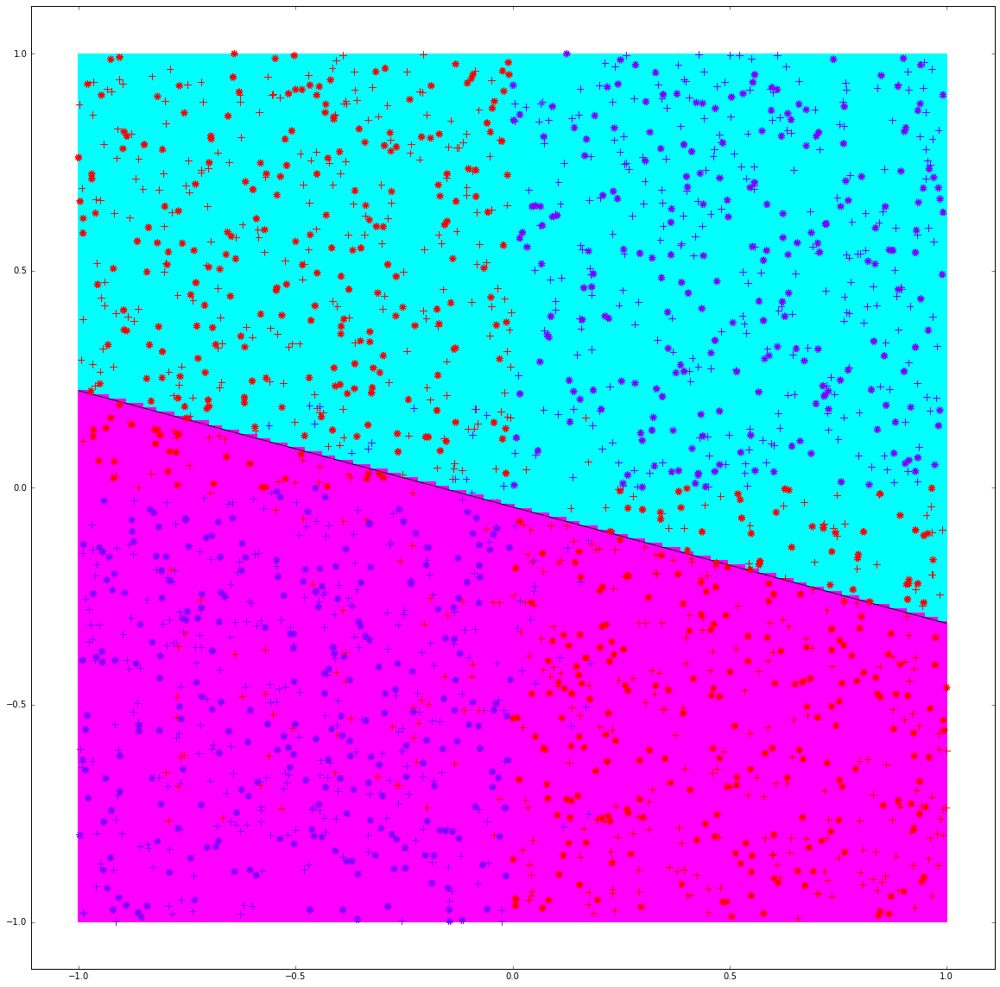



Para C =  1
La precisión con los datos de entrenamiento es:  0.517272727273
La precisión con los datos de prueba es:  0.471


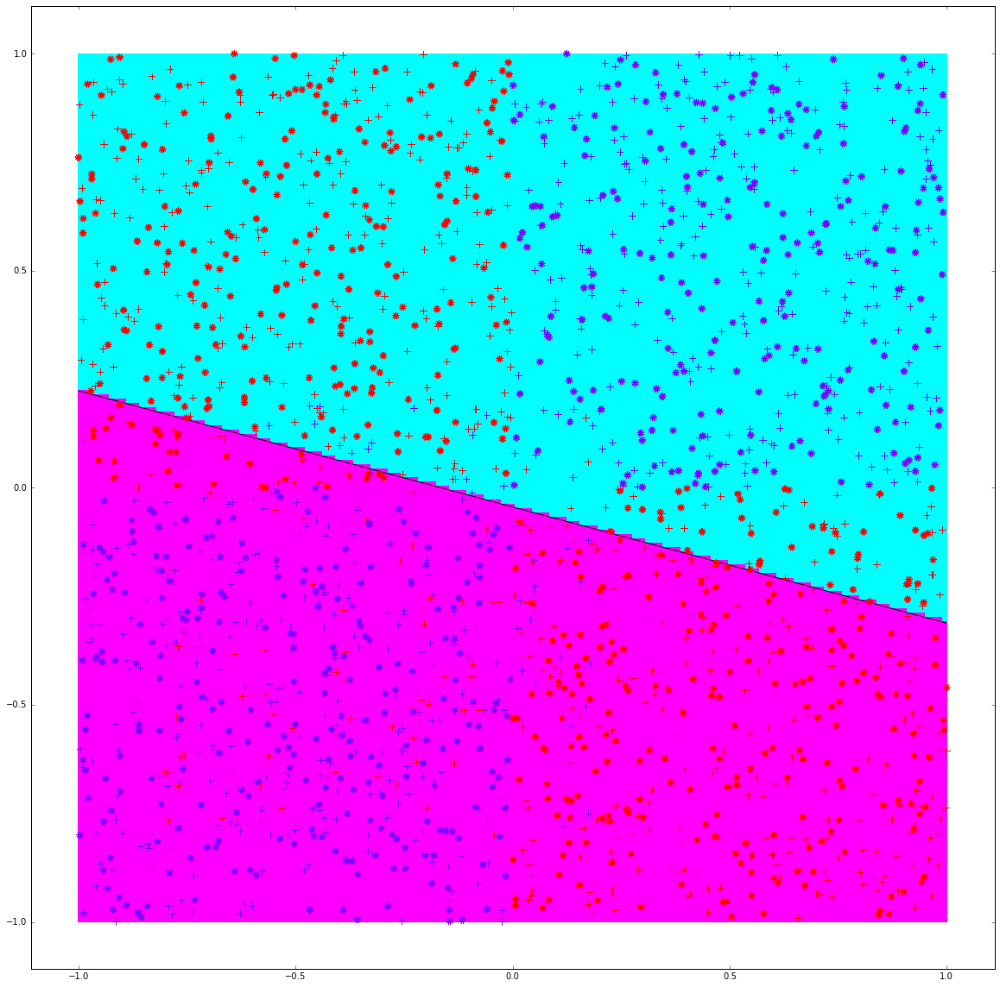



Para C =  10
La precisión con los datos de entrenamiento es:  0.517272727273
La precisión con los datos de prueba es:  0.471


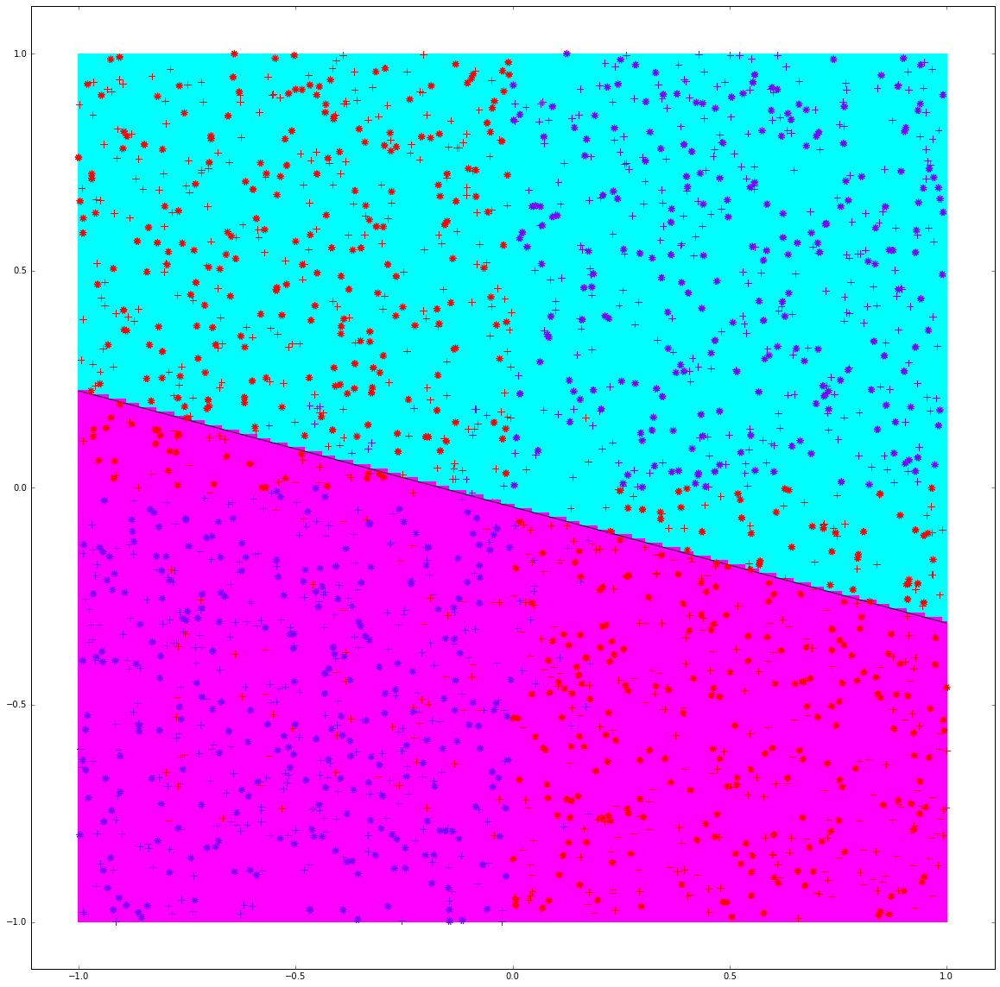



Para C =  100
La precisión con los datos de entrenamiento es:  0.514545454545
La precisión con los datos de prueba es:  0.466


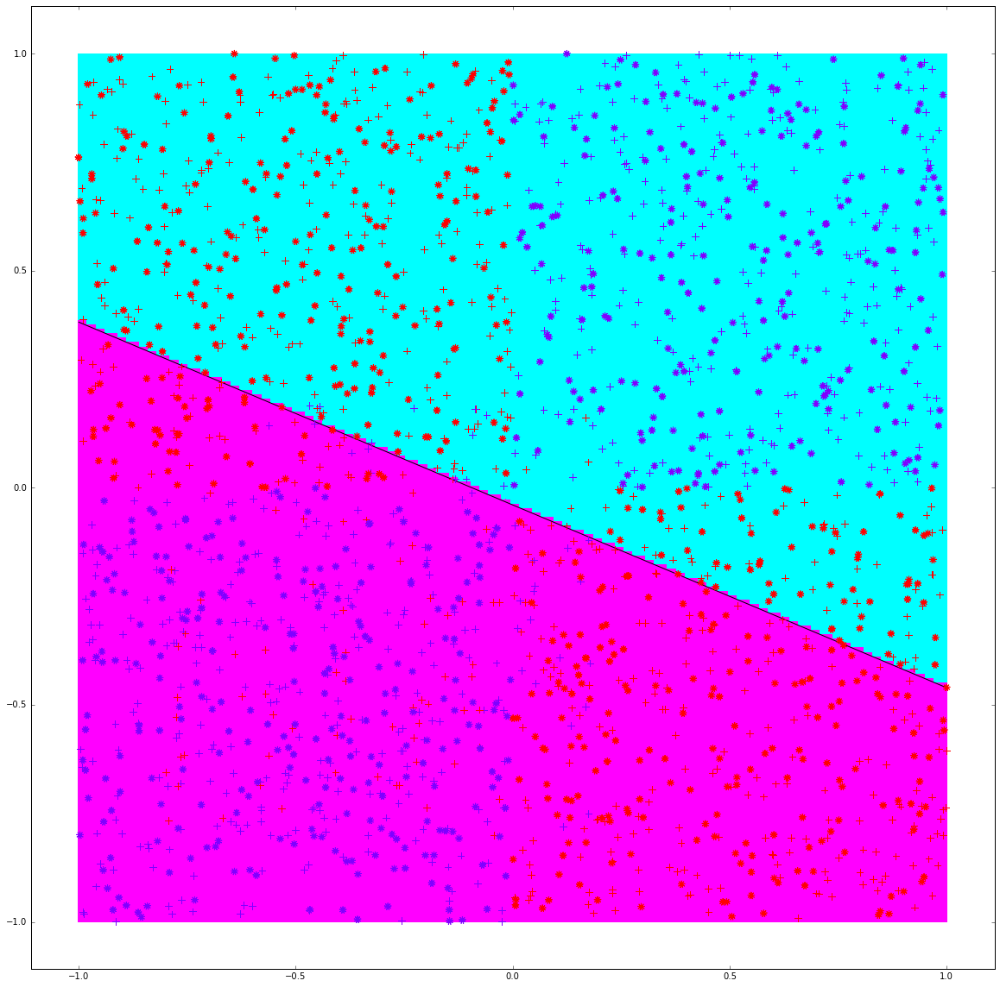



Para C =  1000
La precisión con los datos de entrenamiento es:  0.557272727273
La precisión con los datos de prueba es:  0.534


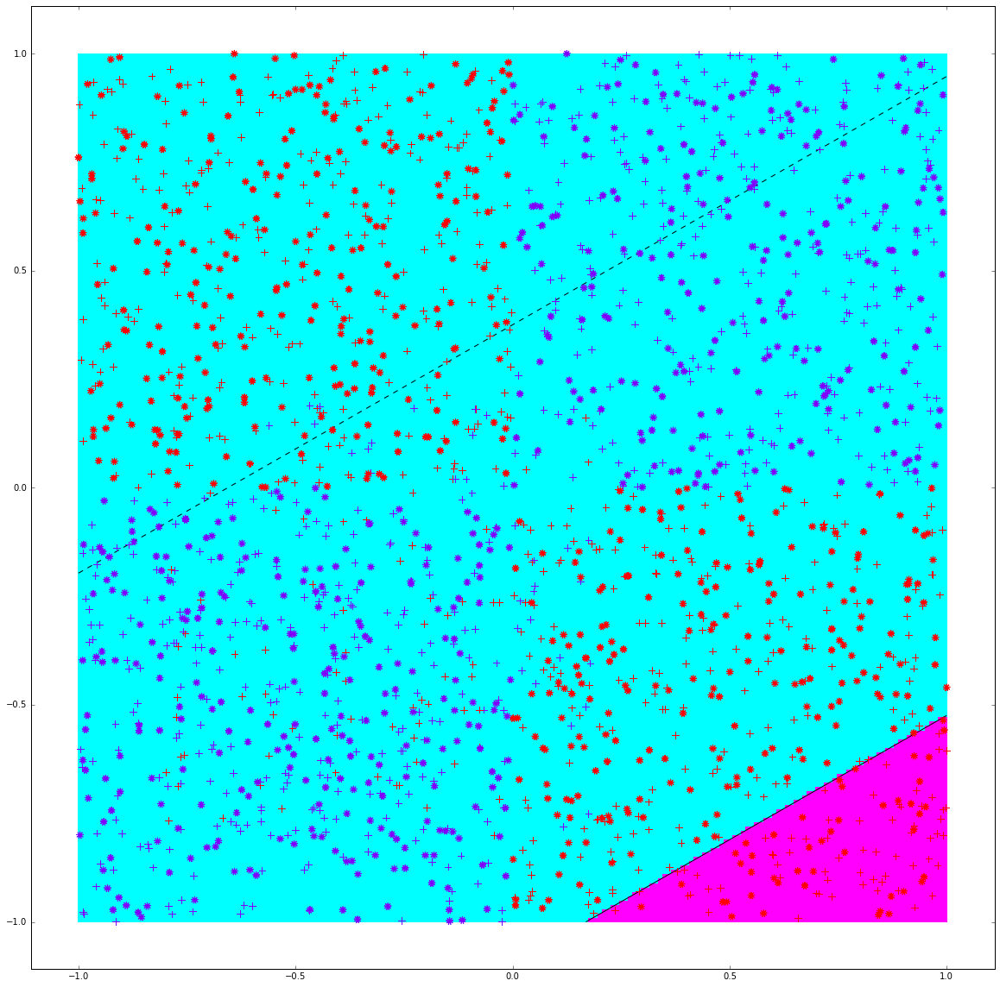



Para C =  10000
La precisión con los datos de entrenamiento es:  0.499090909091
La precisión con los datos de prueba es:  0.511


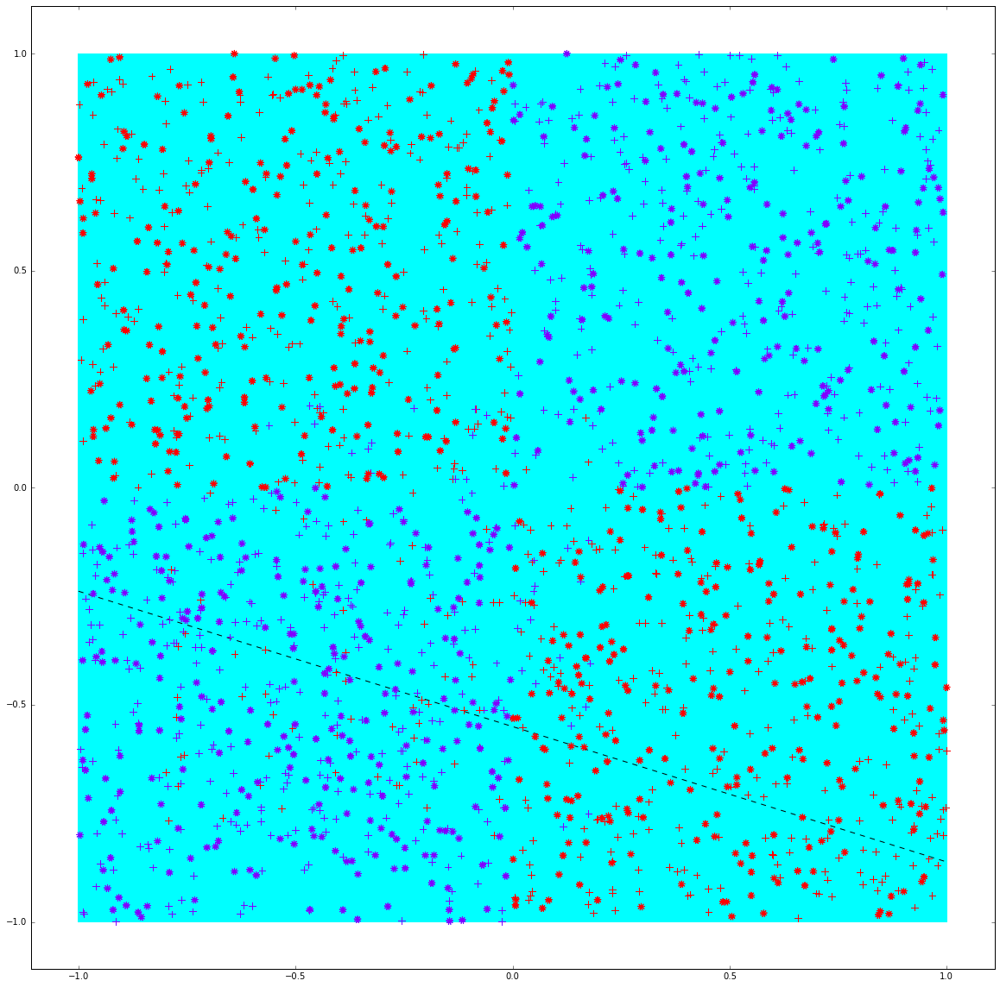

In [5]:
# Precisiones datos de entrenamiento y datos de prueba utilizando SVM lineal
# utilizando LinearSVC

for k in range(-2,5):
    exp=10**k
    clf=LinearSVC(C=exp)
    clf.fit(X_train, Y_train)
    precision_entrenamiento=clf.score(X_train, Y_train)
    precision_prueba=clf.score(X_test, Y_test)
    print "Para C = ", exp
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    plot_classifier(clf, X_train, Y_train, X_test, Y_test,'svm')
    print "\n"

Se puede apreciar que con diferentes implementaciones de SVM lineal, aunque hayan diferencias de valores, las precisiones obtenidas son bastantes similares y cercanas al 0.5 y el 0.56. Considerar que utilizando $LinealSVC$ los resultados obtenidos fueron mucho más rápidos que utilizando $svm.SVC$.
Observando los gráficos todo se hace más notorio ya que SVM lineal lanza una línea recta tratando de separar las clases, cosa que en este caso XOR, es imposible de realizar en esas condiciones. Por consiguiente queda demostrado que una SVM lineal no puede resolver satisfactoriamente este problema.

## Pregunta c)

Para esta pregunta se utilizará nuevamente la herramienta SVM, pero esta vez con kernels diferentes o "no lineales", como el kernel $Radial$ $Basis$ $Function$ o simplemente "RBF" y el kernel $Polynomial$. Se usará como base el código entregado en el enunciado de la tarea.

Para C =  0.25
Utilizando SVM con kernel rbf
La precisión con los datos de entrenamiento es:  0.885454545455
La precisión con los datos de prueba es:  0.944


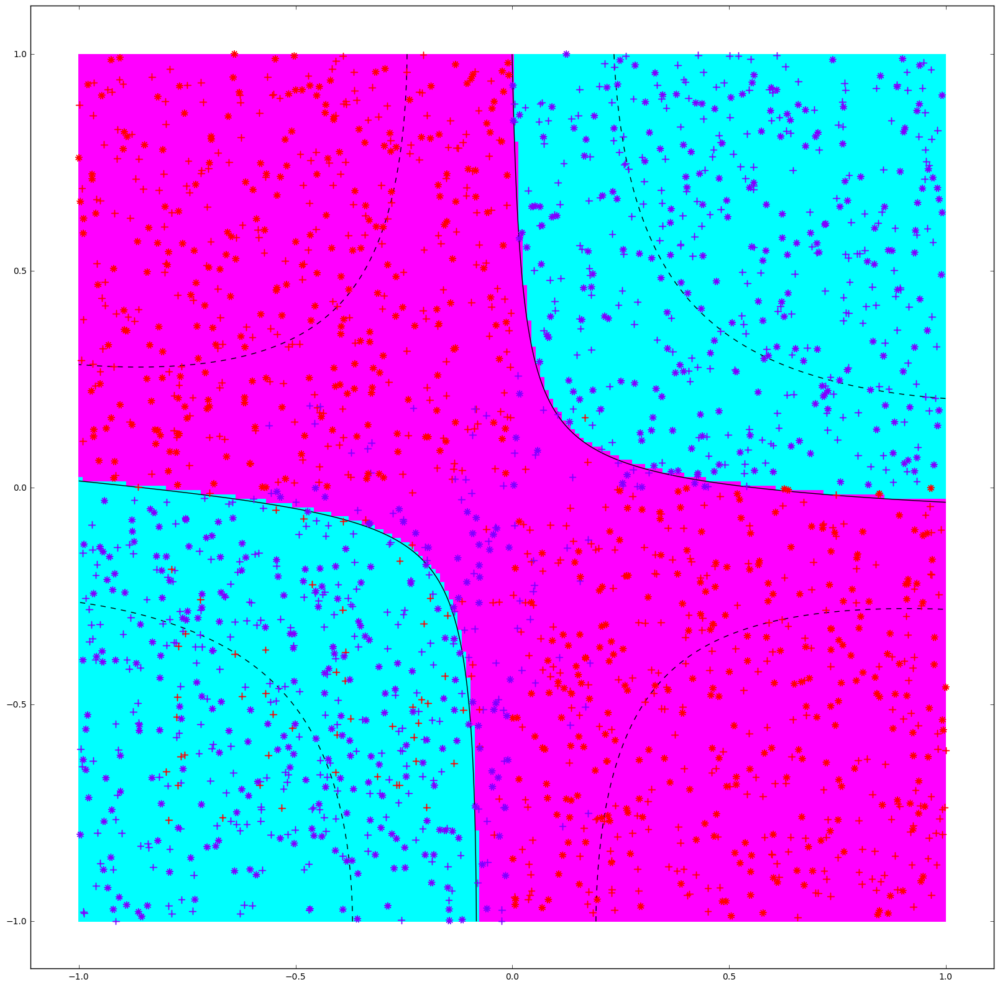



Para C =  0.5
Utilizando SVM con kernel rbf
La precisión con los datos de entrenamiento es:  0.89
La precisión con los datos de prueba es:  0.959


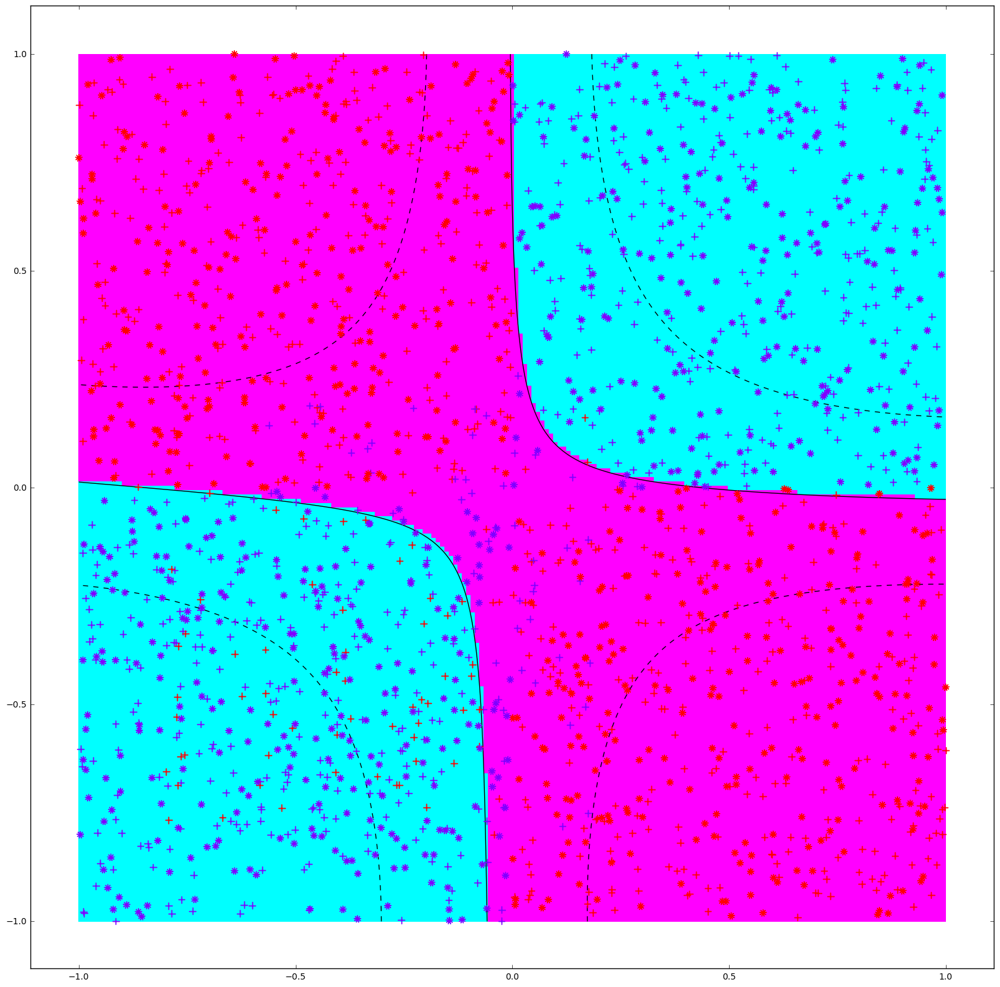



Para C =  1
Utilizando SVM con kernel rbf
La precisión con los datos de entrenamiento es:  0.887272727273
La precisión con los datos de prueba es:  0.954


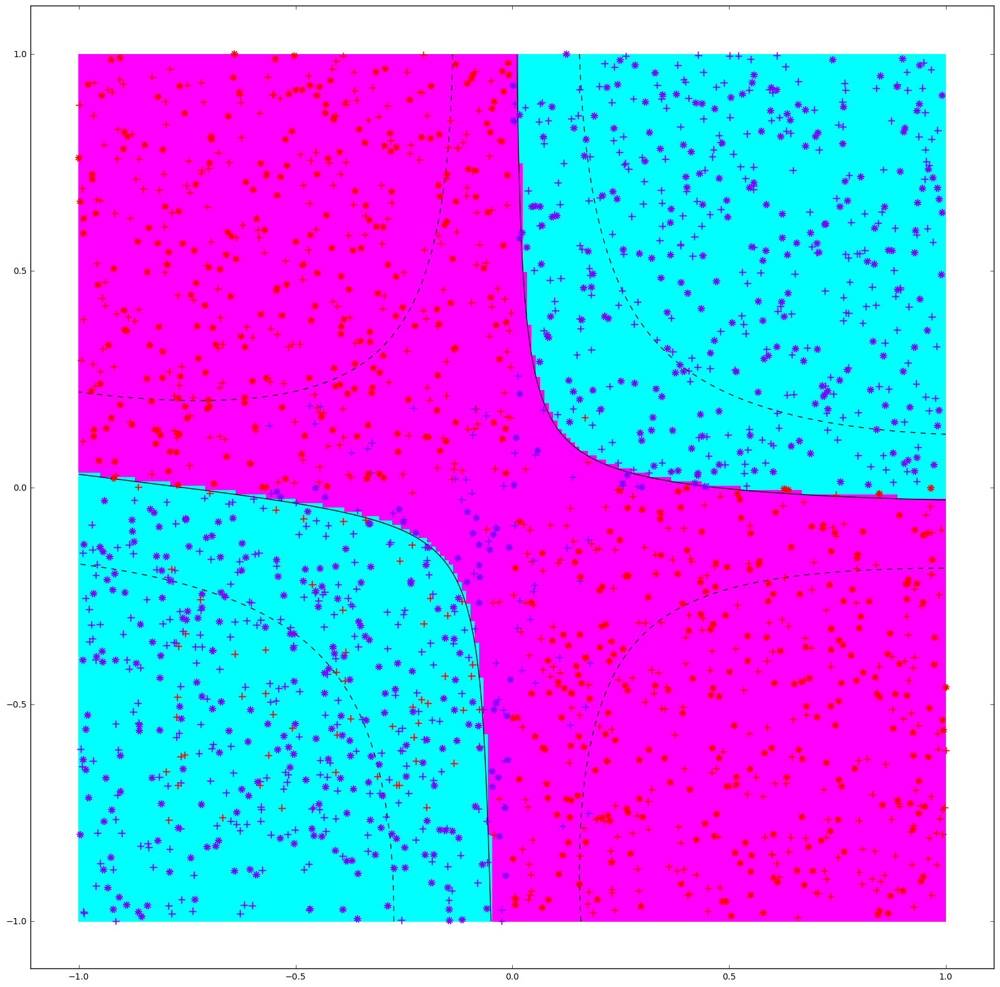



Para C =  2
Utilizando SVM con kernel rbf
La precisión con los datos de entrenamiento es:  0.890909090909
La precisión con los datos de prueba es:  0.959


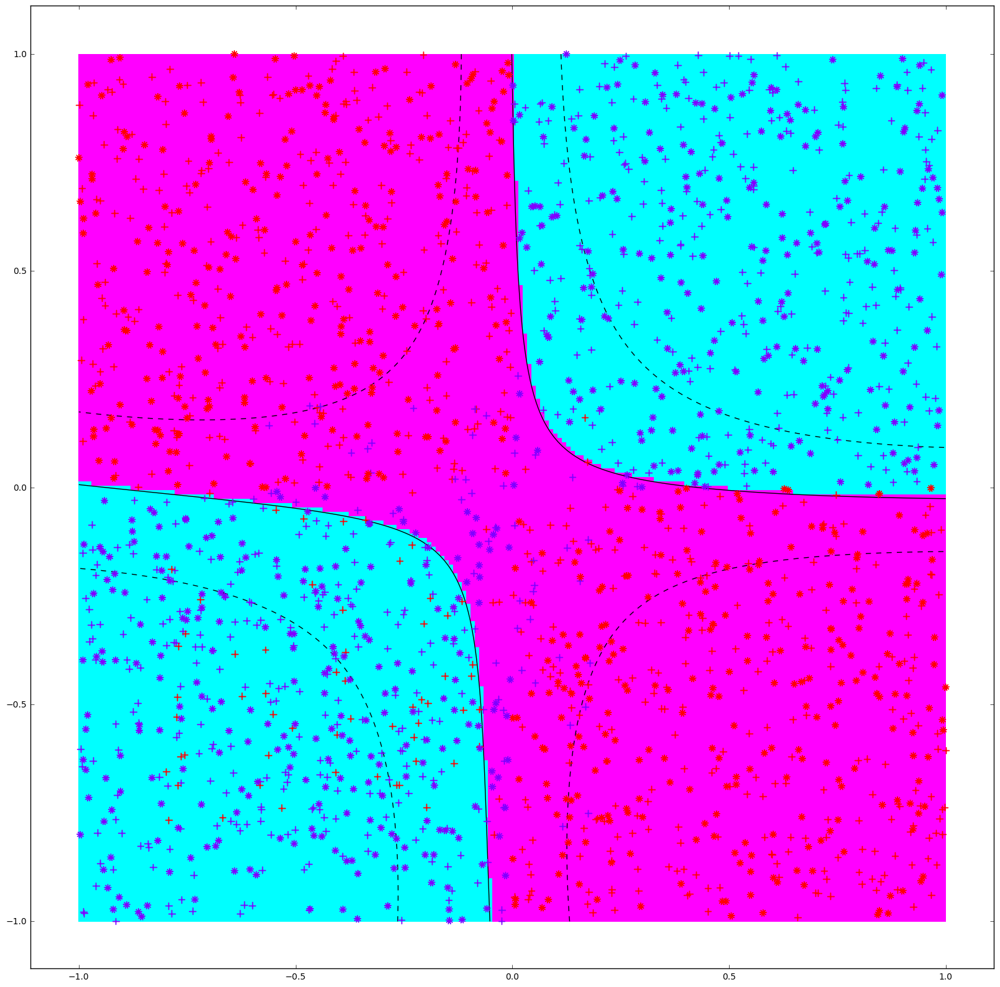



Para C =  4
Utilizando SVM con kernel rbf
La precisión con los datos de entrenamiento es:  0.901818181818
La precisión con los datos de prueba es:  0.97


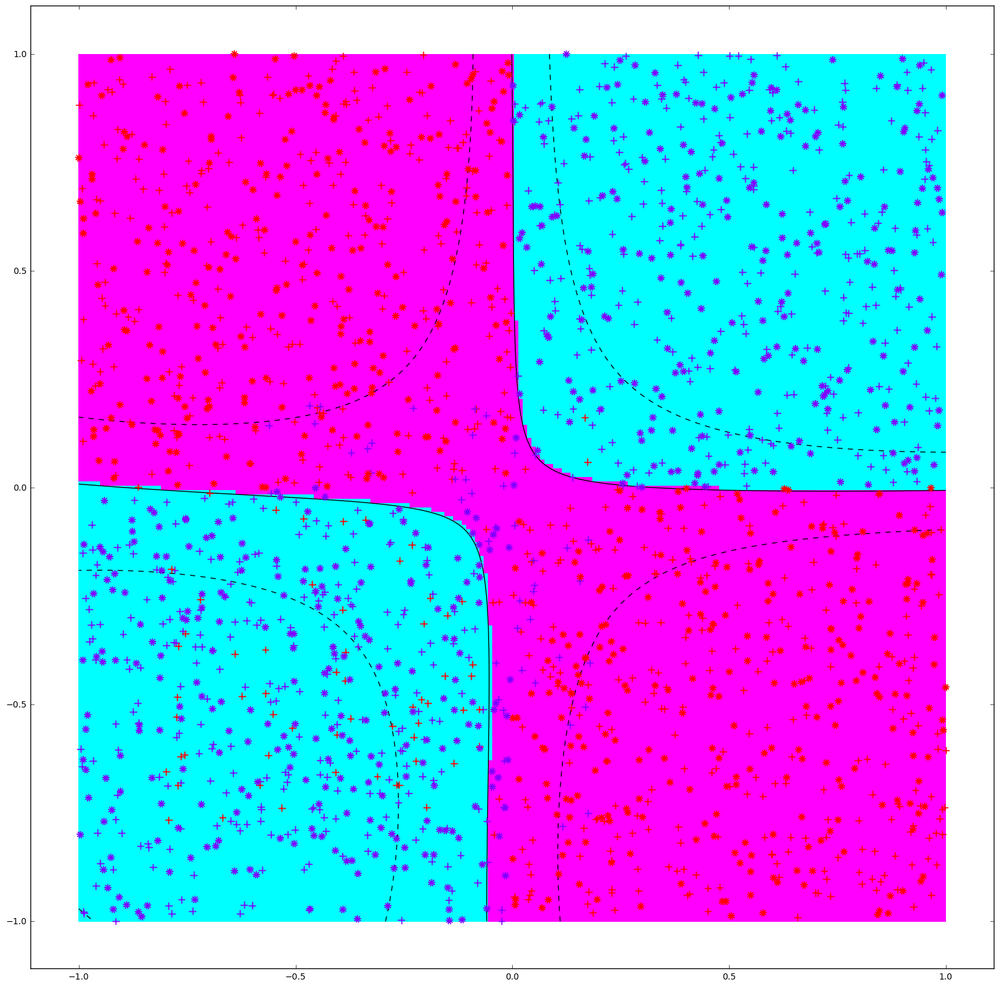



Para C =  8
Utilizando SVM con kernel rbf
La precisión con los datos de entrenamiento es:  0.902727272727
La precisión con los datos de prueba es:  0.972


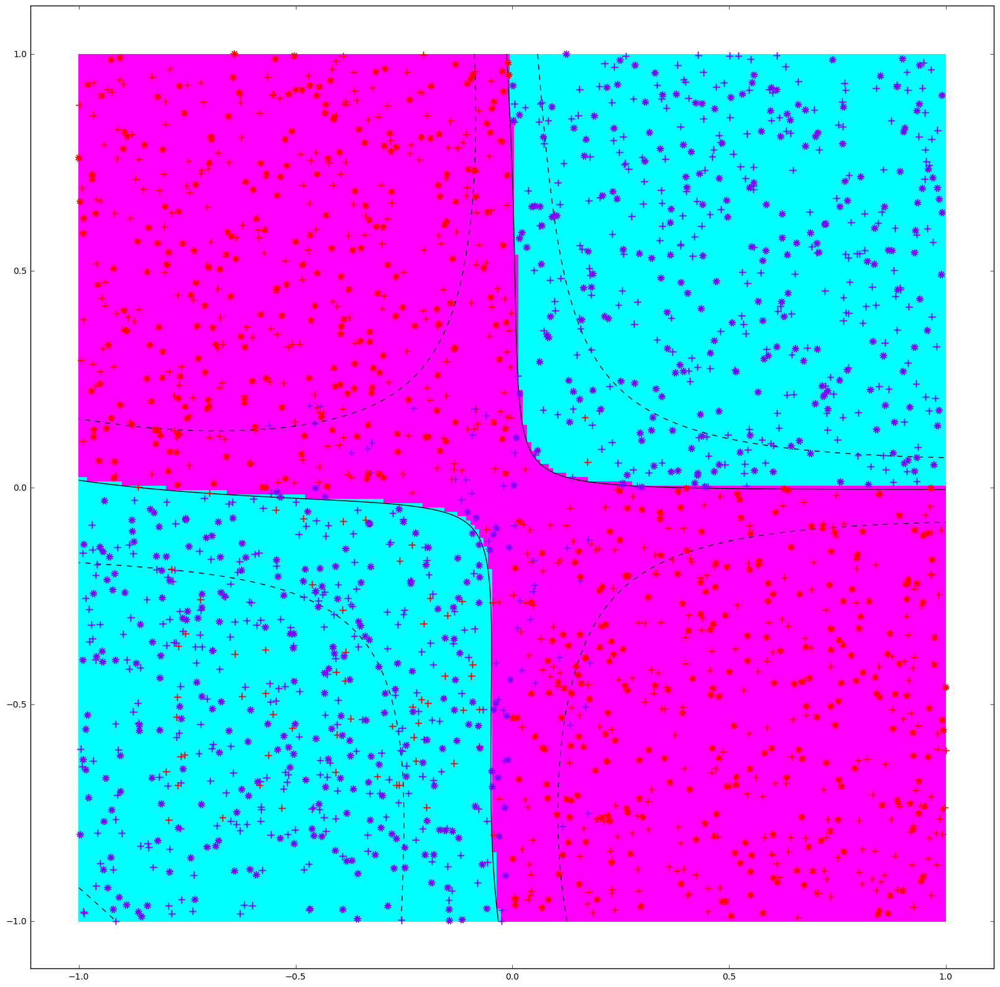



Para C =  16
Utilizando SVM con kernel rbf
La precisión con los datos de entrenamiento es:  0.898181818182
La precisión con los datos de prueba es:  0.97


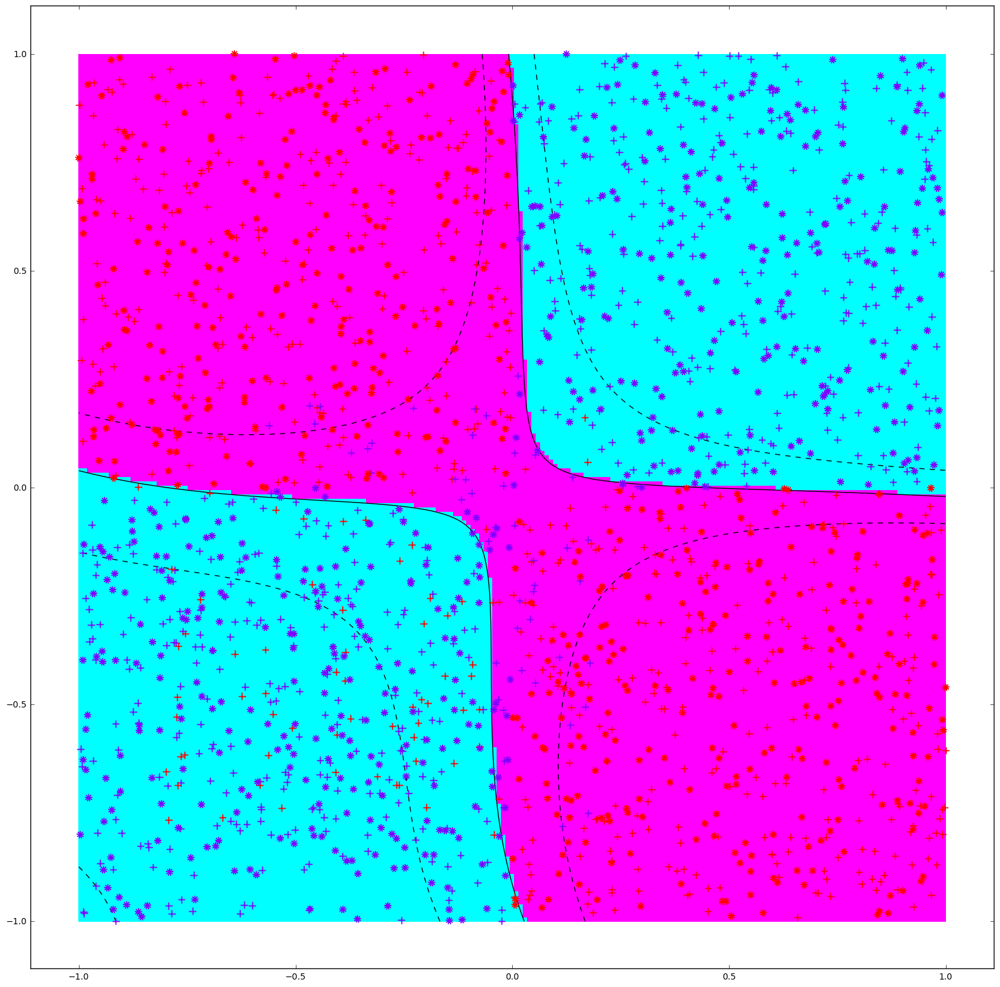

In [8]:
# Precisiones datos de entrenamiento y datos de prueba utilizando SVM con kernel rbf

errores_entrenamiento_rbf=[]
errores_prueba_rbf=[]

for k in range(-2,5):
    exp=2**k
    clf=SVC(C=exp, kernel='rbf')
    clf.fit(X_train, Y_train)
    precision_entrenamiento=clf.score(X_train, Y_train)
    eer=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_rbf.append(eer) #agregando a la lista de errores obtenidos
    
    precision_prueba=clf.score(X_test, Y_test)
    epr=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_rbf.append(epr) #agregando a la lista de errores obtenidos
    
    print "Para C = ", exp
    print "Utilizando SVM con kernel rbf"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    plot_classifier(clf, X_train, Y_train, X_test, Y_test,'svm')
    print "\n"

Para C =  0.25
Utilizando SVM con kernel polynomial
La precisión con los datos de entrenamiento es:  0.88
La precisión con los datos de prueba es:  0.935


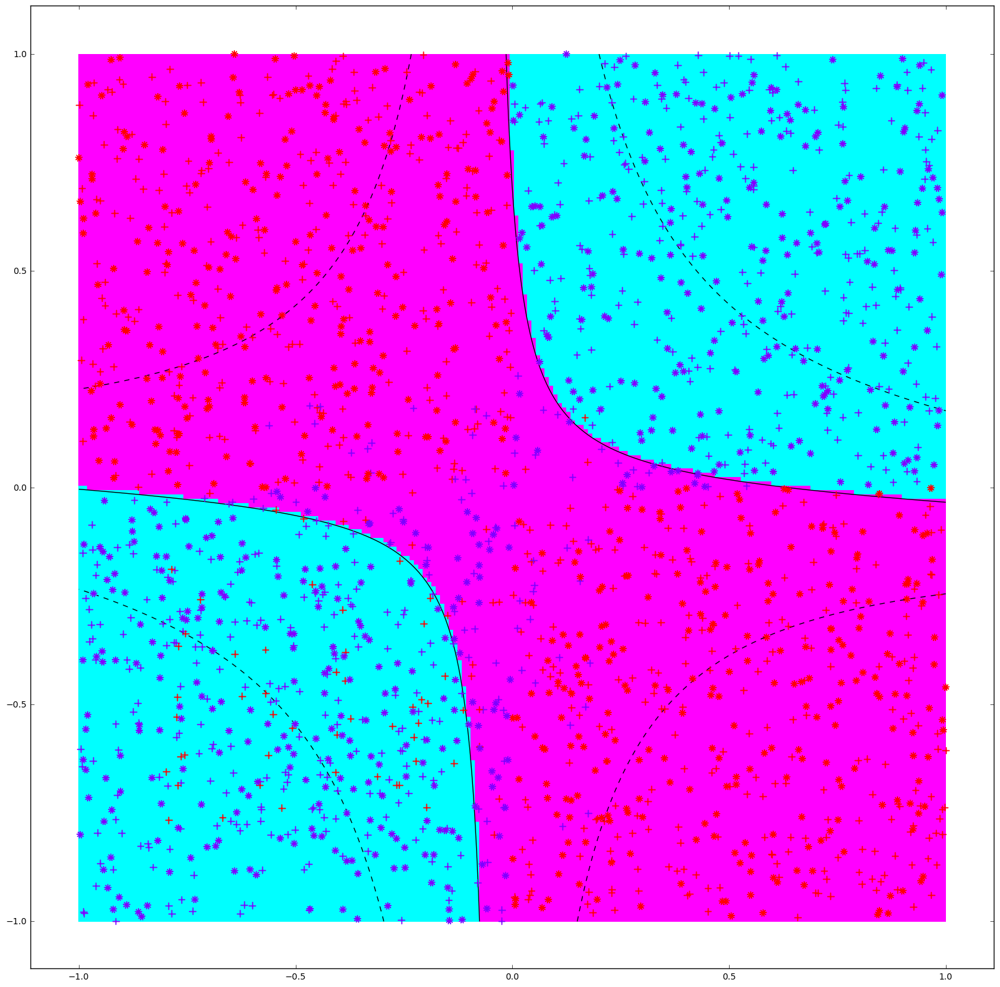



Para C =  0.5
Utilizando SVM con kernel polynomial
La precisión con los datos de entrenamiento es:  0.887272727273
La precisión con los datos de prueba es:  0.943


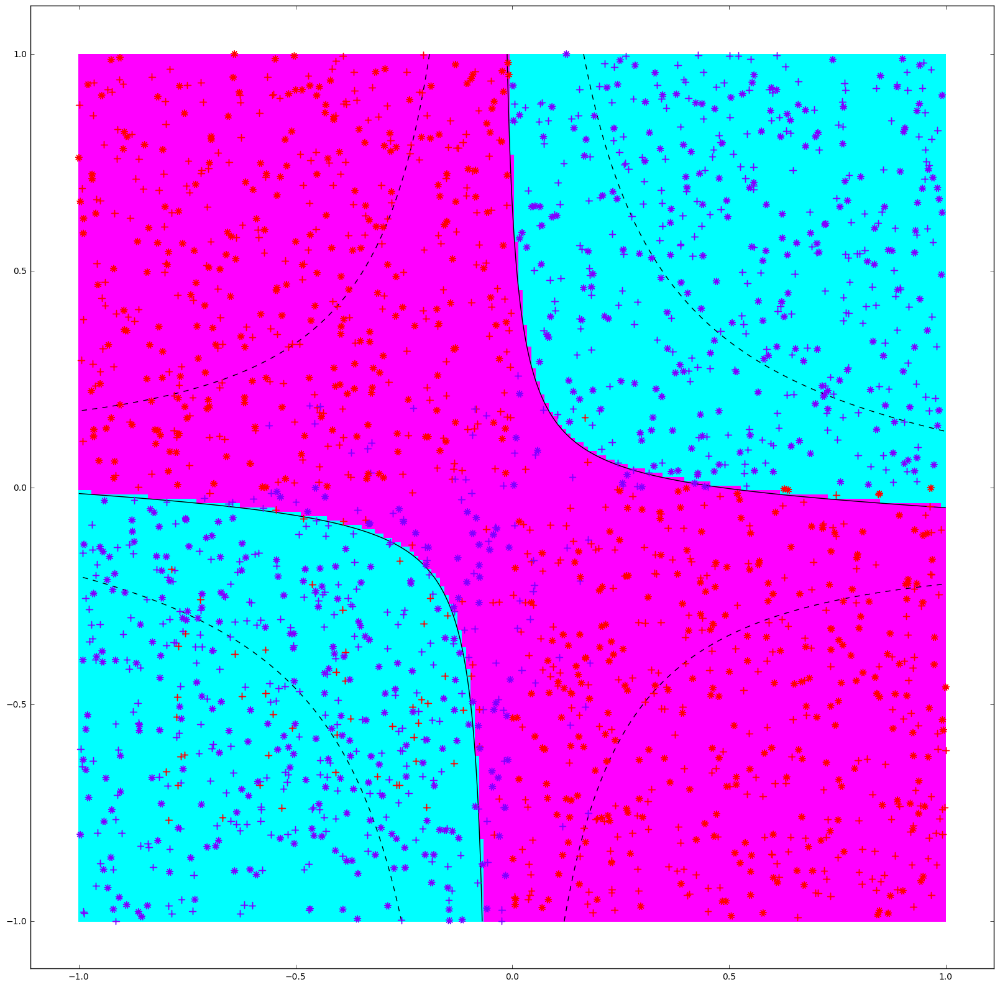



Para C =  1
Utilizando SVM con kernel polynomial
La precisión con los datos de entrenamiento es:  0.888181818182
La precisión con los datos de prueba es:  0.952


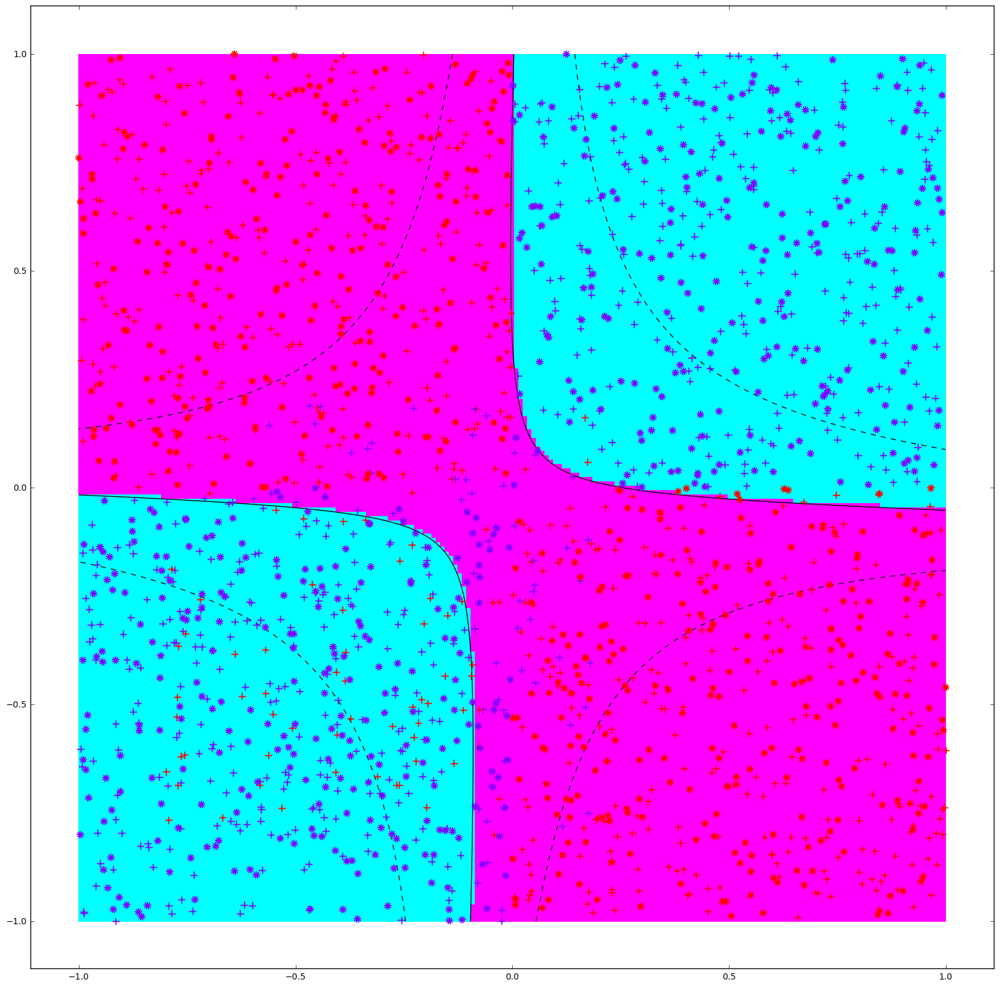



Para C =  2
Utilizando SVM con kernel polynomial
La precisión con los datos de entrenamiento es:  0.883636363636
La precisión con los datos de prueba es:  0.943


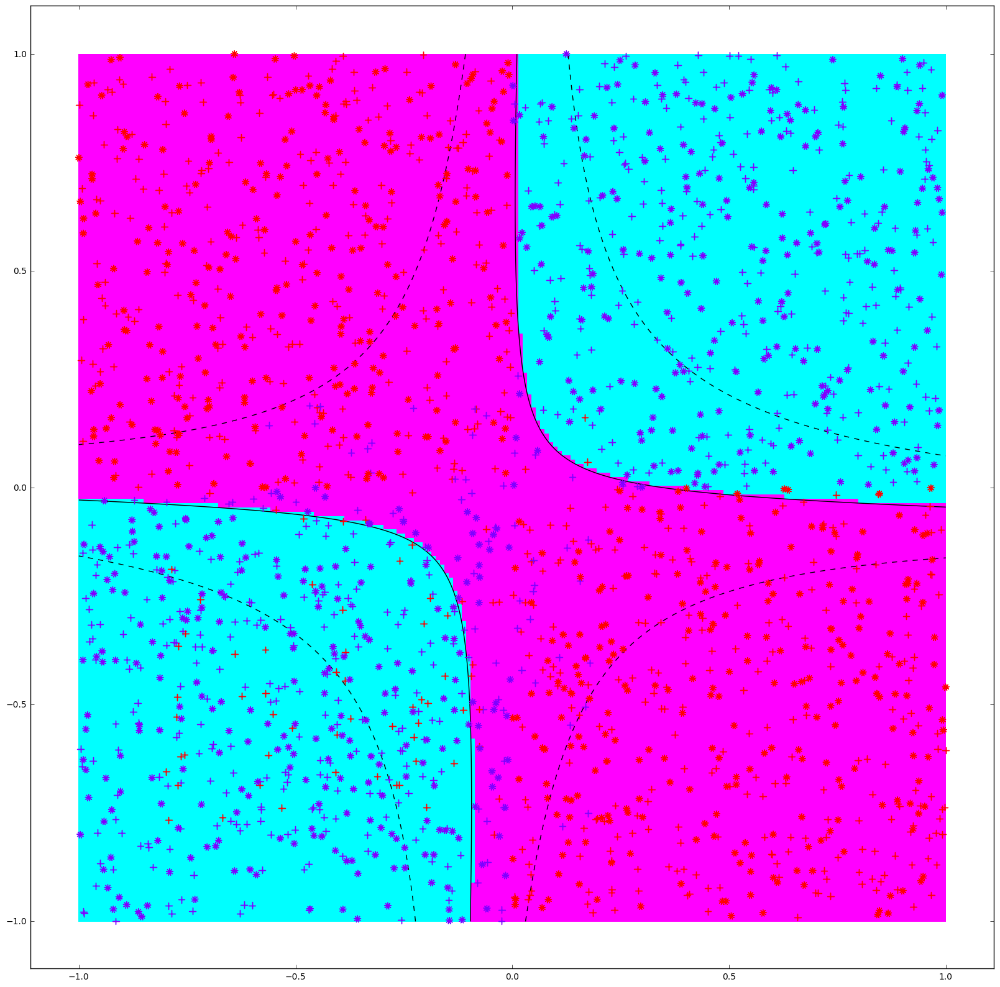



Para C =  4
Utilizando SVM con kernel polynomial
La precisión con los datos de entrenamiento es:  0.887272727273
La precisión con los datos de prueba es:  0.946


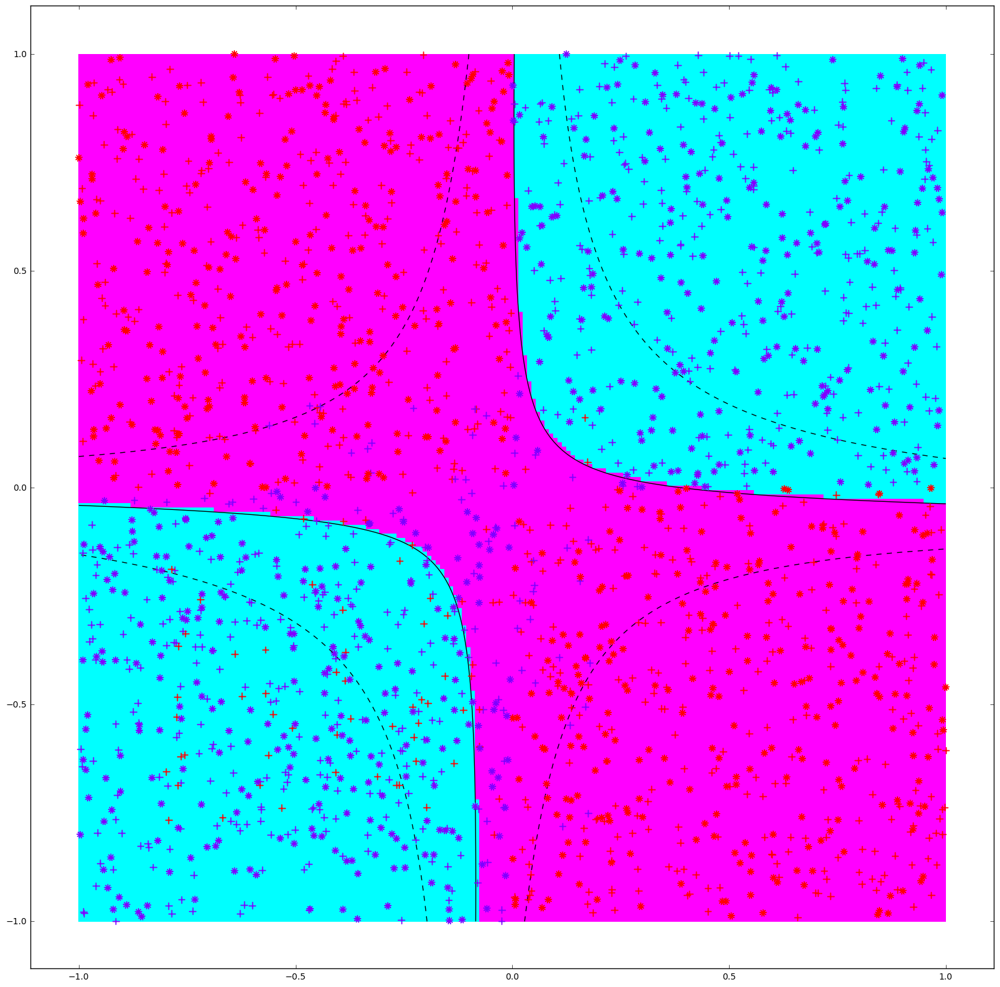



Para C =  8
Utilizando SVM con kernel polynomial
La precisión con los datos de entrenamiento es:  0.887272727273
La precisión con los datos de prueba es:  0.955


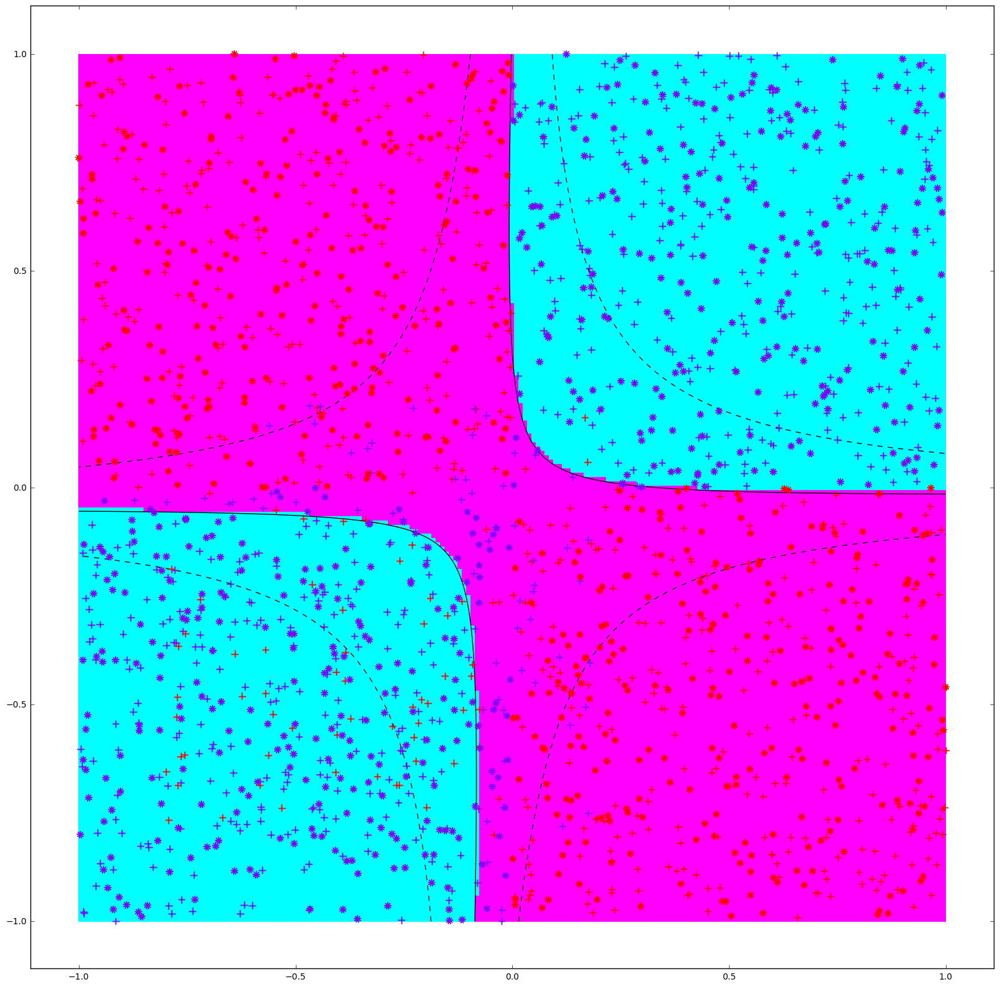



Para C =  16
Utilizando SVM con kernel polynomial
La precisión con los datos de entrenamiento es:  0.89
La precisión con los datos de prueba es:  0.949


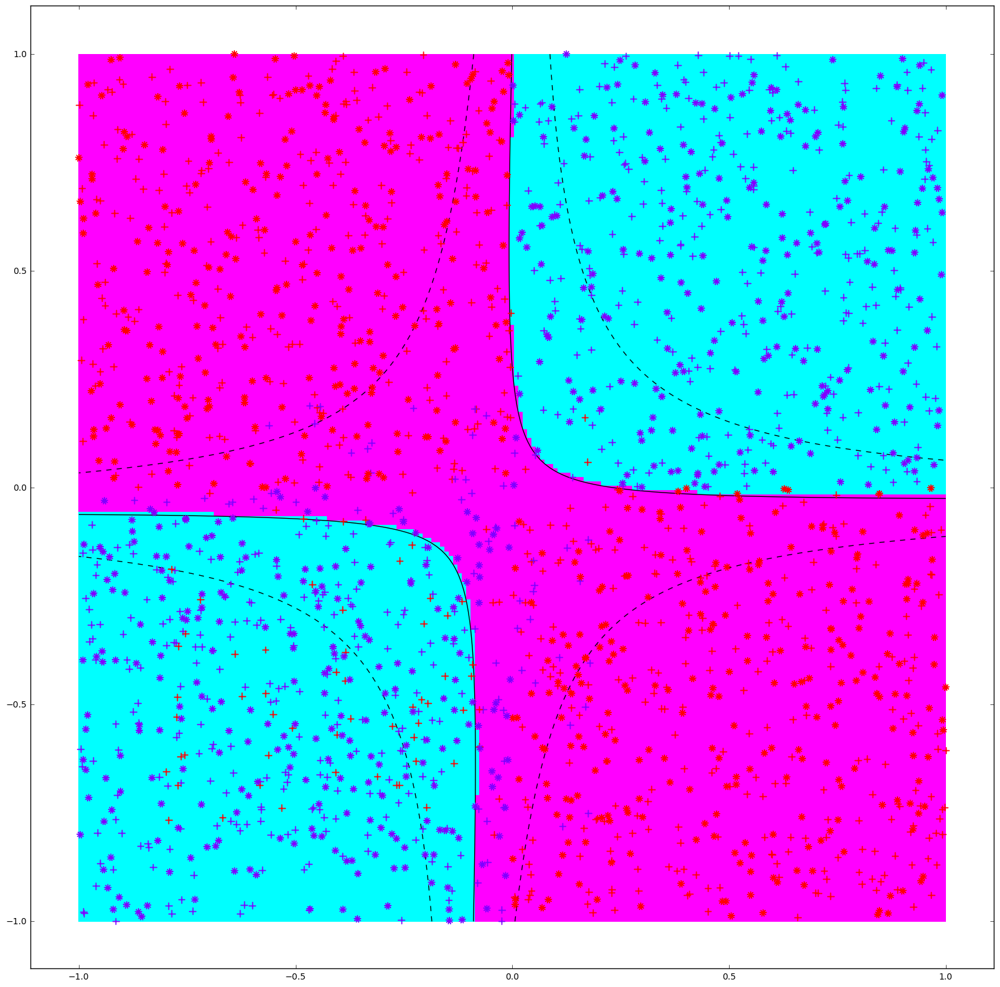

In [9]:
# Precisiones datos de entrenamiento y datos de prueba utilizando SVM con kernel Polynomial

errores_entrenamiento_polynomial=[]
errores_prueba_polynomial=[]

for k in range(-2,5):
    exp=2**k
    clf=SVC(C=exp, kernel='poly', degree=2, coef0=1)
    clf.fit(X_train, Y_train)
    precision_entrenamiento=clf.score(X_train, Y_train)
    eep=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_polynomial.append(eep) #agregando a la lista de errores obtenidos
    
    precision_prueba=clf.score(X_test, Y_test)
    epp=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_polynomial.append(epp) #agregando a la lista de errores obtenidos
    
    print "Para C = ", exp
    print "Utilizando SVM con kernel polynomial"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    plot_classifier(clf, X_train, Y_train, X_test, Y_test,'svm')
    print "\n"

Observando los valores de precisión de los datos de prueba y de entrenamiento, en conjunto a su gráfico según el C respectivo, está bastante claro que las aproximaciones de las clases son muy buenas y coherentes según los datos proyectados en estos gráficos por lo mismo ambos SVM no lineales resuelven de manera precisa el problema XOR.
Para mejores detalles, revisar un gráfico comparativo de los errores de la precisión de los datos de entrenamiento y de prueba según el C escogido:

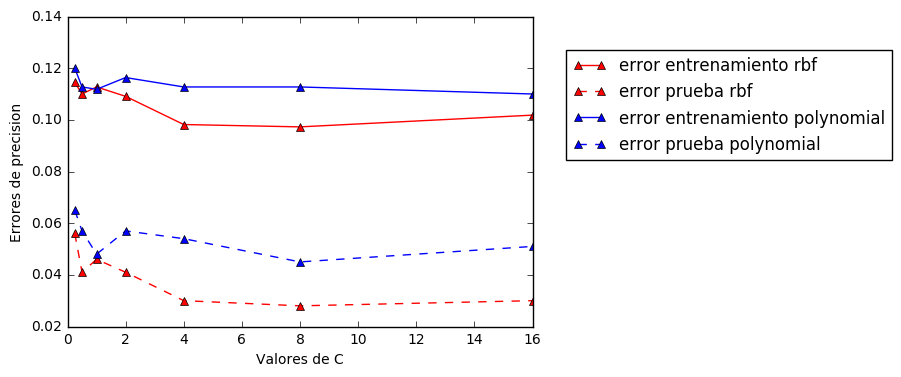

In [11]:
plt.plot([0.25,0.5,1,2,4,8,16], errores_entrenamiento_rbf, 'r^-', label='error entrenamiento rbf')
plt.plot([0.25,0.5,1,2,4,8,16], errores_prueba_rbf, 'r^--', label='error prueba rbf')
plt.plot([0.25,0.5,1,2,4,8,16], errores_entrenamiento_polynomial, 'b^-', label='error entrenamiento polynomial')
plt.plot([0.25,0.5,1,2,4,8,16], errores_prueba_polynomial, 'b^--', label='error prueba polynomial')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de C')
plt.ylabel('Errores de precision')
plt.show()

Aquí se puede identificar claramente que los errores son muy pequeños, donde ninguno supera los 0.14, en especial para los datos de prueba, el motivo de esto es por los 100 datos de ruido agregados al principio del problema. A partir de los valores C=8 se obtuvieron los errores más optimos, donde para RBF se obtuvo casi un 97% de precisión con los datos de prueba y para Polynomial se obtuvo un valor cercano al 95% de precisión. Esto corrobora que ambos SVM no lineales satisfacen de buena manera el problema.

## Pregunta d)

Por las consultas realizadas en Moodle, a la función que define los datos (do_XOR) se le realizará una pequeña modificación:

In [12]:
def do_XOR2(n=1000,noisy_n=100,svm=False): #nombre modificado y parámetro svm=False modificado
  rng = np.random.RandomState(0)
  X_train1 = rng.uniform(low=-1.0,high=1.0,size=(n,2))
  Y_train1 = np.logical_xor(X_train1[:,0] > 0, X_train1[:,1] > 0)
  Y_train1 = 2*Y_train1-1 if svm else Y_train1
  X_noisy1= rng.uniform(low=-0.8,high=0.2,size=(noisy_n,2))
  Y_noisy1 = -1*np.logical_xor(X_noisy1[:,0] > 0, X_noisy1[:,1] > 0) + 1
  Y_noisy1 = 2*Y_noisy1-1 if svm else Y_noisy1
  X_train1 = np.vstack((X_train1, X_noisy1))
  Y_train1 = np.hstack((Y_train1, Y_noisy1))
  X_test1 = rng.uniform(low=-1.0,high=1.0,size=(n,2))
  Y_test1 = np.logical_xor(X_test1[:,0] > 0, X_test1[:,1] > 0)
  Y_test1 = 2*Y_test1 - 1 if svm else Y_test1
  return X_train1,Y_train1,X_test1,Y_test1

X_train1,Y_train1,X_test1,Y_test1 = do_XOR2()

Para utilizar los modelos basados en redes neuronales, se debe usar la libraría llamada $keras$, en la cual se utilizará como backend $TensorFlow$:

In [13]:
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import SGD

Using Theano backend.


Ahora se procede a obtener la precisión obtenida con los datos de entrenamiento y de prueba para una red neuronal con una sola capa. Se trabajará en base de 2 distribuciones, uniforme y normal, y las funciones de activación correspondientes serán "relu" y "sigmoid", obteniendo 4 variables de precisiones y sus respectivos gráficos:

Epoch 1/50
1100/1100 [==============================] - 0s - loss: 7.6124 - acc: 0.0482     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 11/50
1100/1100 [==========

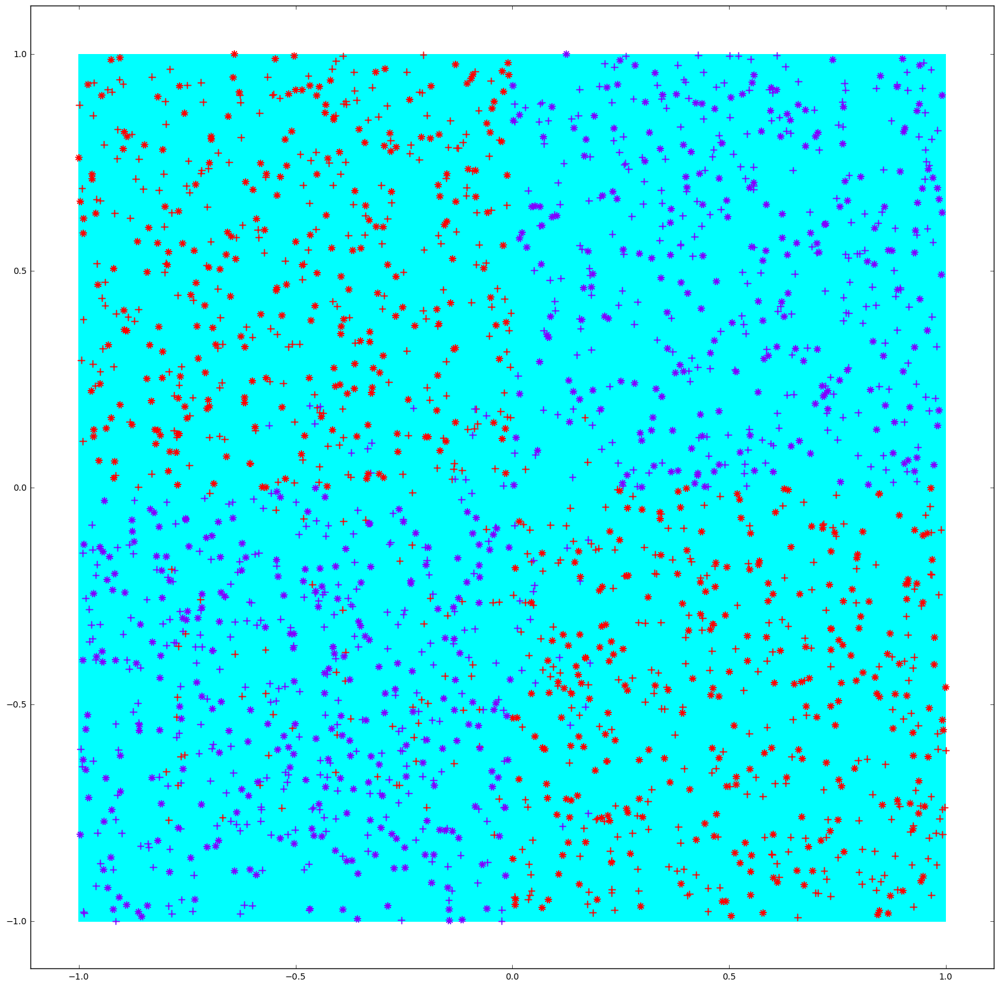

In [19]:
# 1. Precisión con distribución uniforme y activación relu
model = Sequential()
model.add(Dense(1, input_dim=X_train1.shape[1], init='uniform', activation='relu'))
model.compile(optimizer=SGD(lr=1), loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train1, Y_train1, nb_epoch=50, batch_size=100, verbose=1)
valores_entrenamiento = model.evaluate(X_train1, Y_train1)
precision_entrenamiento = valores_entrenamiento[1]
valores_prueba = model.evaluate(X_test1, Y_test1)
precision_prueba = valores_prueba[1]
print "Para n_h = 1" 
print "Utilizando distribución uniforme y activación relu" 
print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
print "La precisión con los datos de prueba es: ", precision_prueba
plot_classifier(model,X_train1,Y_train1,X_test1,Y_test1,'ann')

Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6932 - acc: 0.5027     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6930 - acc: 0.5682     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6928 - acc: 0.5273     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6923 - acc: 0.5109     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6922 - acc: 0.5045     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6938 - acc: 0.5255     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.6932 - acc: 0.5155     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.6927 - acc: 0.5036     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.6922 - acc: 0.5245     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.6919 - acc: 0.4864     
Epoch 11/50
1100/1100 [==============================] - 0s - loss: 0

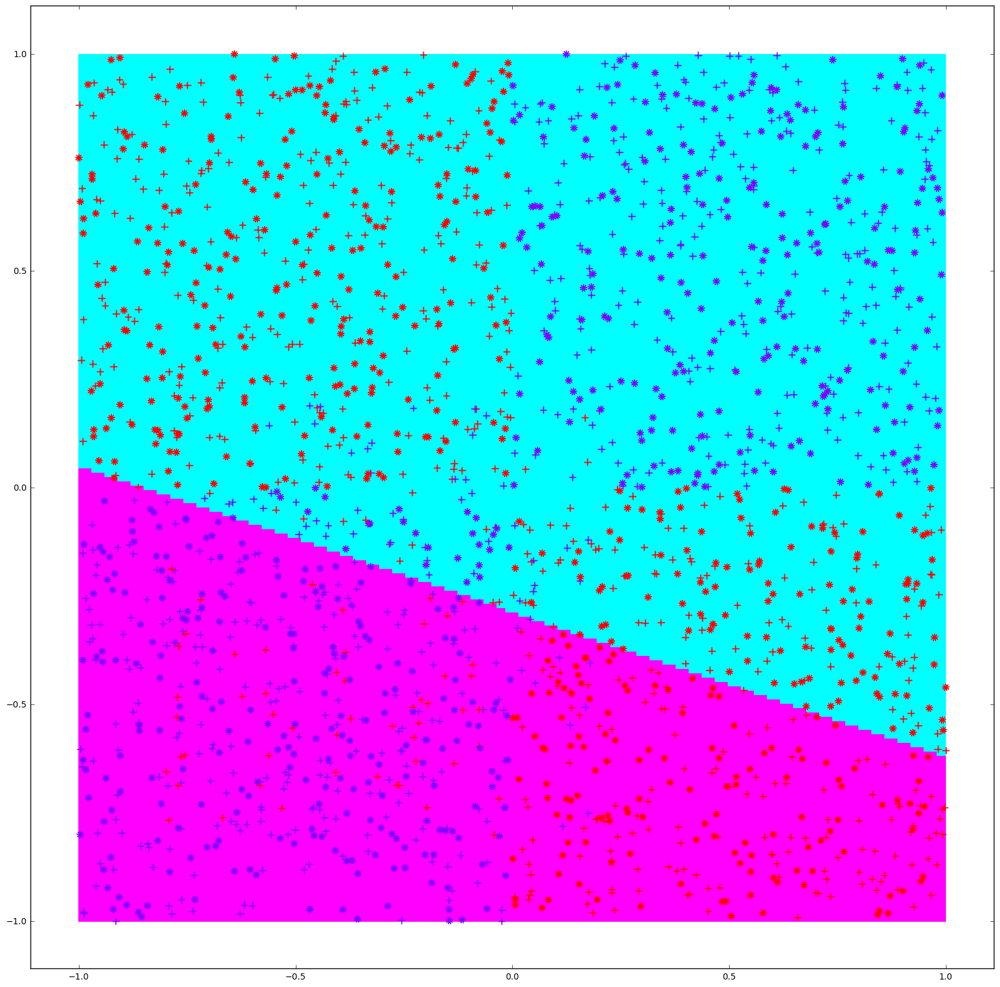

In [17]:
# 2. Precisión con distribución uniforme y activación sigmoid
model = Sequential()
model.add(Dense(1, input_dim=X_train1.shape[1], init='uniform', activation='sigmoid'))
model.compile(optimizer=SGD(lr=1), loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train1, Y_train1, nb_epoch=50, batch_size=100, verbose=1)
valores_entrenamiento = model.evaluate(X_train1, Y_train1)
precision_entrenamiento = valores_entrenamiento[1]
valores_prueba = model.evaluate(X_test1, Y_test1)
precision_prueba = valores_prueba[1]
print "Para n_h = 1" 
print "Utilizando distribución uniforme y activación sigmoid"
print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
print "La precisión con los datos de prueba es: ", precision_prueba
plot_classifier(model,X_train1,Y_train1,X_test1,Y_test1,'ann')

Epoch 1/50
1100/1100 [==============================] - 0s - loss: 7.8103 - acc: 0.0445     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 7.9857 - acc: 0.0000e+00     
Epoch 11/50
1100/1100 [==========

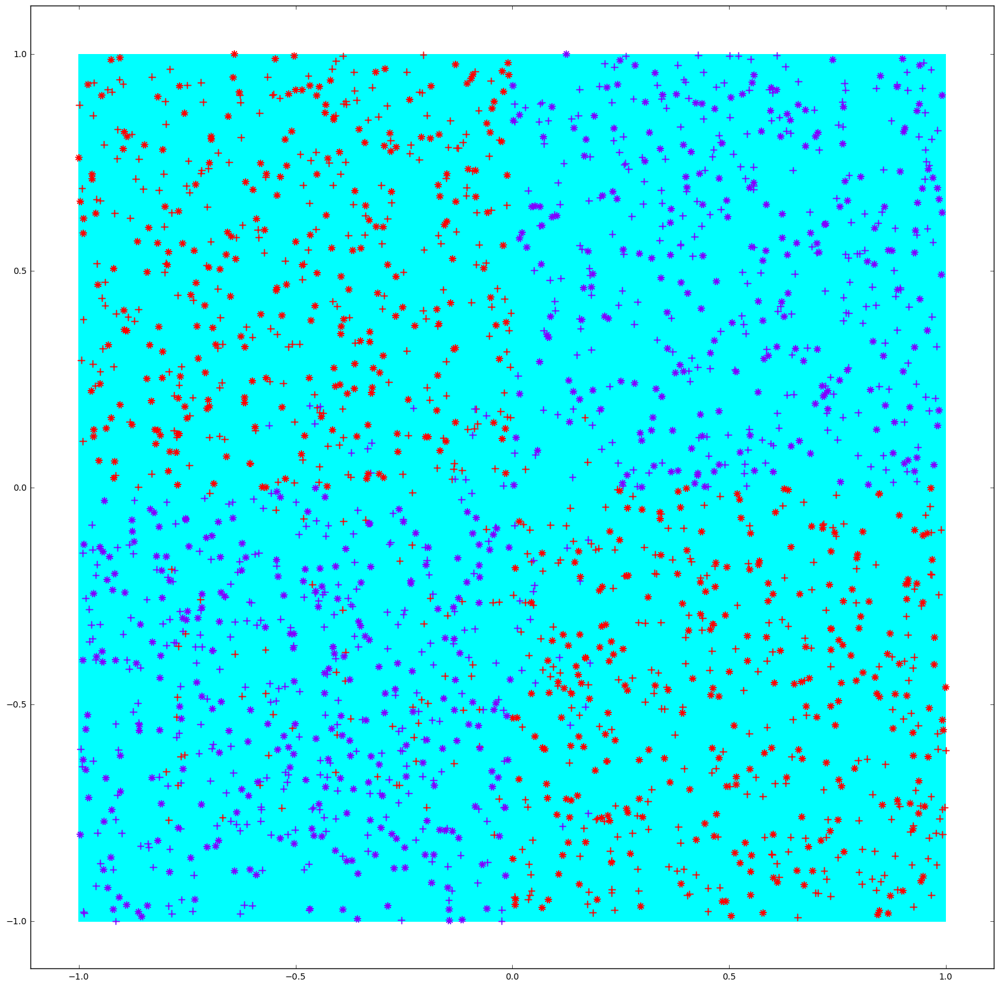

In [18]:
# 3. Precisión con distribución normal y activación relu
model = Sequential()
model.add(Dense(1, input_dim=X_train1.shape[1], init='normal', activation='relu'))
model.compile(optimizer=SGD(lr=1), loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train1, Y_train1, nb_epoch=50, batch_size=100, verbose=1)
valores_entrenamiento = model.evaluate(X_train1, Y_train1)
precision_entrenamiento = valores_entrenamiento[1]
valores_prueba = model.evaluate(X_test1, Y_test1)
precision_prueba = valores_prueba[1]
print "Para n_h = 1" 
print "Utilizando distribución normal y activación relu"
print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
print "La precisión con los datos de prueba es: ", precision_prueba
plot_classifier(model,X_train1,Y_train1,X_test1,Y_test1,'ann')

Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6935 - acc: 0.4909     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6927 - acc: 0.4818     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6933 - acc: 0.5609     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6930 - acc: 0.5236     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6926 - acc: 0.5409     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6935 - acc: 0.4664     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.6926 - acc: 0.5045     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.6917 - acc: 0.5509     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.6934 - acc: 0.4836     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.6921 - acc: 0.5118     
Epoch 11/50
1100/1100 [==============================] - 0s - loss: 0

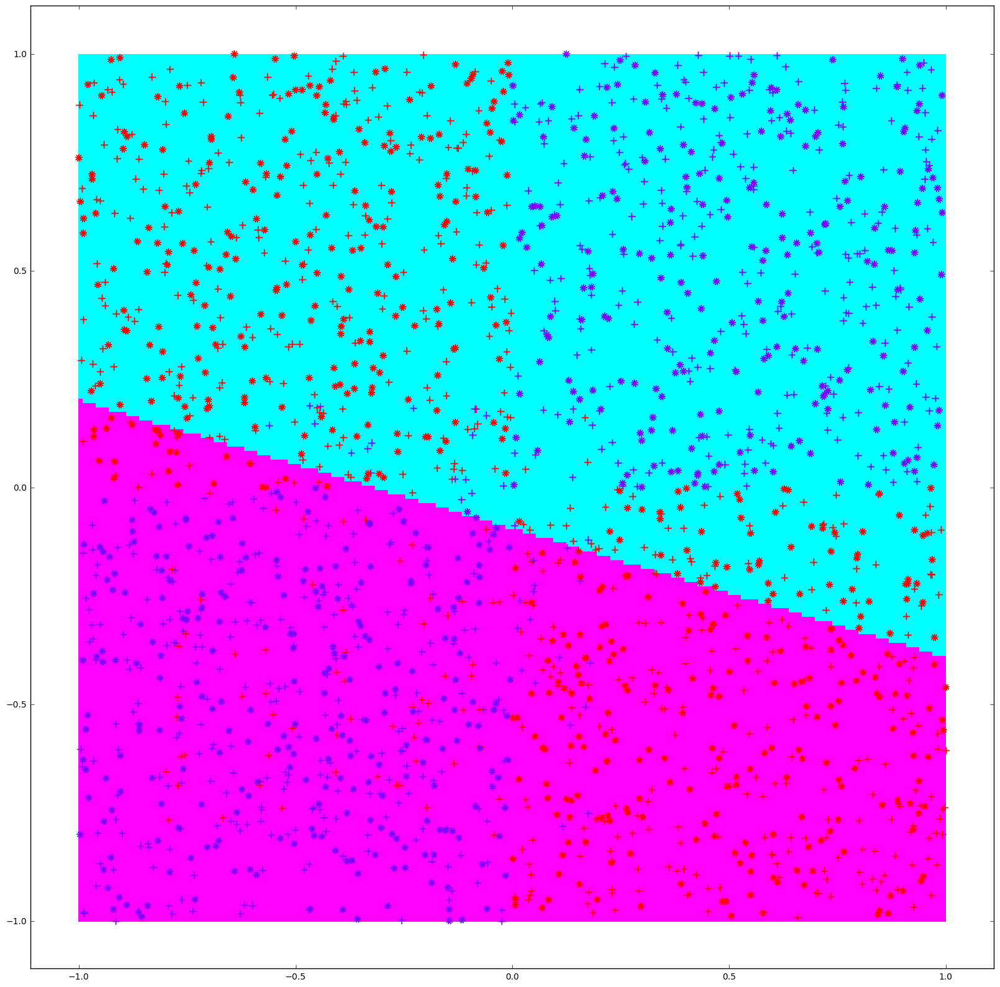

In [20]:
# 4. Precisión con distribución normal y activación sigmoid
model = Sequential()
model.add(Dense(1, input_dim=X_train1.shape[1], init='normal', activation='sigmoid'))
model.compile(optimizer=SGD(lr=1), loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train1, Y_train1, nb_epoch=50, batch_size=100, verbose=1)
valores_entrenamiento = model.evaluate(X_train1, Y_train1)
precision_entrenamiento = valores_entrenamiento[1]
valores_prueba = model.evaluate(X_test1, Y_test1)
precision_prueba = valores_prueba[1]
print "Para n_h = 1" 
print "Utilizando distribución normal y activación sigmoid"
print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
print "La precisión con los datos de prueba es: ", precision_prueba
plot_classifier(model,X_train1,Y_train1,X_test1,Y_test1,'ann')

Revisando las precisiones, se puede encontrar que para la activación RELU, los resultados, tanto para el inicializador de distrubución uniforme y normal son muy desalentadores entregando valores de cero tanto para los datos de entrenamiento como para los datos de prueba. Por otro lado, usando el método de activación sigmoid, los resultados son mejores, pero no superan el 50% de precisión, por lo mismo, utilizar una red neuronal artificial con una sola capa no es suficiente para resolver este problema.

## Pregunta e)

En esta pregunta también se tiene una como objetivo analizar una red neuronal artificial, pero esta vez tendrá 2 capas, la capa original y una capa escondida. Además se irán variando la cantidad de neuronas utilizadas desde 2 hasta 32 en potencias de 2. Para este caso y por motivos de comodidad de dejará el método de activación "relu" de manera fija para la primera capa y el método de activación "sigmoid" de manera fija para la segunda capa, y lo que irá variando será la distribución utilizada para cada capa, que puede ser uniforme o normal:

Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6938 - acc: 0.4973     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6937 - acc: 0.4855     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6929 - acc: 0.4955     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6906 - acc: 0.5245     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6878 - acc: 0.5655     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6786 - acc: 0.5827     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.6621 - acc: 0.6173     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.6369 - acc: 0.6018     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.6128 - acc: 0.6227     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.5954 - acc: 0.6191     
Epoch 11/50
1100/1100 [==============================] - 0s - loss: 0

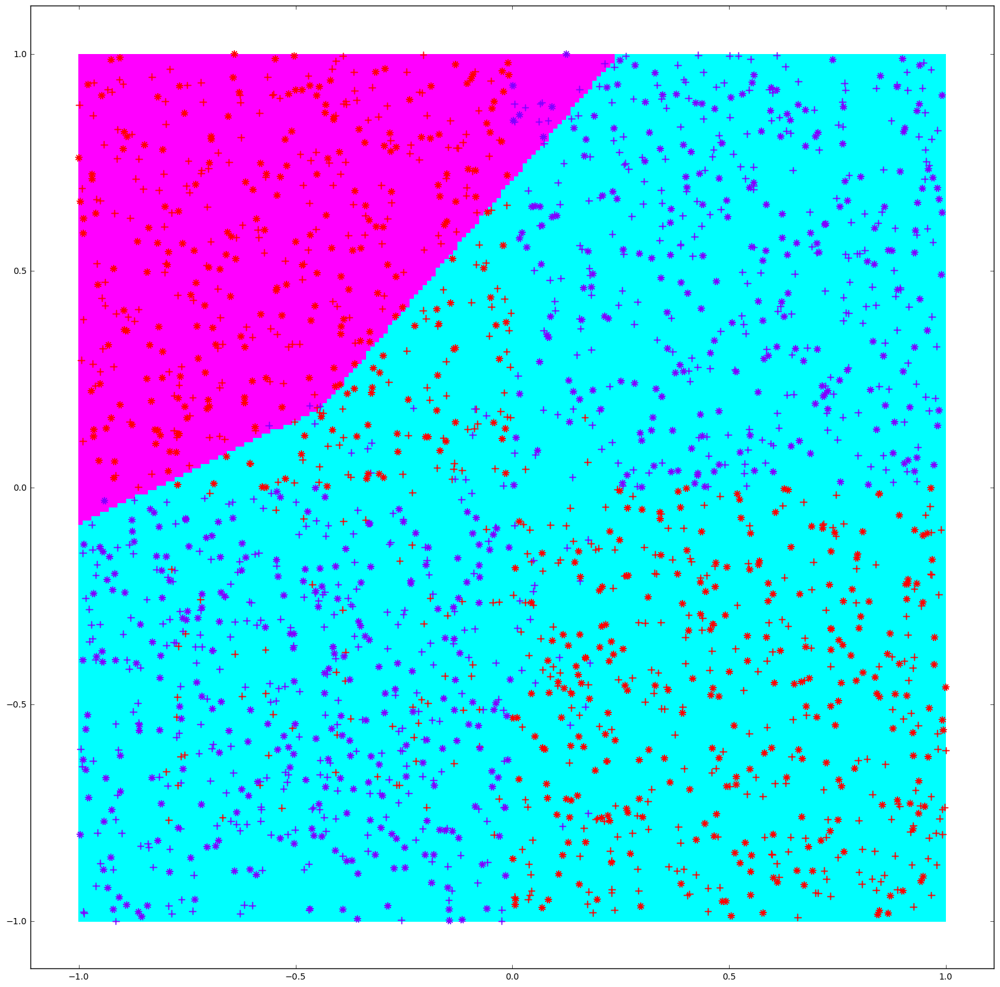



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6932 - acc: 0.5100     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6932 - acc: 0.5009     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6912 - acc: 0.5418     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6857 - acc: 0.5582     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6677 - acc: 0.6355     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6325 - acc: 0.6936     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.5800 - acc: 0.7536     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.5186 - acc: 0.7955     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.4684 - acc: 0.8209     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.4330 - acc: 0.8273     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

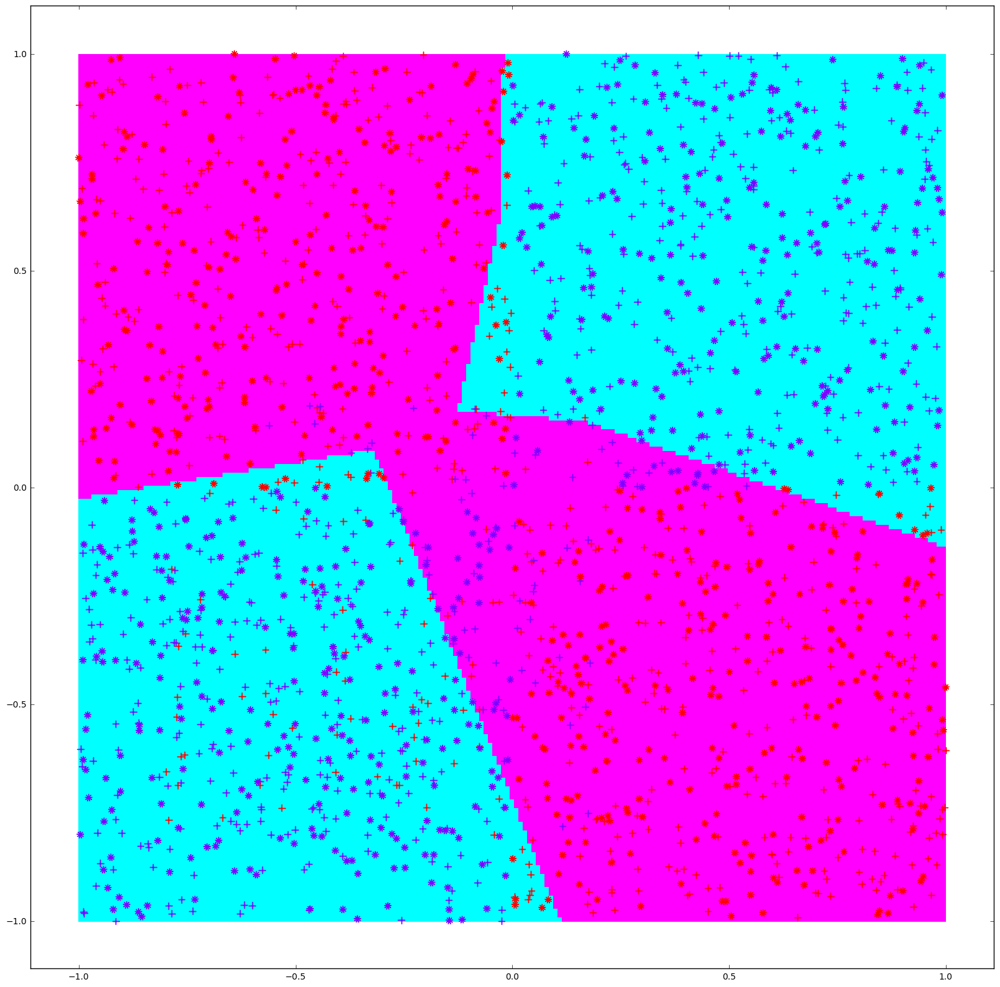



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6936 - acc: 0.5264     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6932 - acc: 0.4845     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6897 - acc: 0.6082     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6805 - acc: 0.6036     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6572 - acc: 0.7927     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6028 - acc: 0.8455     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.5154 - acc: 0.8518     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.4332 - acc: 0.8736     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3916 - acc: 0.8682     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3547 - acc: 0.8818     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

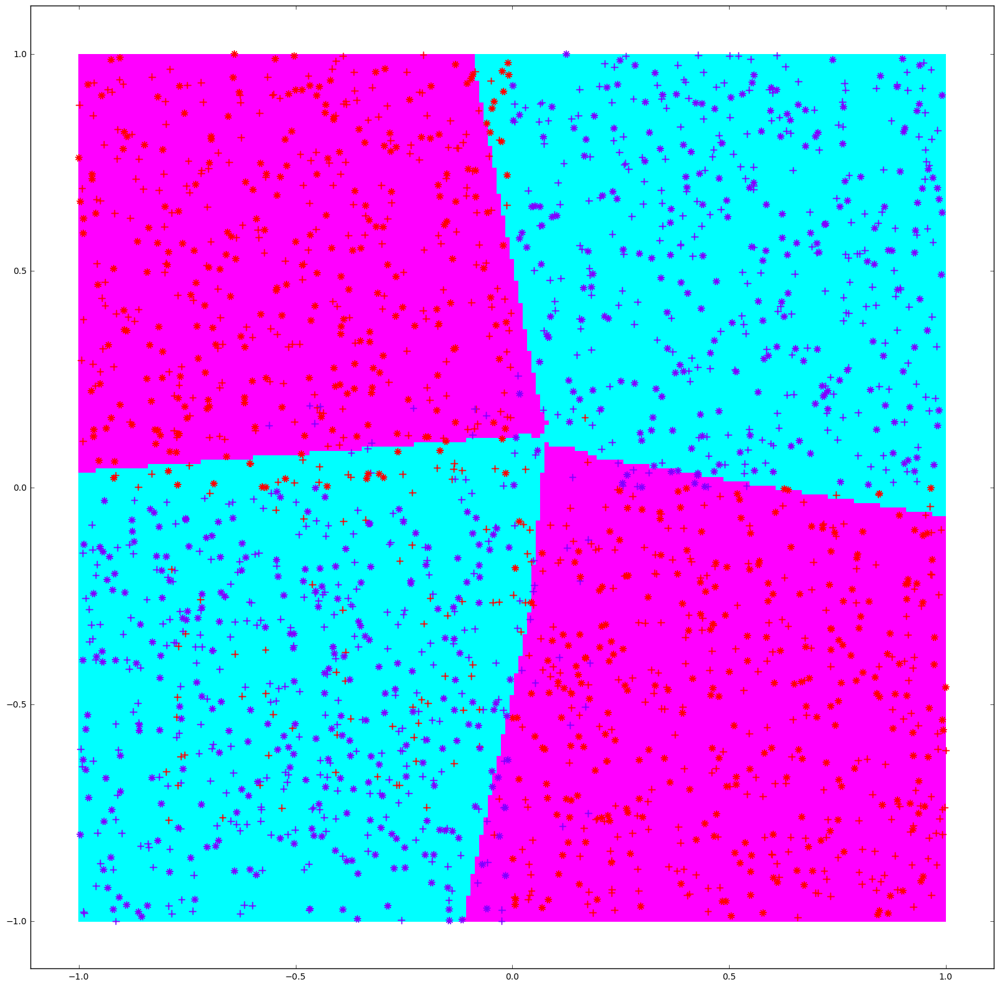



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6935 - acc: 0.4955     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6914 - acc: 0.5509     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6868 - acc: 0.5473     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6761 - acc: 0.6618     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6453 - acc: 0.7800     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.5848 - acc: 0.8364     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.5026 - acc: 0.8582     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.4304 - acc: 0.8627     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3812 - acc: 0.8627     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3554 - acc: 0.8691     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

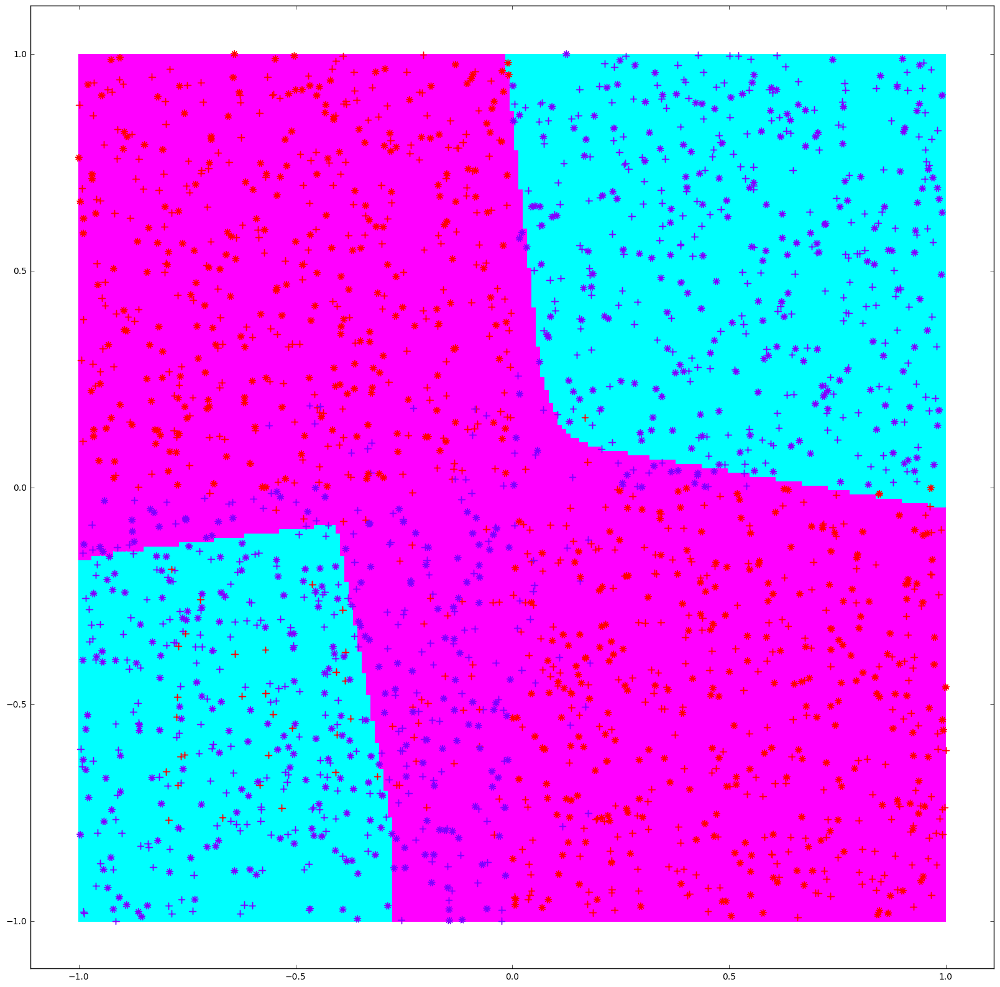



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6927 - acc: 0.4964     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6889 - acc: 0.5191     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6794 - acc: 0.6682     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6519 - acc: 0.7564     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.5940 - acc: 0.8091     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.5130 - acc: 0.8191     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.4375 - acc: 0.8473     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.3863 - acc: 0.8645     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3552 - acc: 0.8755     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3381 - acc: 0.8791     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

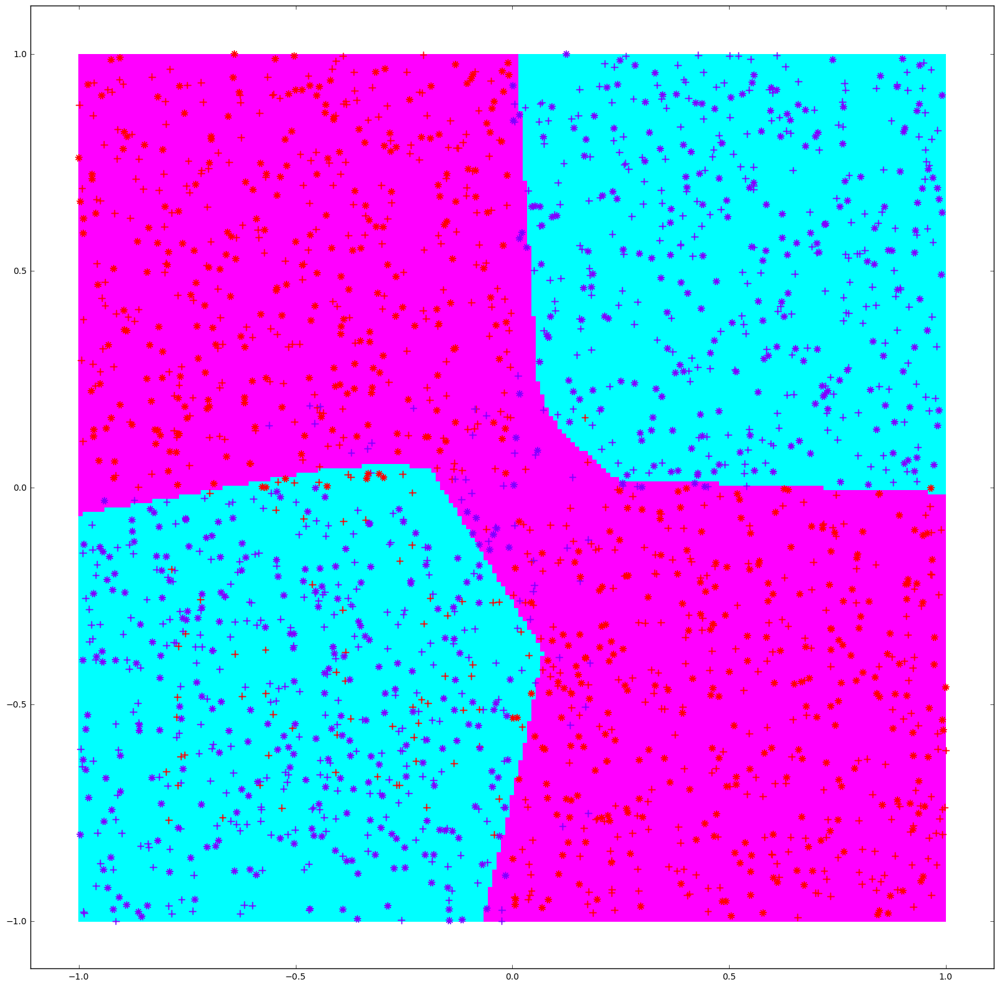

In [21]:
# 1. Precisión con capa 1 uniforme y capa oculta uniforme

errores_entrenamiento_uniform_uniform=[]
errores_prueba_uniform_uniform=[]
for i in range (1,6):
    n_h=2**i
    model = Sequential()
    model.add(Dense(n_h, input_dim=X_train1.shape[1], init='uniform', activation='relu'))
    model.add(Dense(1, init='uniform', activation='sigmoid'))
    model.compile(optimizer=SGD(lr=1), loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(X_train1, Y_train1, nb_epoch=50, batch_size=100, verbose=1)
    
    valores_entrenamiento = model.evaluate(X_train1, Y_train1)
    precision_entrenamiento = valores_entrenamiento[1]
    eeuu=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_uniform_uniform.append(eeuu) #agregando a la lista de errores obtenidos
    
    valores_prueba = model.evaluate(X_test1, Y_test1)
    precision_prueba = valores_prueba[1]
    epuu=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_uniform_uniform.append(epuu) #agregando a la lista de errores obtenidos
    
    print "Para n_h = ", n_h 
    print "Utilizando capa 1 uniforme y capa oculta uniforme"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    plot_classifier(model,X_train1,Y_train1,X_test1,Y_test1,'ann')
    print "\n"

Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6943 - acc: 0.4727     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6926 - acc: 0.5100     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6908 - acc: 0.5400     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6839 - acc: 0.6136     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6638 - acc: 0.5891     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6309 - acc: 0.6218     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.5963 - acc: 0.6573     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.5674 - acc: 0.6782     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.5457 - acc: 0.6809     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.5270 - acc: 0.6845     
Epoch 11/50
1100/1100 [==============================] - 0s - loss: 0

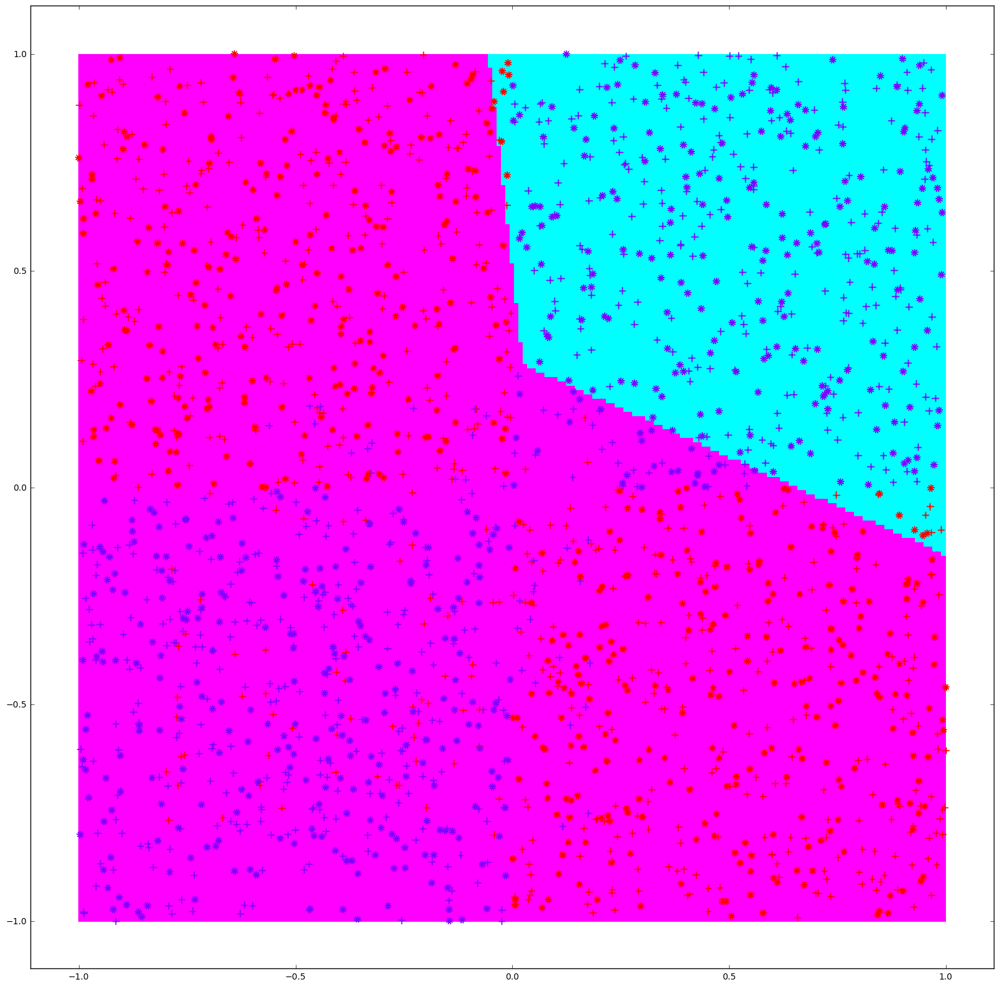



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6939 - acc: 0.4827     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6930 - acc: 0.5236     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6933 - acc: 0.4836     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6901 - acc: 0.5500     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6835 - acc: 0.6182     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6656 - acc: 0.7227     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.6303 - acc: 0.7500     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.5683 - acc: 0.8109     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.4926 - acc: 0.8336     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.4366 - acc: 0.8409     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

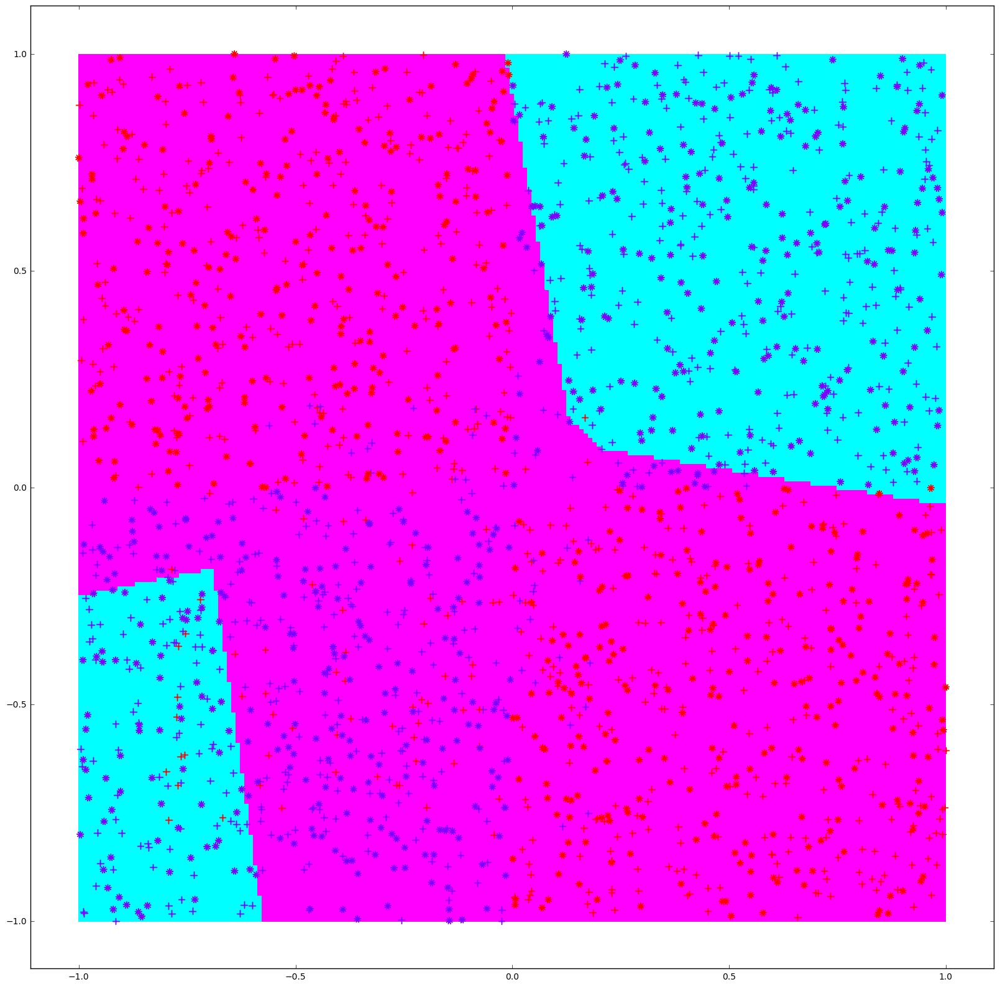



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6935 - acc: 0.5236     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6909 - acc: 0.5609     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6871 - acc: 0.5436     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6726 - acc: 0.6473     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6358 - acc: 0.8236     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.5649 - acc: 0.8136     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.4763 - acc: 0.8609     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.4105 - acc: 0.8755     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3687 - acc: 0.8673     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3474 - acc: 0.8791     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

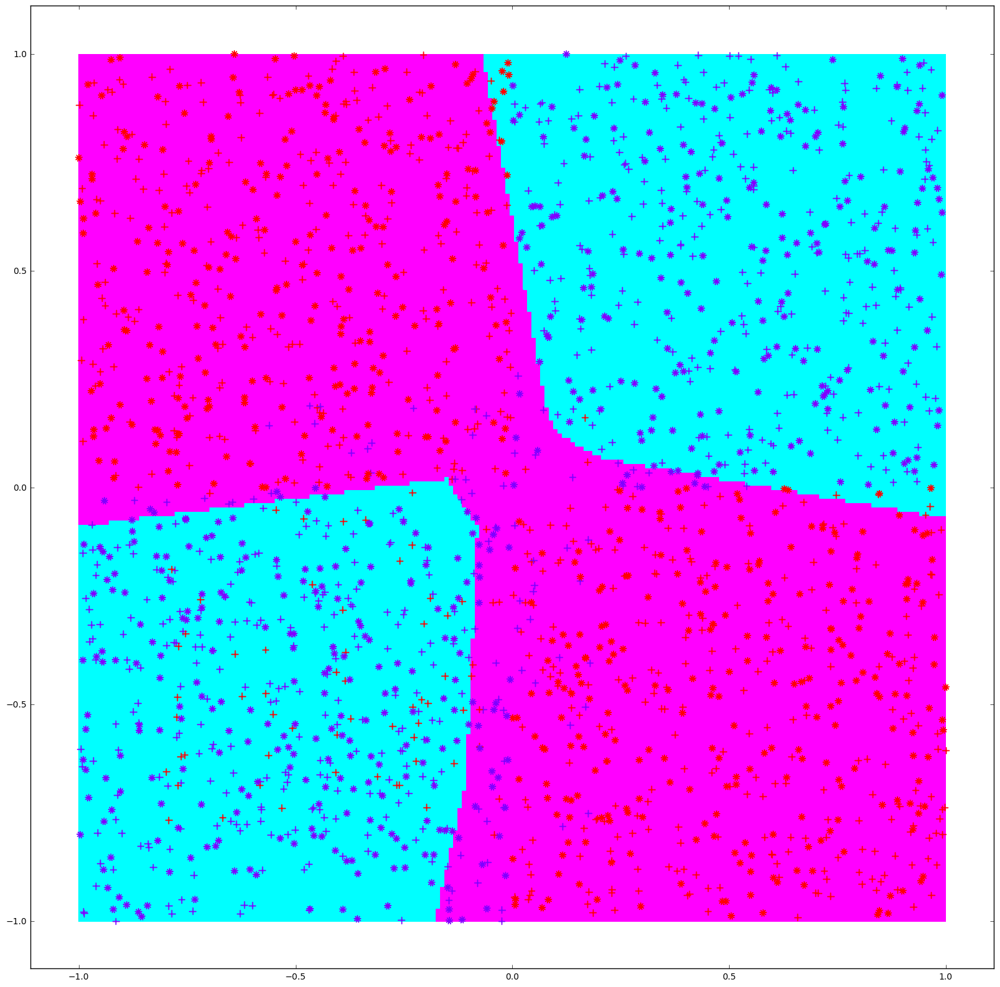



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6926 - acc: 0.5136     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6883 - acc: 0.5791     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6789 - acc: 0.6364     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6597 - acc: 0.6955     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6132 - acc: 0.7973     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.5333 - acc: 0.8555     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.4484 - acc: 0.8736     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.3896 - acc: 0.8818     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3581 - acc: 0.8700     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3396 - acc: 0.8745     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

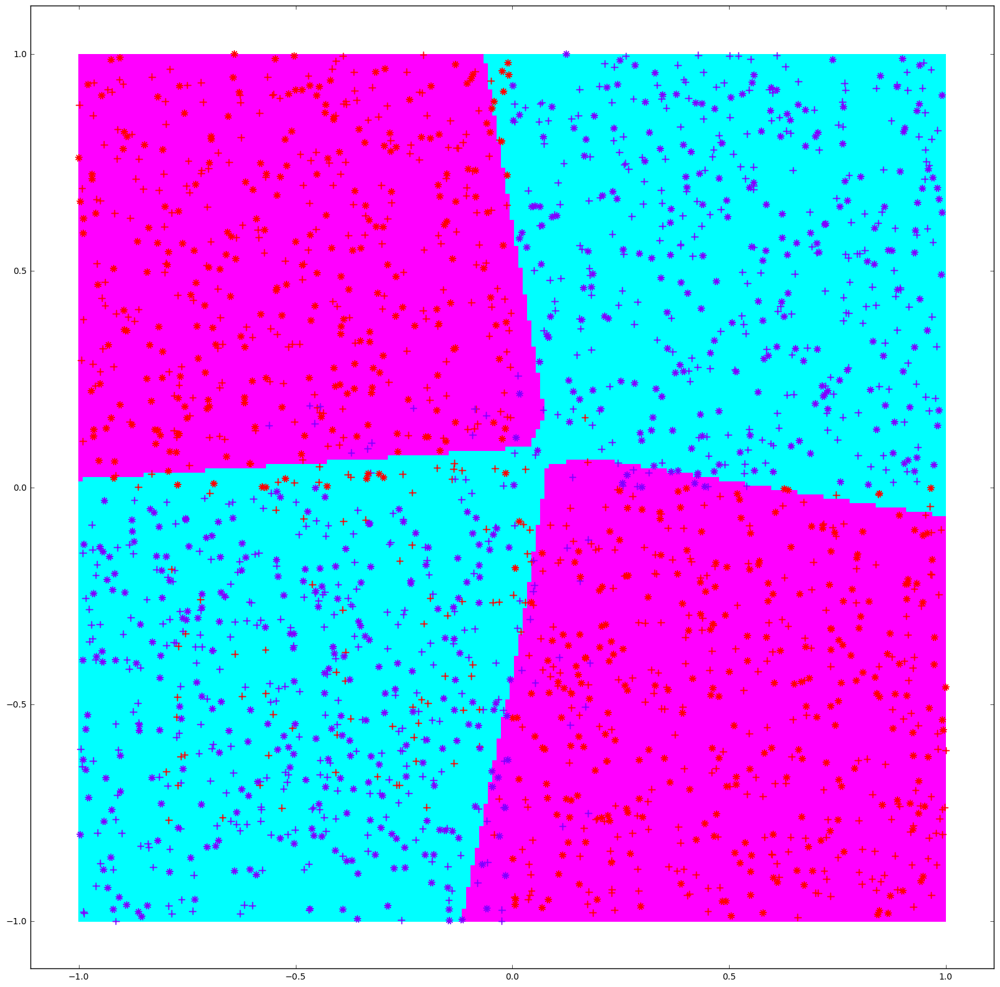



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6915 - acc: 0.5473     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6822 - acc: 0.5955     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6620 - acc: 0.6591     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6157 - acc: 0.7655     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.5483 - acc: 0.7882     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.4680 - acc: 0.8545     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.4081 - acc: 0.8655     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.3702 - acc: 0.8636     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3486 - acc: 0.8745     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3370 - acc: 0.8700     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

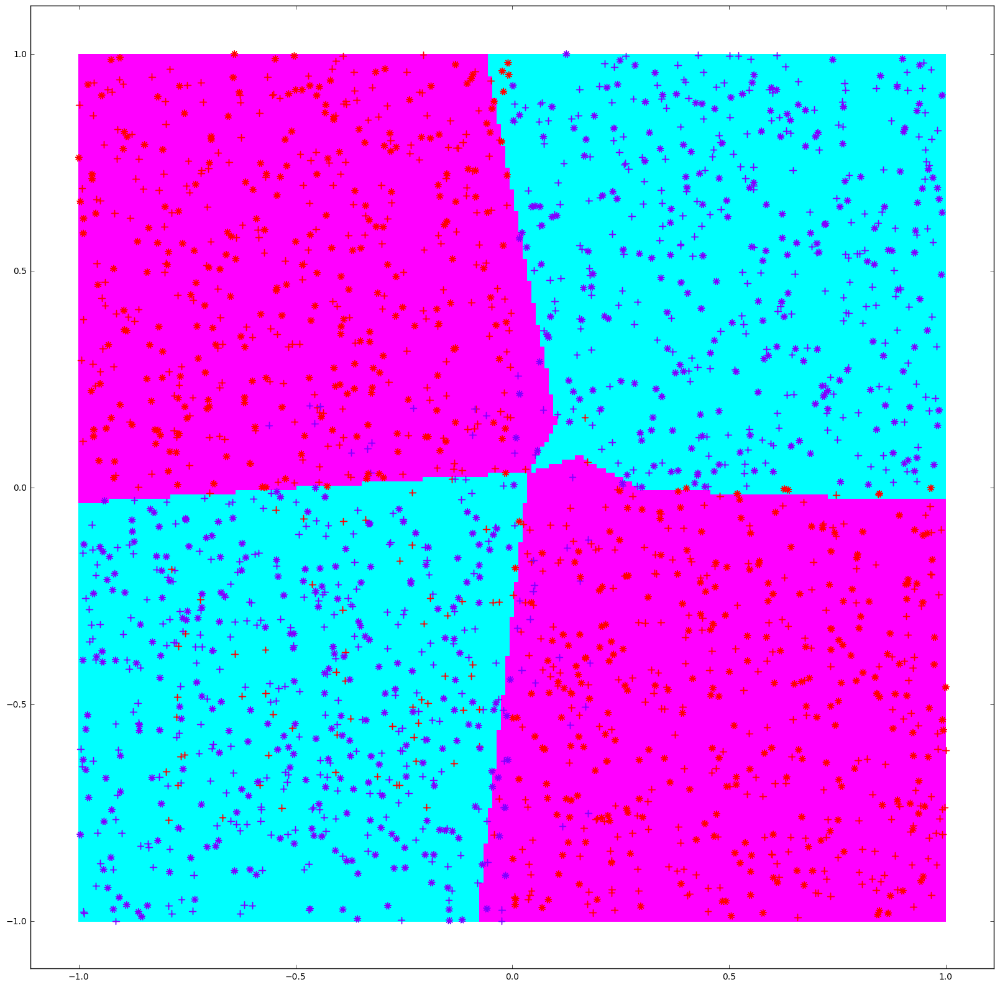

In [25]:
# 2. Precisión con capa 1 uniforme y capa oculta normal

errores_entrenamiento_uniform_normal=[]
errores_prueba_uniform_normal=[]
for i in range (1,6):
    n_h=2**i
    model = Sequential()
    model.add(Dense(n_h, input_dim=X_train1.shape[1], init='uniform', activation='relu'))
    model.add(Dense(1, init='normal', activation='sigmoid'))
    model.compile(optimizer=SGD(lr=1), loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(X_train1, Y_train1, nb_epoch=50, batch_size=100, verbose=1)
    
    valores_entrenamiento = model.evaluate(X_train1, Y_train1)
    precision_entrenamiento = valores_entrenamiento[1]
    eeun=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_uniform_normal.append(eeun) #agregando a la lista de errores obtenidos
    
    valores_prueba = model.evaluate(X_test1, Y_test1)
    precision_prueba = valores_prueba[1]
    epun=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_uniform_normal.append(epun) #agregando a la lista de errores obtenidos
    
    print "Para n_h = ", n_h 
    print "Utilizando capa 1 uniforme y capa oculta normal"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    plot_classifier(model,X_train1,Y_train1,X_test1,Y_test1,'ann')
    print "\n"

Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6945 - acc: 0.4900     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6933 - acc: 0.4873     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6923 - acc: 0.5355     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6908 - acc: 0.5382     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6843 - acc: 0.5636     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6734 - acc: 0.5664     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.6585 - acc: 0.5964     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.6459 - acc: 0.5991     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.6317 - acc: 0.6082     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.6229 - acc: 0.6264     
Epoch 11/50
1100/1100 [==============================] - 0s - loss: 0

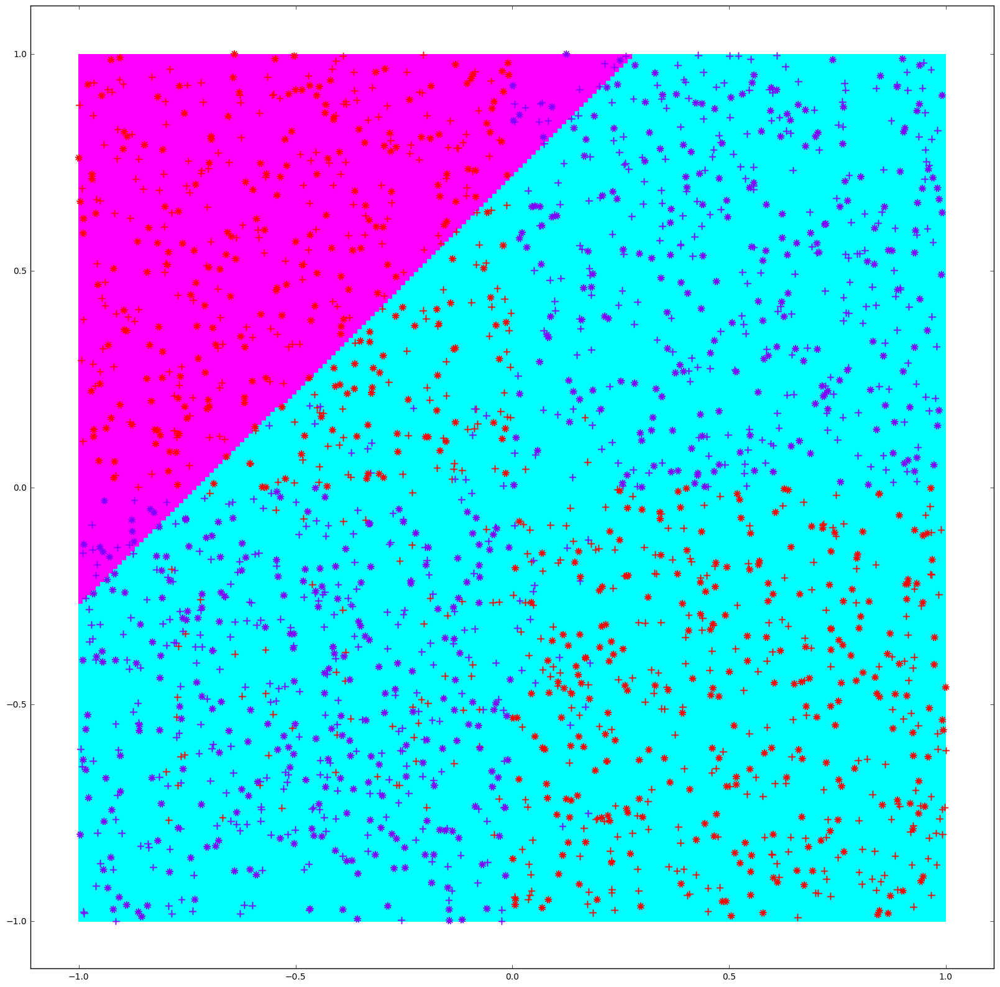



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6946 - acc: 0.4718     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6942 - acc: 0.4782     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6902 - acc: 0.5409     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6809 - acc: 0.5655     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6599 - acc: 0.6082     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6235 - acc: 0.6636     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.5779 - acc: 0.7345     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.5235 - acc: 0.7864     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.4716 - acc: 0.8036     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.4405 - acc: 0.8155     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

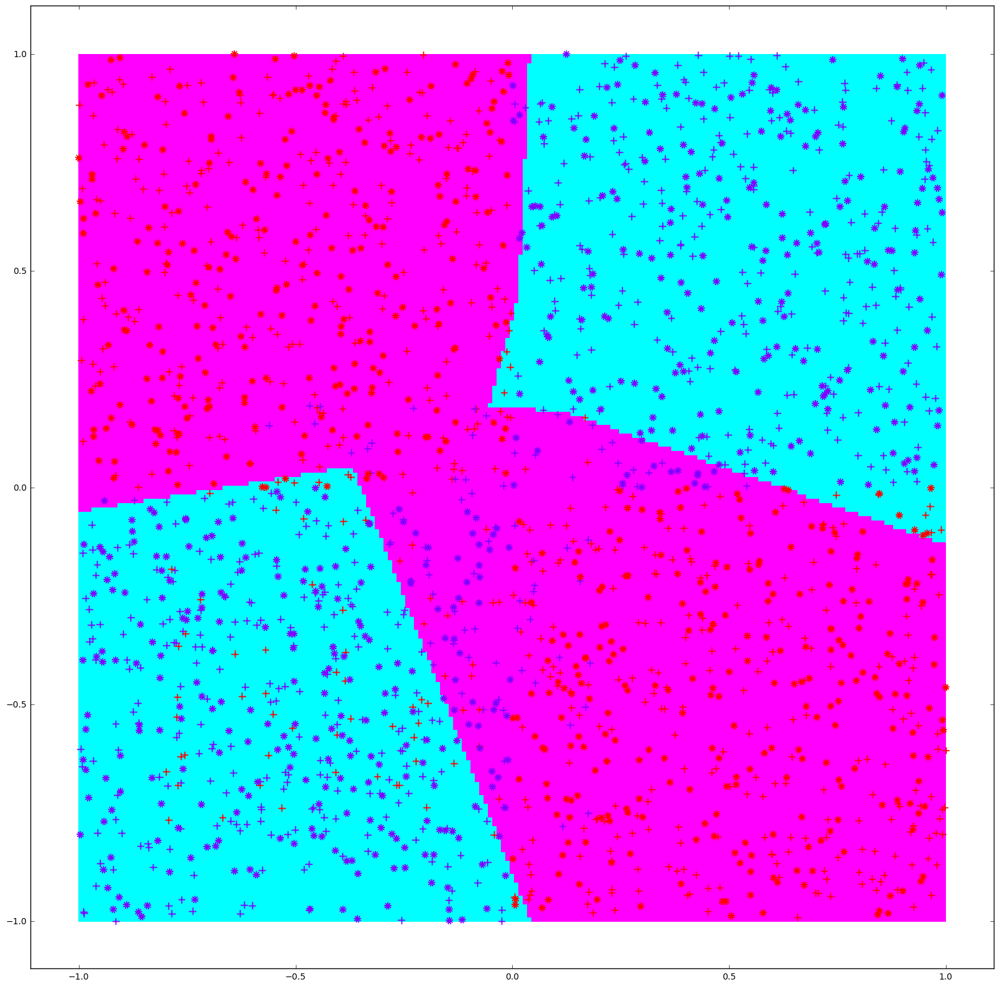



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6941 - acc: 0.4655     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6909 - acc: 0.5773     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6804 - acc: 0.5864     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6606 - acc: 0.6145     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6239 - acc: 0.6400     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.5754 - acc: 0.6736     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.5155 - acc: 0.8173     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.4492 - acc: 0.8491     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3917 - acc: 0.8636     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3598 - acc: 0.8745     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

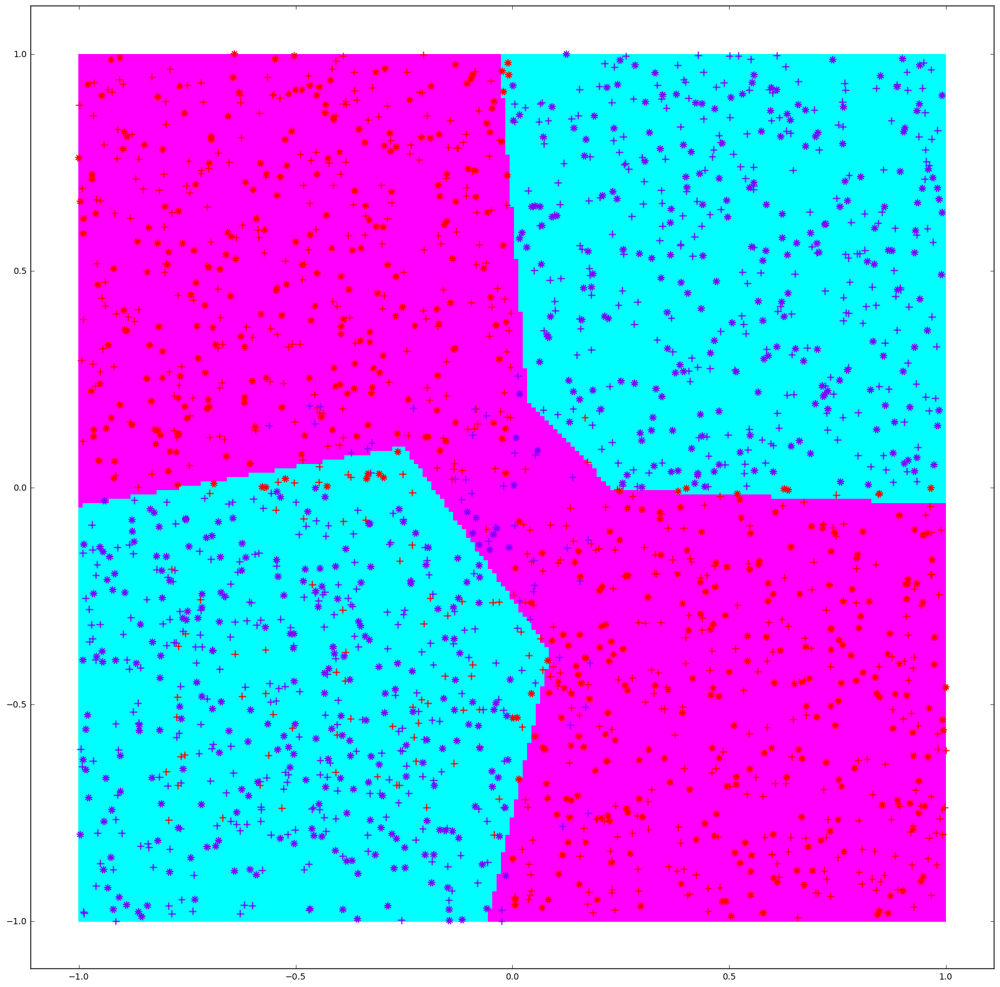



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6935 - acc: 0.4773     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6906 - acc: 0.5300     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6839 - acc: 0.6109     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6630 - acc: 0.6991     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6203 - acc: 0.7345     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.5519 - acc: 0.8055     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.4735 - acc: 0.8327     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.4088 - acc: 0.8627     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3708 - acc: 0.8682     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3473 - acc: 0.8691     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

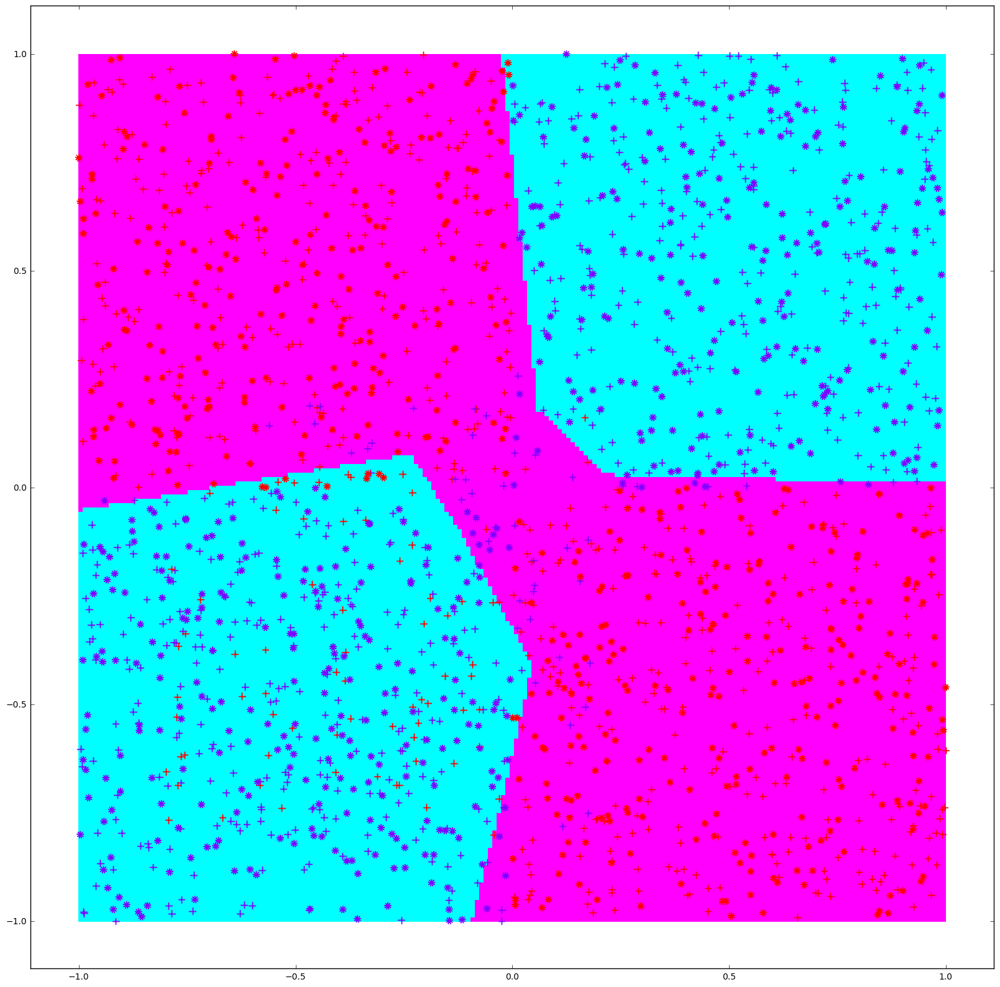



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6916 - acc: 0.5100     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6830 - acc: 0.5955     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6613 - acc: 0.6691     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6181 - acc: 0.7282     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.5534 - acc: 0.7745     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.4842 - acc: 0.8055     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.4257 - acc: 0.8364     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.3822 - acc: 0.8509     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3517 - acc: 0.8582     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3350 - acc: 0.8682     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

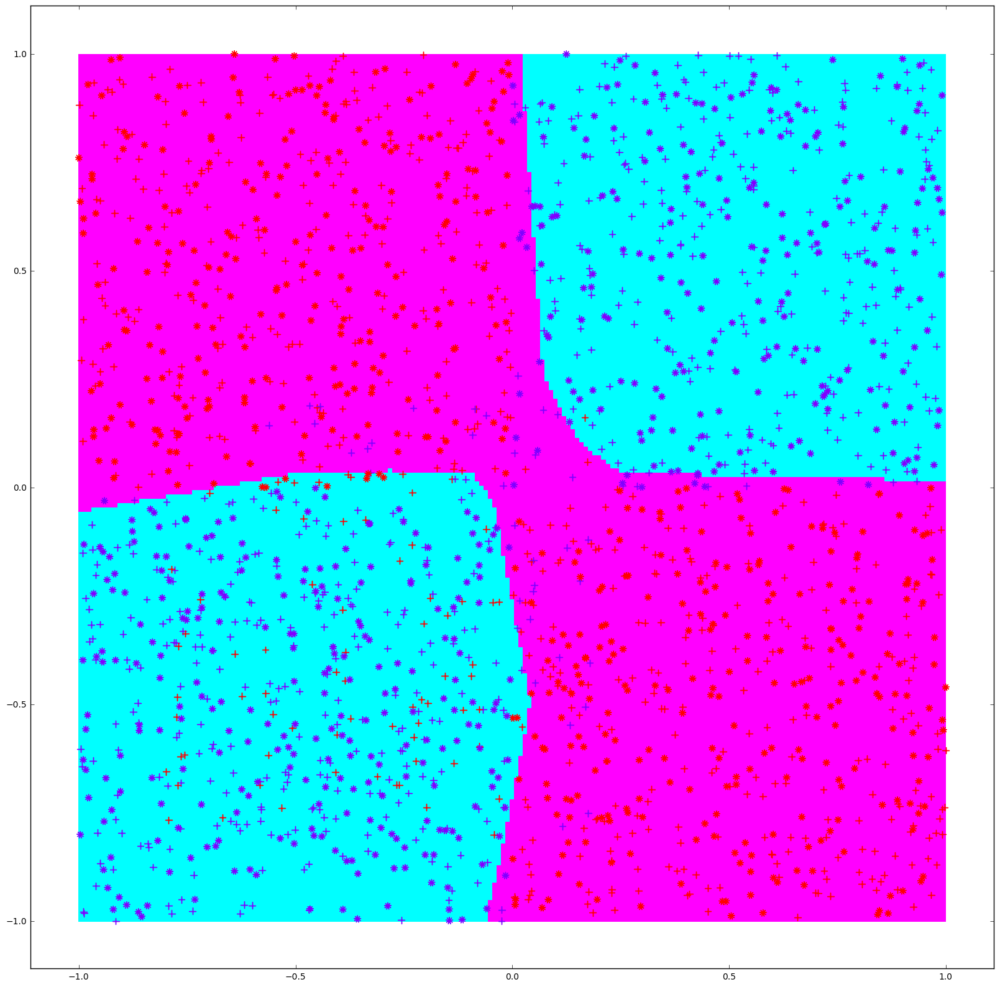

In [24]:
# 3. Precisión con capa 1 normal y capa oculta uniforme

errores_entrenamiento_normal_uniform=[]
errores_prueba_normal_uniform=[]
for i in range (1,6):
    n_h=2**i
    model = Sequential()
    model.add(Dense(n_h, input_dim=X_train.shape[1], init='normal', activation='relu'))
    model.add(Dense(1, init='uniform', activation='sigmoid'))
    model.compile(optimizer=SGD(lr=1), loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(X_train1, Y_train1, nb_epoch=50, batch_size=100, verbose=1)
    
    valores_entrenamiento = model.evaluate(X_train1, Y_train1)
    precision_entrenamiento = valores_entrenamiento[1]
    eenu=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_normal_uniform.append(eenu) #agregando a la lista de errores obtenidos
    
    valores_prueba = model.evaluate(X_test1, Y_test1)
    precision_prueba = valores_prueba[1]
    epnu=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_normal_uniform.append(epnu) #agregando a la lista de errores obtenidos
    
    print "Para n_h = ", n_h 
    print "Utilizando capa 1 normal y capa 2 uniforme"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    plot_classifier(model,X_train1,Y_train1,X_test1,Y_test1,'ann')
    print "\n"

Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6940 - acc: 0.4864     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6932 - acc: 0.5273     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6927 - acc: 0.5000     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6883 - acc: 0.5500     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6746 - acc: 0.6164     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.6454 - acc: 0.6155     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.6026 - acc: 0.6391     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.5645 - acc: 0.6582     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.5384 - acc: 0.6745     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.5205 - acc: 0.6773     
Epoch 11/50
1100/1100 [==============================] - 0s - loss: 0

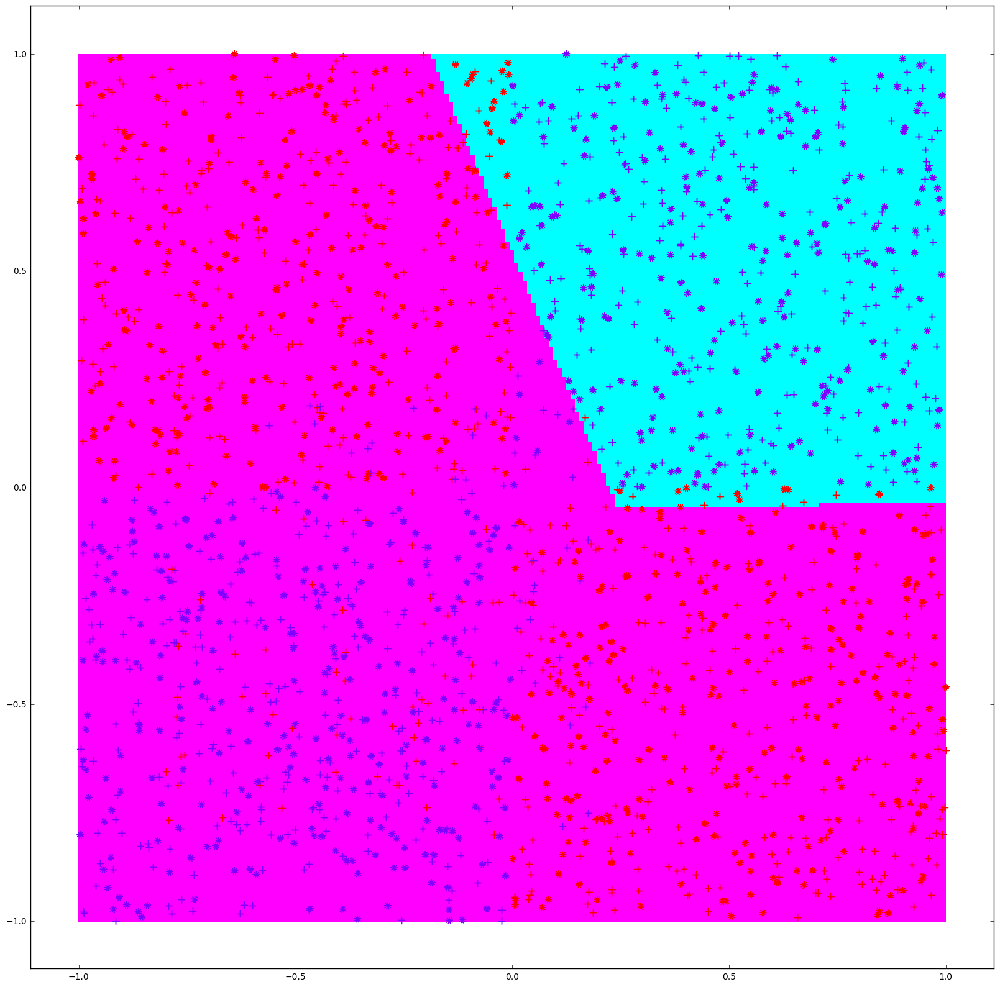



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6935 - acc: 0.5036     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6920 - acc: 0.5427     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6867 - acc: 0.5245     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6715 - acc: 0.6327     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.6407 - acc: 0.6882     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.5960 - acc: 0.7300     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.5466 - acc: 0.7727     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.5021 - acc: 0.7873     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.4742 - acc: 0.7945     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.4591 - acc: 0.7855     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

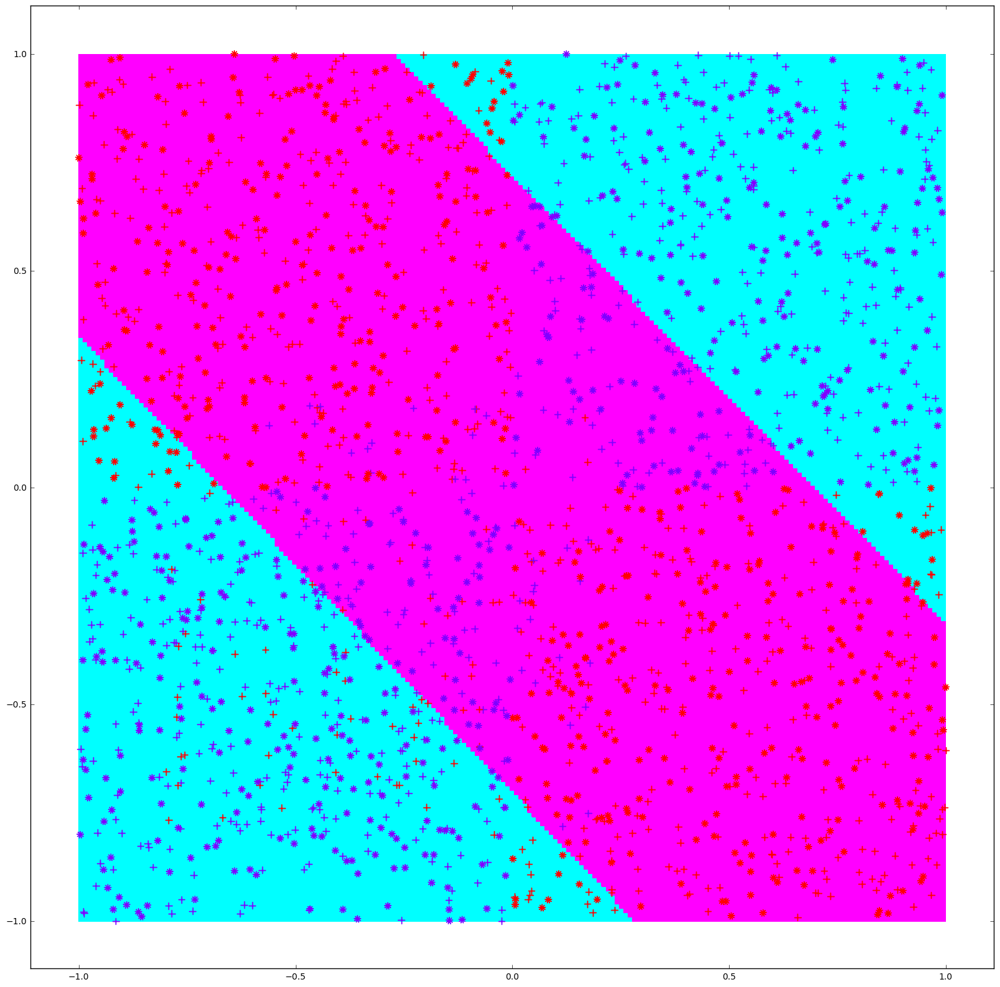



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6931 - acc: 0.4909     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6887 - acc: 0.6000     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6766 - acc: 0.6445     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6468 - acc: 0.6945     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.5929 - acc: 0.7173     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.5278 - acc: 0.7618     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.4671 - acc: 0.8045     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.4210 - acc: 0.8282     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3867 - acc: 0.8391     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3644 - acc: 0.8491     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

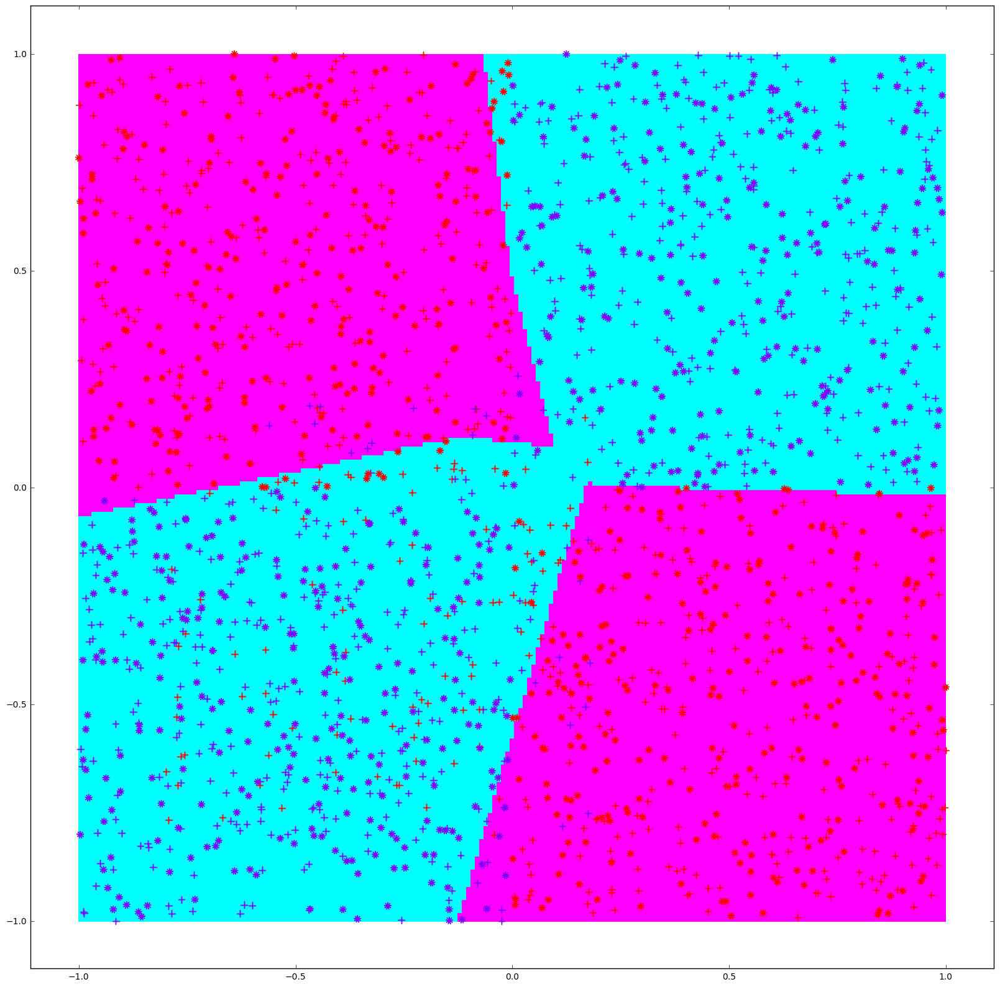



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6915 - acc: 0.5127     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6891 - acc: 0.5473     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6758 - acc: 0.7082     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.6470 - acc: 0.7645     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.5845 - acc: 0.8182     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.4984 - acc: 0.8727     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.4232 - acc: 0.8736     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.3795 - acc: 0.8727     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3538 - acc: 0.8700     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3367 - acc: 0.8836     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

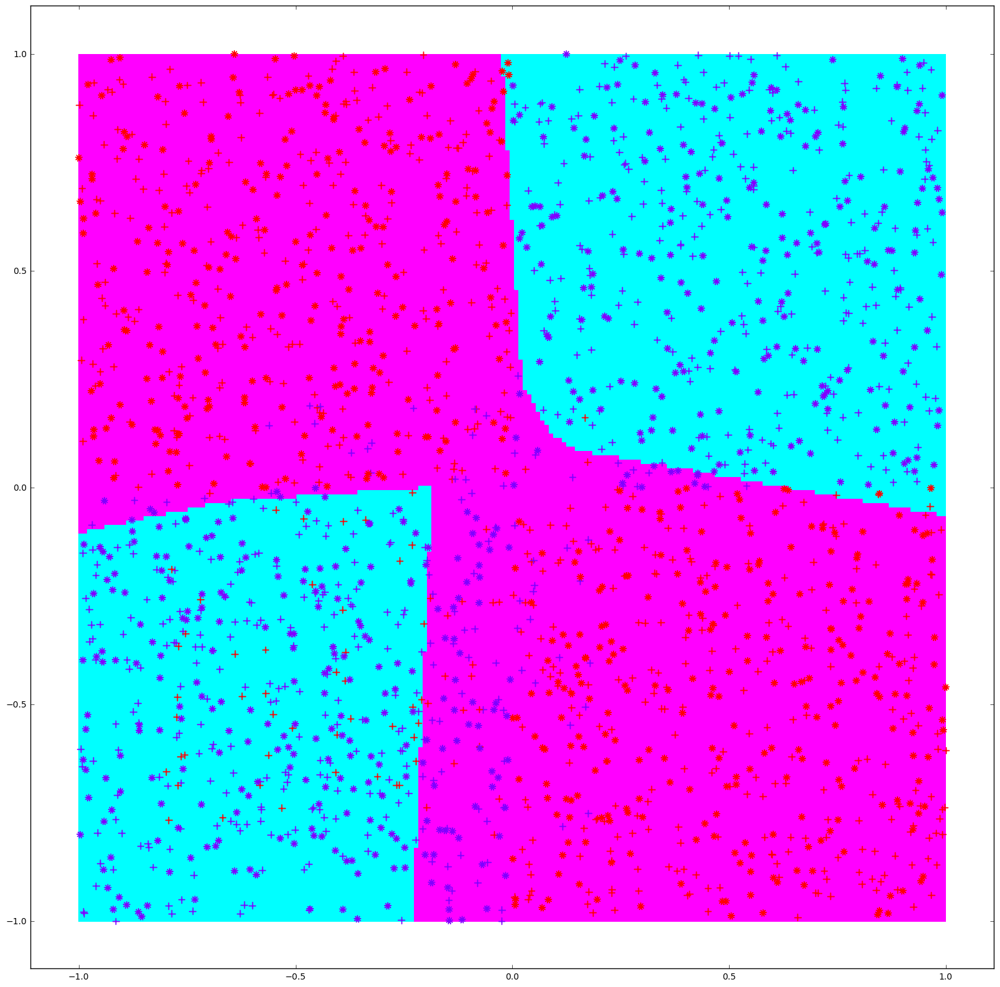



Epoch 1/50
1100/1100 [==============================] - 0s - loss: 0.6908 - acc: 0.5409     
Epoch 2/50
1100/1100 [==============================] - 0s - loss: 0.6791 - acc: 0.6173     
Epoch 3/50
1100/1100 [==============================] - 0s - loss: 0.6507 - acc: 0.7155     
Epoch 4/50
1100/1100 [==============================] - 0s - loss: 0.5884 - acc: 0.8100     
Epoch 5/50
1100/1100 [==============================] - 0s - loss: 0.5047 - acc: 0.8600     
Epoch 6/50
1100/1100 [==============================] - 0s - loss: 0.4257 - acc: 0.8718     
Epoch 7/50
1100/1100 [==============================] - 0s - loss: 0.3778 - acc: 0.8718     
Epoch 8/50
1100/1100 [==============================] - 0s - loss: 0.3485 - acc: 0.8773     
Epoch 9/50
1100/1100 [==============================] - 0s - loss: 0.3342 - acc: 0.8791     
Epoch 10/50
1100/1100 [==============================] - 0s - loss: 0.3259 - acc: 0.8818     
Epoch 11/50
1100/1100 [==============================] - 0s - loss:

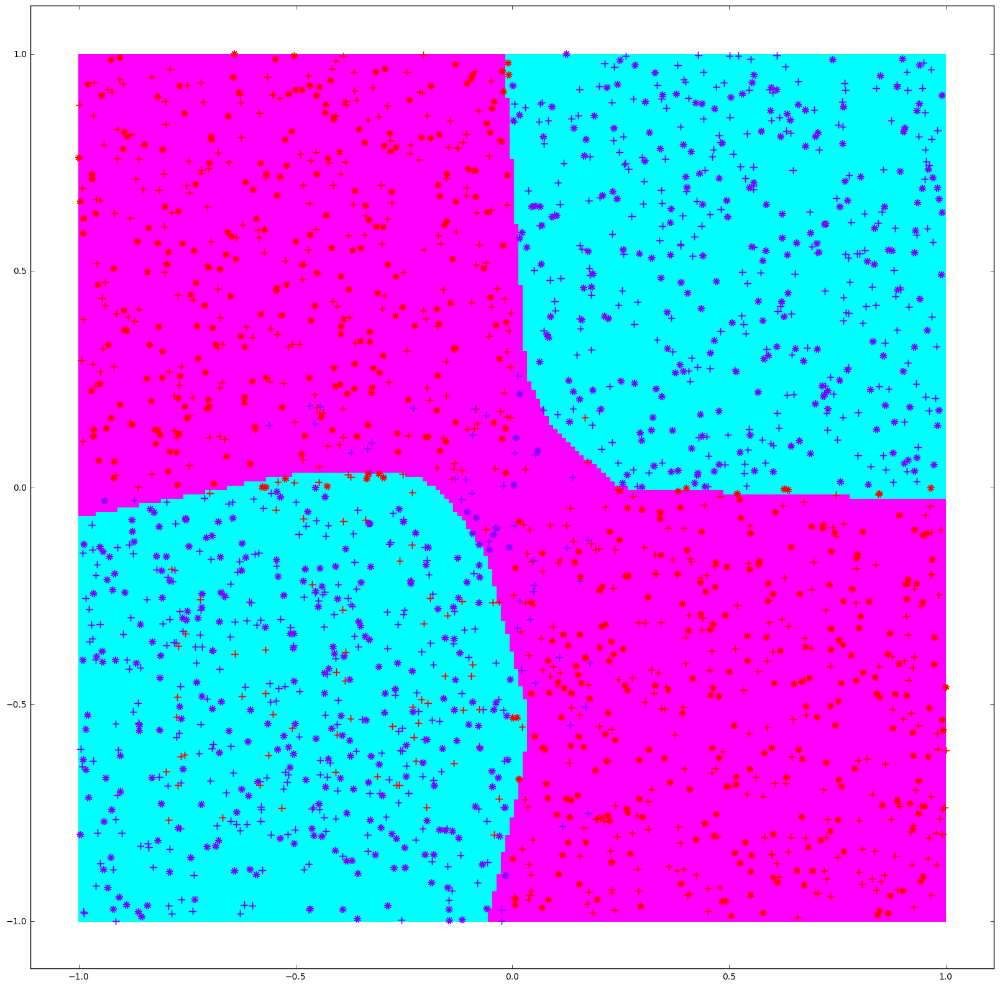

In [26]:
# 4. Precisión con capa 1 normal y capa oculta normal

errores_entrenamiento_normal_normal=[]
errores_prueba_normal_normal=[]
for i in range (1,6):
    n_h=2**i
    model = Sequential()
    model.add(Dense(n_h, input_dim=X_train1.shape[1], init='normal', activation='relu'))
    model.add(Dense(1, init='normal', activation='sigmoid'))
    model.compile(optimizer=SGD(lr=1), loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(X_train1, Y_train1, nb_epoch=50, batch_size=100, verbose=1)
    
    valores_entrenamiento = model.evaluate(X_train1, Y_train1)
    precision_entrenamiento = valores_entrenamiento[1]
    eenn=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_normal_normal.append(eenn) #agregando a la lista de errores obtenidos
    
    valores_prueba = model.evaluate(X_test1, Y_test1)
    precision_prueba = valores_prueba[1]
    epnn=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_normal_normal.append(epnn) #agregando a la lista de errores obtenidos
    
    print "Para n_h = ", n_h 
    print "Utilizando capa 1 normal y capa 2 uniforme"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    plot_classifier(model,X_train1,Y_train1,X_test1,Y_test1,'ann')
    print "\n"

Se puede identificar que las precisiones para estos casos son más cercanas a 1, y va aumentando progresivamente la precisión a medida que aumentan la cantidad de neuronas. Pero podría ocurrir un sobreajuste considerando una gran cantidad de neuronas (en este caso 32) teniendo una cantidad de 1000 datos

Los errores de precisión tanto para los datos de entrenamiento como los datos de prueba se puede obtener para estas variaciones de la red neuronal artificial con la capa oculta. Como la cantidad de neuronas usadas (n_h) va cambiando se usará este parámetro como la variable independiente y los errores de precisión como la variable dependiente. Los gráficos obtenidos son los siguientes:

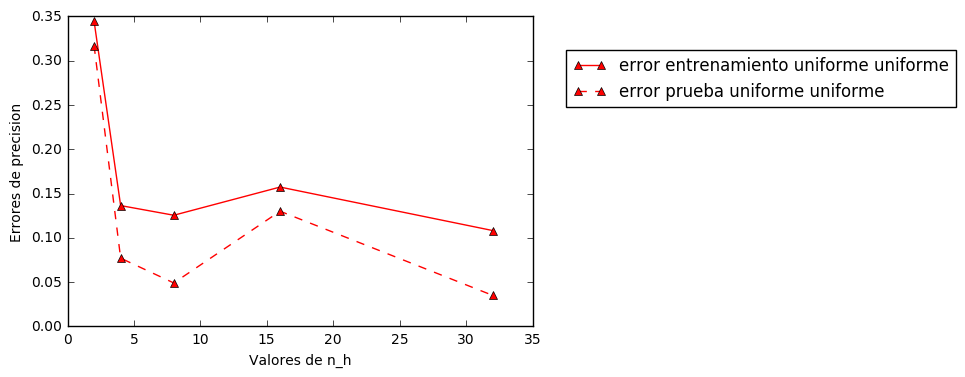

In [27]:
#Errores para capa 1 uniforme y capa oculta uniforme
plt.plot([2,4,8,16,32], errores_entrenamiento_uniform_uniform, 'r^-', label='error entrenamiento uniforme uniforme')
plt.plot([2,4,8,16,32], errores_prueba_uniform_uniform, 'r^--', label='error prueba uniforme uniforme')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_h')
plt.ylabel('Errores de precision')
plt.show()

Se puede ver que con 8 neuronas se tiene el más bajo error de precisión para los datos, y que para 16 neuronas comienza a bajar la precisión, pero con 32 neuronas la precisión es muy buena, pero considerando que se haya producido el fenómeno de overfitting o sobreajuste.

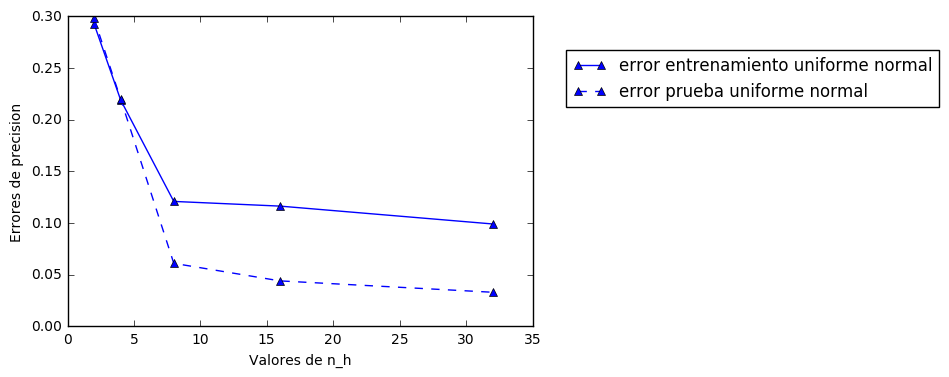

In [28]:
#Errores para capa 1 uniforme y capa oculta normal
plt.plot([2,4,8,16,32], errores_entrenamiento_uniform_normal, 'b^-', label='error entrenamiento uniforme normal')
plt.plot([2,4,8,16,32], errores_prueba_uniform_normal, 'b^--', label='error prueba uniforme normal')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_h')
plt.ylabel('Errores de precision')
plt.show()

En este gráfico se puede apreciar que los errores disminuyen rápidamente hasta llegar a las 8 neuronas, para luego disminuir de manera progresiva y lenta, esto puede deberse al fenómeno de sobreajuste de datos.

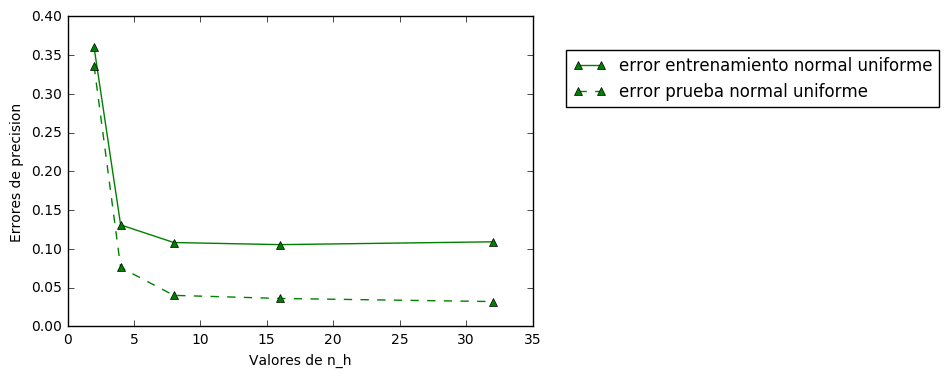

In [29]:
#Errores para capa 1 normal y capa oculta uniforme
plt.plot([2,4,8,16,32], errores_entrenamiento_normal_uniform, 'g^-', label='error entrenamiento normal uniforme')
plt.plot([2,4,8,16,32], errores_prueba_normal_uniform, 'g^--', label='error prueba normal uniforme')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_h')
plt.ylabel('Errores de precision')
plt.show()

Acá se puede identificar que la variación de errores a medida que aumentan la cantidad de neuronas es más pareja, posiblemente con 8 neuronas sea el mejor caso posible porque el efecto de sobreajuste debiese aparecer a partir de las 16 neuronas.

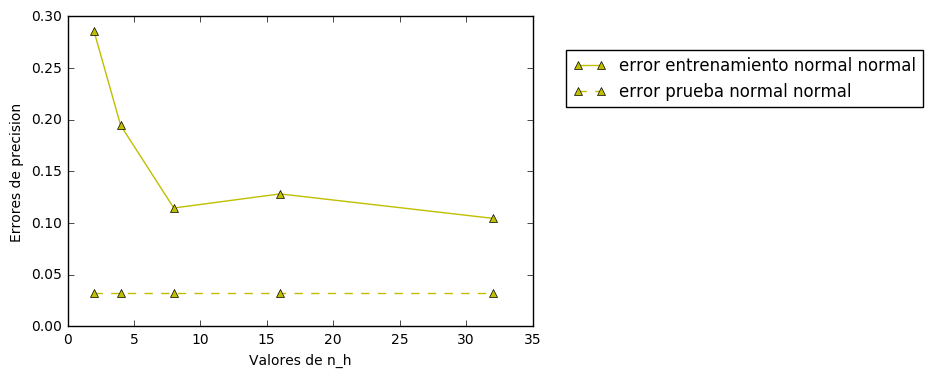

In [30]:
#Errores para capa 1 normal y capa oculta normal
plt.plot([2,4,8,16,32], errores_entrenamiento_normal_normal, 'y^-', label='error entrenamiento normal normal')
plt.plot([2,4,8,16,32], errores_prueba_normal_normal, 'y^--', label='error prueba normal normal')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_h')
plt.ylabel('Errores de precision')
plt.show()

Al igual que con el uso de las capas uniformes, acá se tiene el mejor error con las 8 neuronas, y que el error aumenta con las 16 neuronas, para luego disminuir el error con 32 neuronas. Es notorio el efecto de sobreajuste para cantidades mayores a 8 neuronas.

Adjuntando los gráficos de cada variable mostrada, se obtiene el gráfico siguiente:

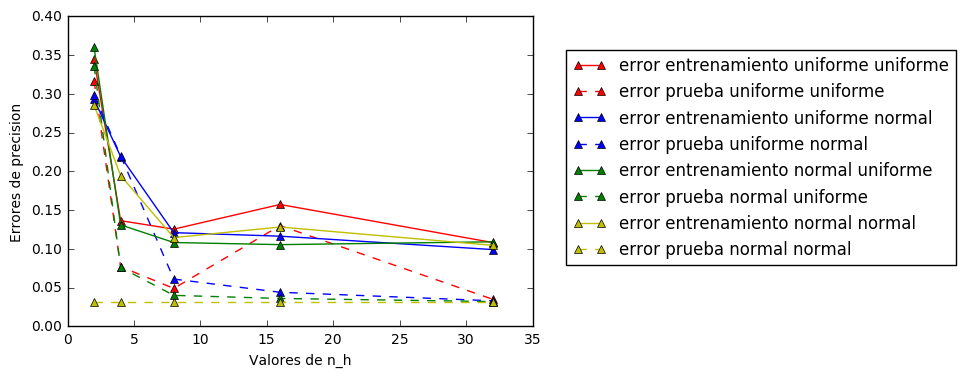

In [31]:
#Los errores adjuntados
plt.plot([2,4,8,16,32], errores_entrenamiento_uniform_uniform, 'r^-', label='error entrenamiento uniforme uniforme')
plt.plot([2,4,8,16,32], errores_prueba_uniform_uniform, 'r^--', label='error prueba uniforme uniforme')
plt.plot([2,4,8,16,32], errores_entrenamiento_uniform_normal, 'b^-', label='error entrenamiento uniforme normal')
plt.plot([2,4,8,16,32], errores_prueba_uniform_normal, 'b^--', label='error prueba uniforme normal')
plt.plot([2,4,8,16,32], errores_entrenamiento_normal_uniform, 'g^-', label='error entrenamiento normal uniforme')
plt.plot([2,4,8,16,32], errores_prueba_normal_uniform, 'g^--', label='error prueba normal uniforme')
plt.plot([2,4,8,16,32], errores_entrenamiento_normal_normal, 'y^-', label='error entrenamiento normal normal')
plt.plot([2,4,8,16,32], errores_prueba_normal_normal, 'y^--', label='error prueba normal normal')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_h')
plt.ylabel('Errores de precision')
plt.show()

Se puede concluir con esto que para las 4 variables de gráficos obtenidos, los mejores rendimientos se tiene con 8 neuronas, y que por lógica solucionaría el problema XOR expuesto al principio. Tener una gran cantidad de neuronas para una baja cantidad de información solo perjudica el rendimiento de la red neuronal artificial, donde igualmente influye la cantidad de capaz utilizadas.

## Pregunta f)

Para realizar esta pregunta se está considerando solamente el árbol de clasificación de un nivel, donde los criterios posibles a utilizar son "gini" y "entropy", y la función de partición a utilizar puede ser "best" o "random". Por lo mismo se obtendrán los valores de precisión para los datos de entrenamiento y errores en base a estas 4 variaciones diferentes de parámetros, los cuales se mostrarán sus respectivos gráficos:

Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.541818181818
La precisión con los datos de prueba es:  0.489


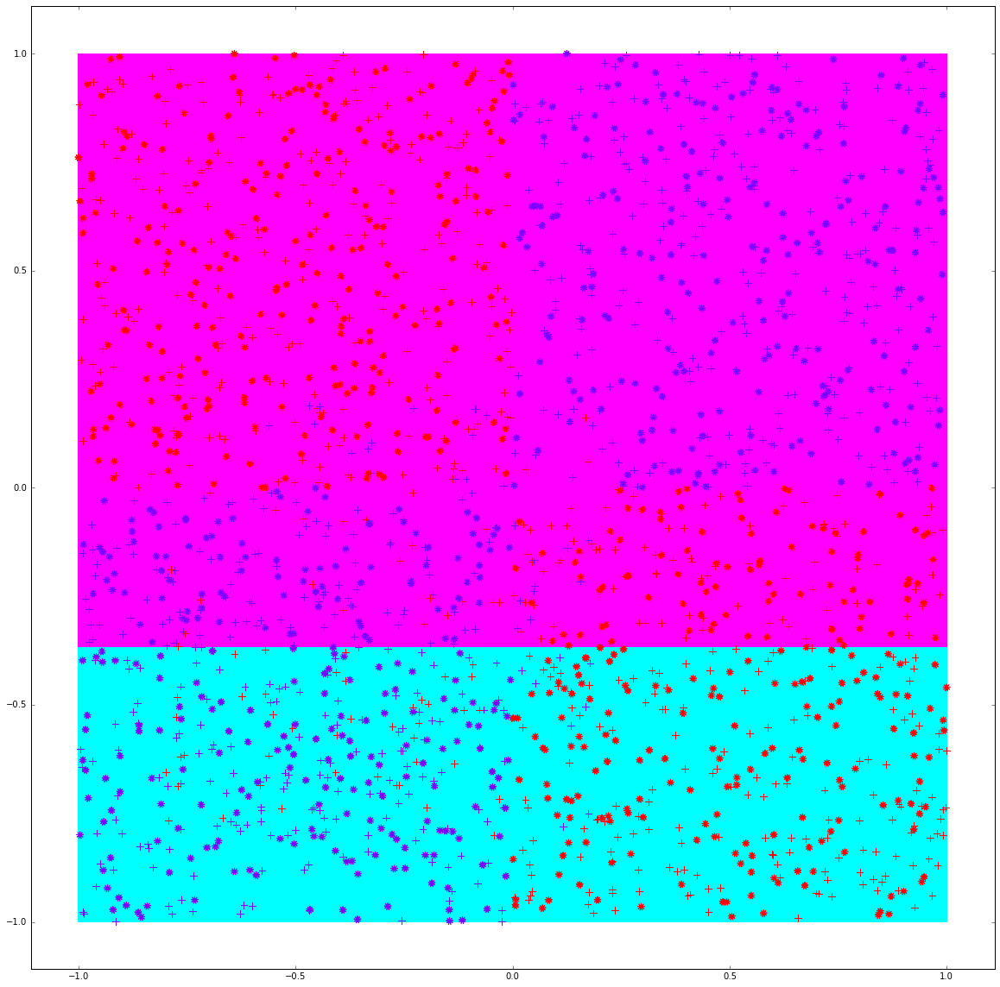

In [9]:
#1. Criterio "Gini" y partición "best"
clf=Tree(criterion='gini',splitter='best',random_state=0,max_depth=1)
clf.fit(X_train,Y_train)
precision_entrenamiento=clf.score(X_train, Y_train)
precision_prueba=clf.score(X_test, Y_test)
print "Utilizando criterio Gini y partición Best"
print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
print "La precisión con los datos de prueba es: ", precision_prueba
#print clf.tree_.max_depth
plot_classifier(clf,X_train,Y_train,X_test,Y_test,'tree')

Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.507272727273
La precisión con los datos de prueba es:  0.491


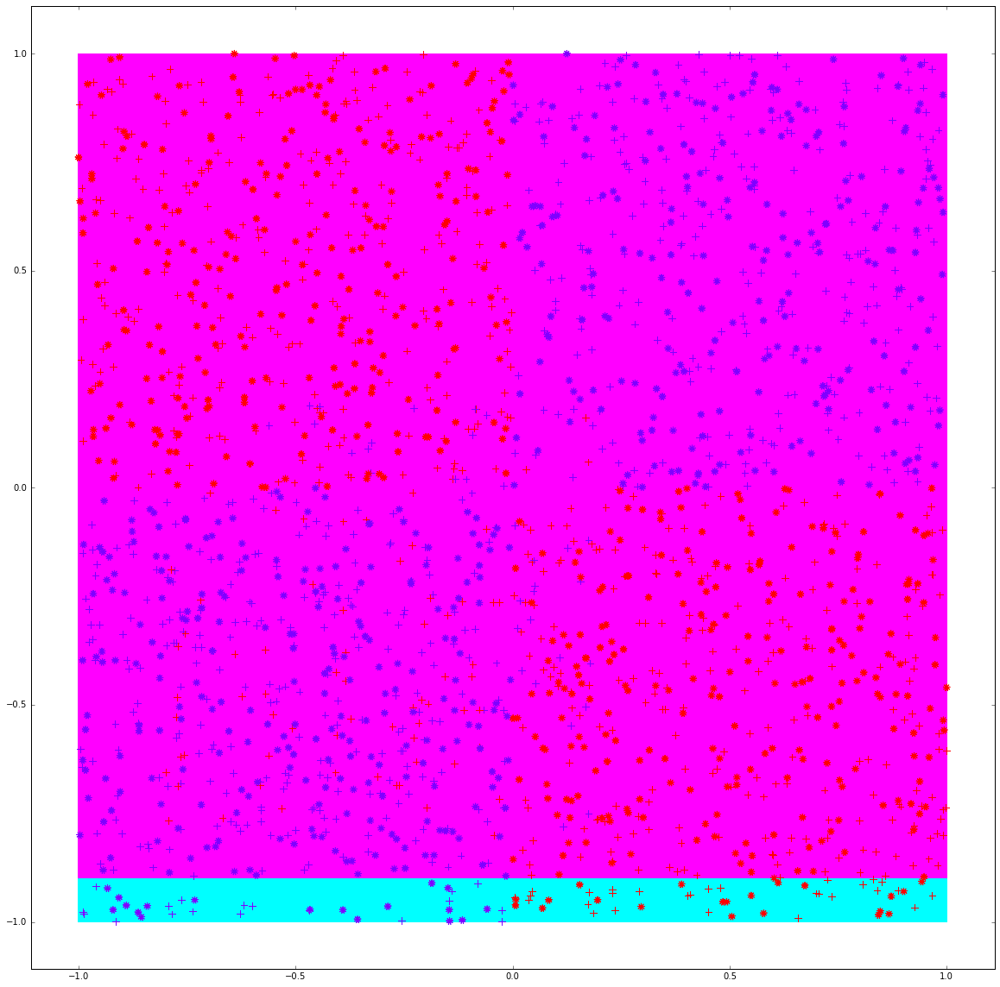

In [10]:
#2. Criterio "Gini" y partición "random"
clf=Tree(criterion='gini',splitter='random',random_state=0,max_depth=1)
clf.fit(X_train,Y_train)
precision_entrenamiento=clf.score(X_train, Y_train)
precision_prueba=clf.score(X_test, Y_test)
print "Utilizando criterio Gini y partición Random"
print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
print "La precisión con los datos de prueba es: ", precision_prueba
#print clf.tree_.max_depth
plot_classifier(clf,X_train,Y_train,X_test,Y_test,'tree')

Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.508181818182
La precisión con los datos de prueba es:  0.486


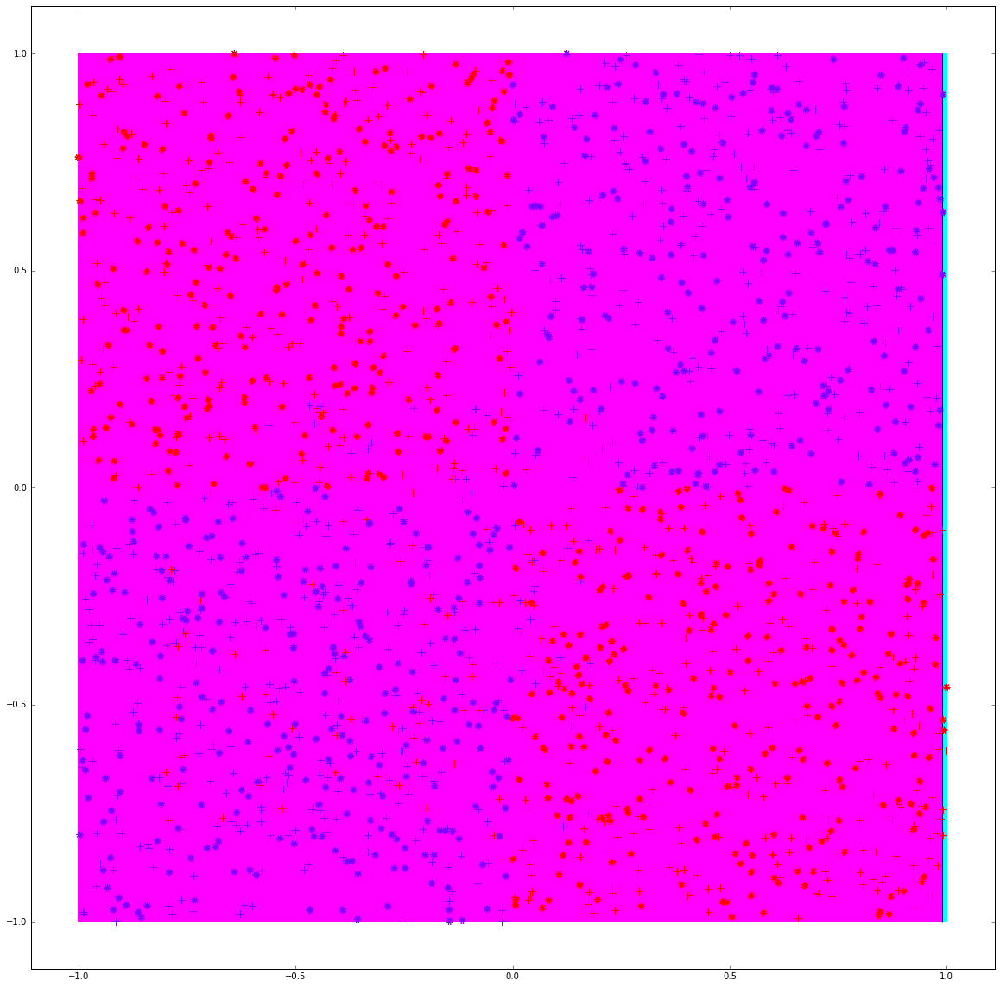

In [11]:
#3. Criterio "Entropy" y partición "best"
clf=Tree(criterion='entropy',splitter='best',random_state=0,max_depth=1)
clf.fit(X_train,Y_train)
precision_entrenamiento=clf.score(X_train, Y_train)
precision_prueba=clf.score(X_test, Y_test)
print "Utilizando criterio Entropy y partición Best"
print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
print "La precisión con los datos de prueba es: ", precision_prueba
#print clf.tree_.max_depth
plot_classifier(clf,X_train,Y_train,X_test,Y_test,'tree')

Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.507272727273
La precisión con los datos de prueba es:  0.491


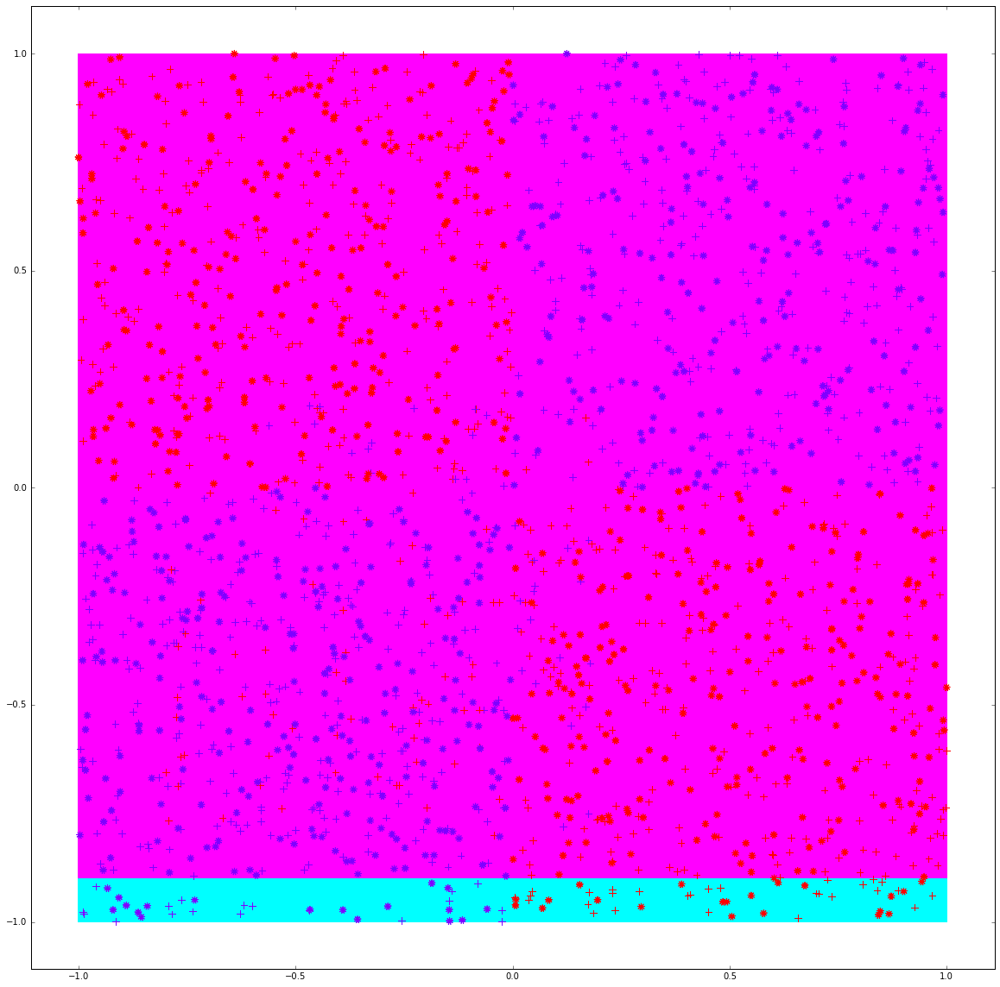

In [12]:
#4. Criterio "Entropy" y partición "random"
clf=Tree(criterion='entropy',splitter='random',random_state=0,max_depth=1)
clf.fit(X_train,Y_train)
precision_entrenamiento=clf.score(X_train, Y_train)
precision_prueba=clf.score(X_test, Y_test)
print "Utilizando criterio Entropy y partición Random"
print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
print "La precisión con los datos de prueba es: ", precision_prueba
#print clf.tree_.max_depth
plot_classifier(clf,X_train,Y_train,X_test,Y_test,'tree')

Se puede identificar para el comportamiento de cada variación del árbol de profundidad 1, que las precisiones van por el rango de 0.48 y 0.51, tanto para los datos de entrenamiento y los datos de prueba, sin localizar una mayor diferencia entre estas variaciones. Observando los gráficos, se puede apreciar que el comportamiento del árbol de profundidad 1 es muy similar al SVM lineal anteriormente visto, ya que este árbol lo que está haciendo es una sola comparación para decidir a cuál lado o sector pertenecen los puntos, que como se aprecia, es una línea recta, por lo mismo el problema XOR no puede ser resuelto con este árbol.

## Pregunta g)

Ahora se trabajará con árboles de clasificación de múltiples niveles, los cuales serán variados para obtener los diferentes valores de precisión con los datos de entrenamiento y los datos de prueba.

Para n_t:  2
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.763636363636
La precisión con los datos de prueba es:  0.798


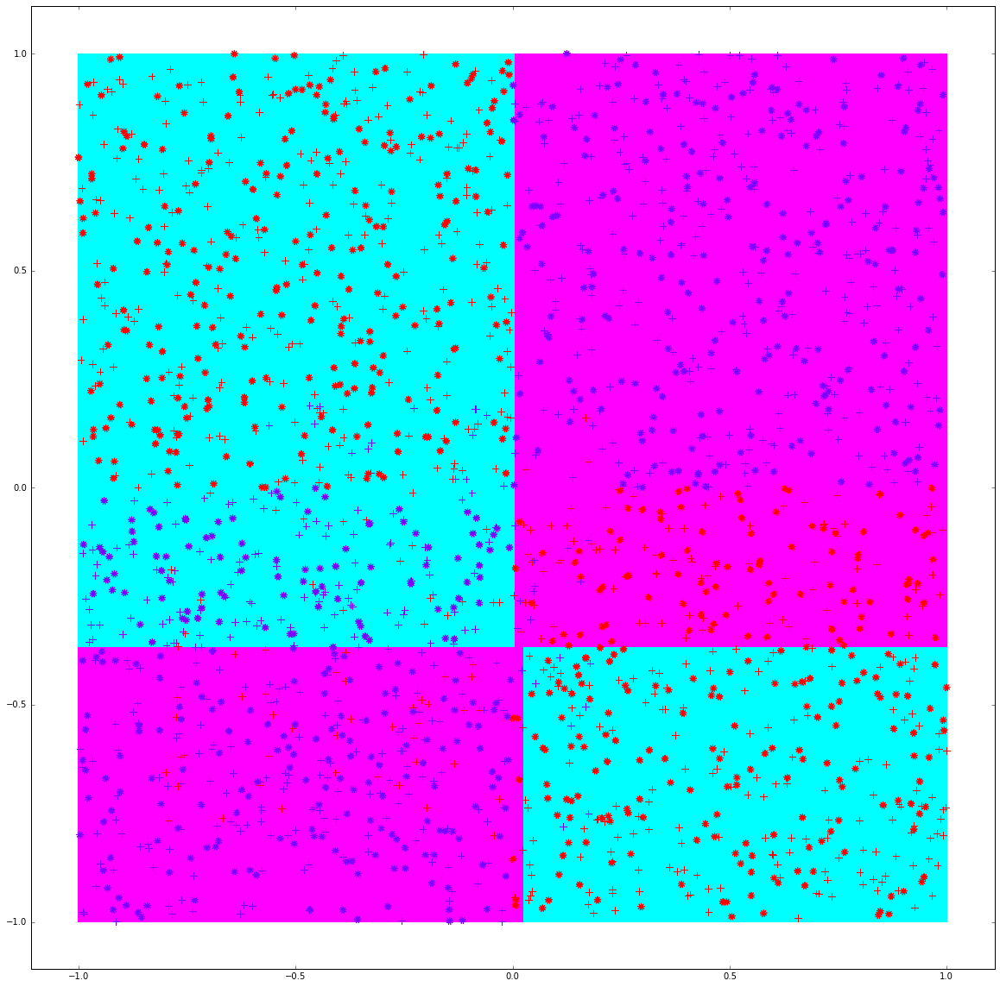



Para n_t:  3
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.909090909091
La precisión con los datos de prueba es:  0.99


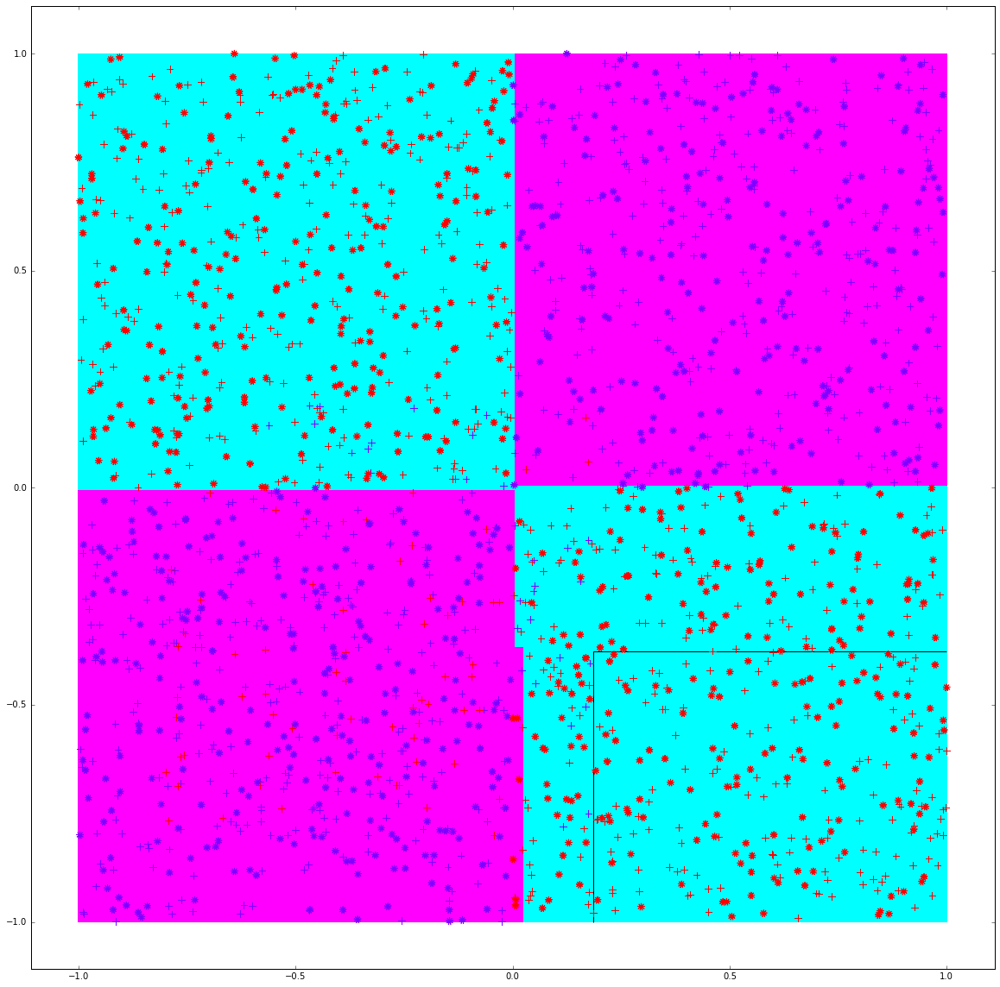



Para n_t:  4
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.911818181818
La precisión con los datos de prueba es:  0.989


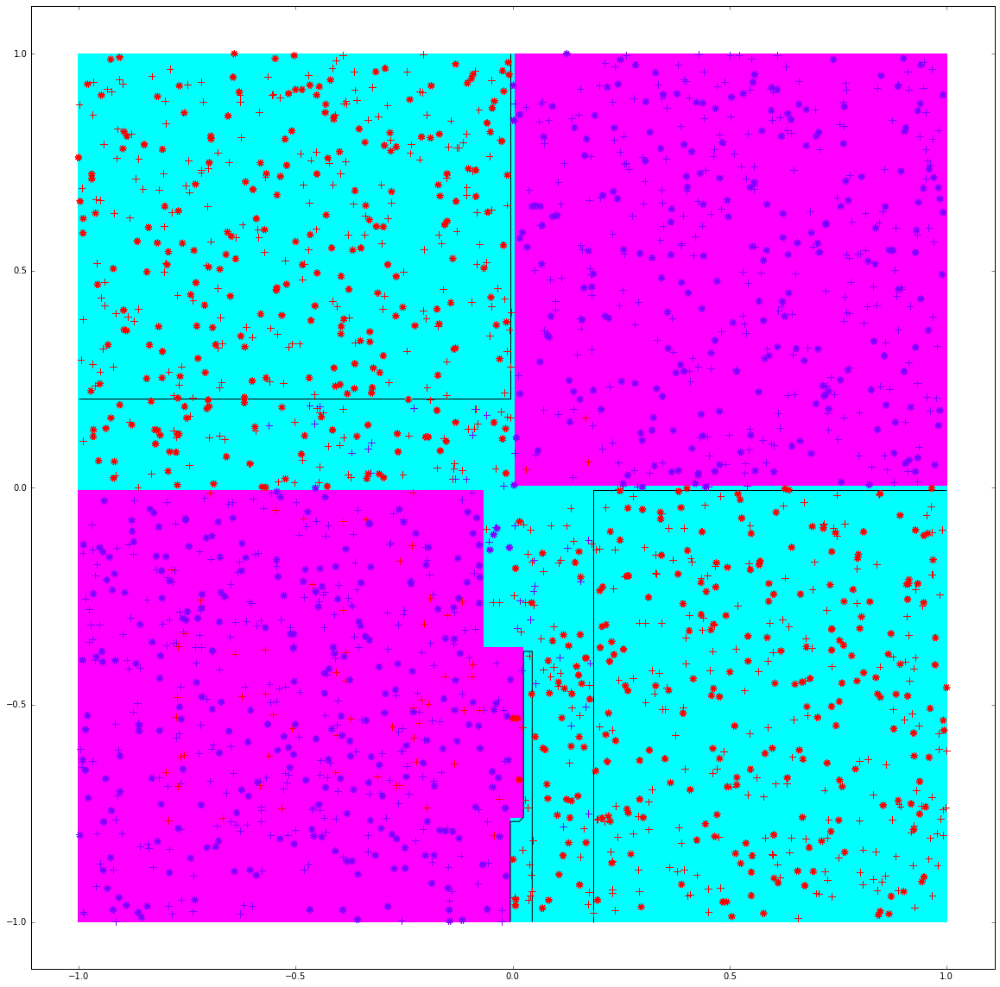



Para n_t:  5
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.923636363636
La precisión con los datos de prueba es:  0.98


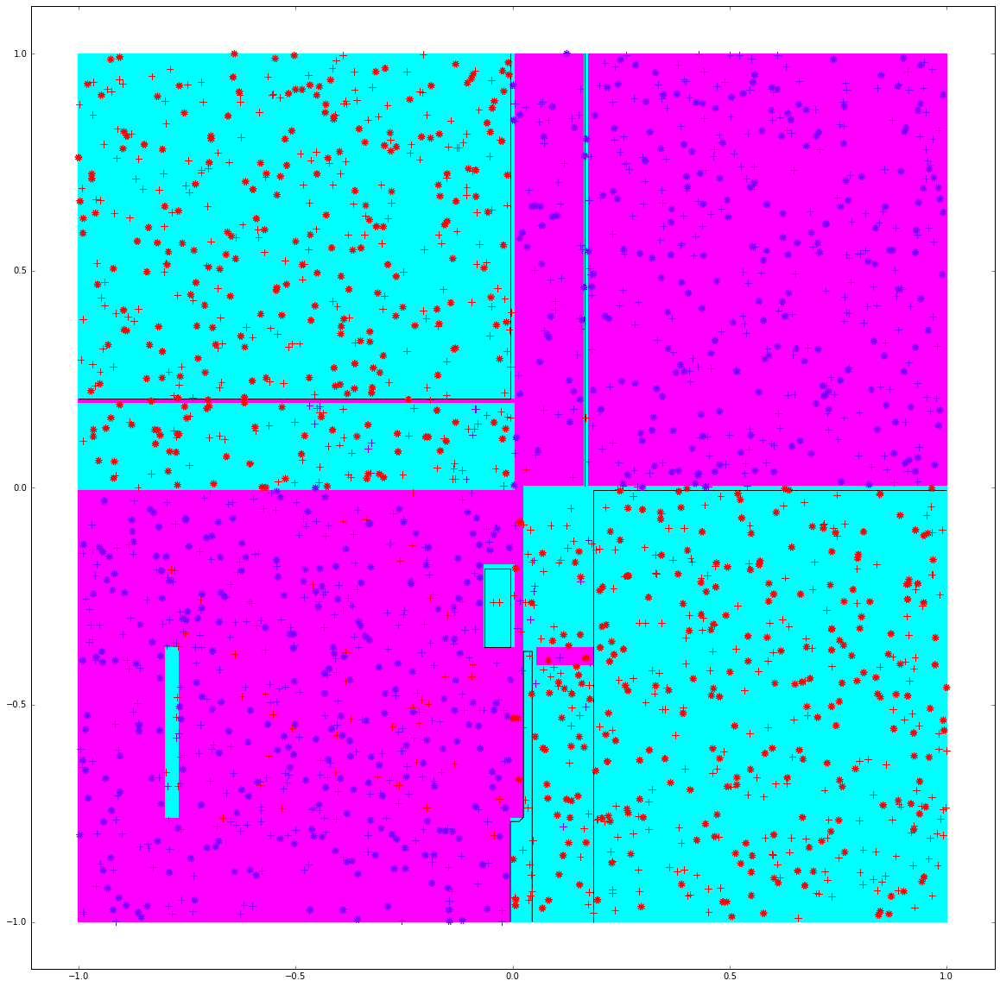



Para n_t:  6
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.929090909091
La precisión con los datos de prueba es:  0.975


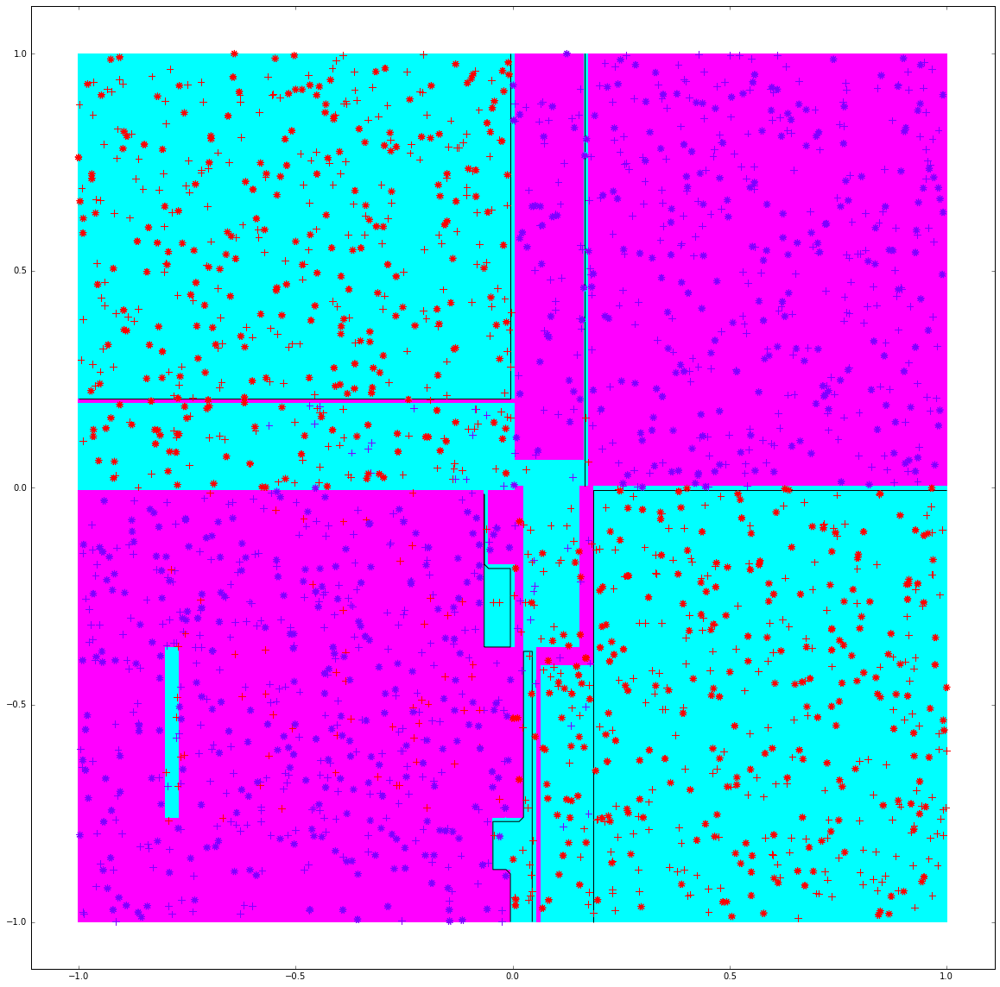



Para n_t:  7
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.934545454545
La precisión con los datos de prueba es:  0.968


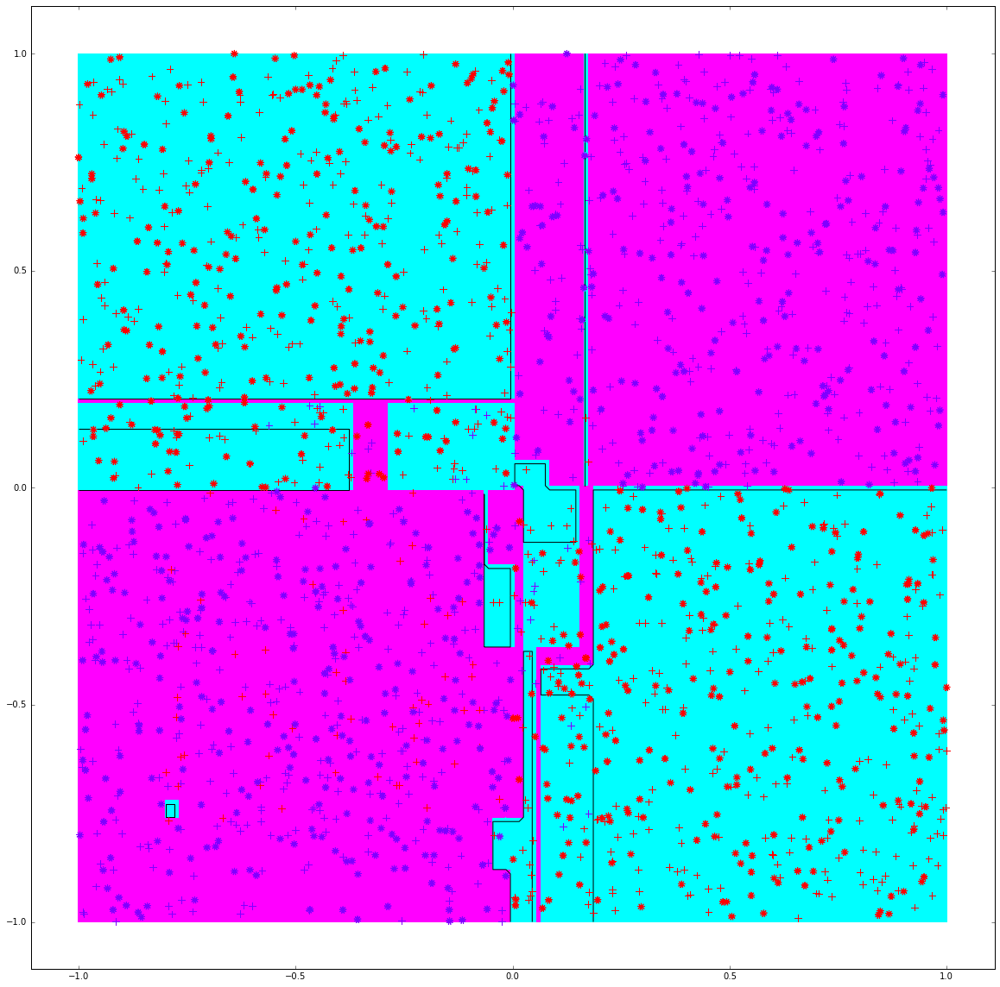



Para n_t:  8
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.943636363636
La precisión con los datos de prueba es:  0.961


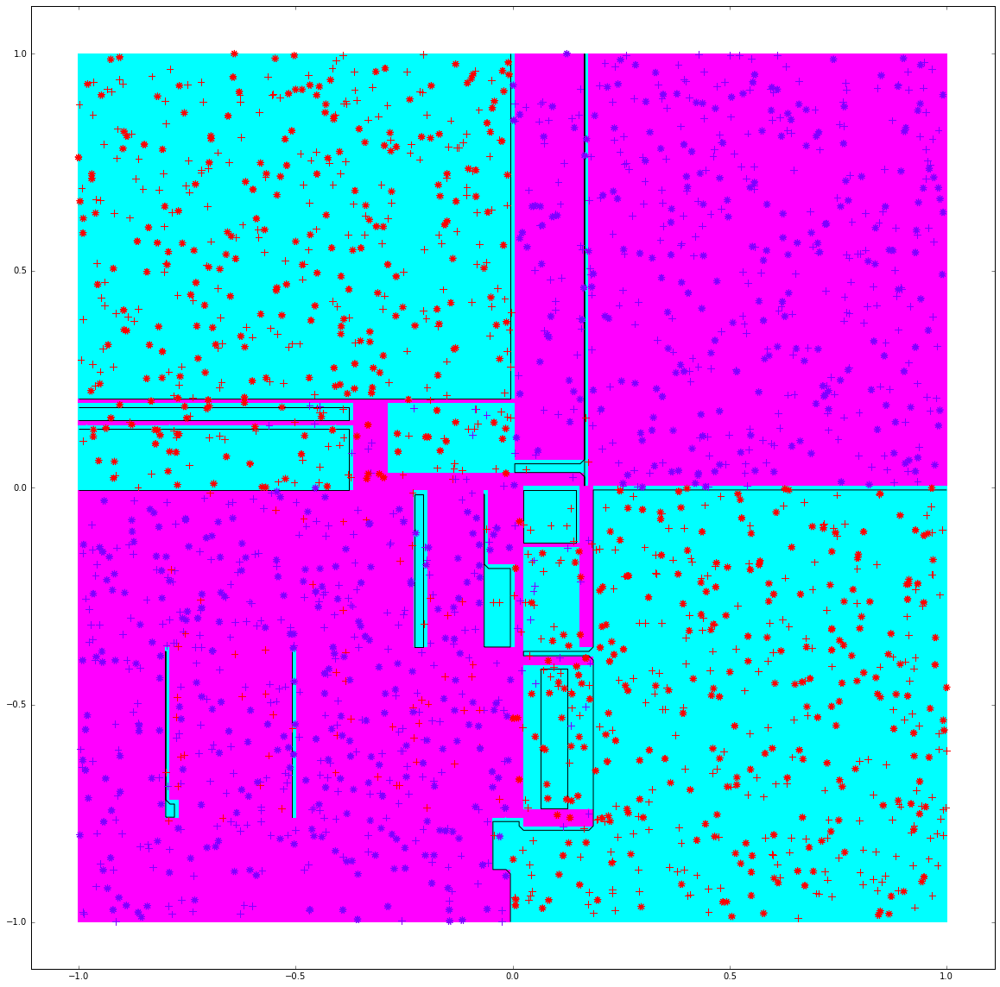



Para n_t:  9
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.952727272727
La precisión con los datos de prueba es:  0.949


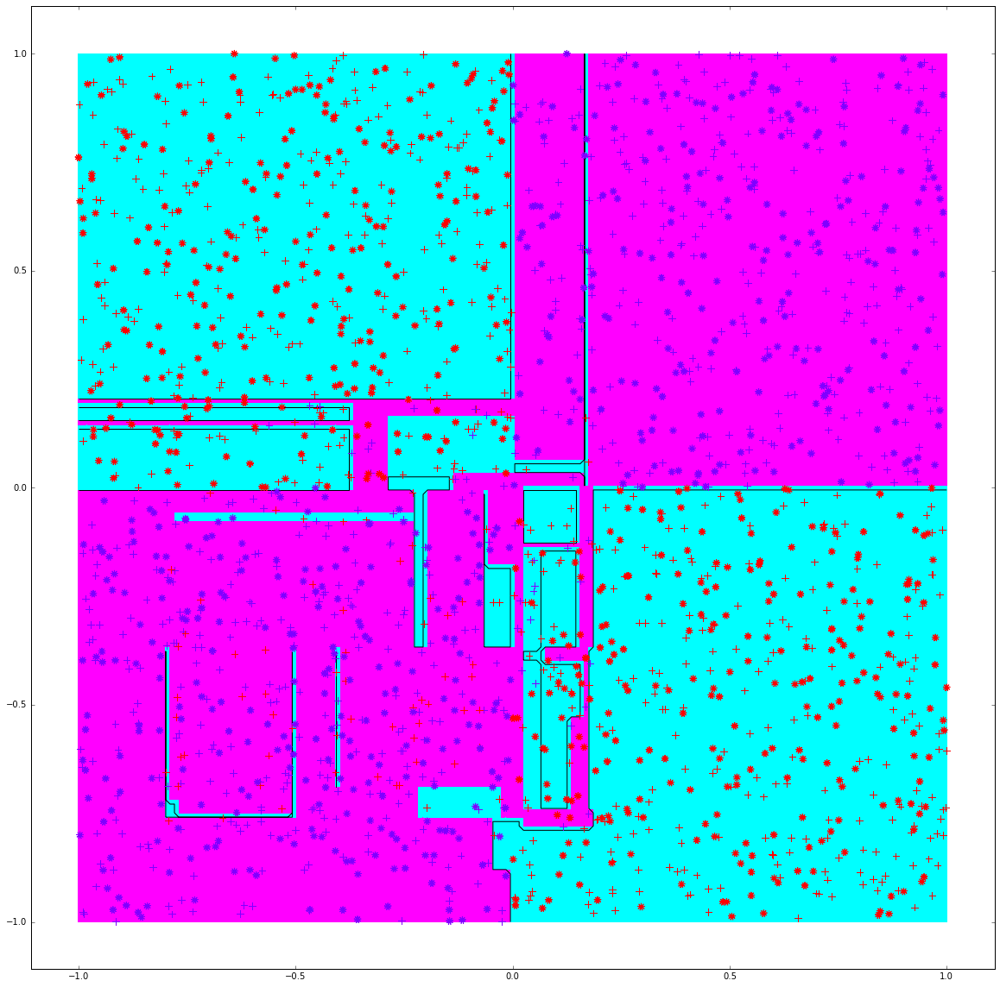



Para n_t:  10
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.962727272727
La precisión con los datos de prueba es:  0.942


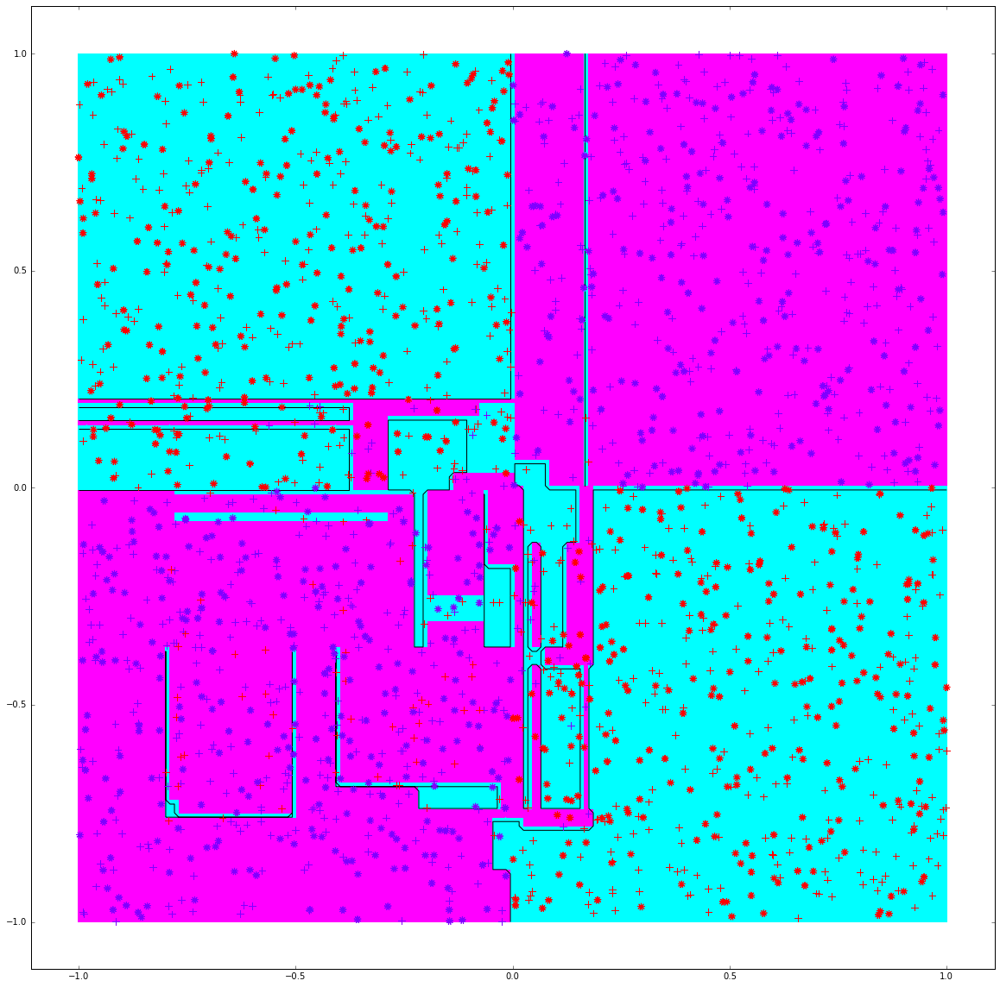



Para n_t:  11
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.97
La precisión con los datos de prueba es:  0.932


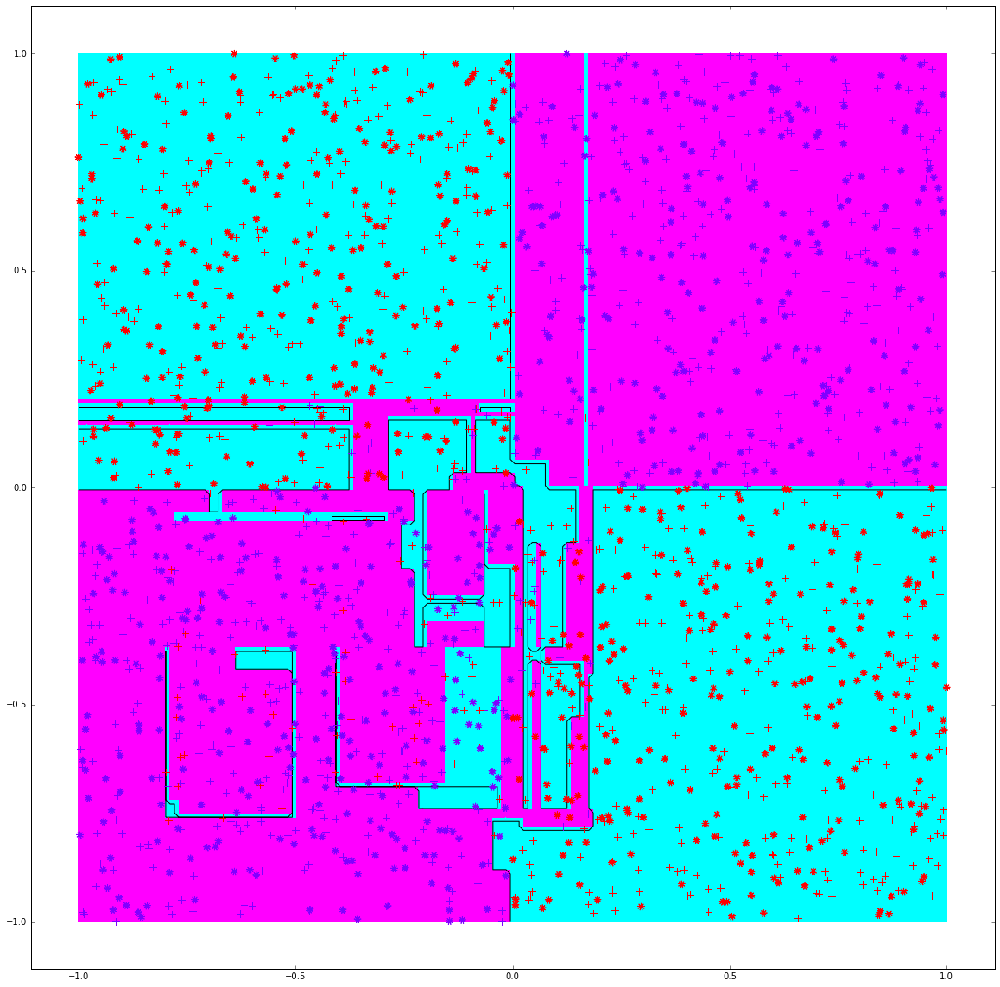



Para n_t:  12
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.98
La precisión con los datos de prueba es:  0.927


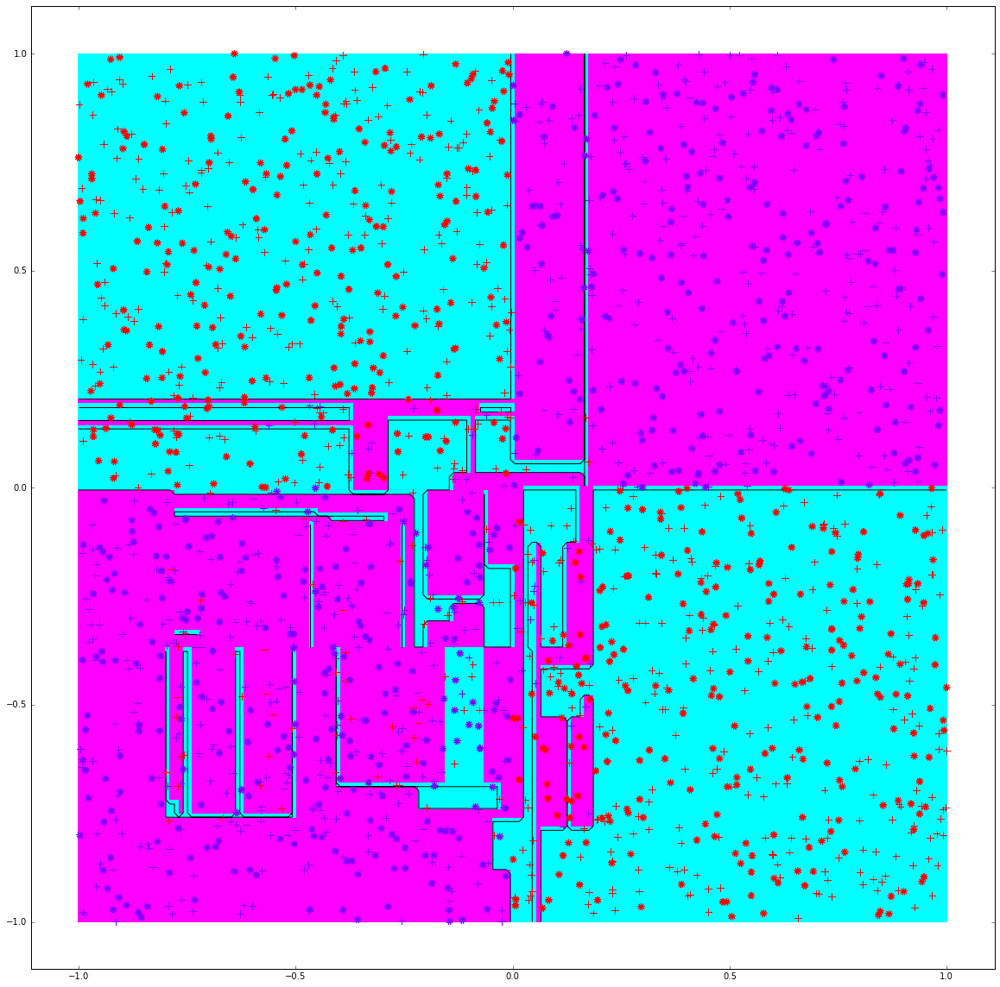



Para n_t:  13
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.982727272727
La precisión con los datos de prueba es:  0.923


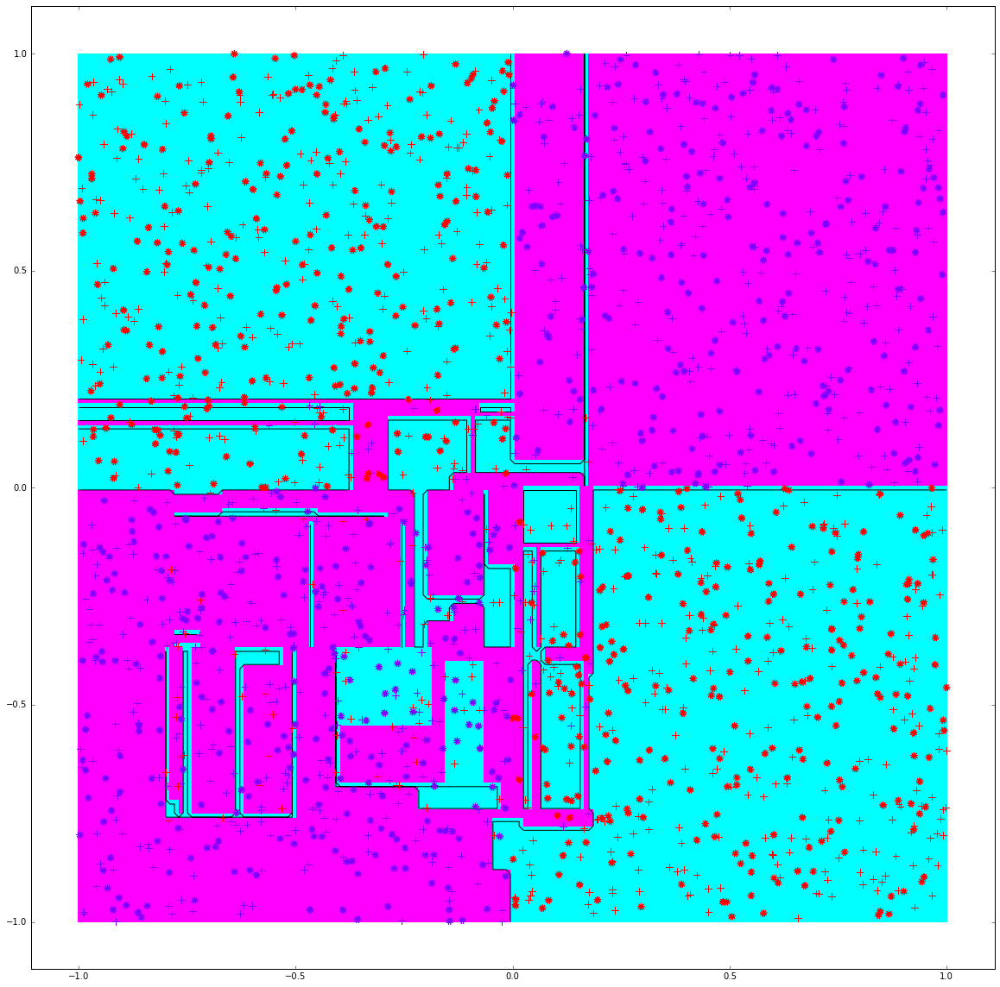



Para n_t:  14
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.987272727273
La precisión con los datos de prueba es:  0.919


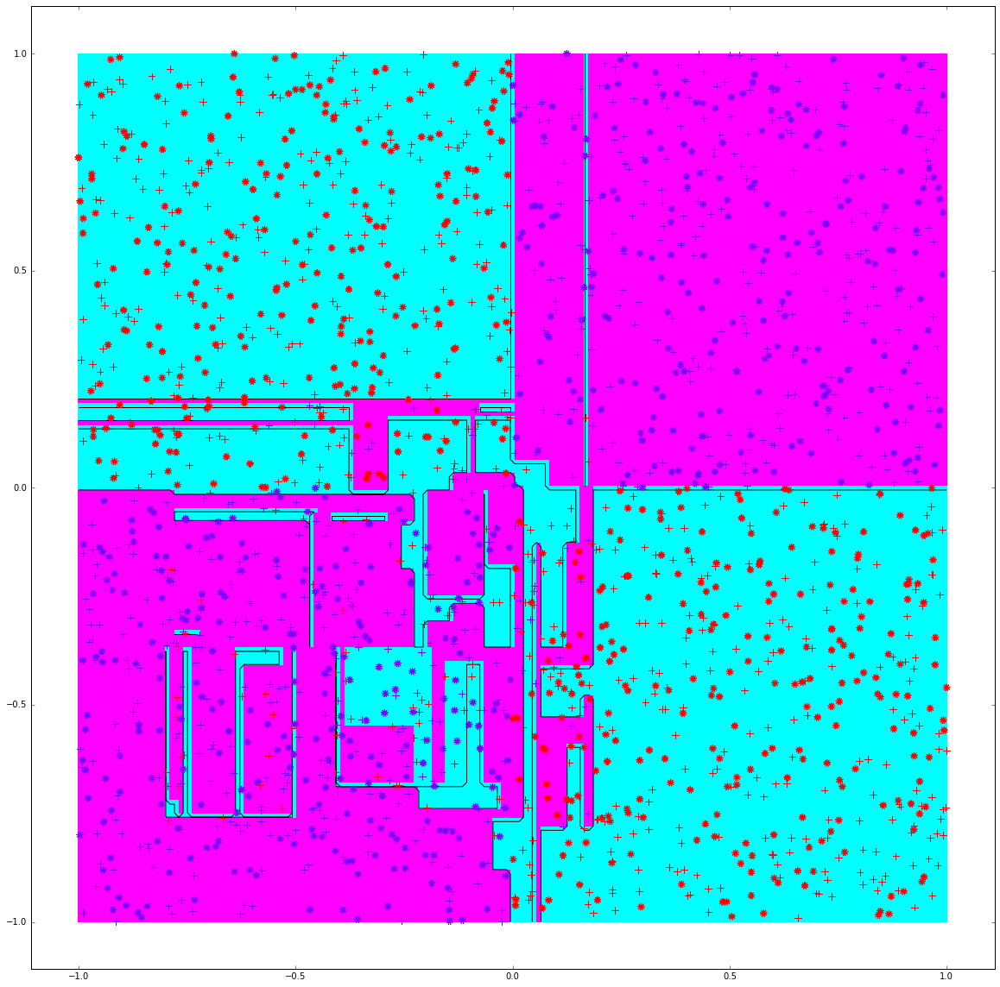



Para n_t:  15
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.990909090909
La precisión con los datos de prueba es:  0.927


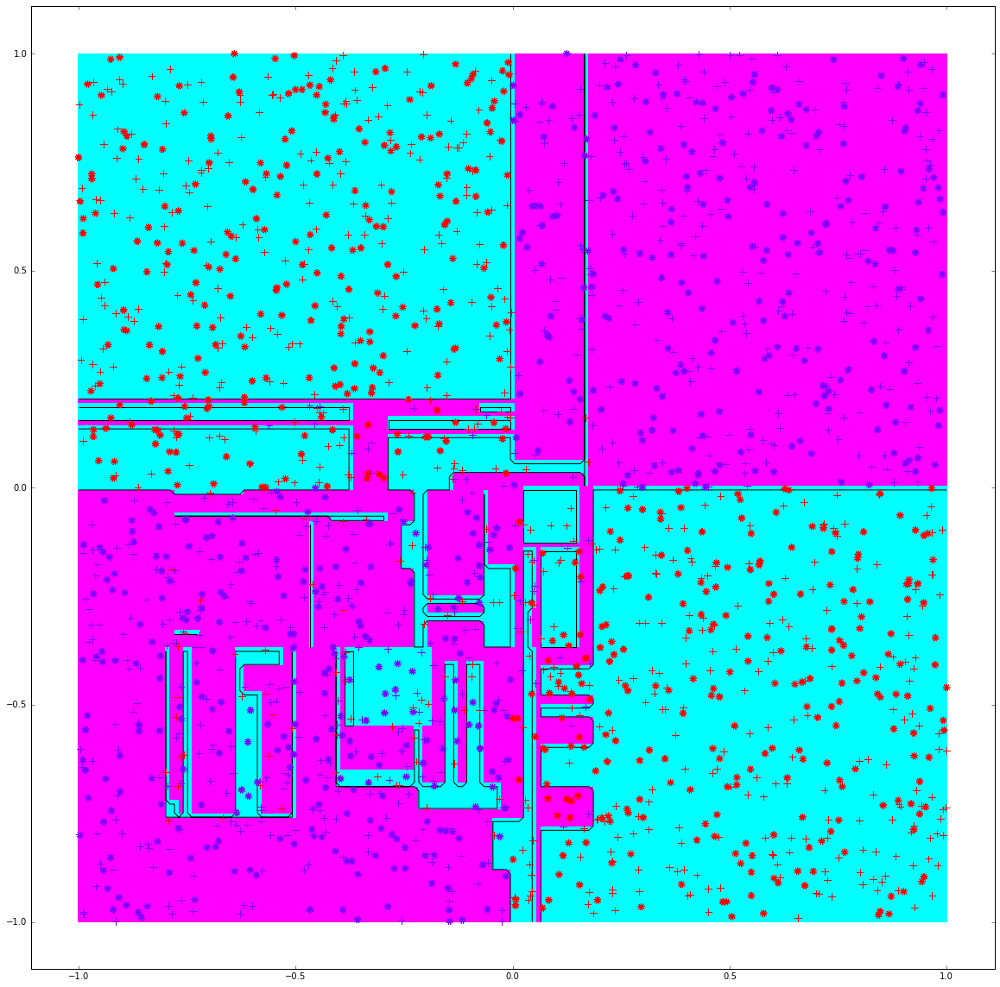



Para n_t:  16
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.995454545455
La precisión con los datos de prueba es:  0.918


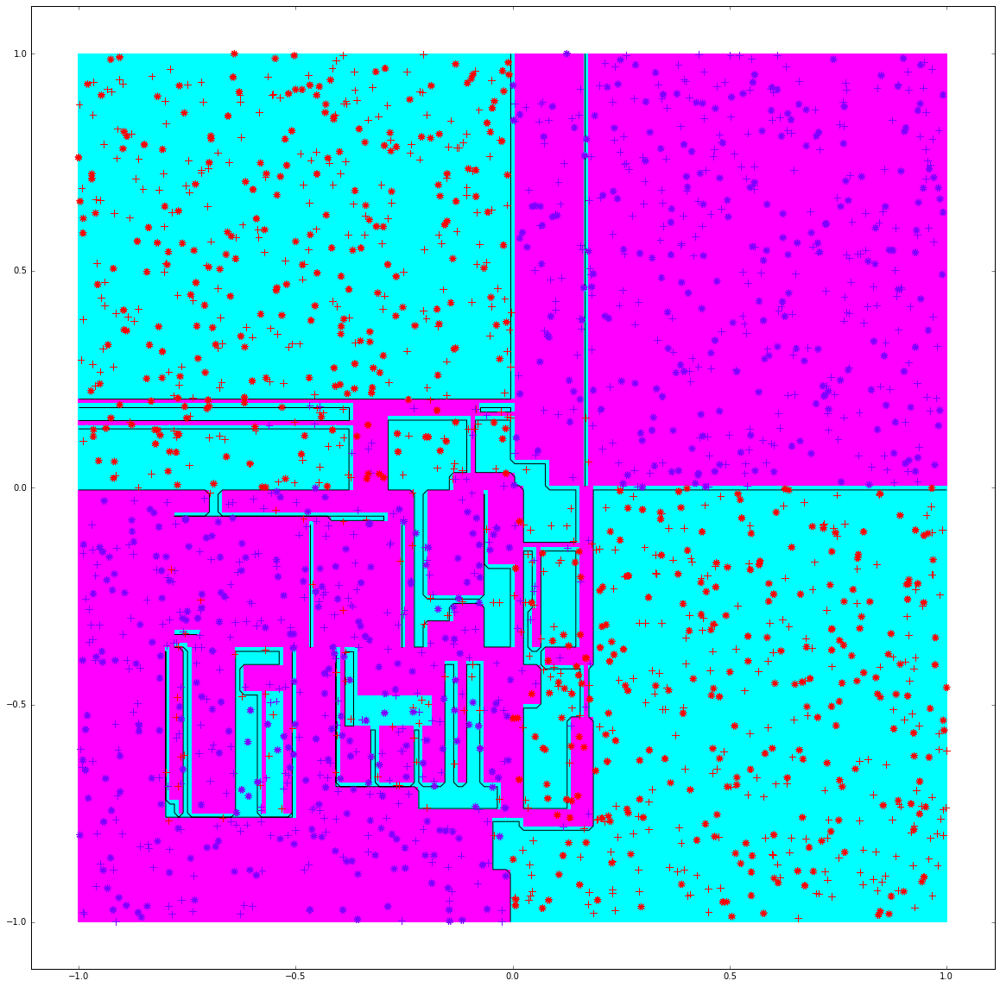



Para n_t:  17
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.997272727273
La precisión con los datos de prueba es:  0.917


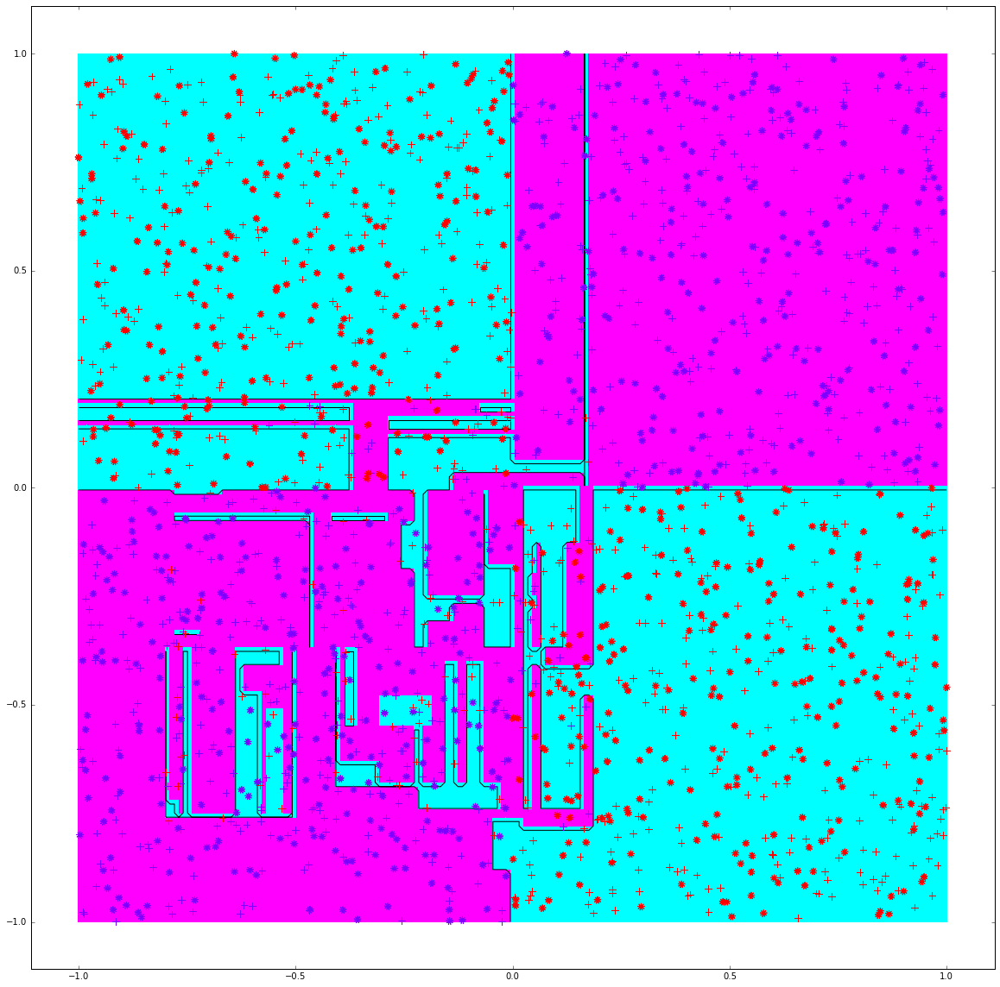



Para n_t:  18
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  0.999090909091
La precisión con los datos de prueba es:  0.919


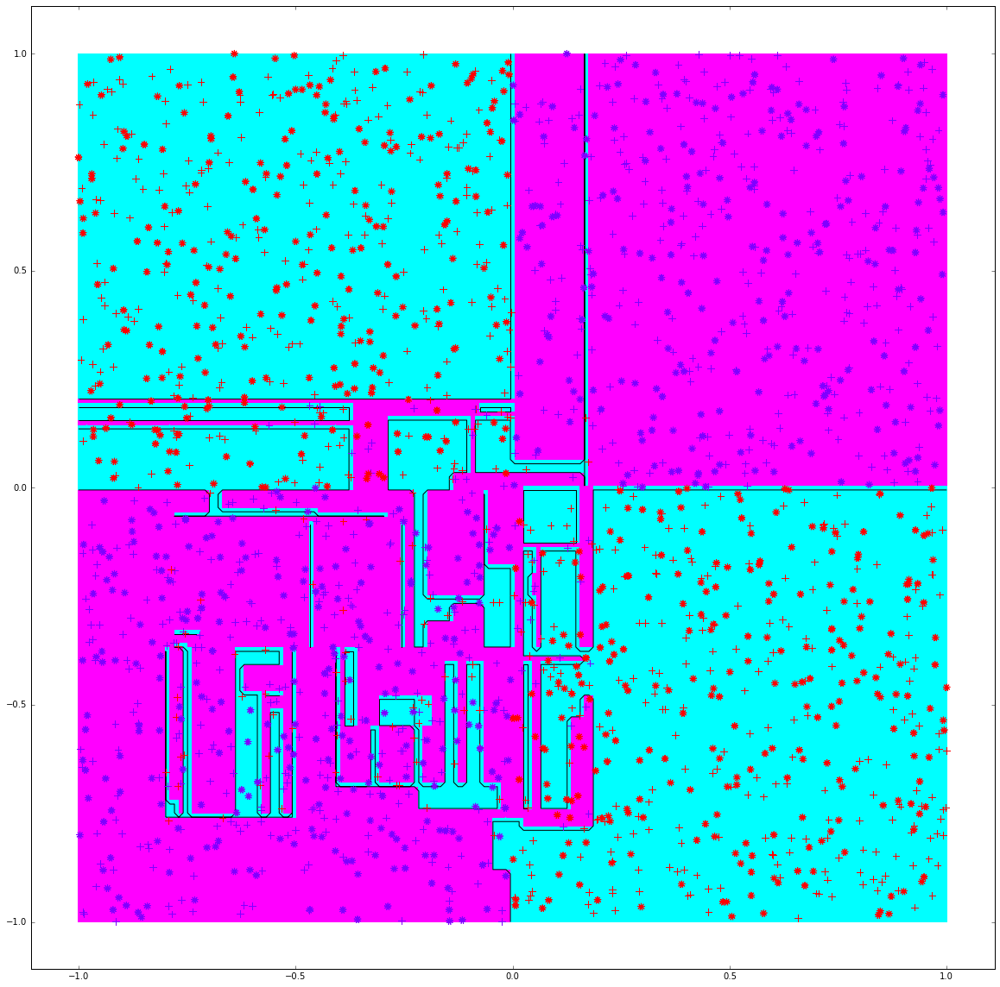



Para n_t:  19
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  1.0
La precisión con los datos de prueba es:  0.92


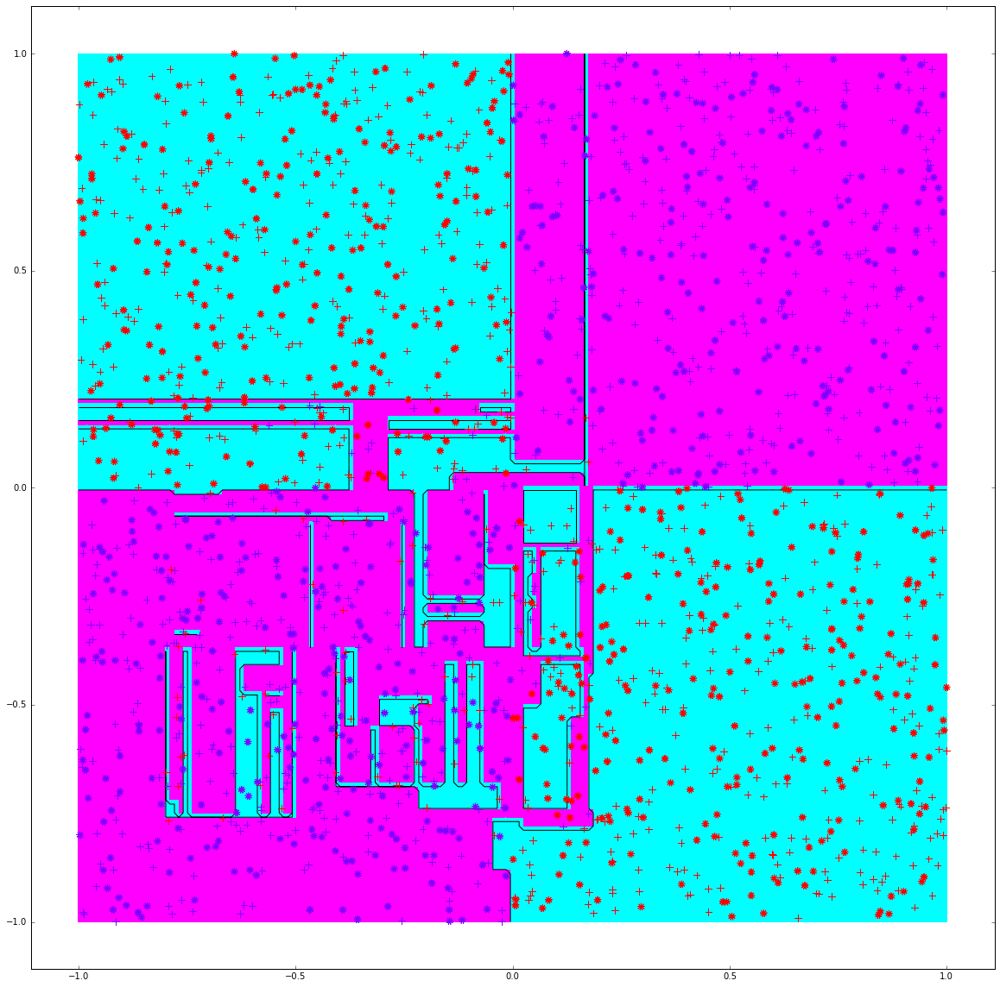



Para n_t:  20
Utilizando criterio Gini y partición Best
La precisión con los datos de entrenamiento es:  1.0
La precisión con los datos de prueba es:  0.92


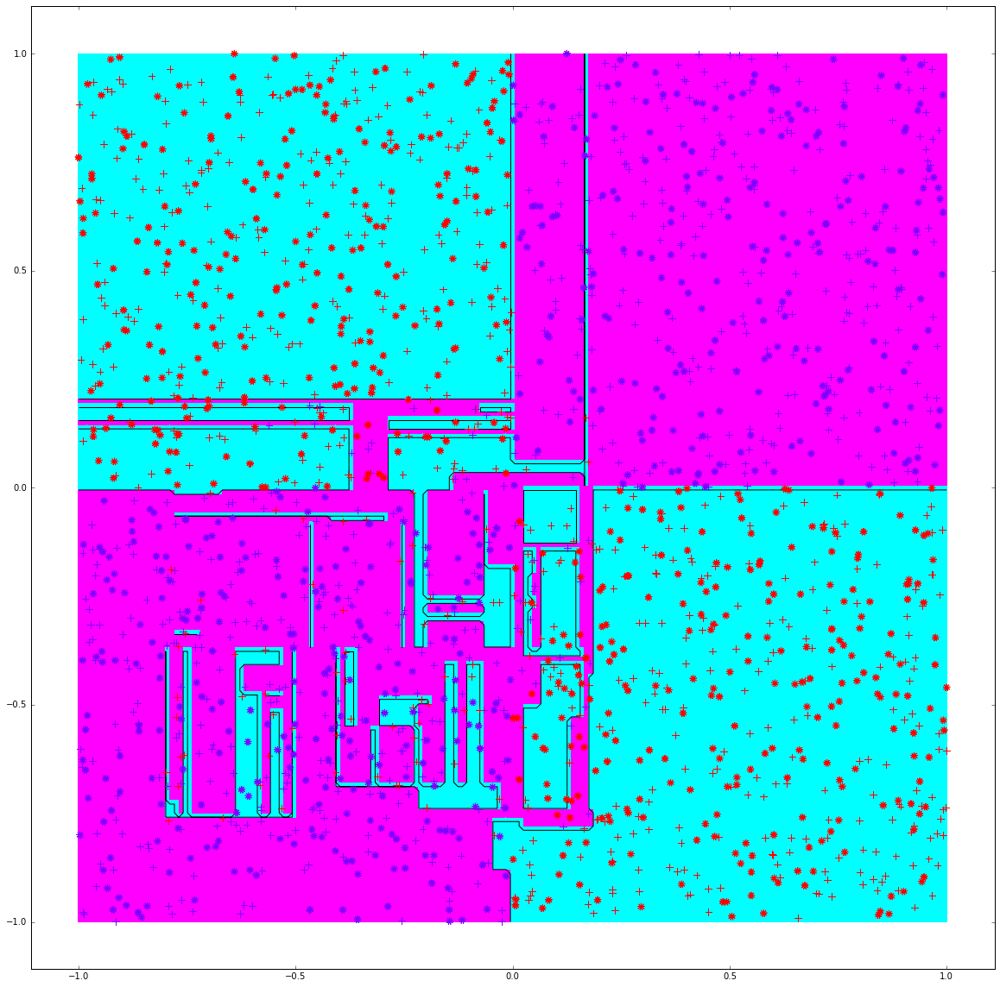

In [14]:
# 1. Precisiones datos de entrenamiento y datos de prueba utilizando árbol con criterio Gini y partición Best

errores_entrenamiento_gini_best=[]
errores_prueba_gini_best=[]
for n_t in range (2,21):
    clf=Tree(criterion='gini',splitter='best',random_state=0,max_depth=n_t)
    clf.fit(X_train,Y_train)
    precision_entrenamiento=clf.score(X_train, Y_train)
    eegb=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_gini_best.append(eegb) #agregando a la lista de errores obtenidos
    
    precision_prueba=clf.score(X_test, Y_test)
    epgb=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_gini_best.append(epgb) #agregando a la lista de errores obtenidos
    
    print "Para n_t: ", n_t
    print "Utilizando criterio Gini y partición Best"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    #print clf.tree_.max_depth
    plot_classifier(clf,X_train,Y_train,X_test,Y_test,'tree')
    print "\n"

Para n_t:  2
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.535454545455
La precisión con los datos de prueba es:  0.514


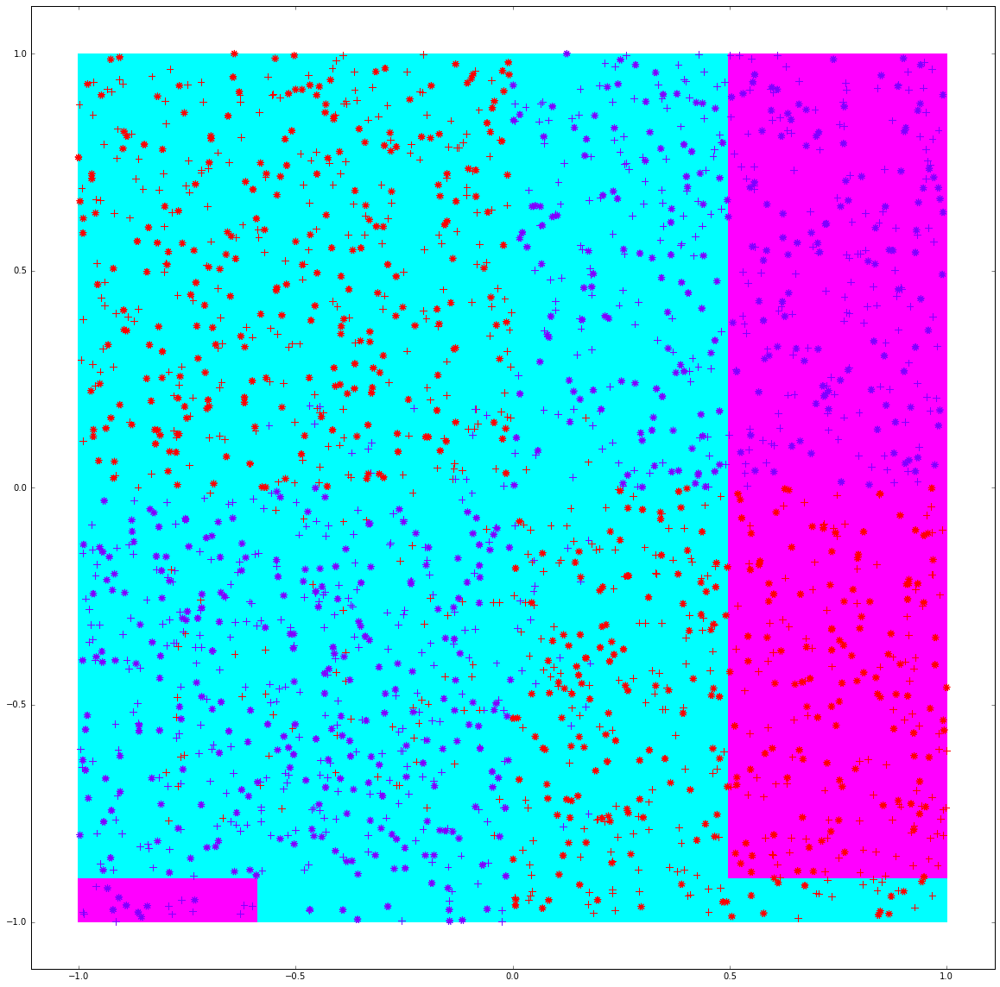



Para n_t:  3
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.778181818182
La precisión con los datos de prueba es:  0.793


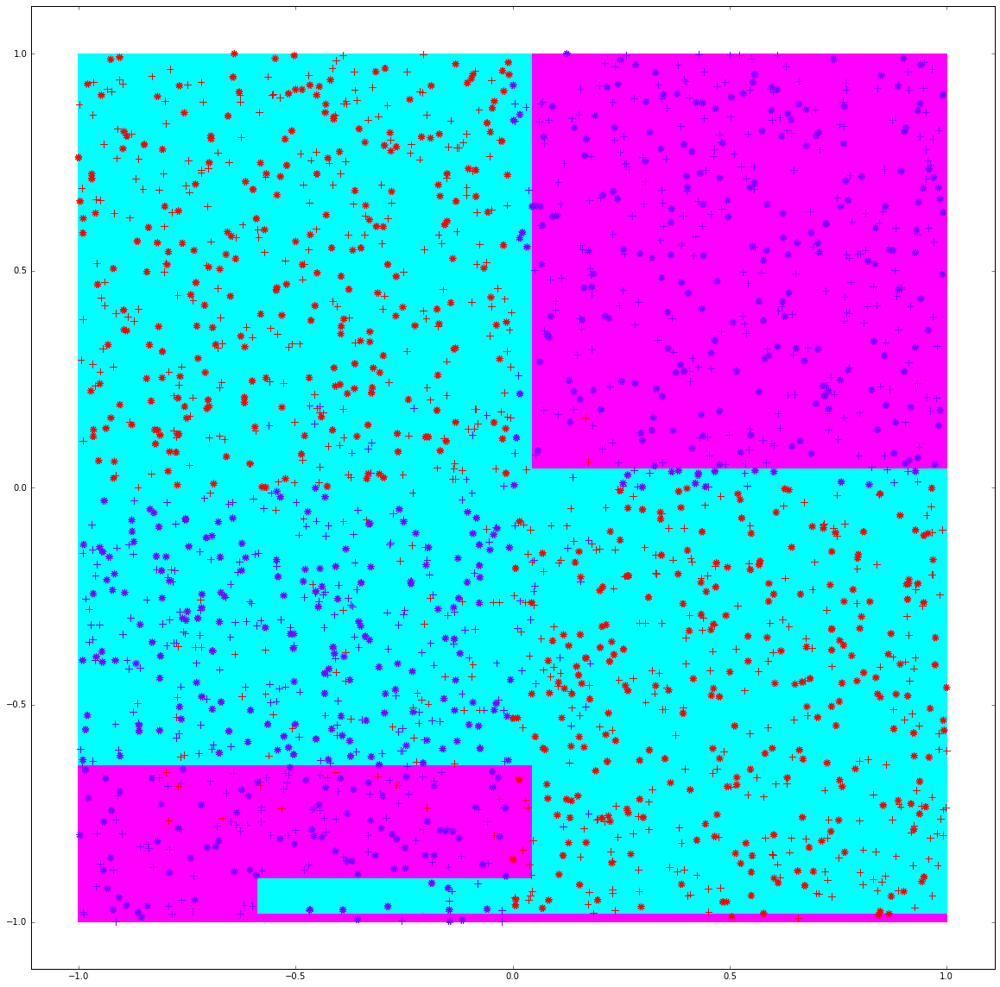



Para n_t:  4
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.616363636364
La precisión con los datos de prueba es:  0.629


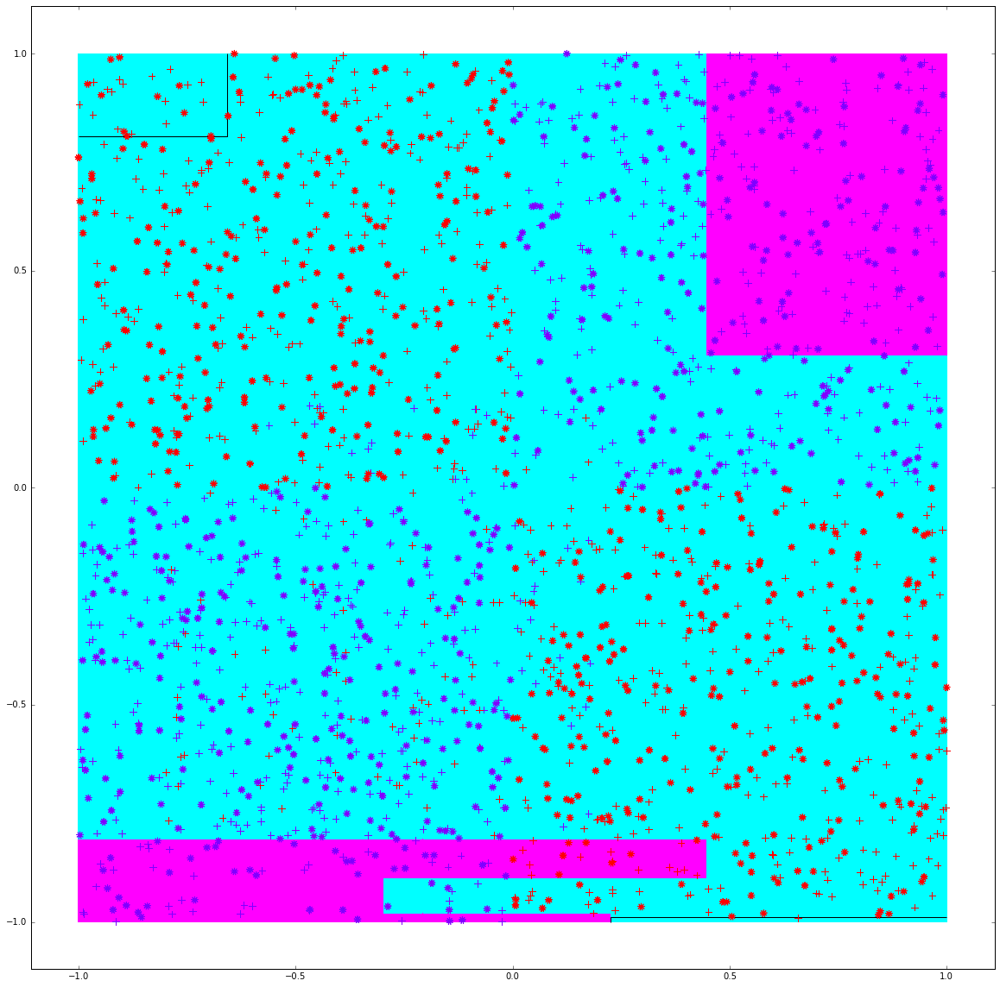



Para n_t:  5
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.583636363636
La precisión con los datos de prueba es:  0.581


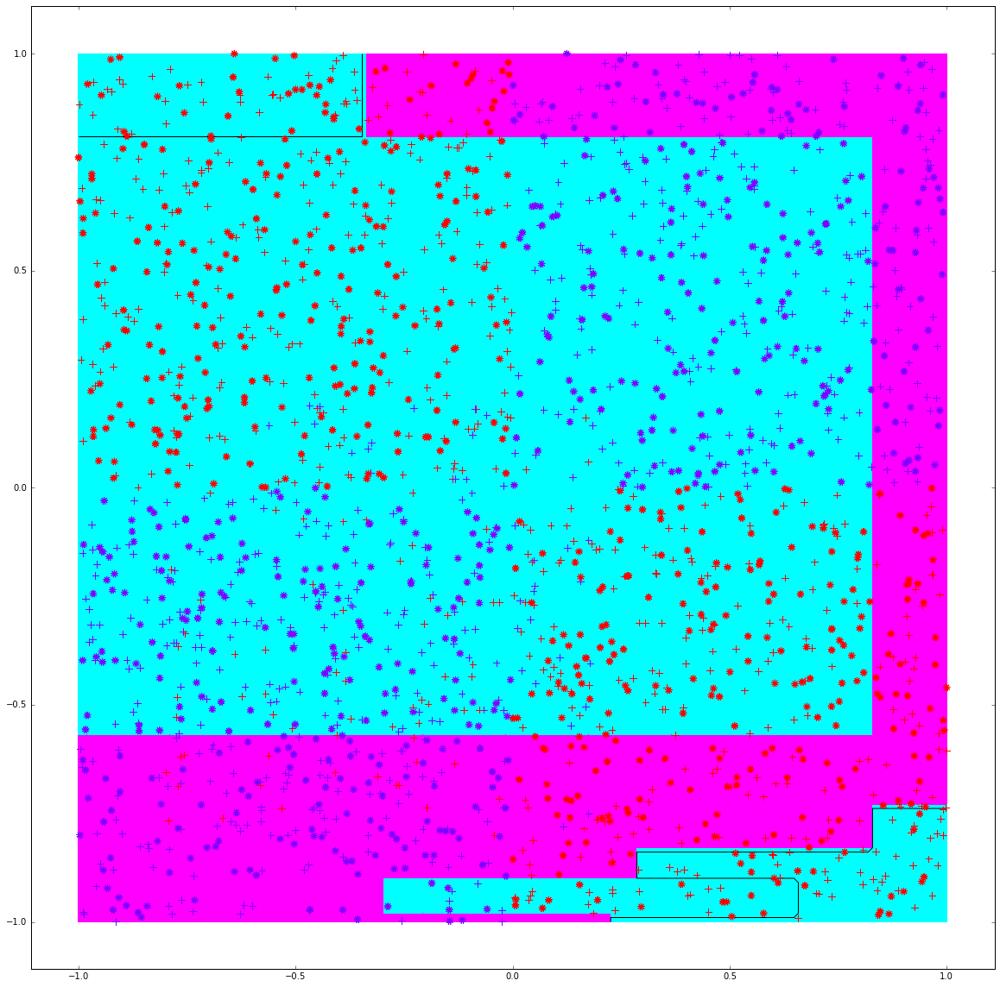



Para n_t:  6
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.746363636364
La precisión con los datos de prueba es:  0.761


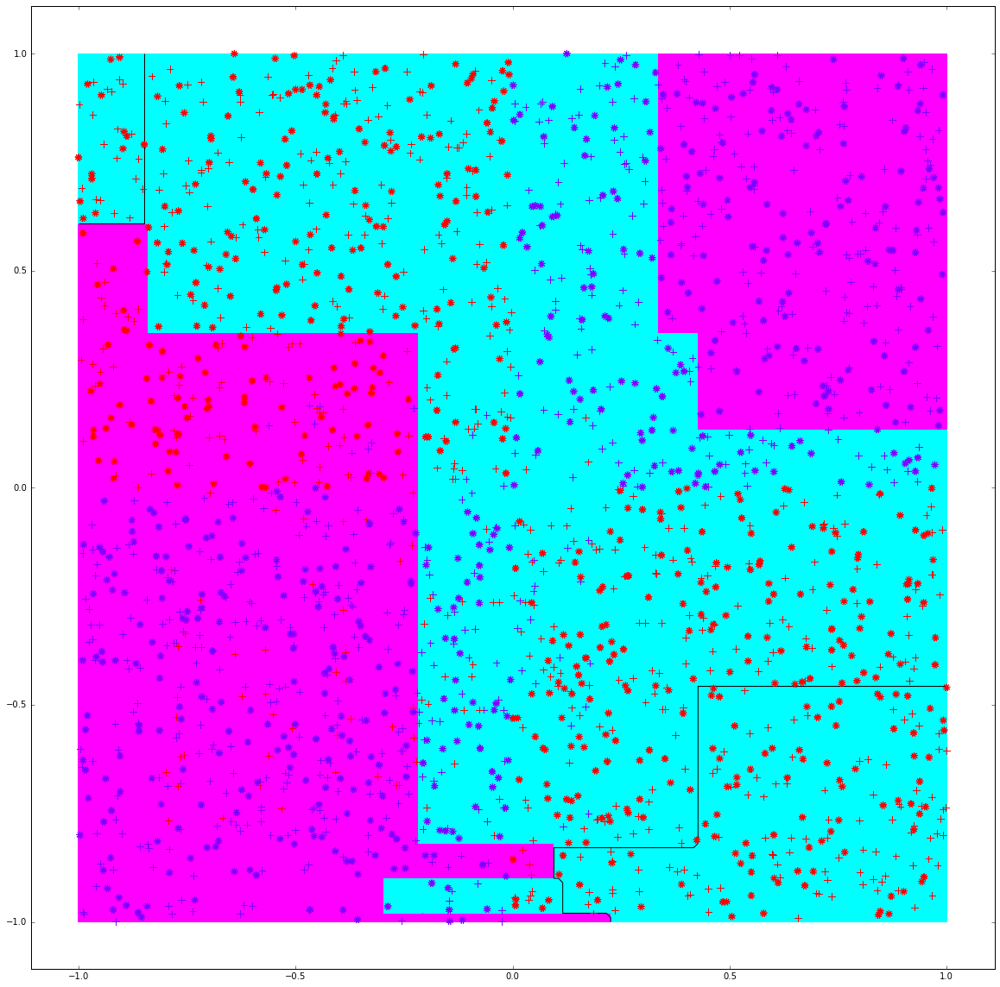



Para n_t:  7
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.843636363636
La precisión con los datos de prueba es:  0.88


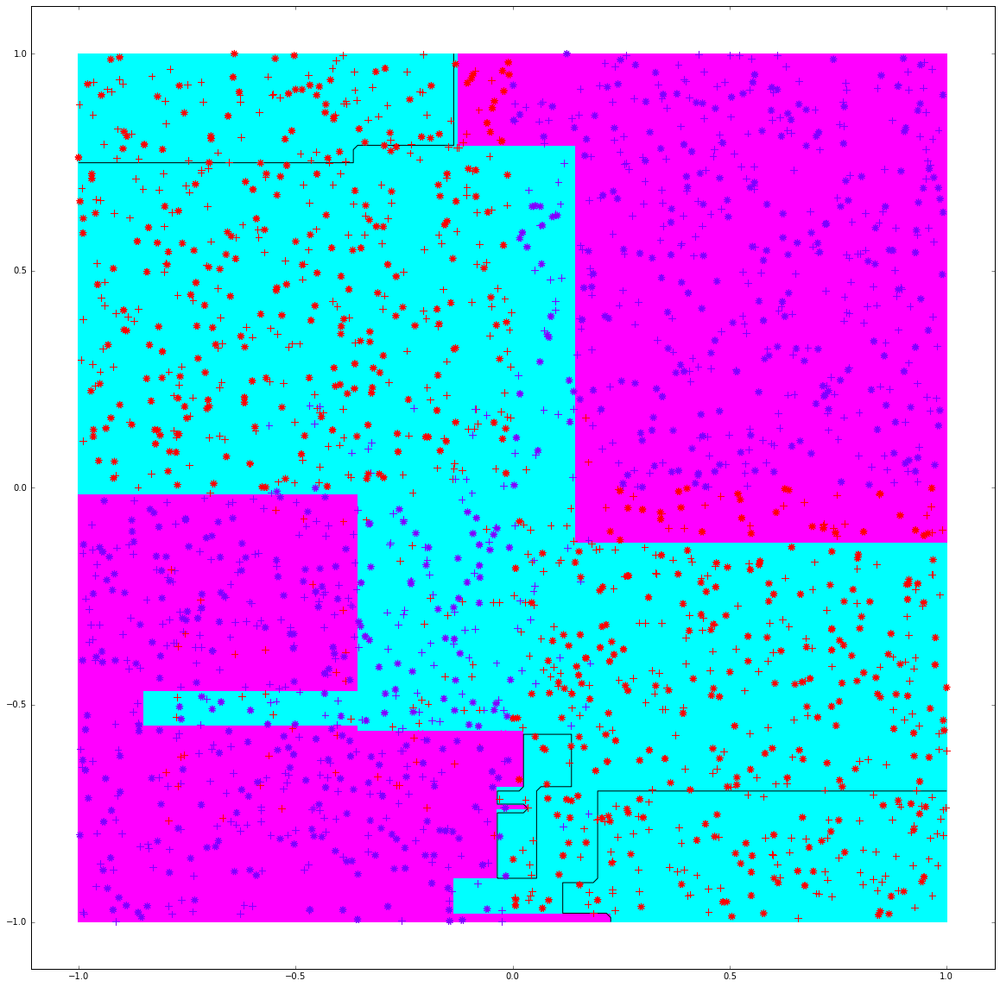



Para n_t:  8
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.885454545455
La precisión con los datos de prueba es:  0.944


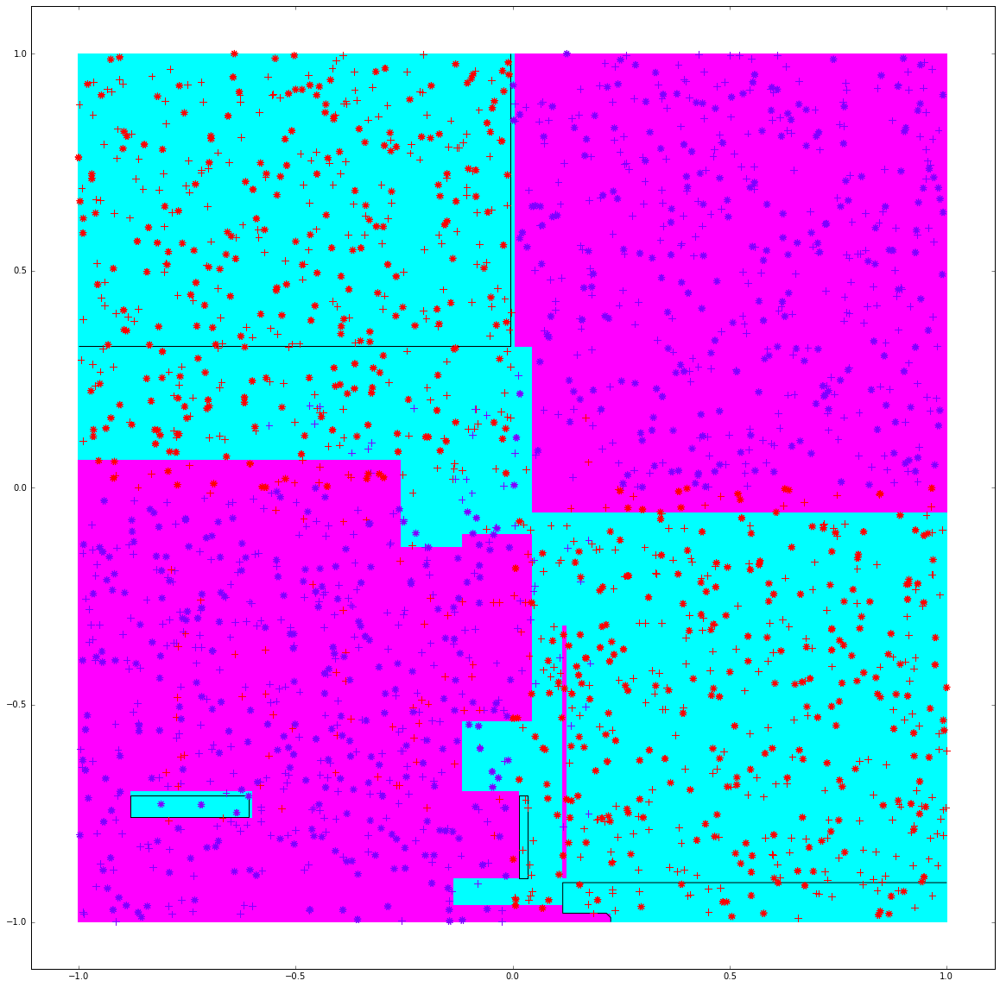



Para n_t:  9
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.828181818182
La precisión con los datos de prueba es:  0.871


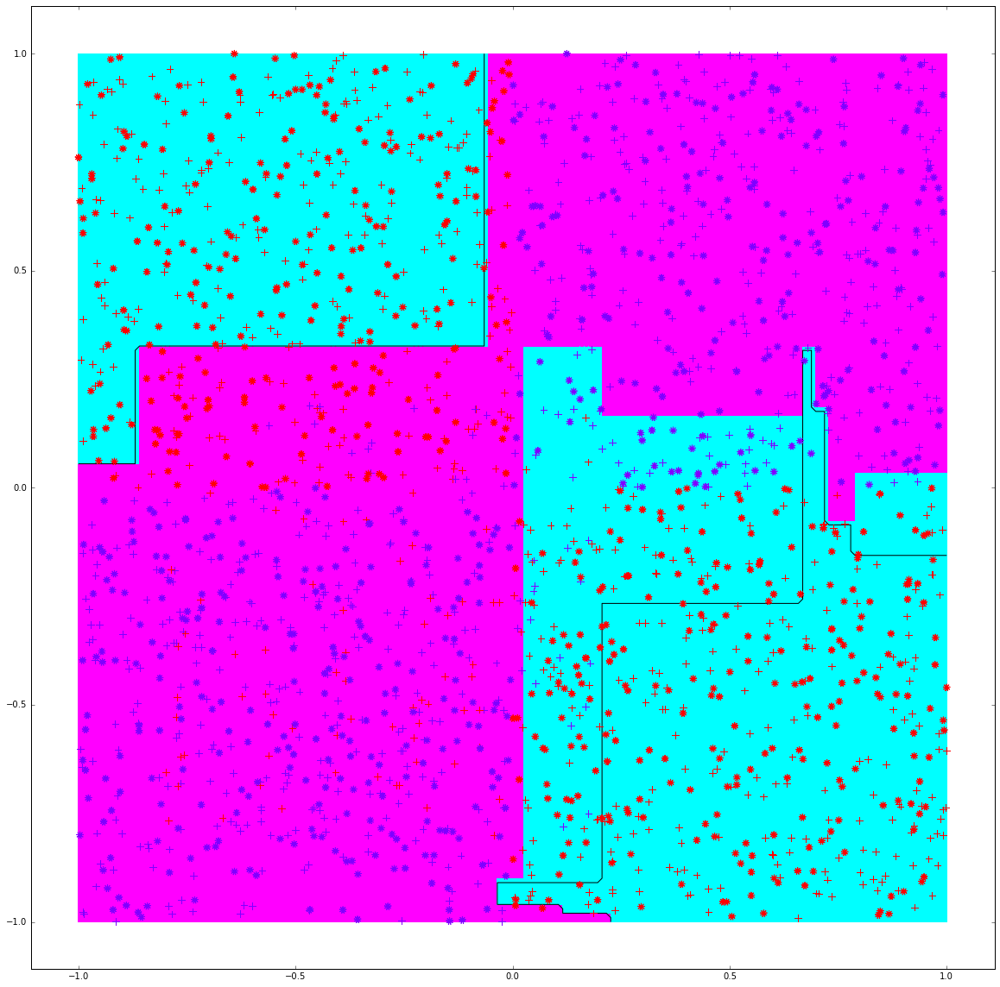



Para n_t:  10
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.889090909091
La precisión con los datos de prueba es:  0.934


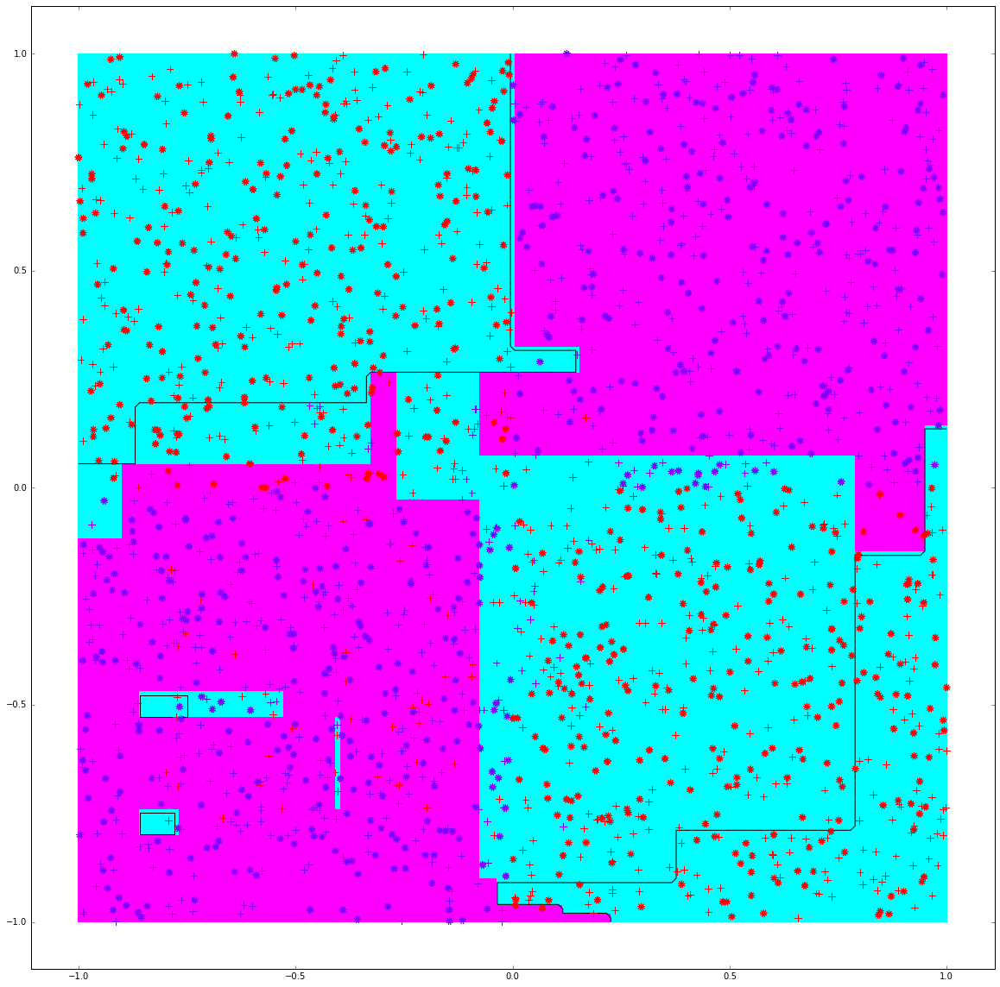



Para n_t:  11
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.886363636364
La precisión con los datos de prueba es:  0.93


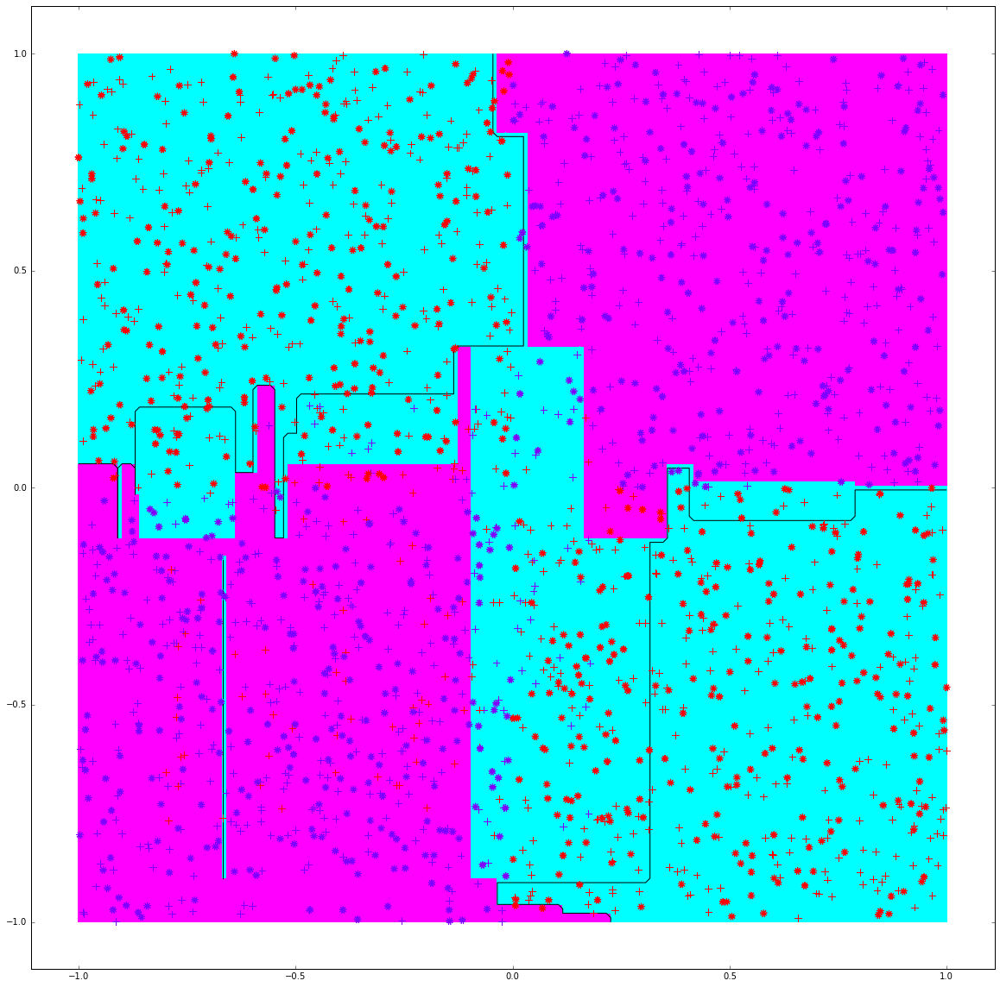



Para n_t:  12
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.898181818182
La precisión con los datos de prueba es:  0.954


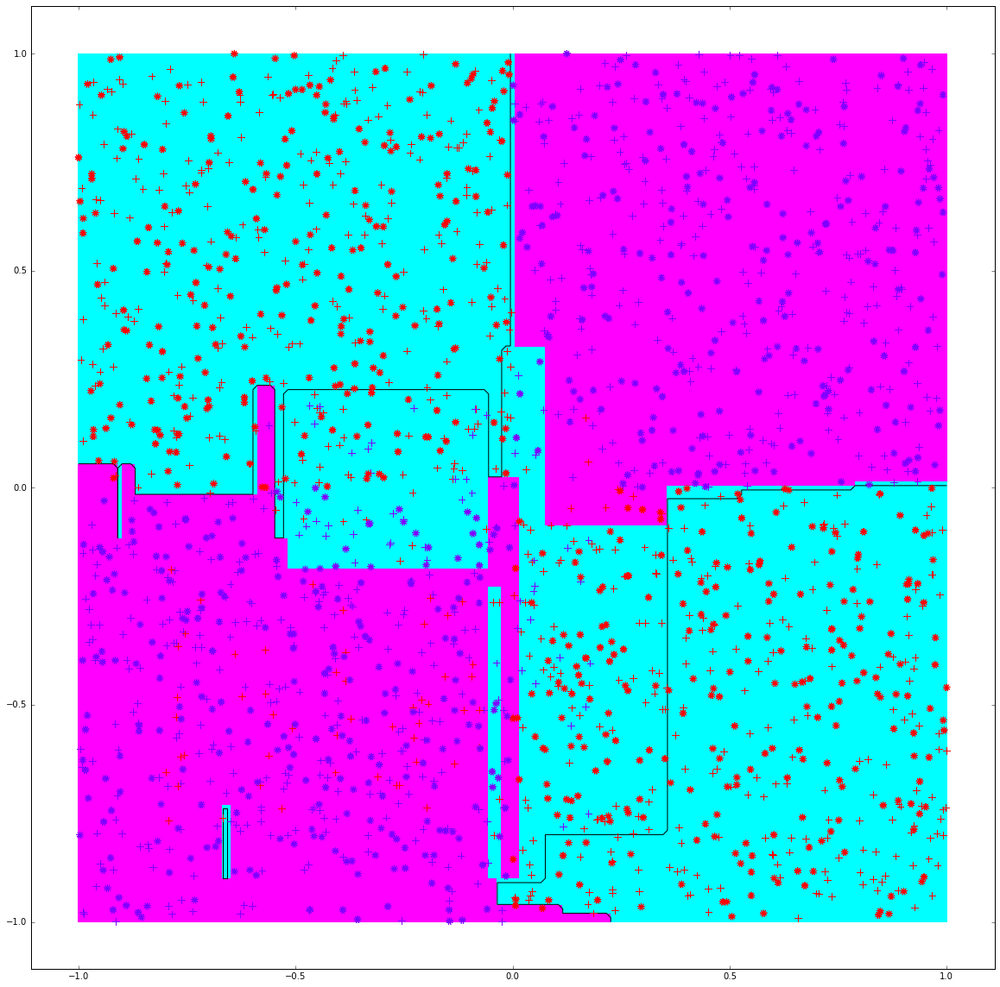



Para n_t:  13
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.909090909091
La precisión con los datos de prueba es:  0.965


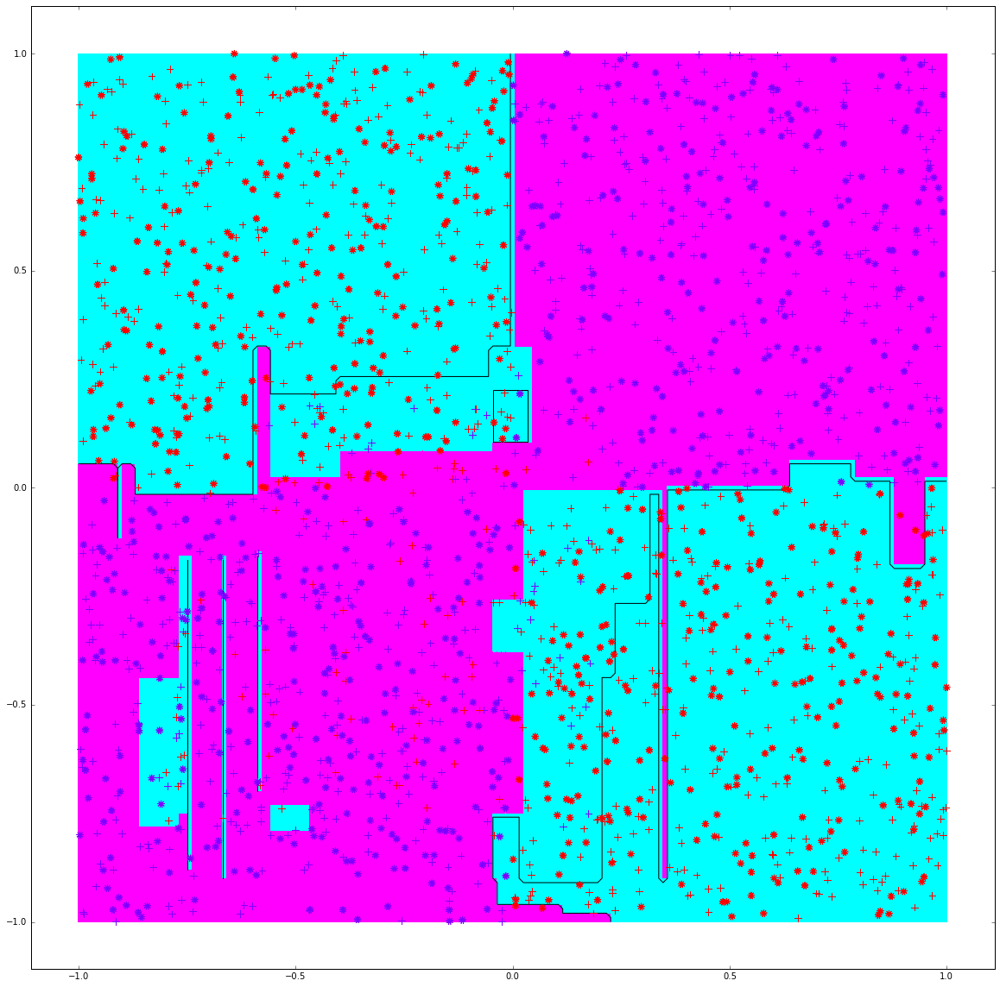



Para n_t:  14
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.918181818182
La precisión con los datos de prueba es:  0.939


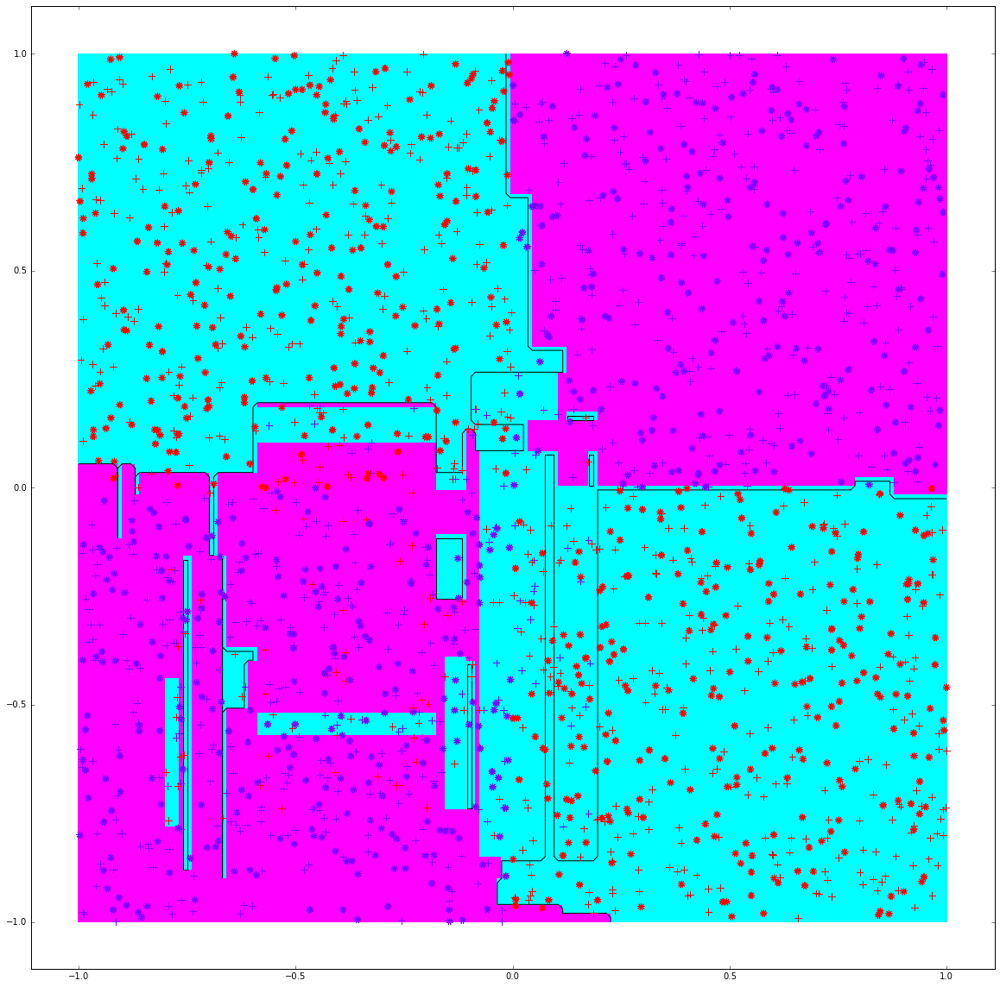



Para n_t:  15
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.946363636364
La precisión con los datos de prueba es:  0.933


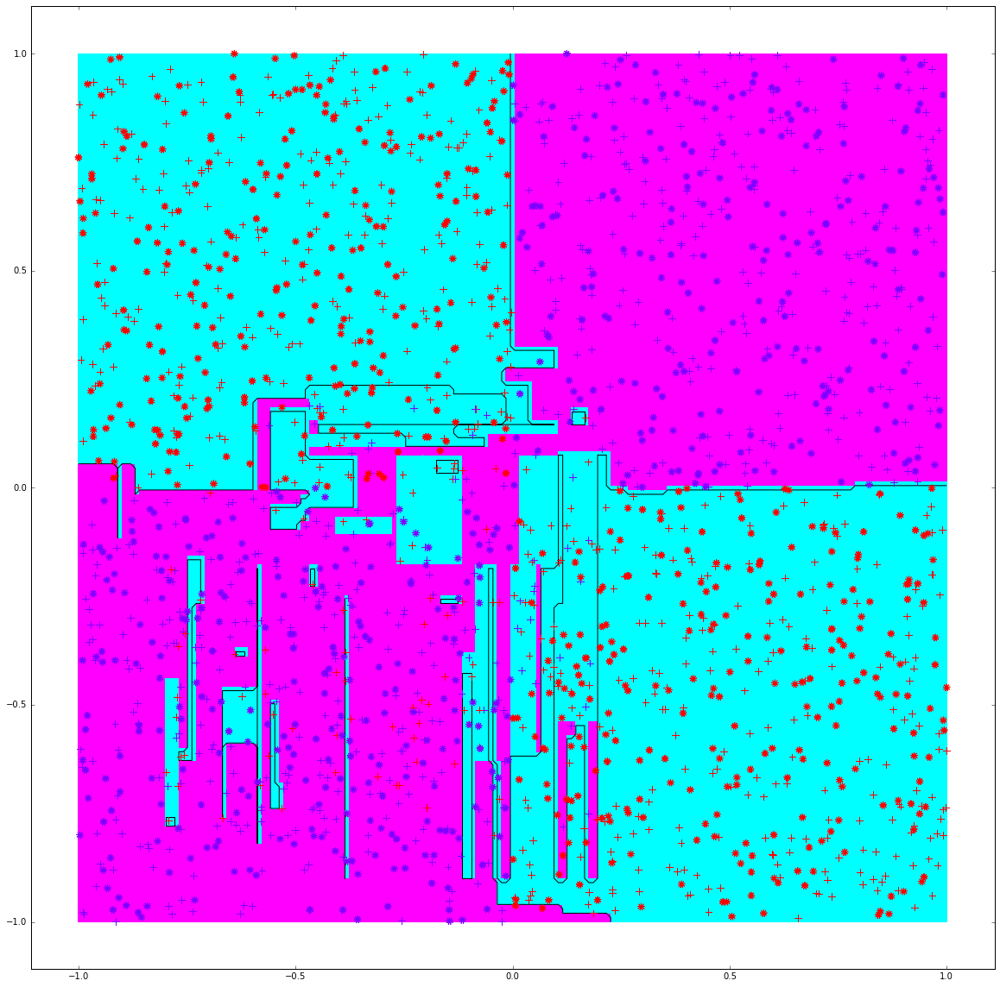



Para n_t:  16
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.958181818182
La precisión con los datos de prueba es:  0.925


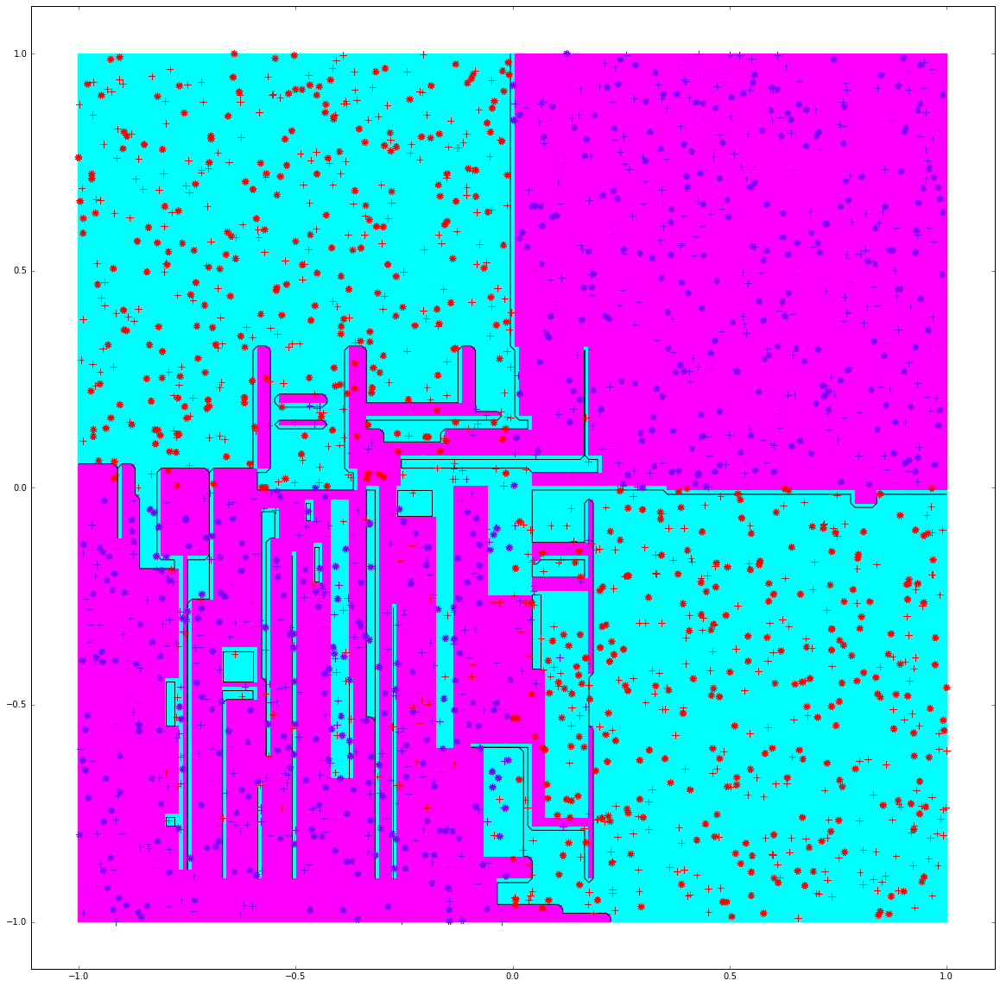



Para n_t:  17
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.970909090909
La precisión con los datos de prueba es:  0.934


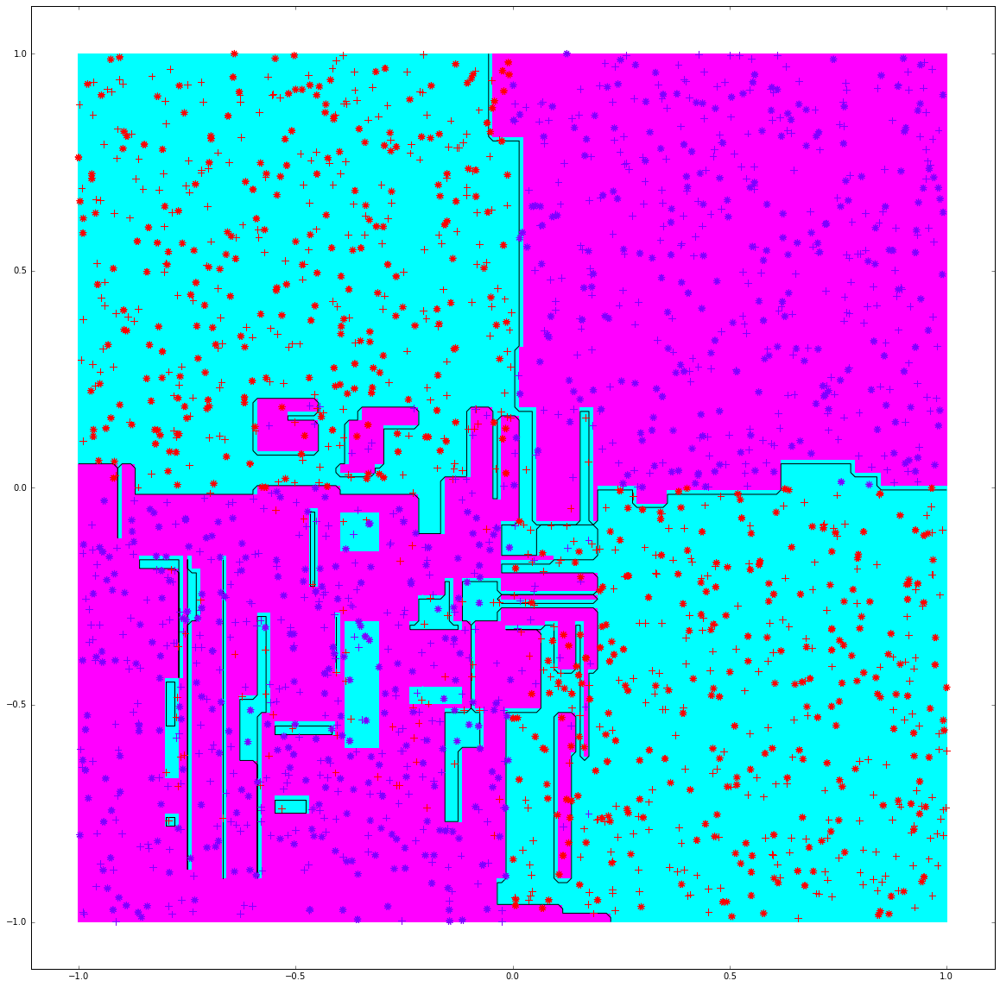



Para n_t:  18
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.988181818182
La precisión con los datos de prueba es:  0.934


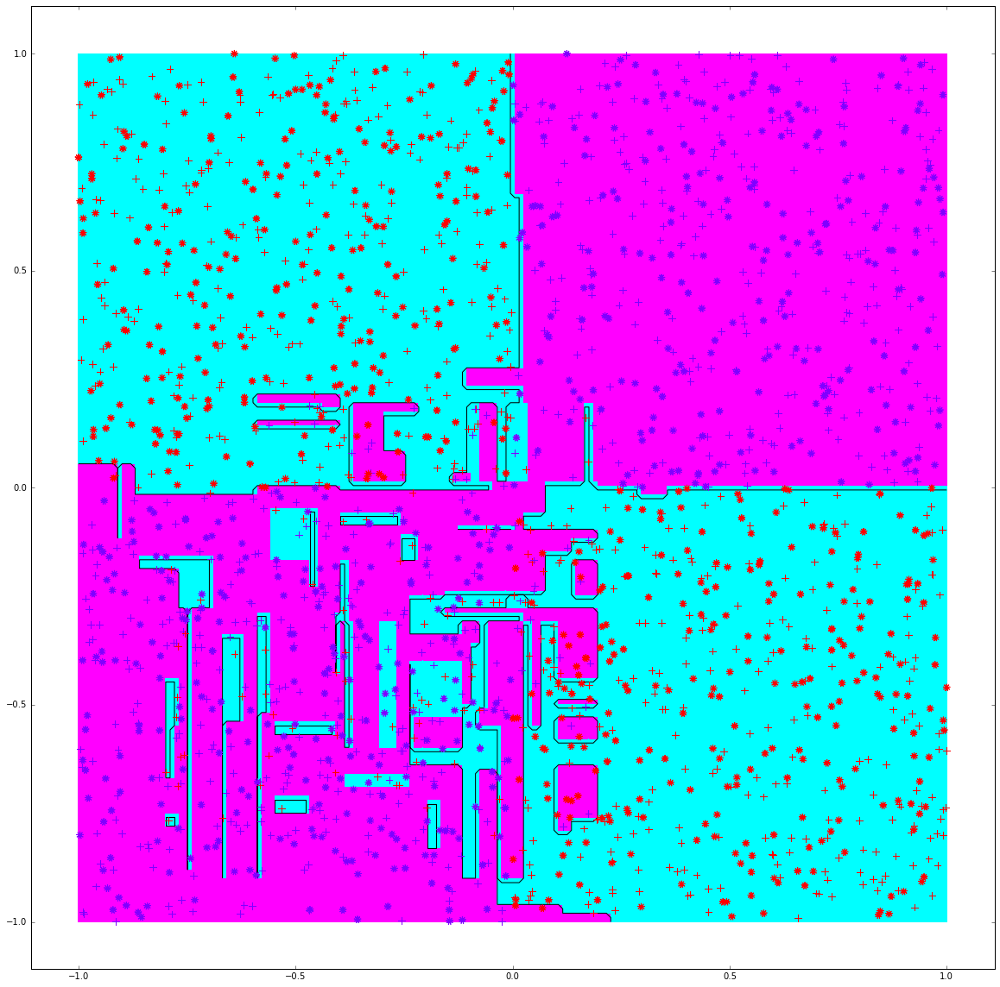



Para n_t:  19
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.991818181818
La precisión con los datos de prueba es:  0.911


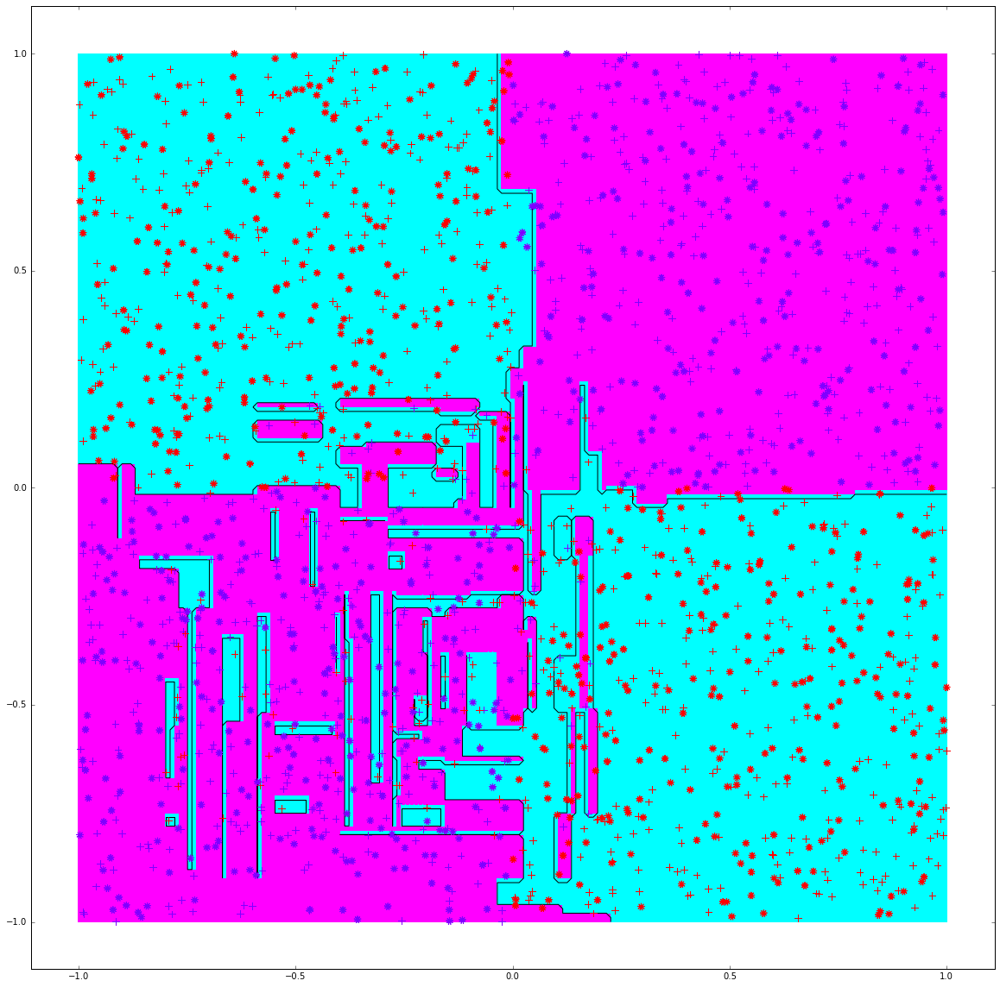



Para n_t:  20
Utilizando criterio Gini y partición Random
La precisión con los datos de entrenamiento es:  0.986363636364
La precisión con los datos de prueba es:  0.919


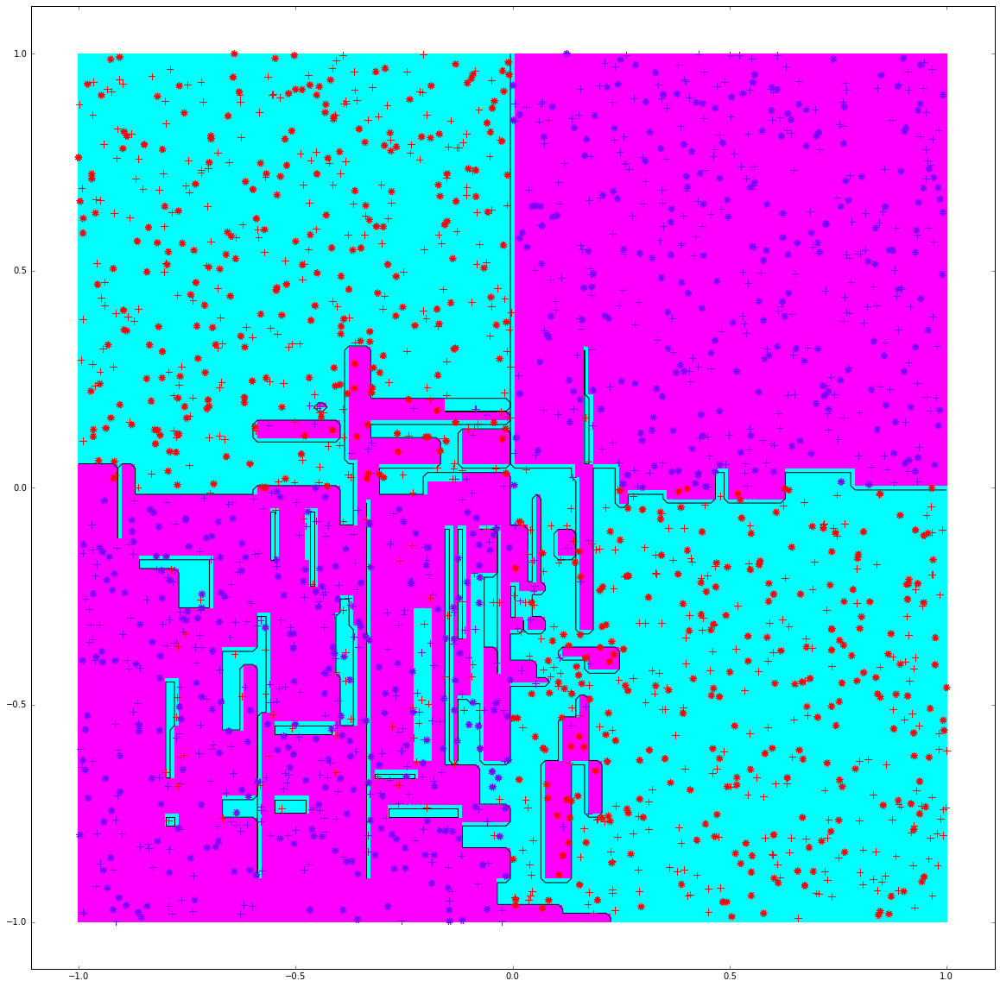

In [15]:
# 2. Precisiones datos de entrenamiento y datos de prueba utilizando árbol con criterio Gini y partición Random

errores_entrenamiento_gini_random=[]
errores_prueba_gini_random=[]
for n_t in range (2,21):
    clf=Tree(criterion='gini',splitter='random',random_state=0,max_depth=n_t)
    clf.fit(X_train,Y_train)
    precision_entrenamiento=clf.score(X_train, Y_train)
    eegr=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_gini_random.append(eegr) #agregando a la lista de errores obtenidos
    
    precision_prueba=clf.score(X_test, Y_test)
    epgr=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_gini_random.append(epgr) #agregando a la lista de errores obtenidos
    
    print "Para n_t: ", n_t
    print "Utilizando criterio Gini y partición Random"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    #print clf.tree_.max_depth
    plot_classifier(clf,X_train,Y_train,X_test,Y_test,'tree')
    print "\n"

Para n_t:  2
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.532727272727
La precisión con los datos de prueba es:  0.481


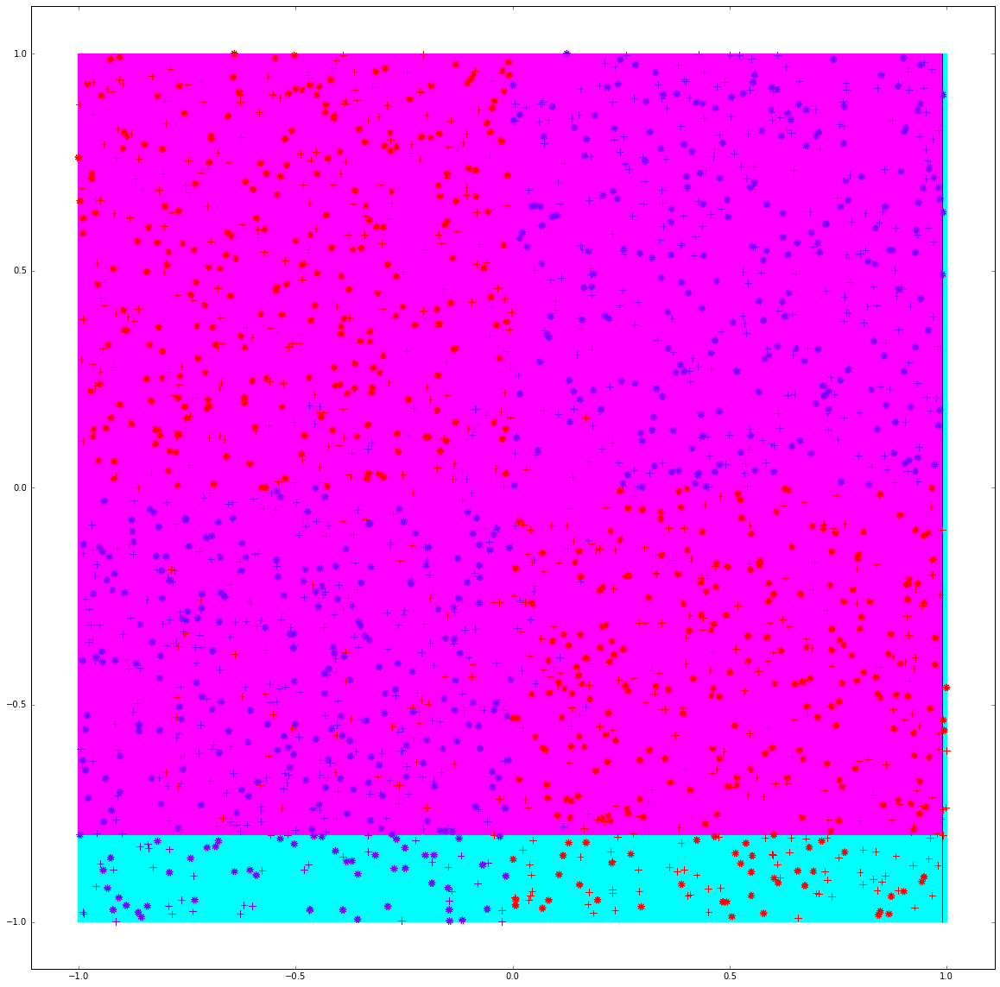



Para n_t:  3
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.625454545455
La precisión con los datos de prueba es:  0.565


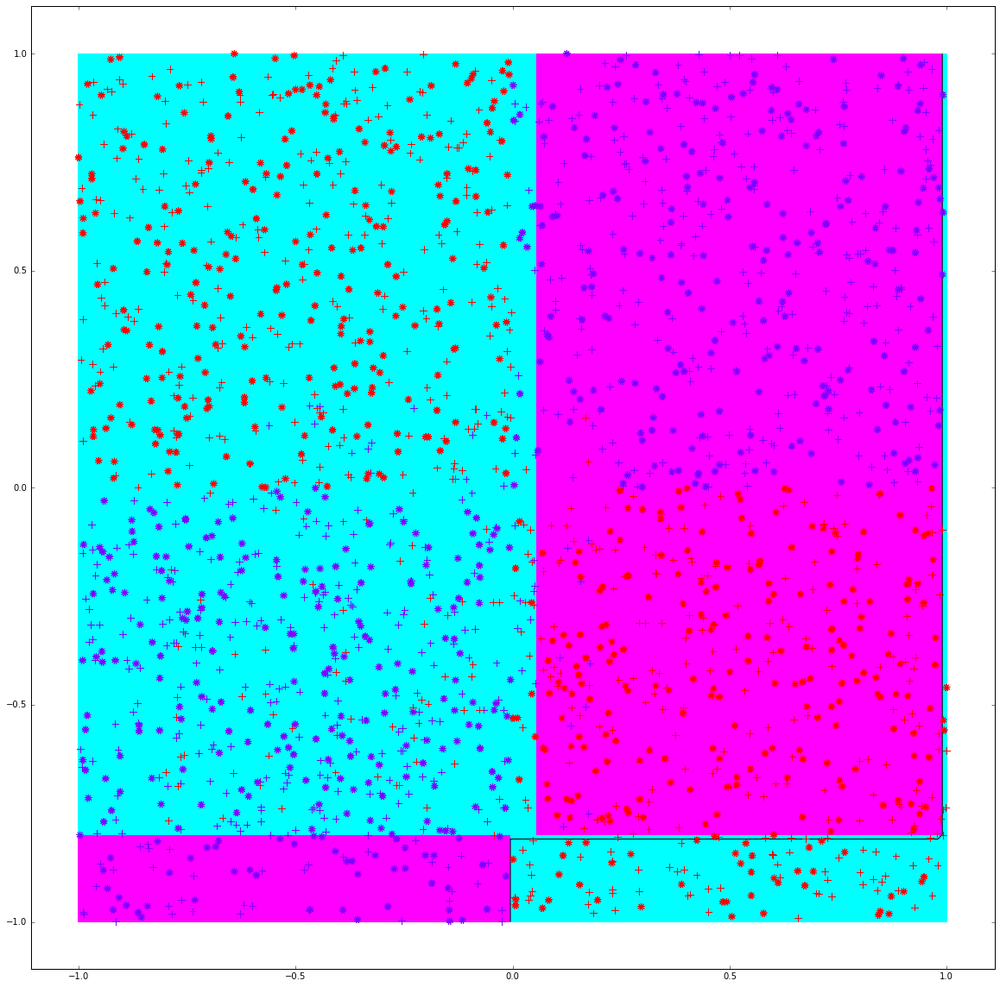



Para n_t:  4
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.9
La precisión con los datos de prueba es:  0.975


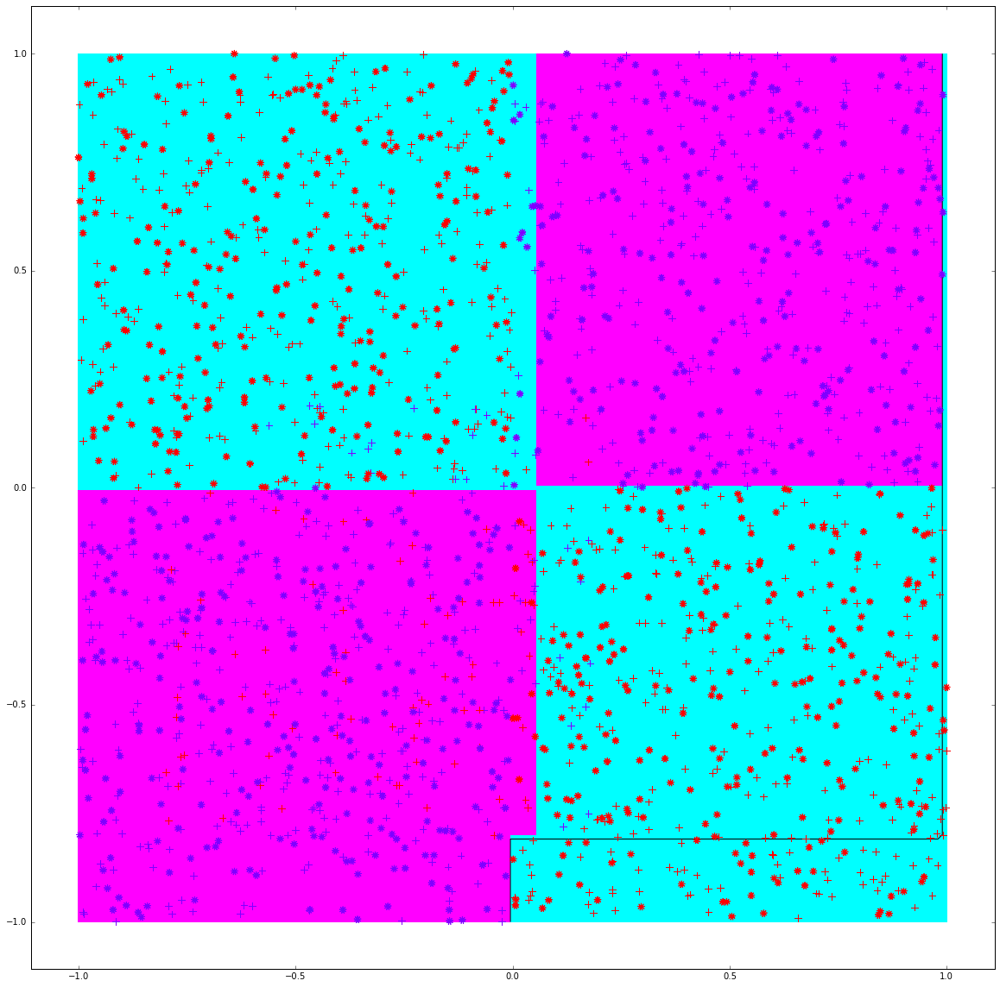



Para n_t:  5
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.9
La precisión con los datos de prueba es:  0.975


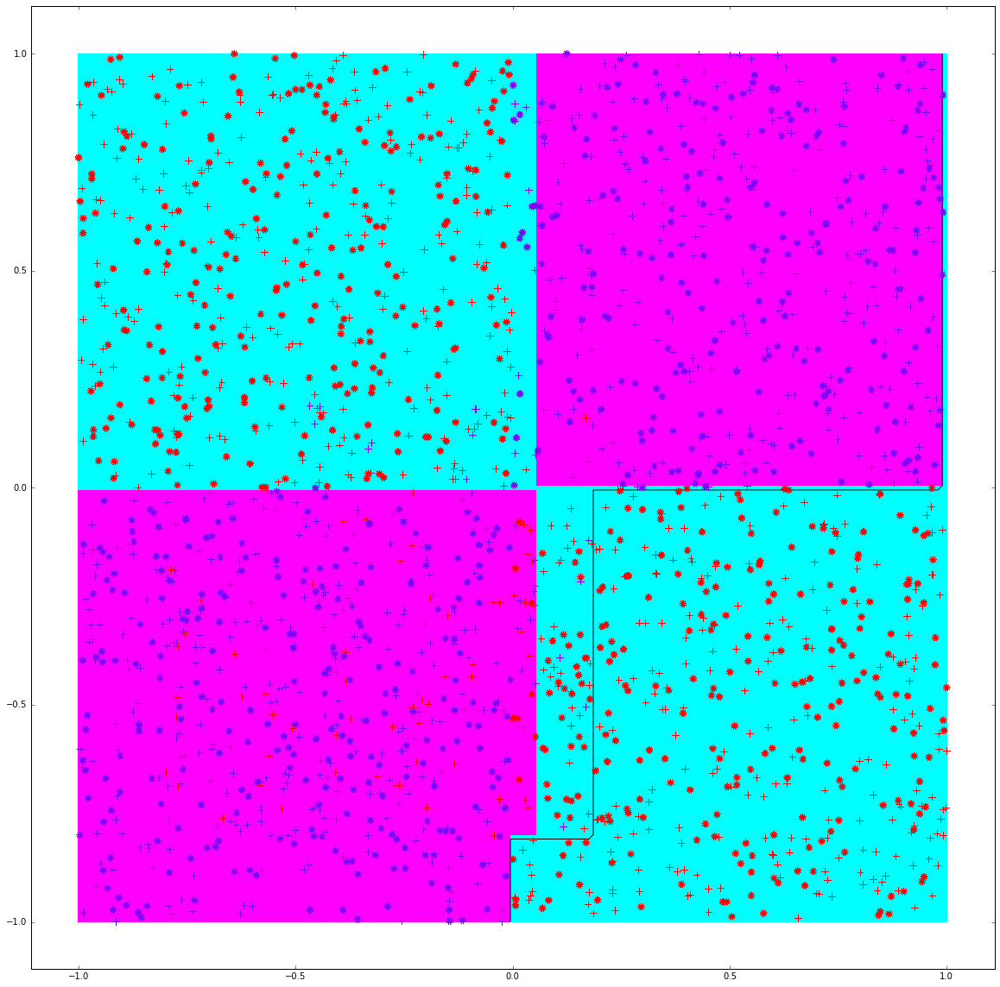



Para n_t:  6
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.916363636364
La precisión con los datos de prueba es:  0.98


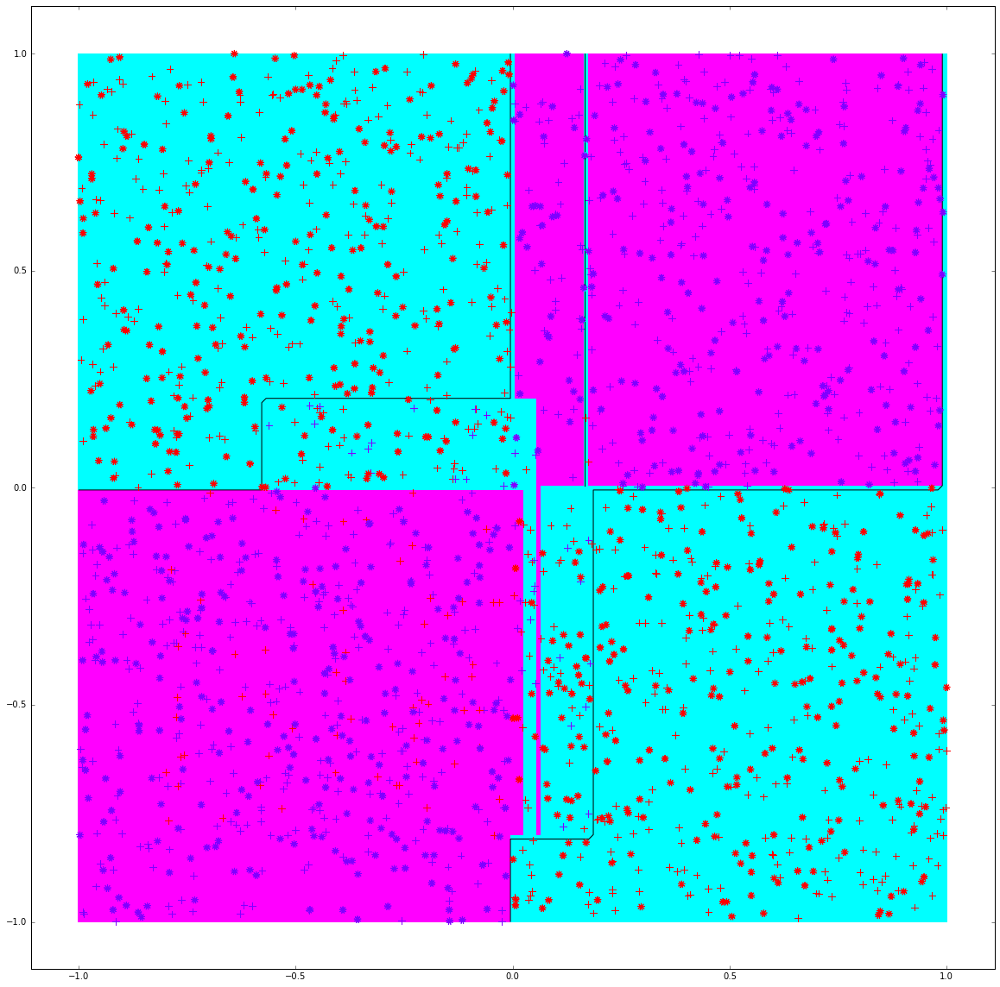



Para n_t:  7
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.921818181818
La precisión con los datos de prueba es:  0.975


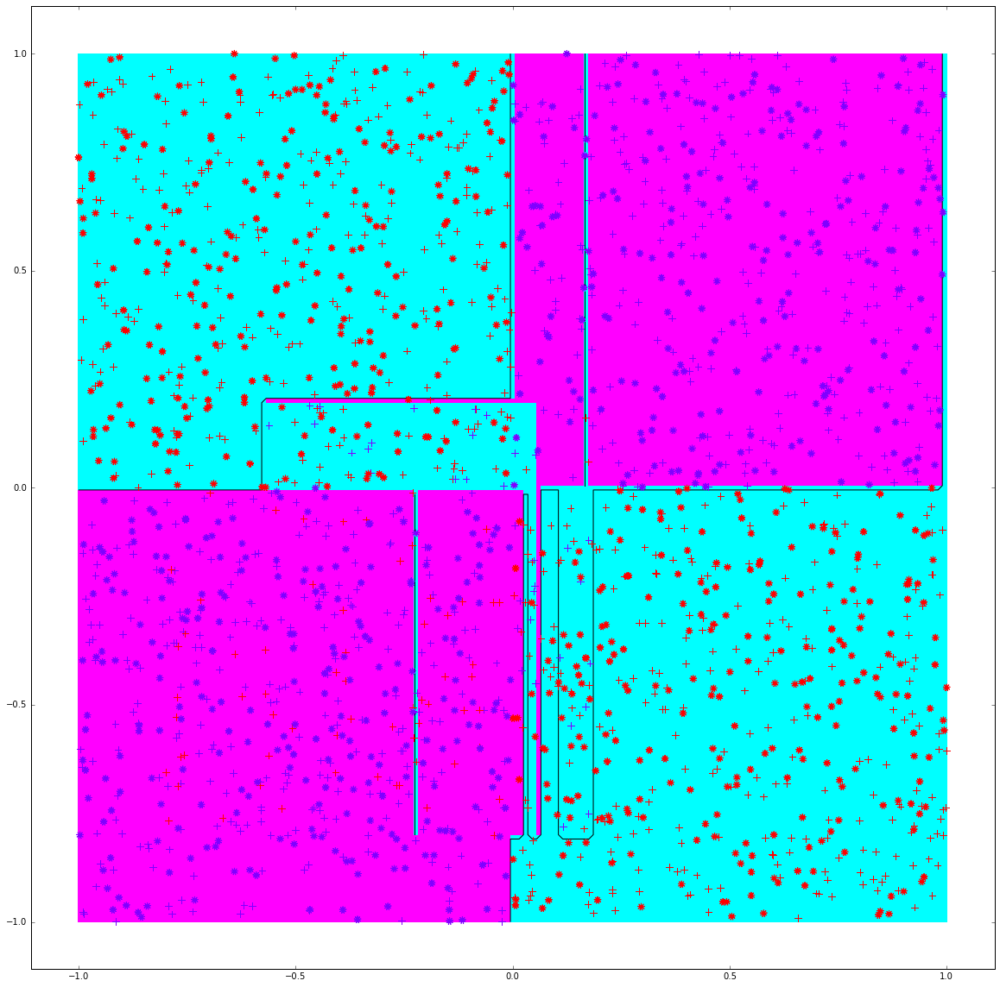



Para n_t:  8
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.925454545455
La precisión con los datos de prueba es:  0.974


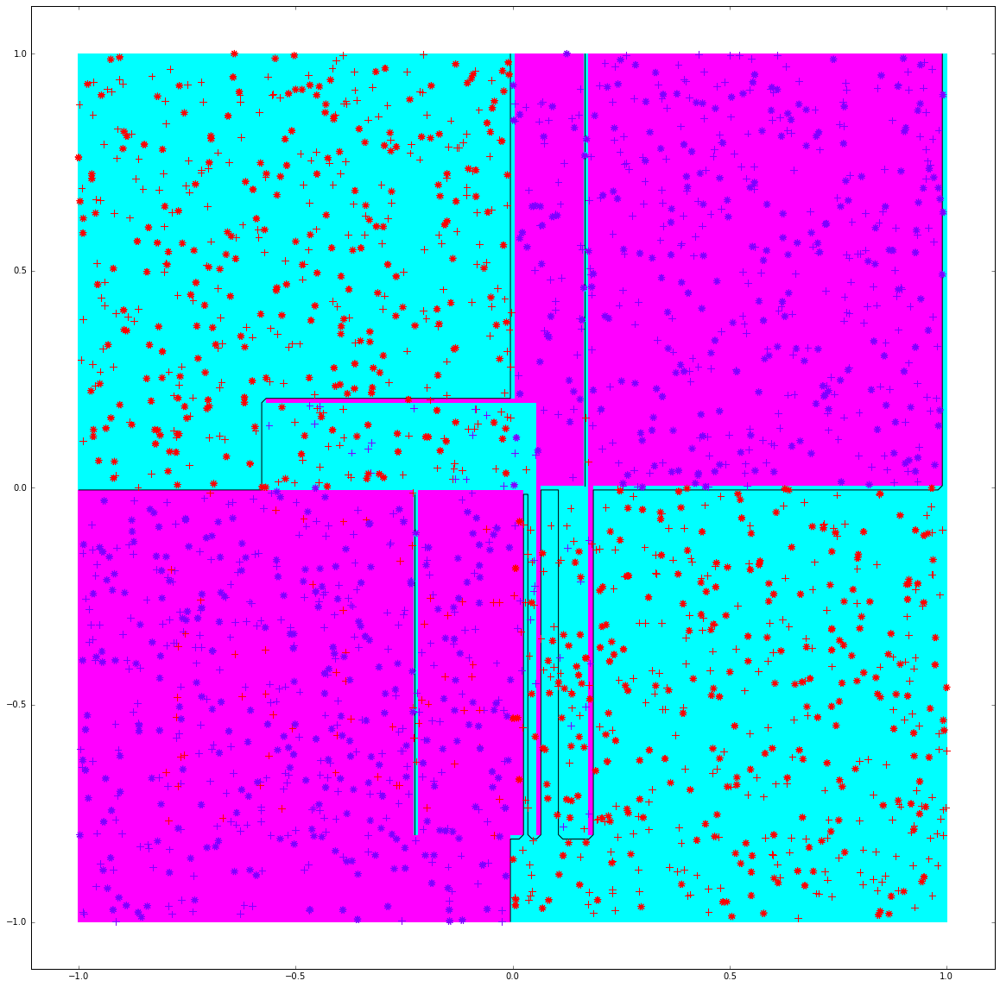



Para n_t:  9
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.937272727273
La precisión con los datos de prueba es:  0.961


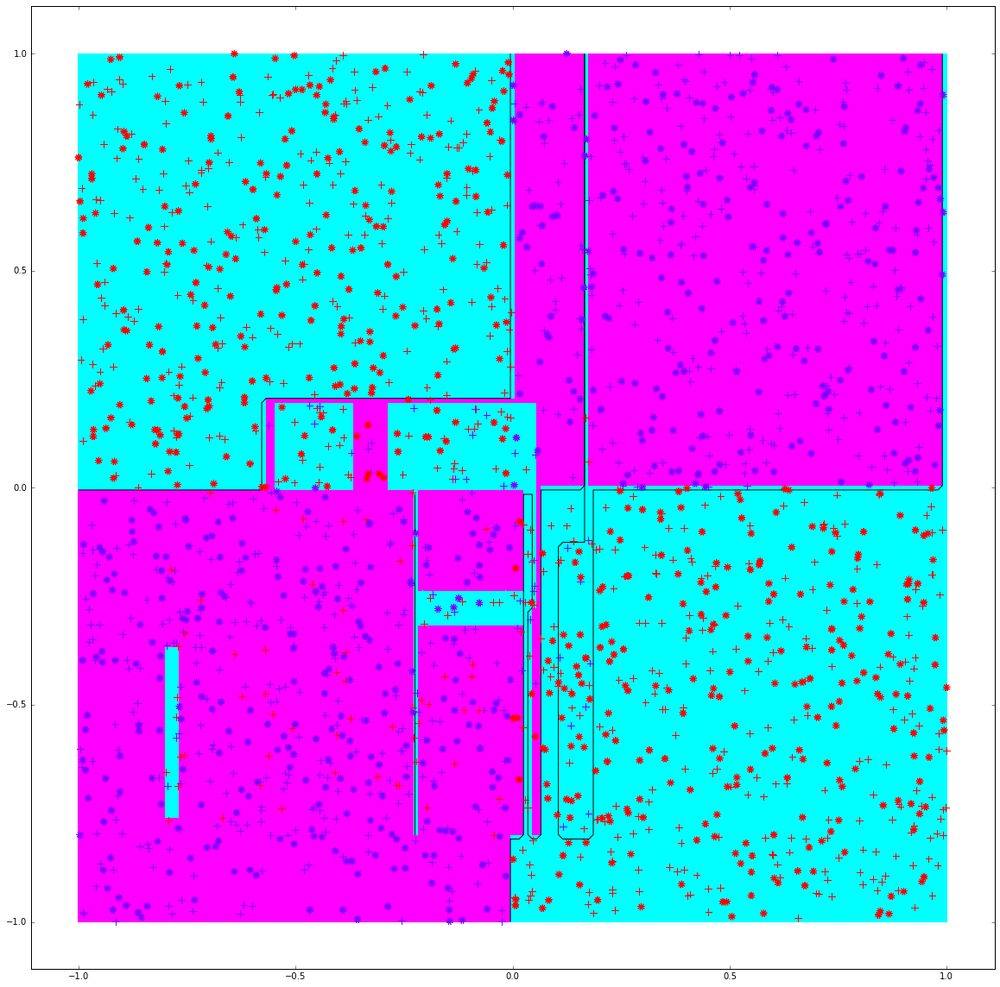



Para n_t:  10
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.944545454545
La precisión con los datos de prueba es:  0.953


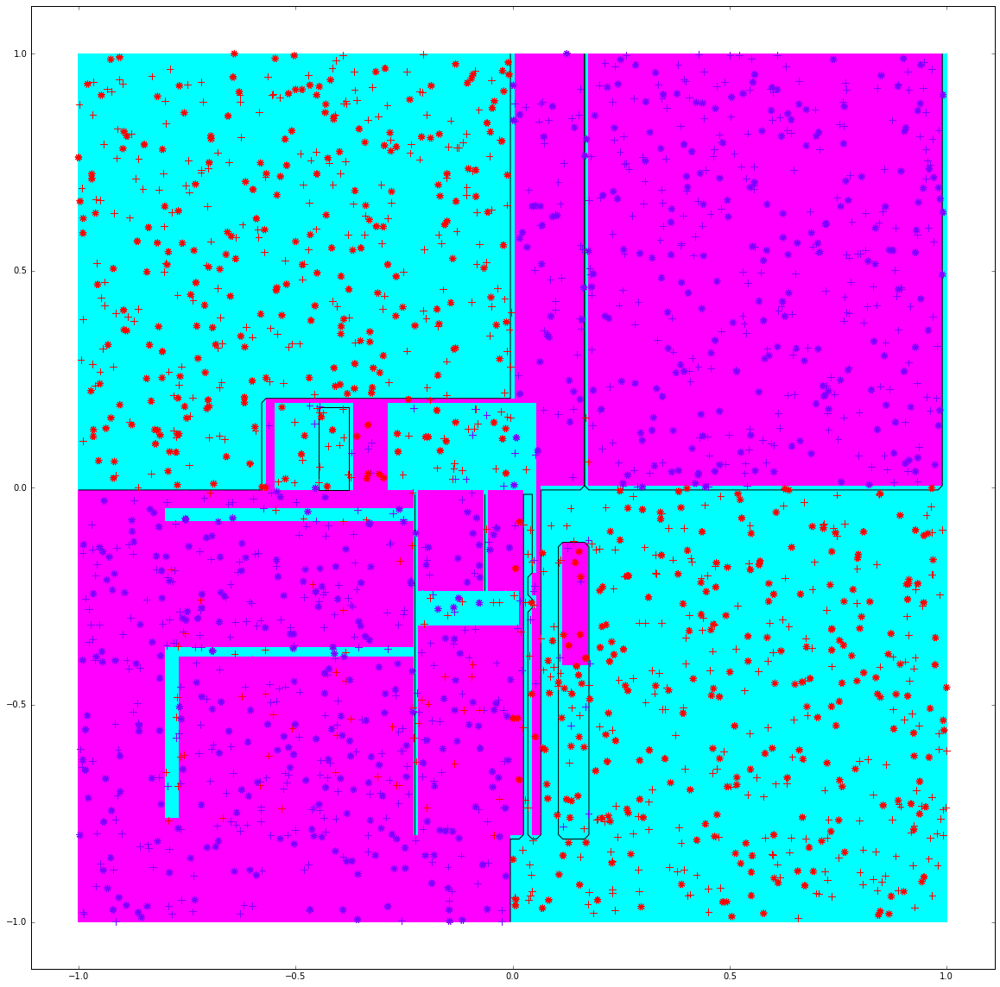



Para n_t:  11
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.954545454545
La precisión con los datos de prueba es:  0.945


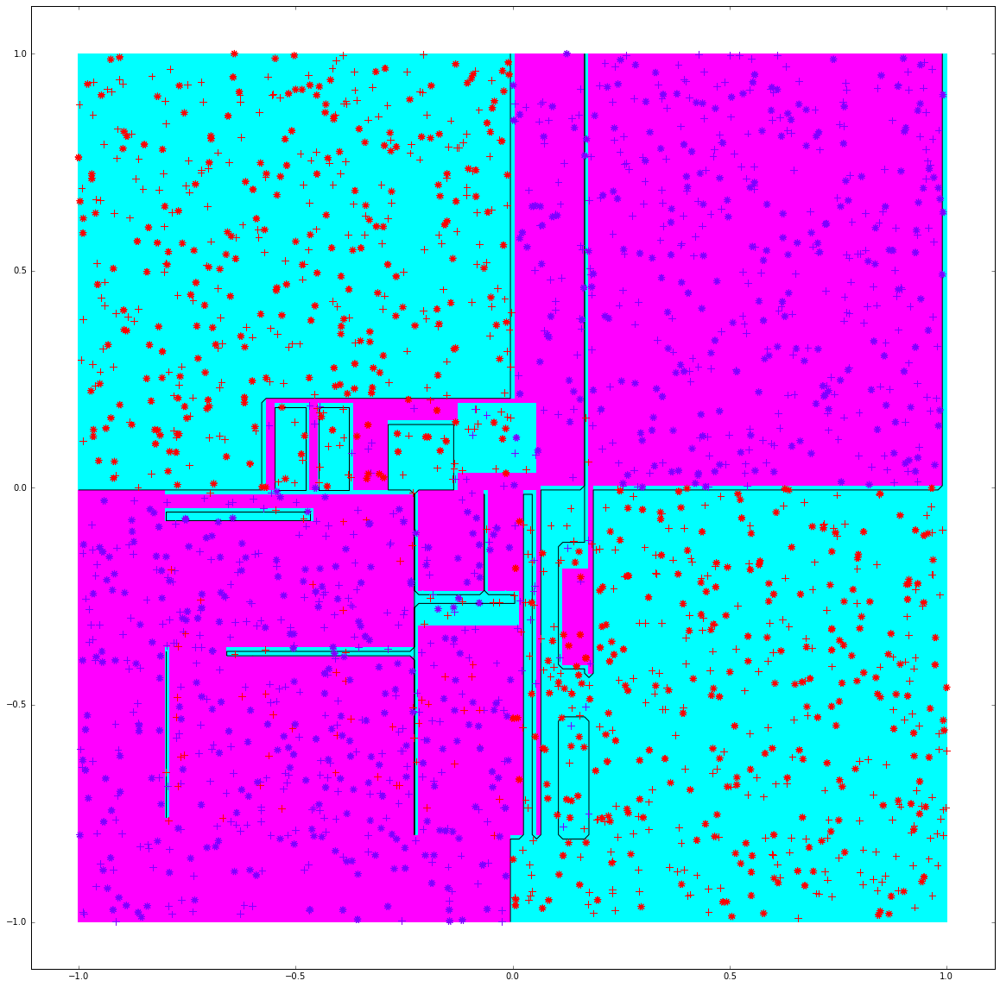



Para n_t:  12
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.963636363636
La precisión con los datos de prueba es:  0.93


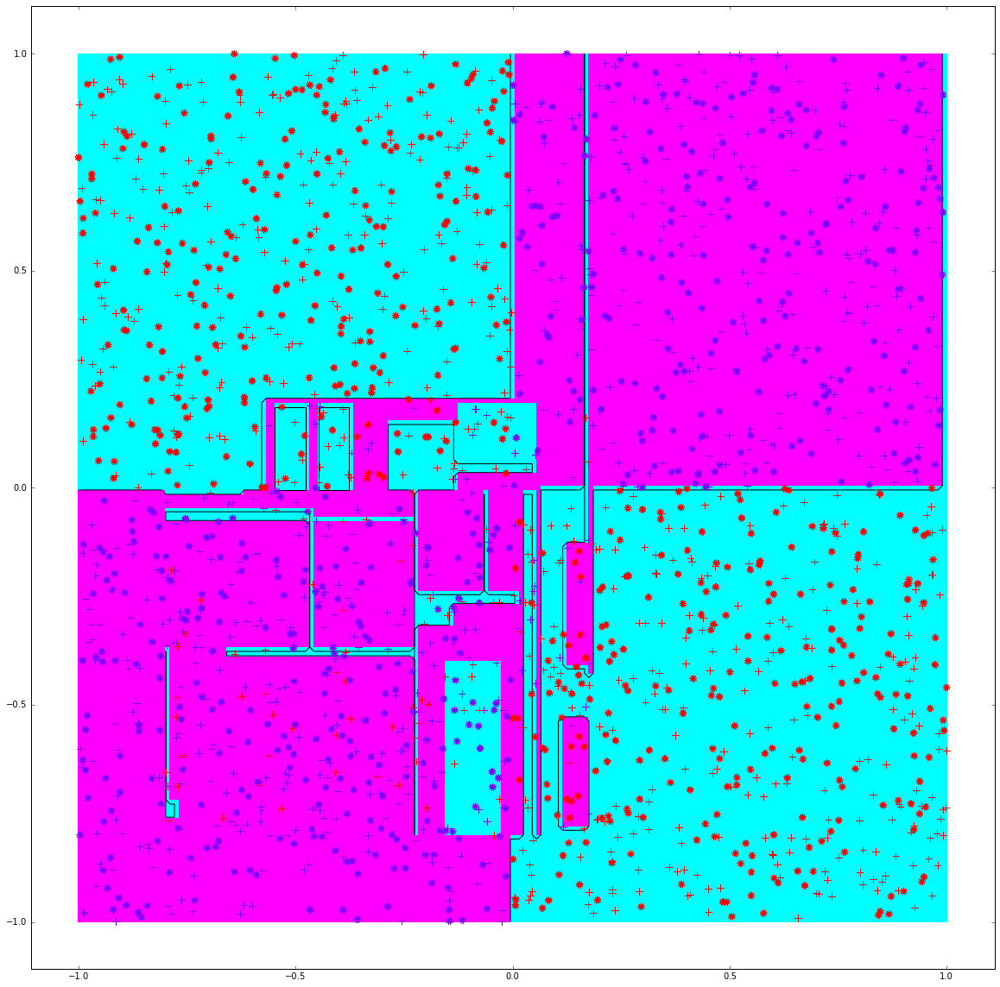



Para n_t:  13
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.968181818182
La precisión con los datos de prueba es:  0.927


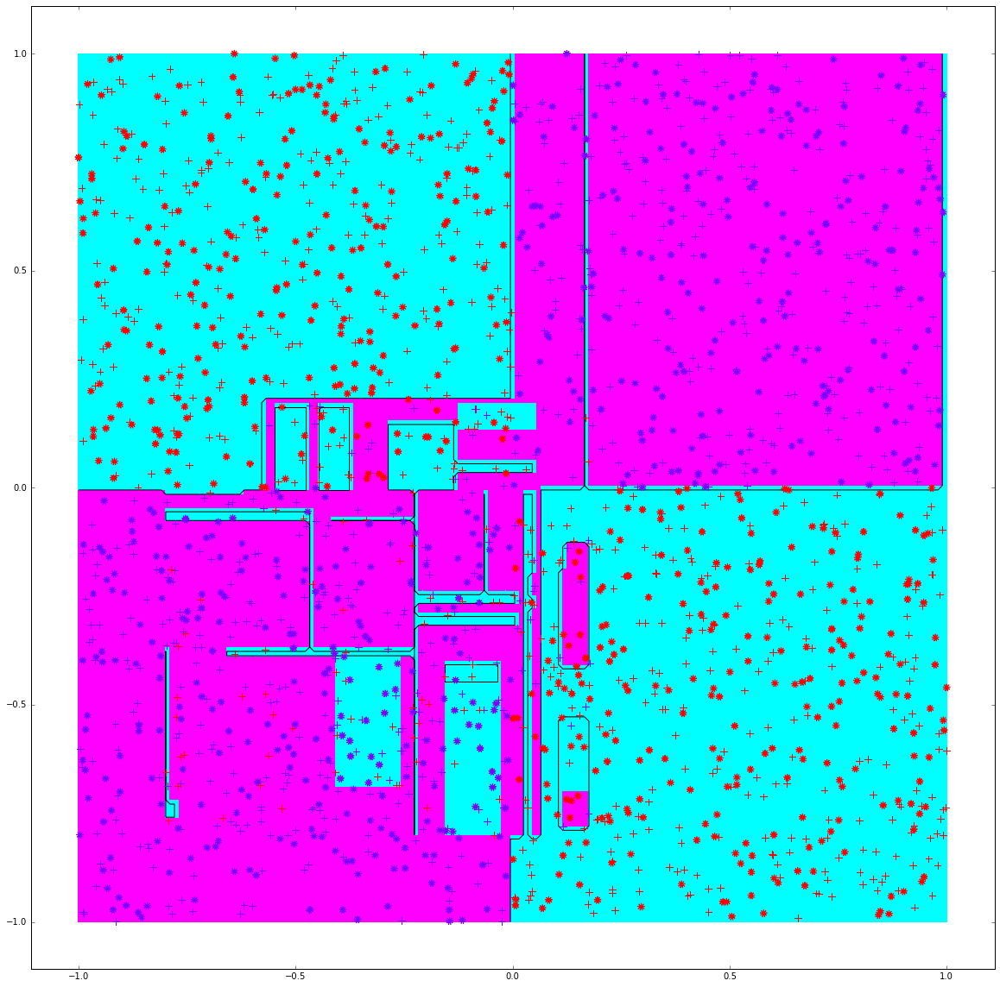



Para n_t:  14
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.975454545455
La precisión con los datos de prueba es:  0.932


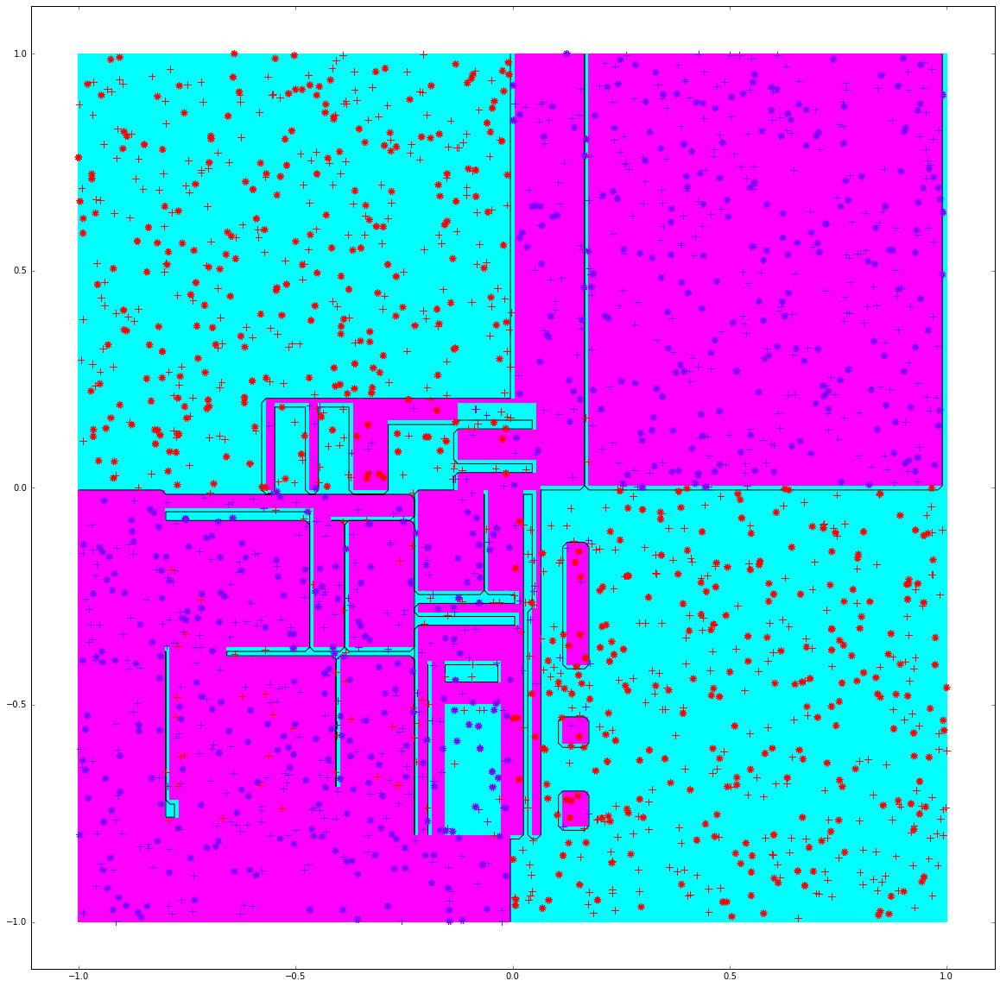



Para n_t:  15
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.982727272727
La precisión con los datos de prueba es:  0.937


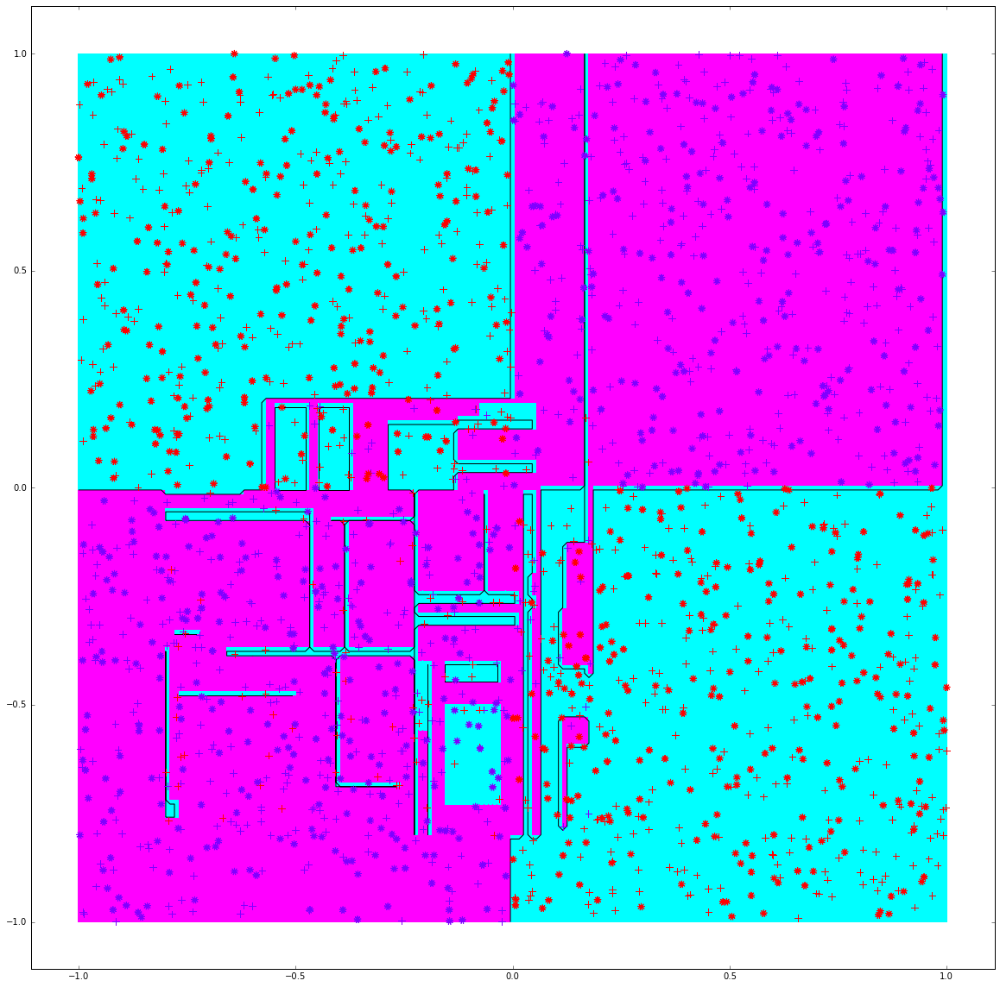



Para n_t:  16
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.988181818182
La precisión con los datos de prueba es:  0.931


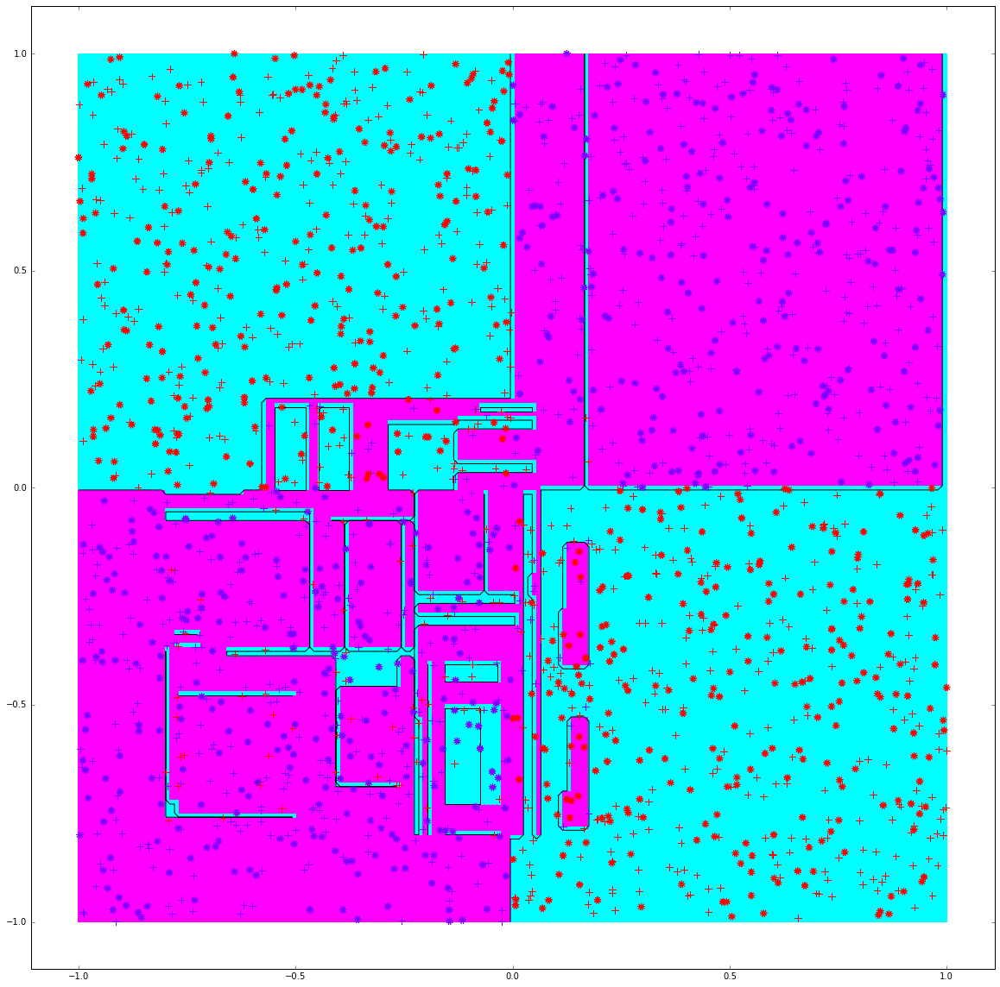



Para n_t:  17
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.991818181818
La precisión con los datos de prueba es:  0.932


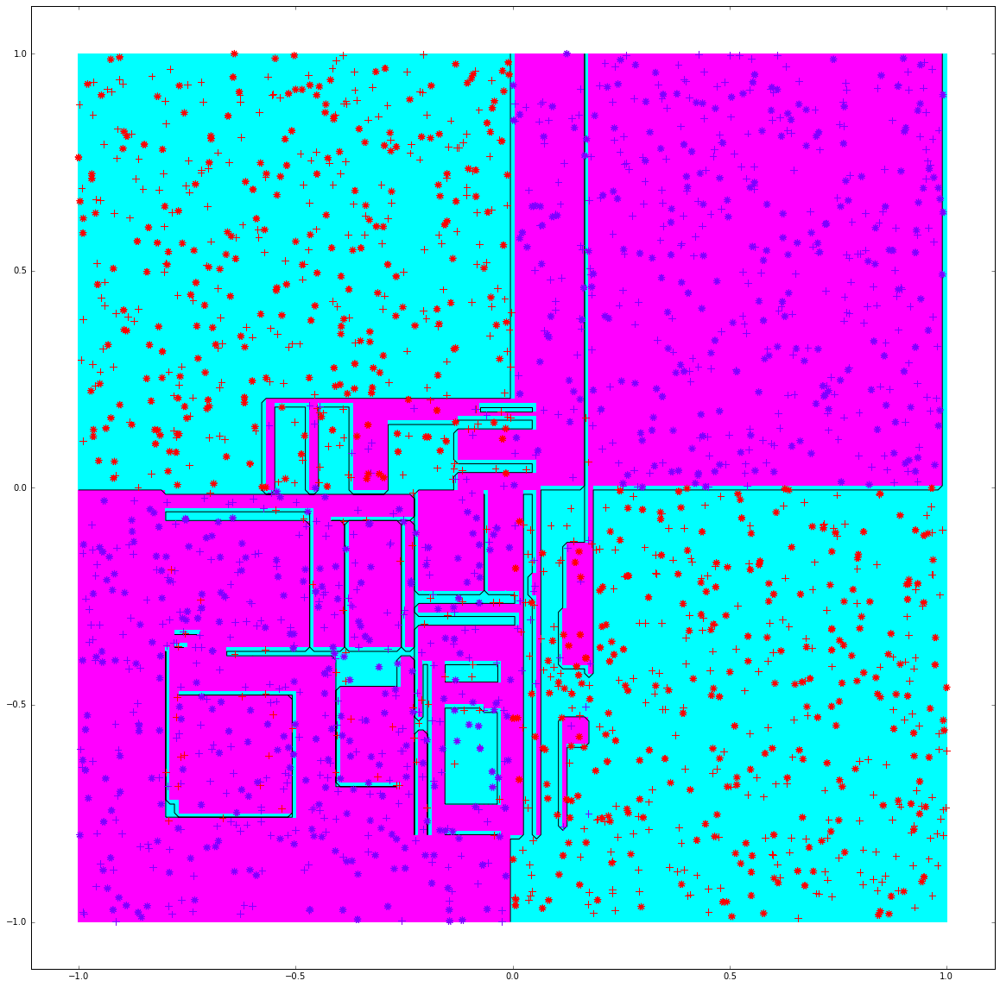



Para n_t:  18
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.992727272727
La precisión con los datos de prueba es:  0.929


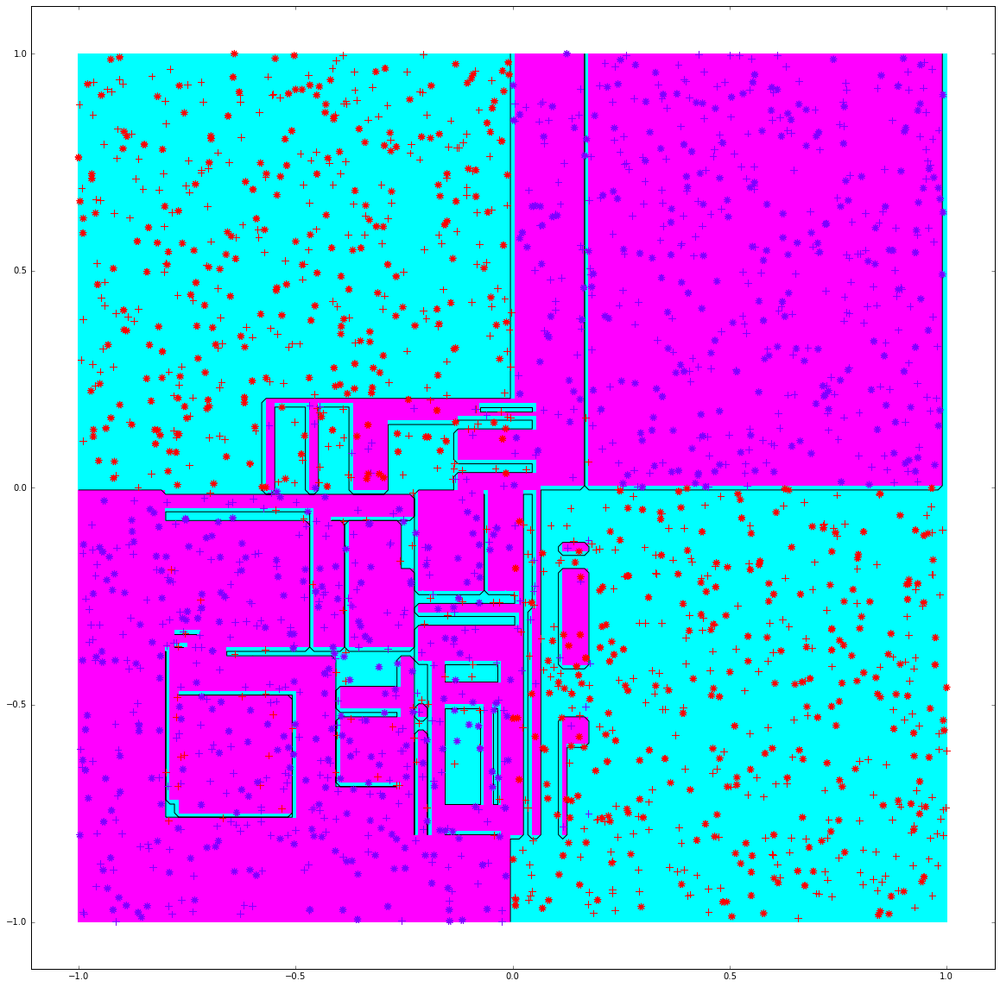



Para n_t:  19
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.993636363636
La precisión con los datos de prueba es:  0.925


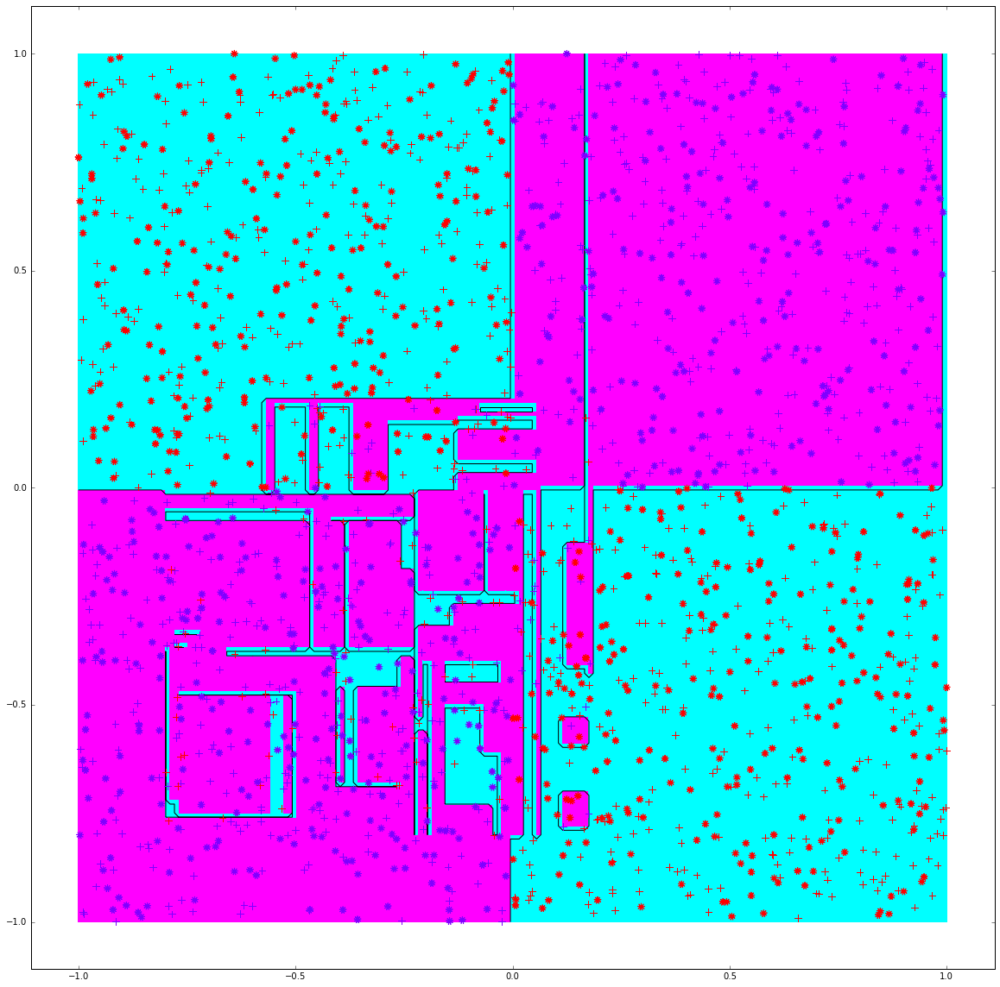



Para n_t:  20
Utilizando criterio Entropy y partición Best
La precisión con los datos de entrenamiento es:  0.996363636364
La precisión con los datos de prueba es:  0.924


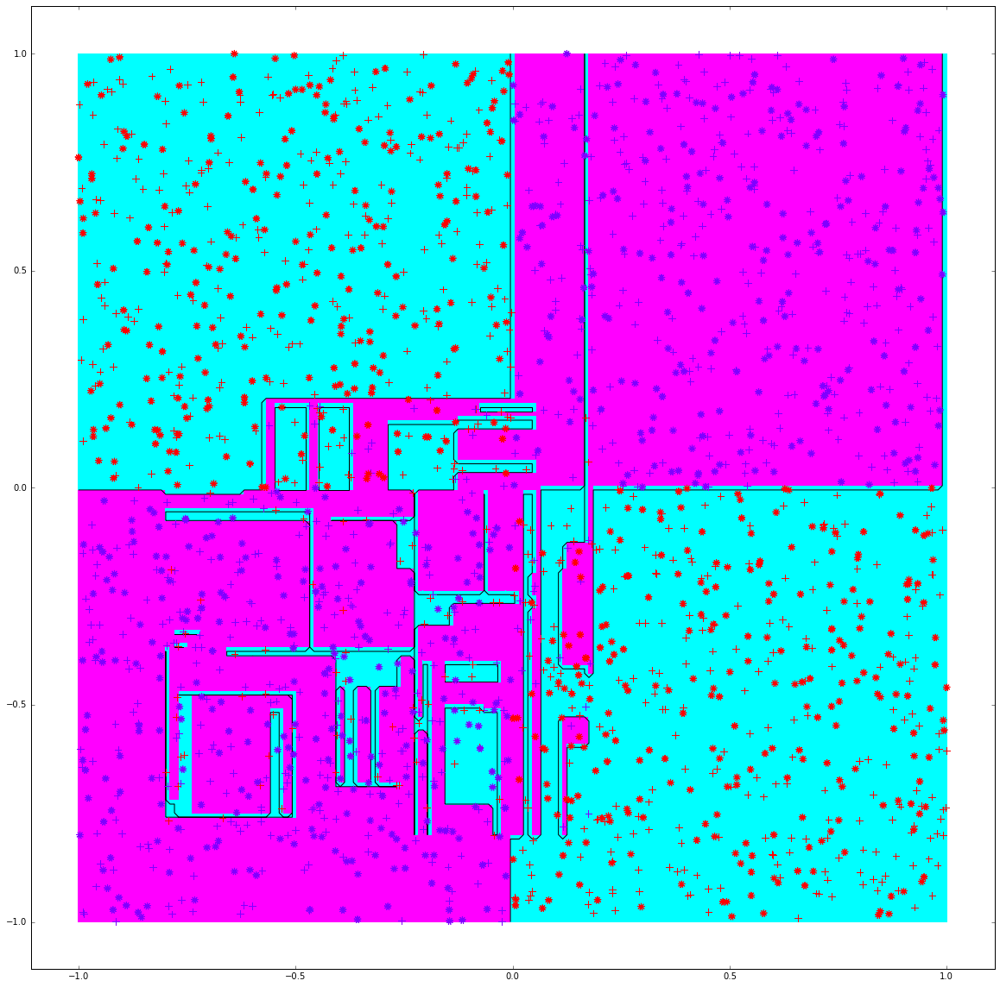

In [31]:
# 3. Precisiones datos de entrenamiento y datos de prueba utilizando árbol con criterio Entropy y partición Best

errores_entrenamiento_entropy_best=[]
errores_prueba_entropy_best=[]
for n_t in range (2,21):
    clf=Tree(criterion='entropy',splitter='best',random_state=0,max_depth=n_t)
    clf.fit(X_train,Y_train)
    precision_entrenamiento=clf.score(X_train, Y_train)
    eeeb=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_entropy_best.append(eeeb) #agregando a la lista de errores obtenidos
    
    precision_prueba=clf.score(X_test, Y_test)
    epeb=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_entropy_best.append(epeb) #agregando a la lista de errores obtenidos
    
    print "Para n_t: ", n_t
    print "Utilizando criterio Entropy y partición Best"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    #print clf.tree_.max_depth
    plot_classifier(clf,X_train,Y_train,X_test,Y_test,'tree')
    print "\n"

Para n_t:  2
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.535454545455
La precisión con los datos de prueba es:  0.514


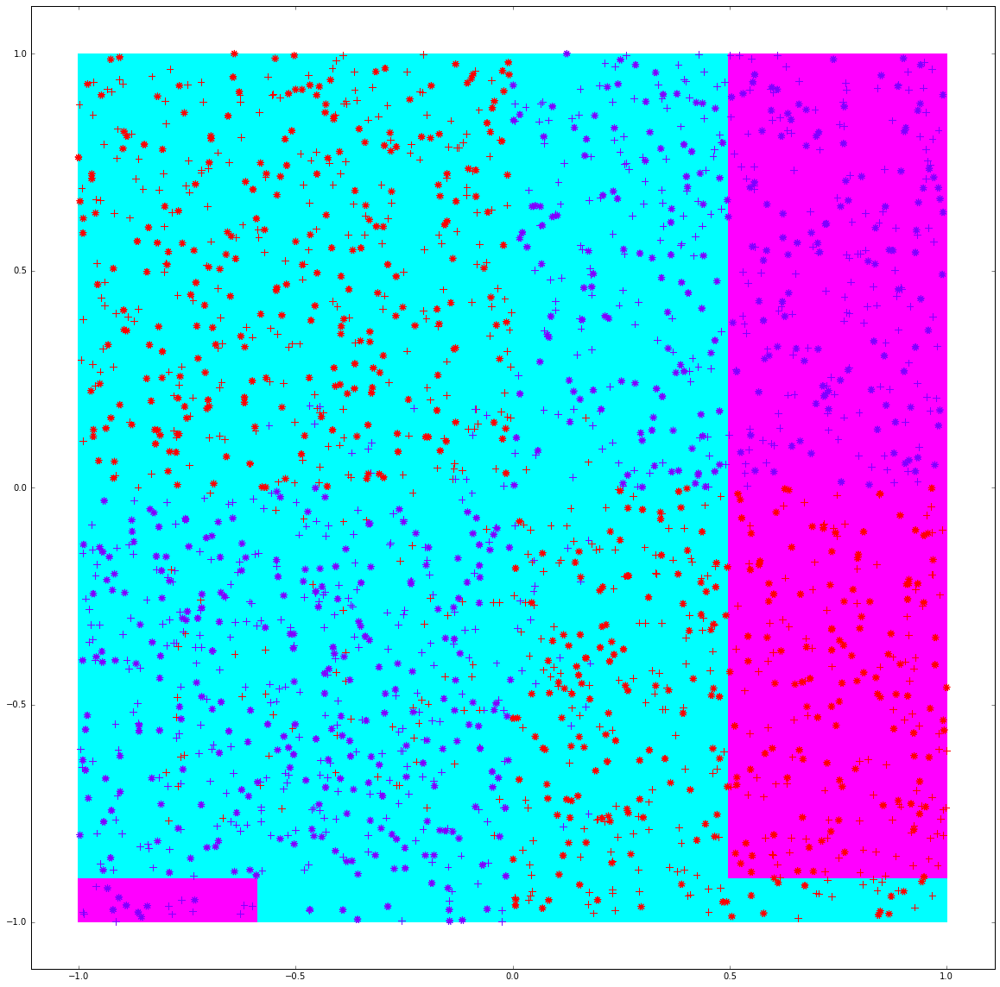



Para n_t:  3
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.777272727273
La precisión con los datos de prueba es:  0.791


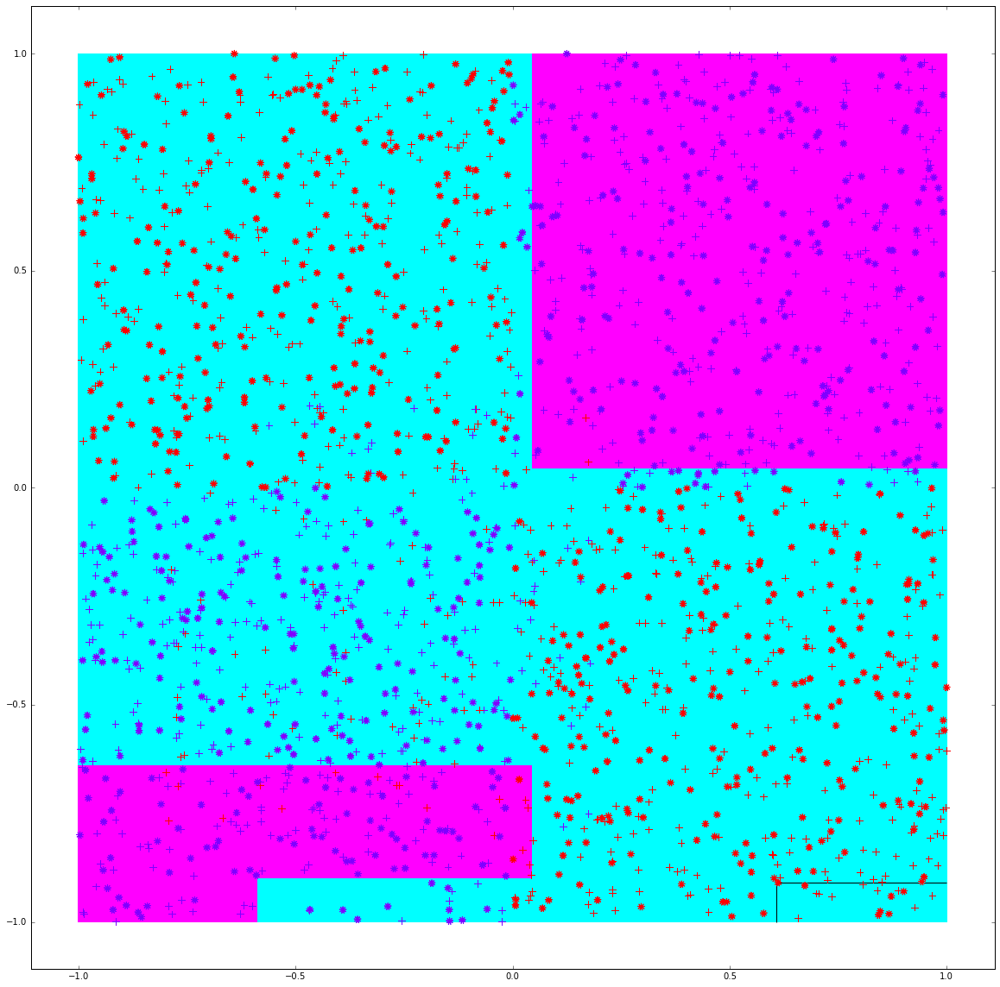



Para n_t:  4
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.669090909091
La precisión con los datos de prueba es:  0.61


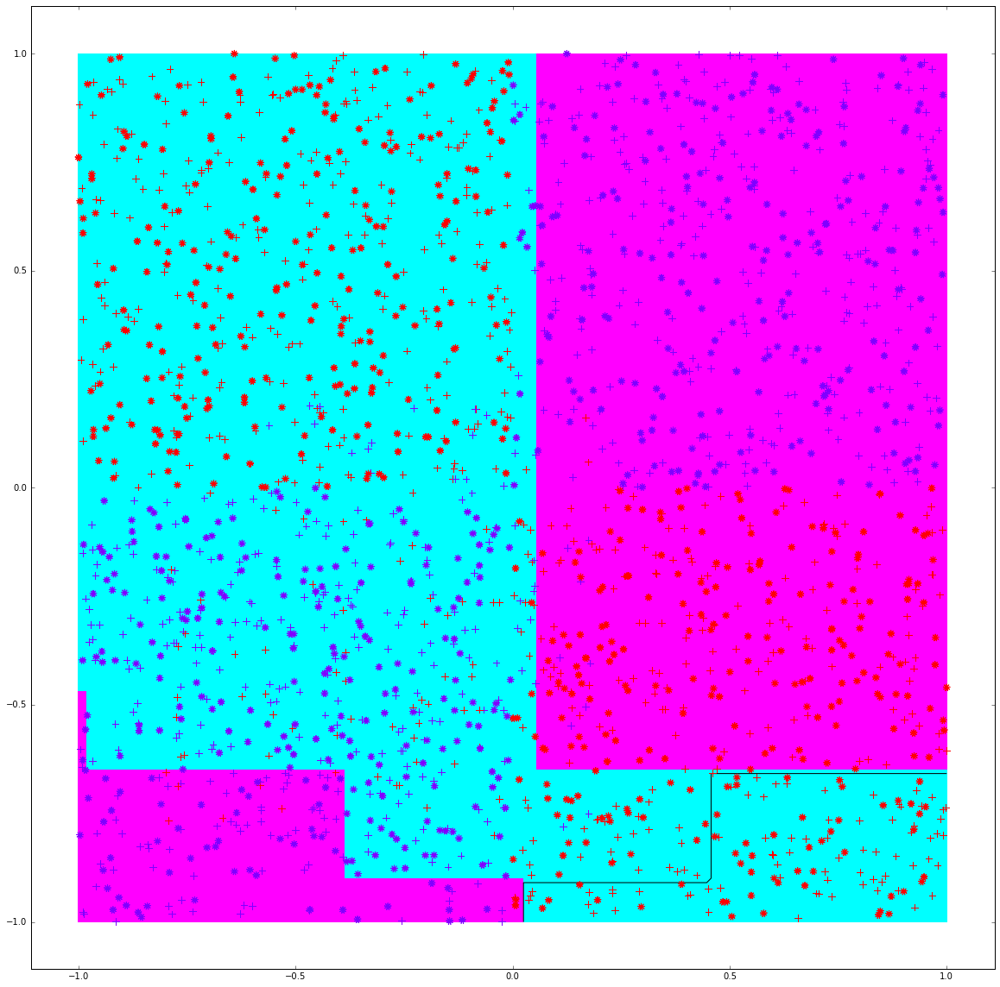



Para n_t:  5
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.628181818182
La precisión con los datos de prueba es:  0.601


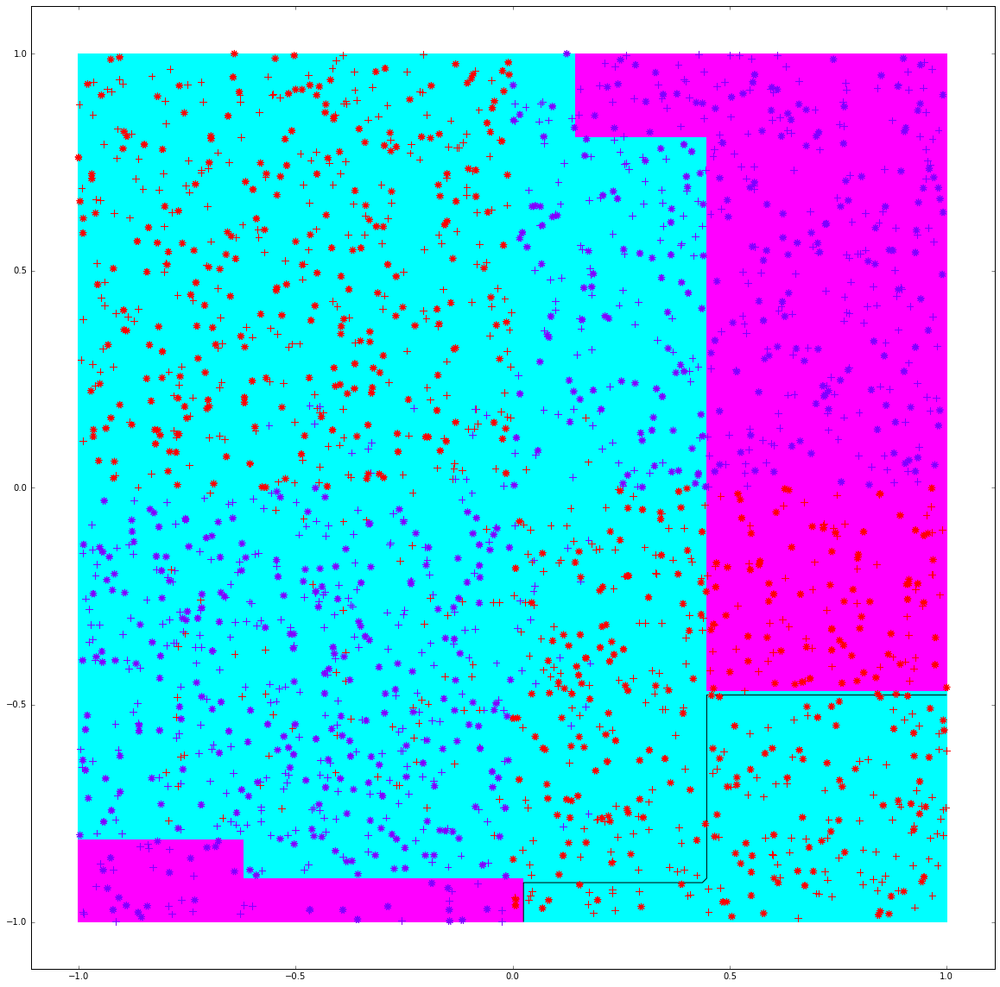



Para n_t:  6
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.671818181818
La precisión con los datos de prueba es:  0.655


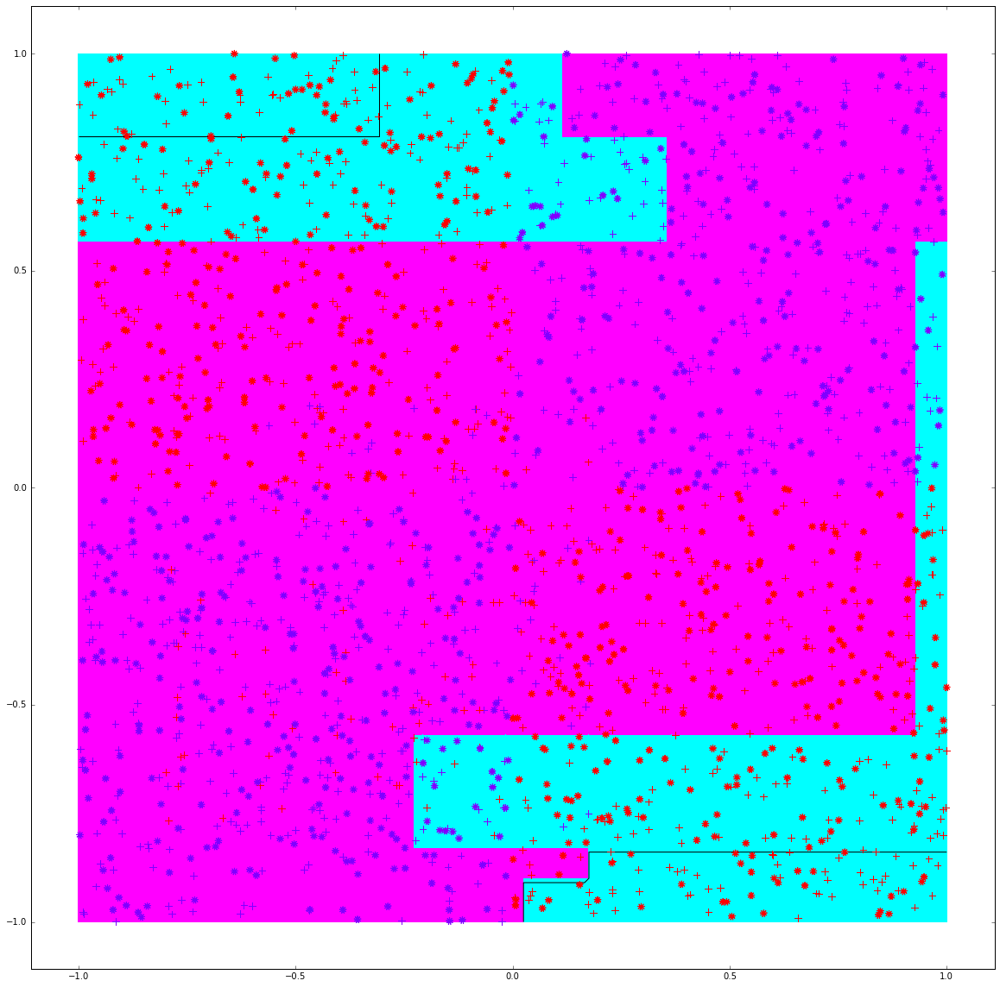



Para n_t:  7
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.855454545455
La precisión con los datos de prueba es:  0.905


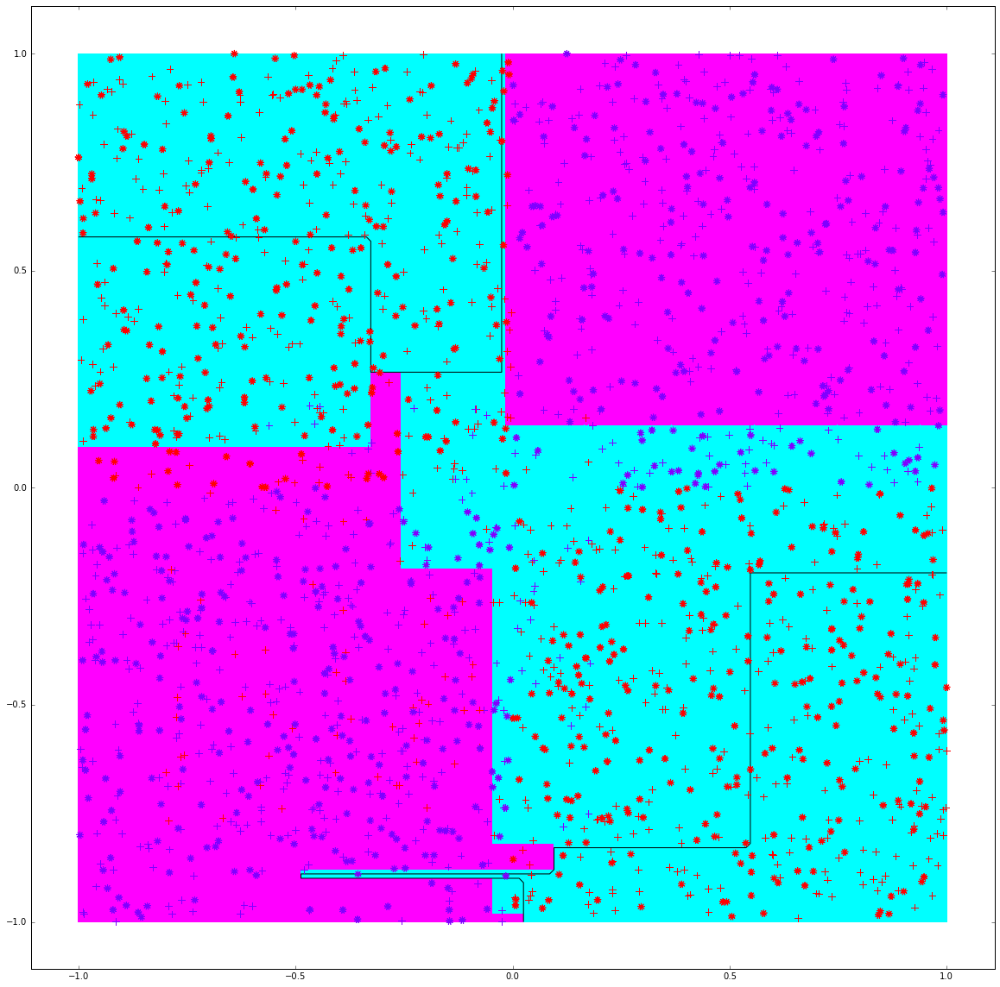



Para n_t:  8
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.802727272727
La precisión con los datos de prueba es:  0.847


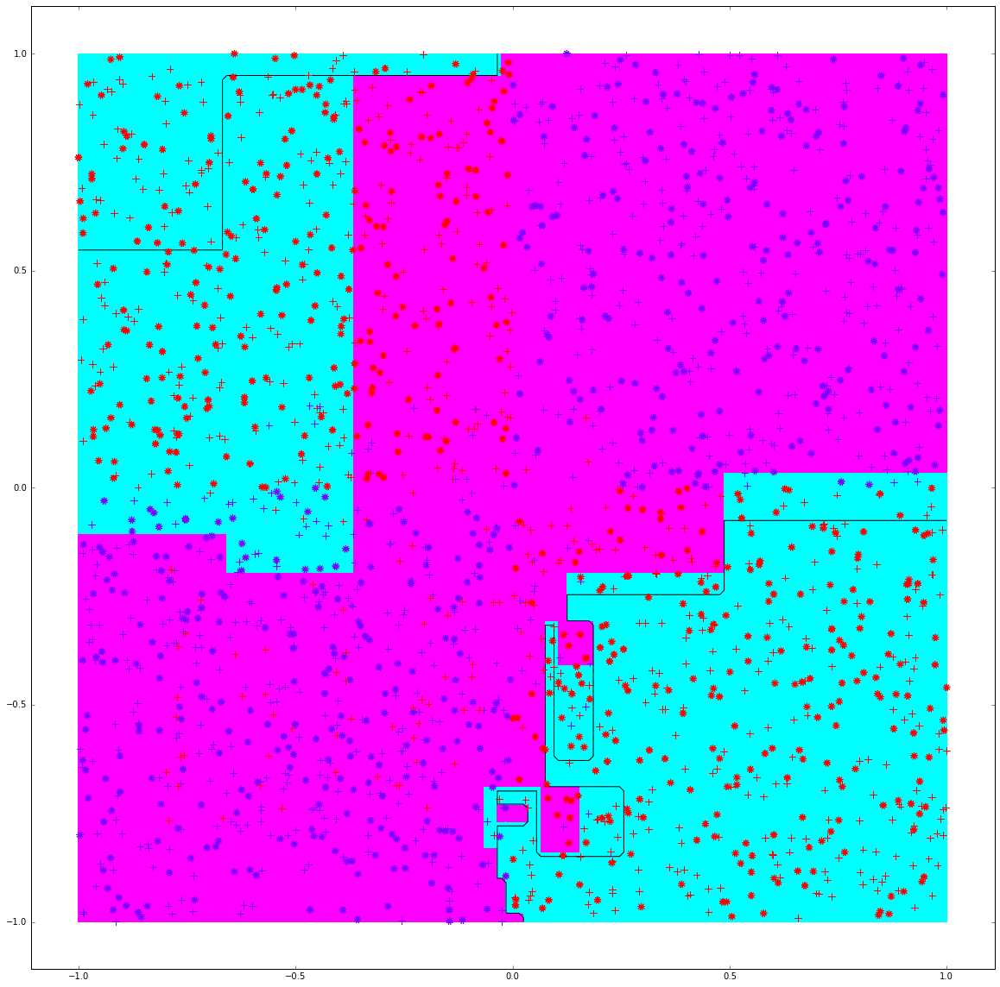



Para n_t:  9
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.880909090909
La precisión con los datos de prueba es:  0.909


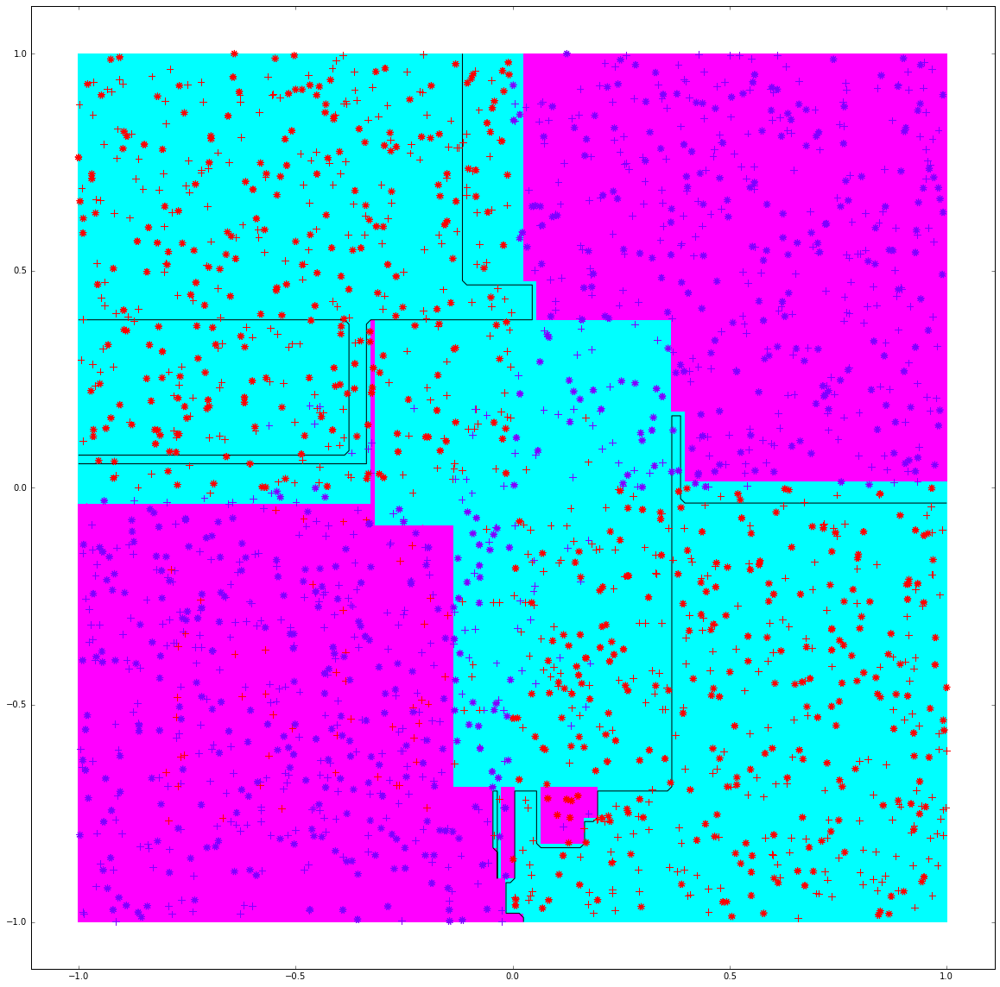



Para n_t:  10
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.902727272727
La precisión con los datos de prueba es:  0.918


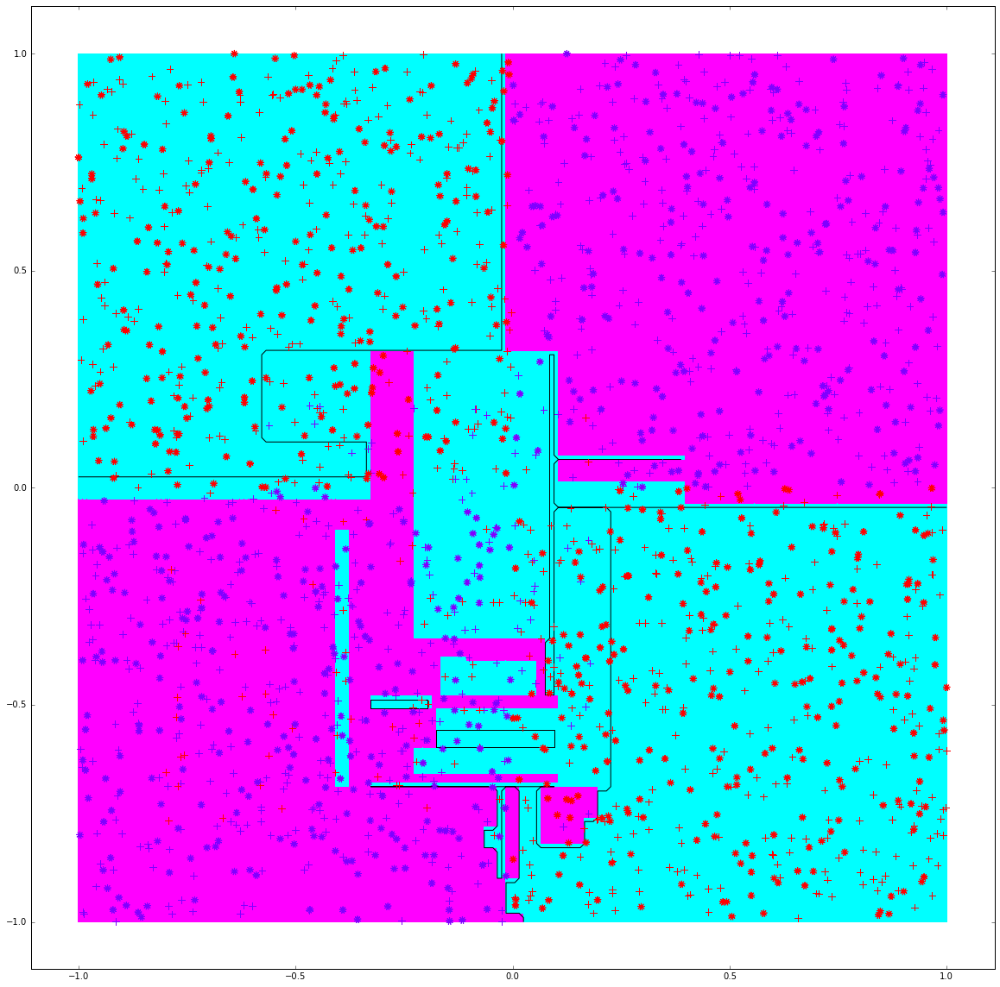



Para n_t:  11
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.881818181818
La precisión con los datos de prueba es:  0.884


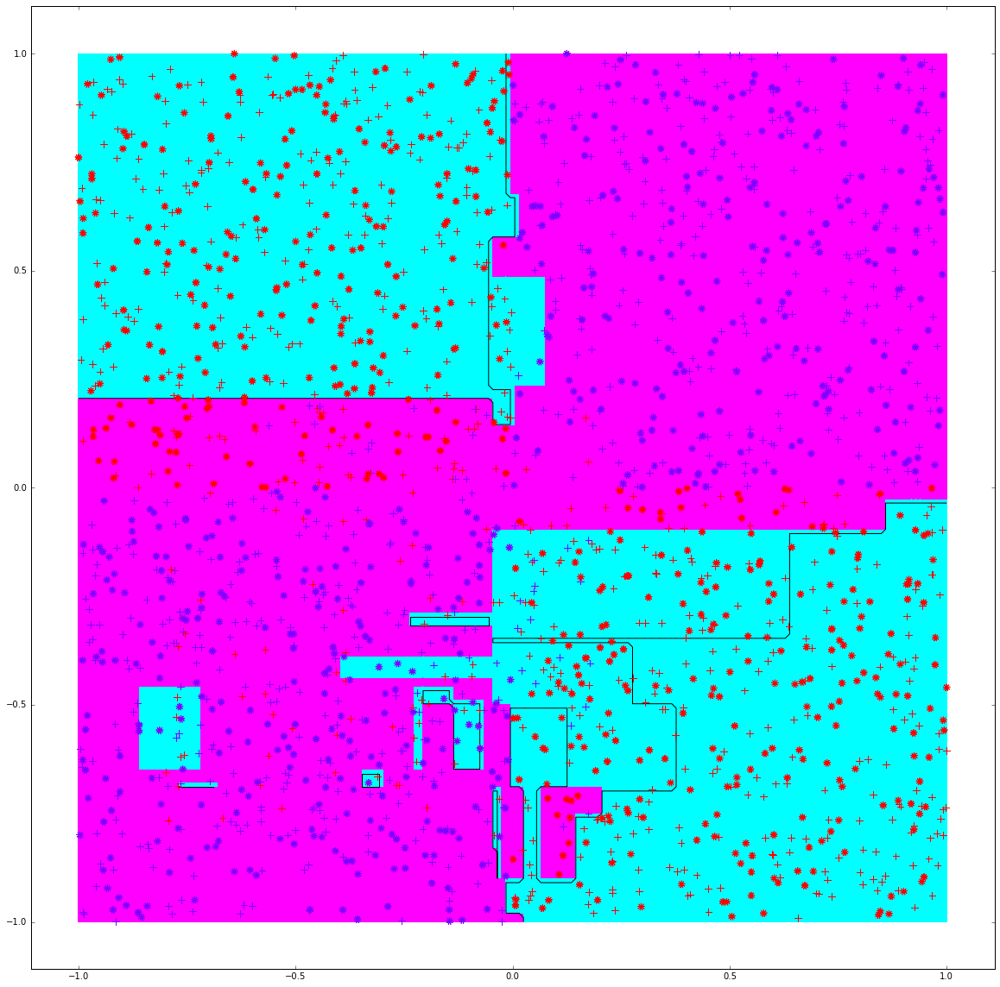



Para n_t:  12
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.915454545455
La precisión con los datos de prueba es:  0.941


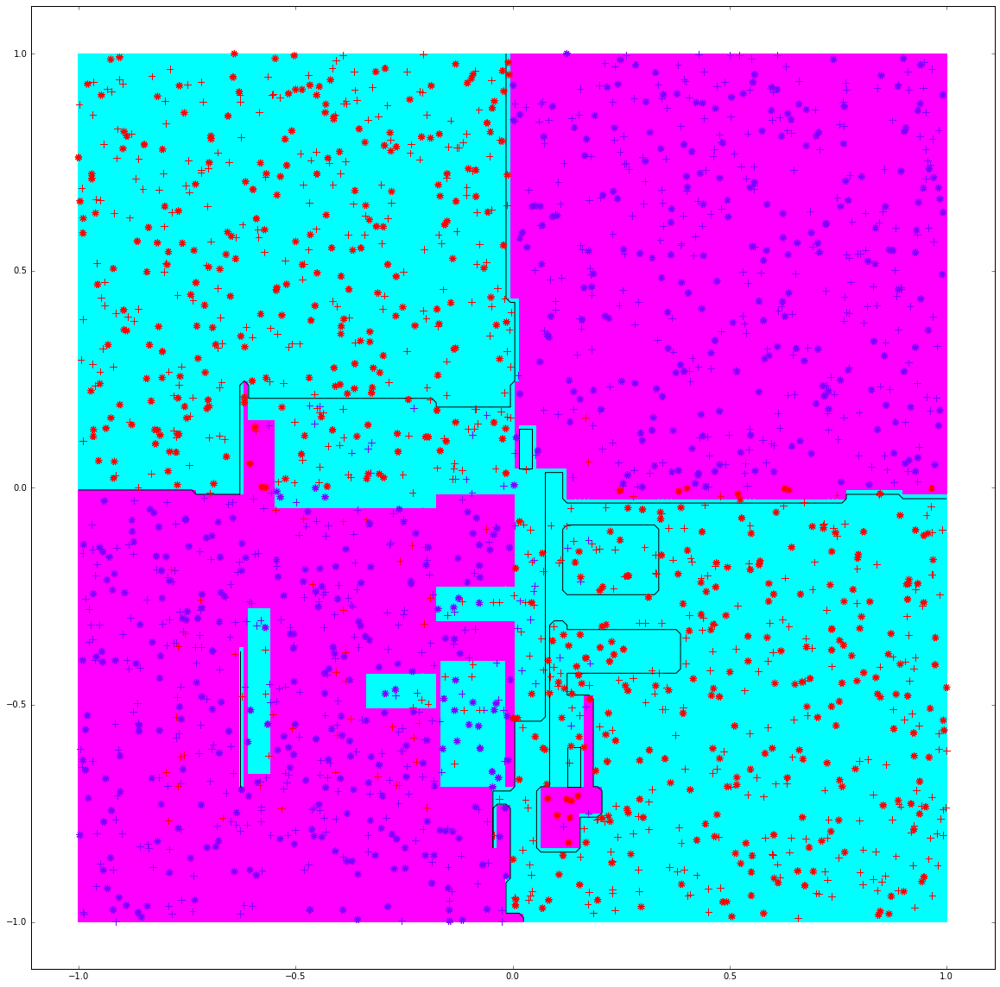



Para n_t:  13
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.935454545455
La precisión con los datos de prueba es:  0.927


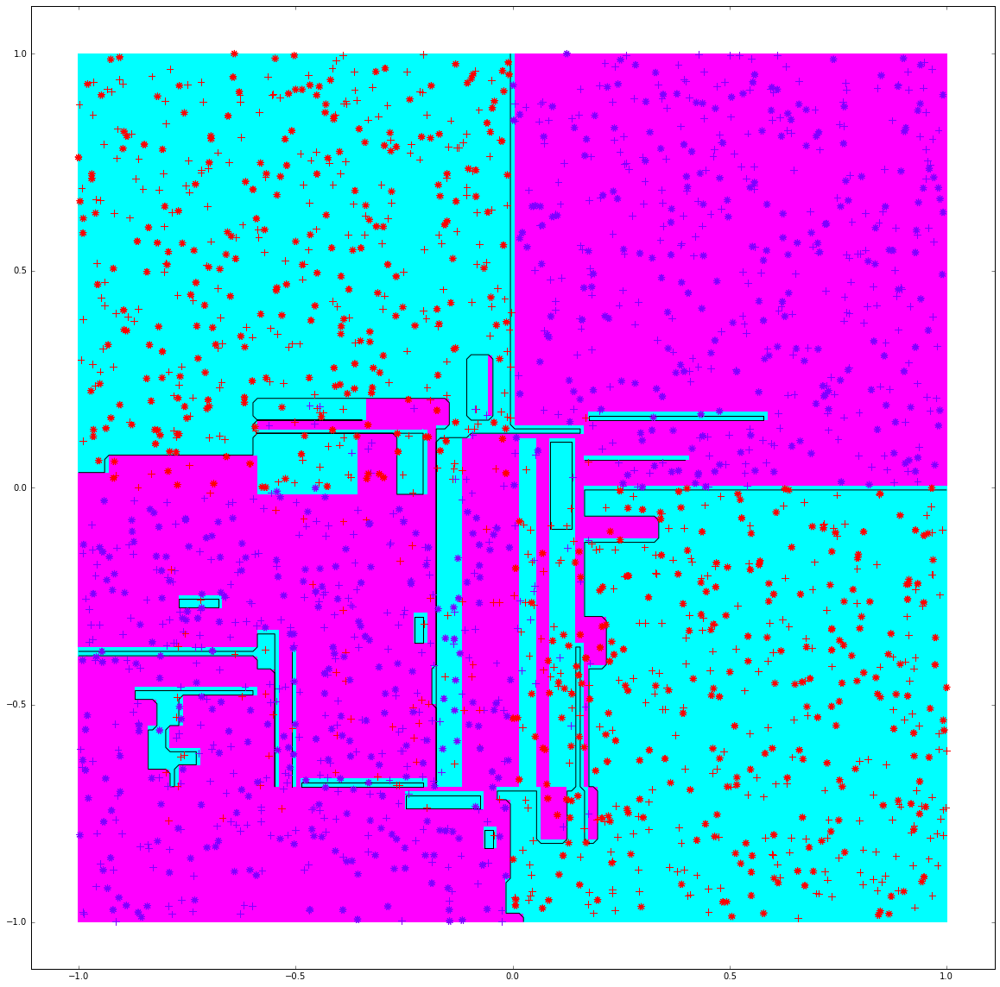



Para n_t:  14
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.946363636364
La precisión con los datos de prueba es:  0.94


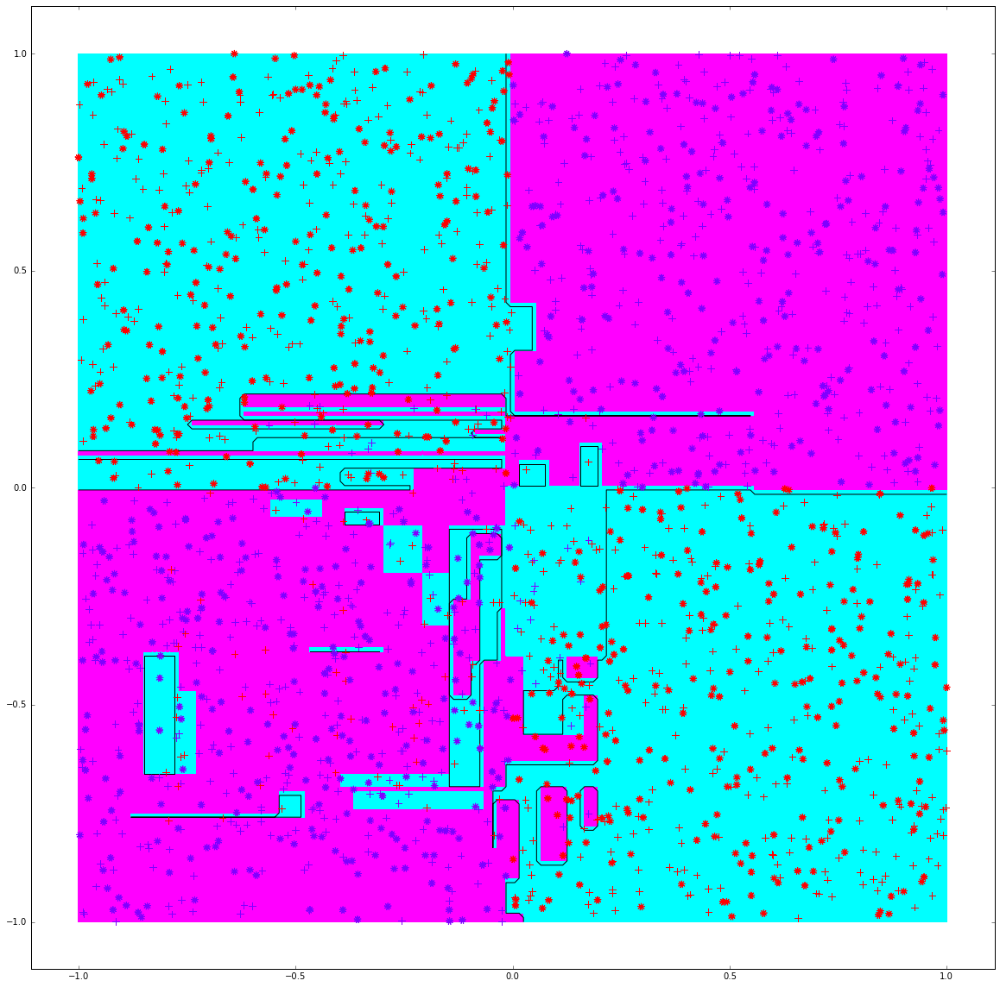



Para n_t:  15
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.940909090909
La precisión con los datos de prueba es:  0.946


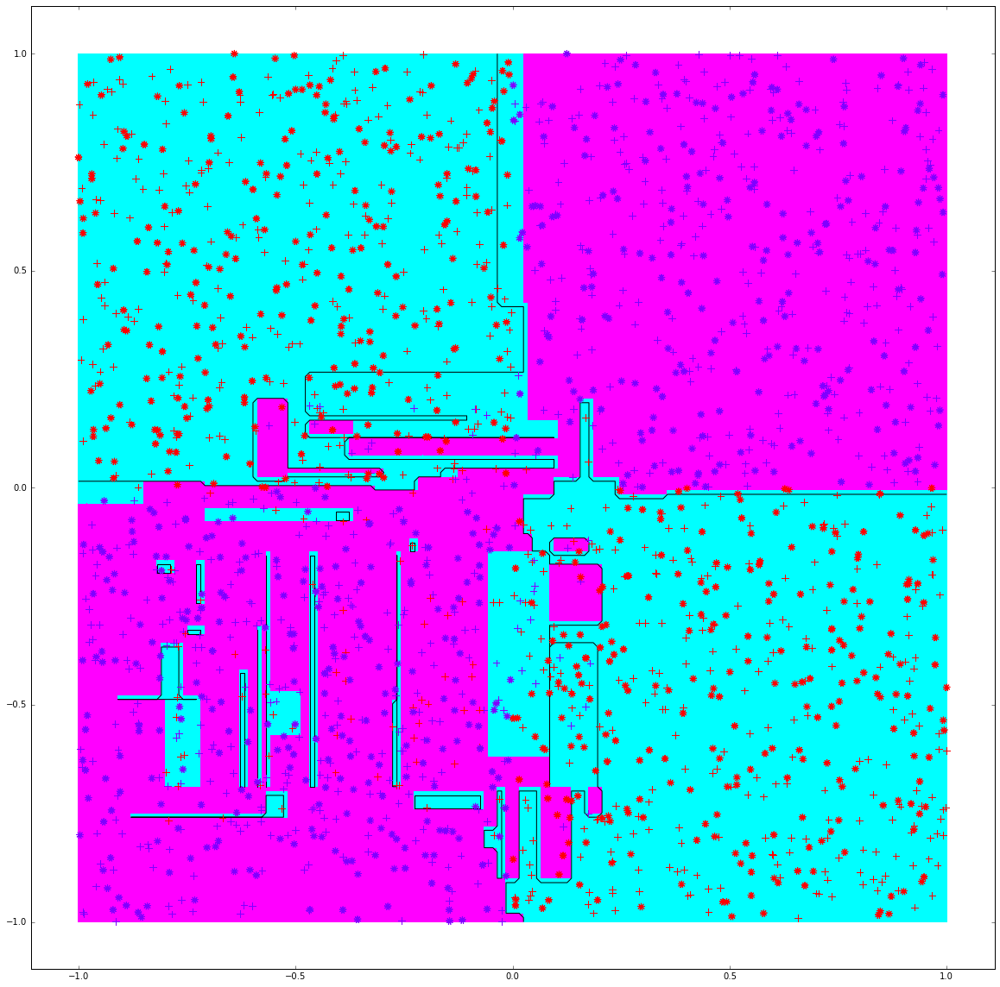



Para n_t:  16
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.942727272727
La precisión con los datos de prueba es:  0.931


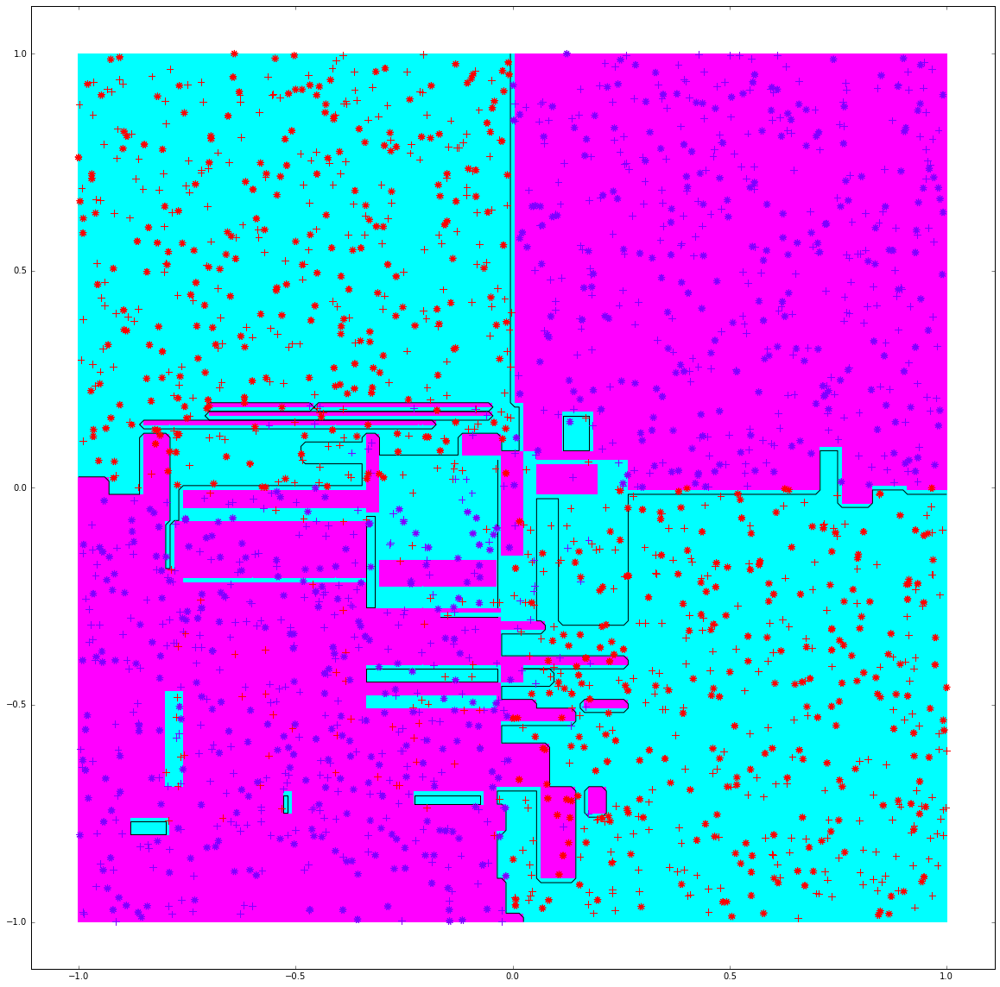



Para n_t:  17
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.958181818182
La precisión con los datos de prueba es:  0.917


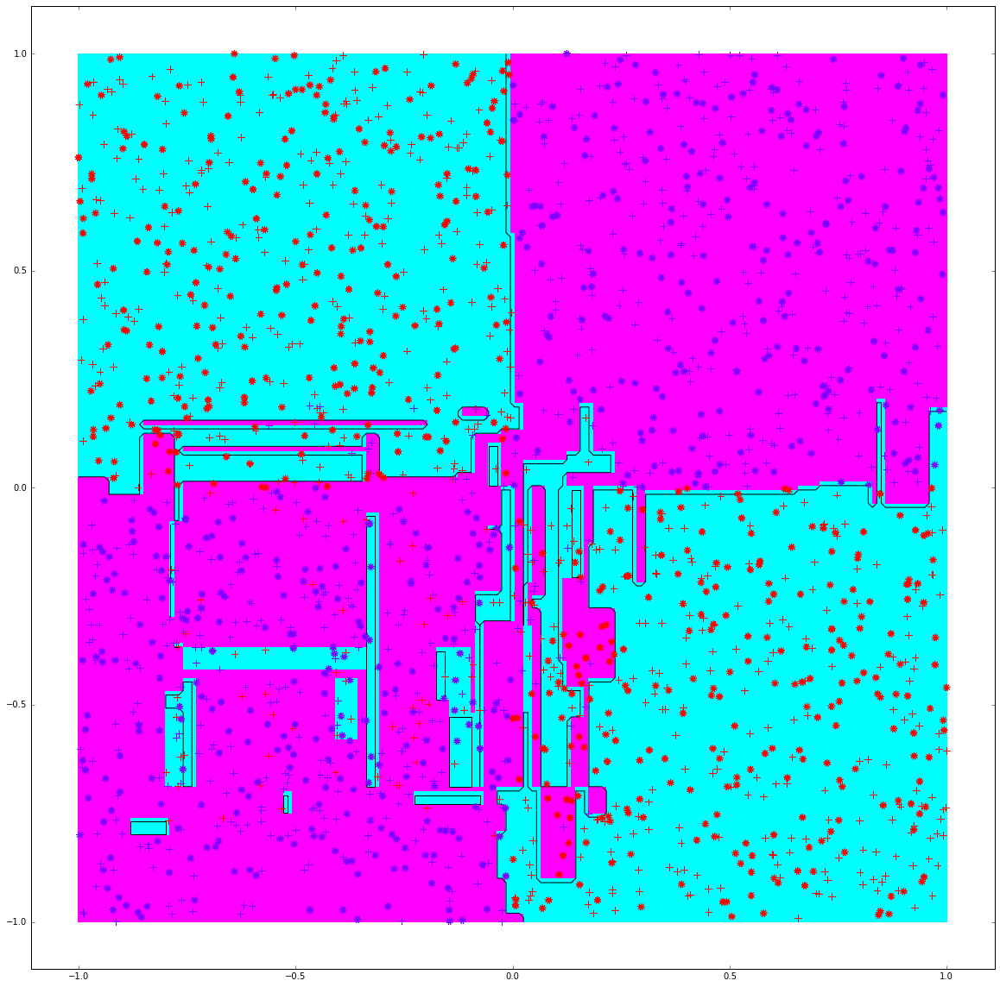



Para n_t:  18
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.975454545455
La precisión con los datos de prueba es:  0.911


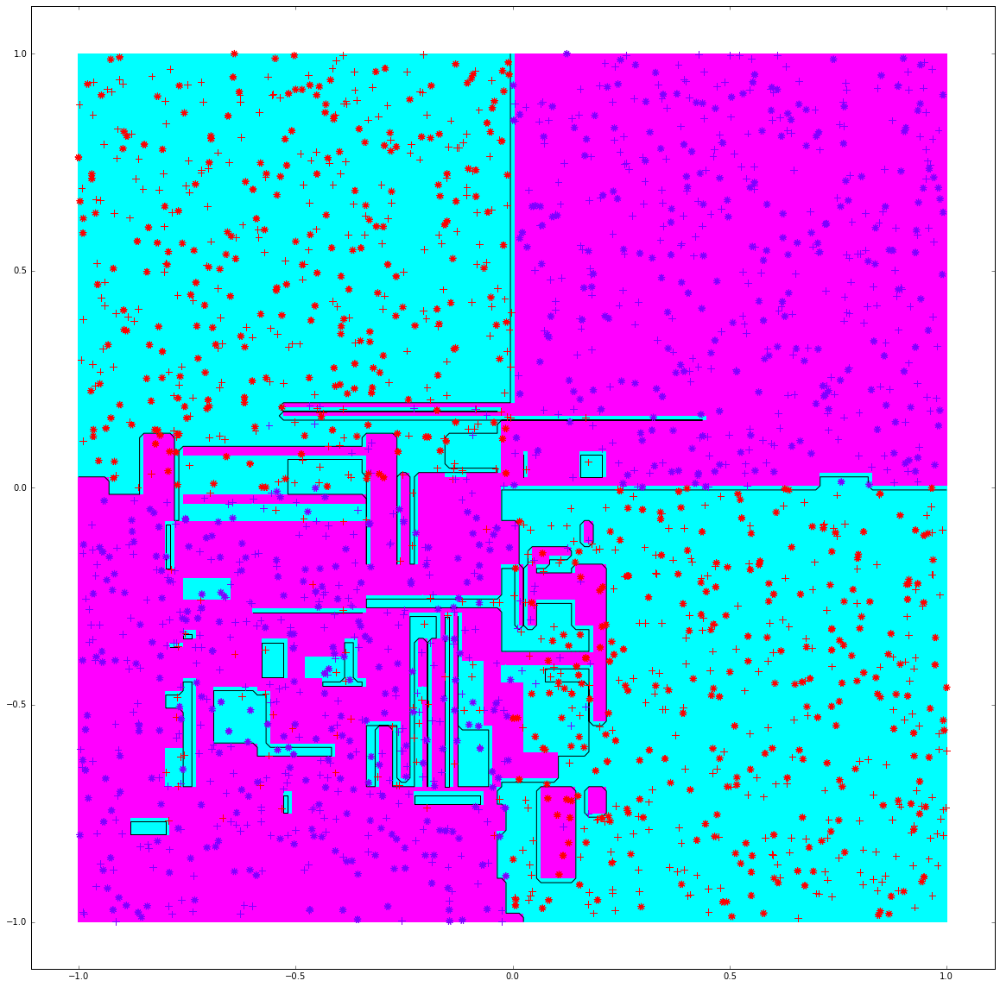



Para n_t:  19
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.985454545455
La precisión con los datos de prueba es:  0.909


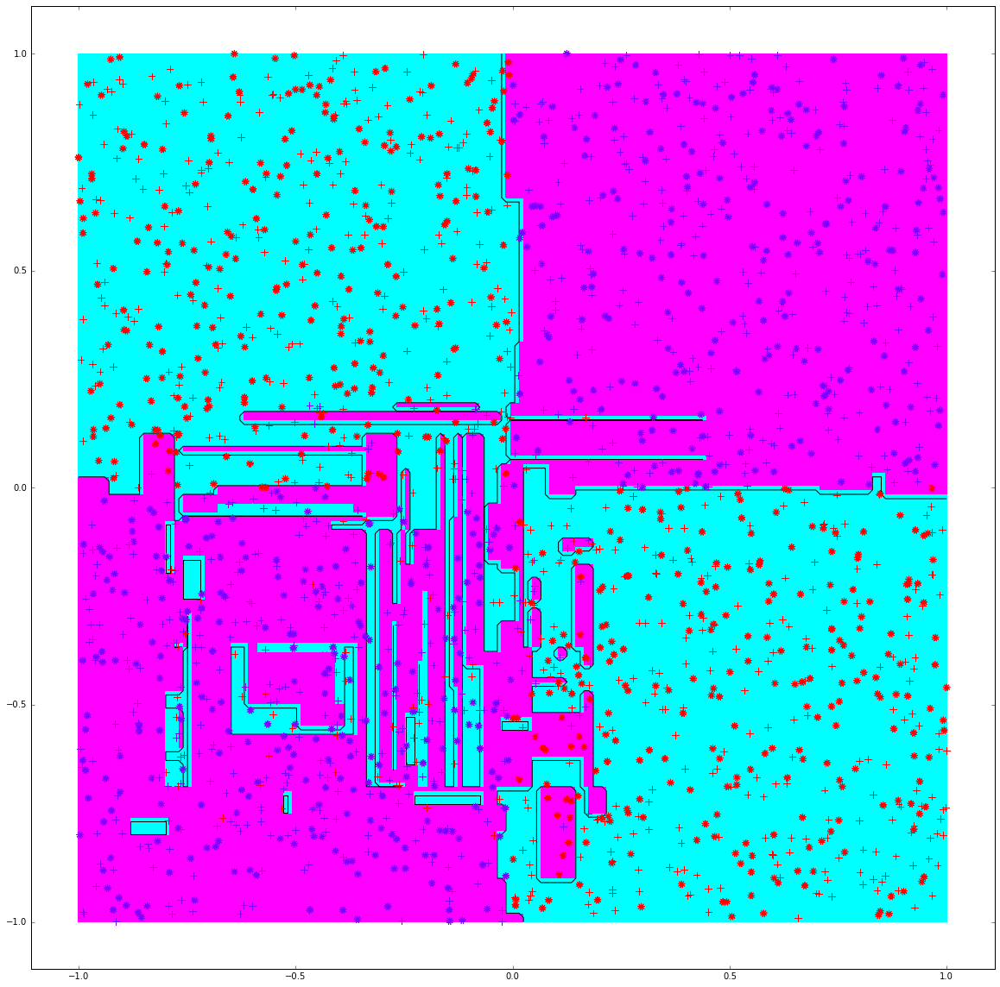



Para n_t:  20
Utilizando criterio Entropy y partición Random
La precisión con los datos de entrenamiento es:  0.989090909091
La precisión con los datos de prueba es:  0.906


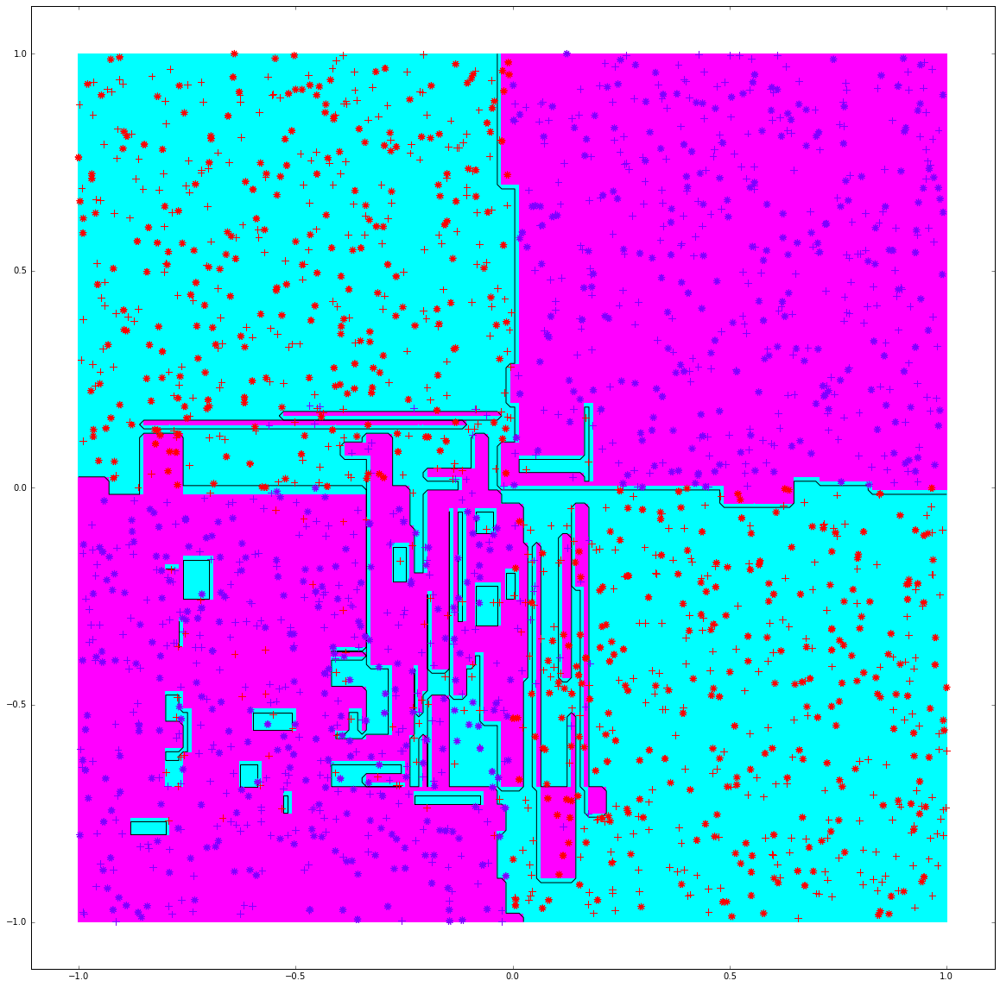

In [25]:
# 4. Precisiones datos de entrenamiento y datos de prueba utilizando árbol con criterio Entropy y partición Random

errores_entrenamiento_entropy_random=[]
errores_prueba_entropy_random=[]
for n_t in range (2,21):
    clf=Tree(criterion='entropy',splitter='random',random_state=0,max_depth=n_t)
    clf.fit(X_train,Y_train)
    precision_entrenamiento=clf.score(X_train, Y_train)
    eeer=1-precision_entrenamiento #tomando error de precisión de datos de entrenamiento
    errores_entrenamiento_entropy_random.append(eeer) #agregando a la lista de errores obtenidos
    
    precision_prueba=clf.score(X_test, Y_test)
    eper=1-precision_prueba #tomando error de precisión de datos de prueba
    errores_prueba_entropy_random.append(eper) #agregando a la lista de errores obtenidos
    
    print "Para n_t: ", n_t
    print "Utilizando criterio Entropy y partición Random"
    print "La precisión con los datos de entrenamiento es: ", precision_entrenamiento
    print "La precisión con los datos de prueba es: ", precision_prueba
    #print clf.tree_.max_depth
    plot_classifier(clf,X_train,Y_train,X_test,Y_test,'tree')
    print "\n"

Para las 4 variables de árboles de clasificación de múltiples niveles, se puede apreciar que a partir de los 8 niveles (n_h=8) es donde se obtienen las mejores accuracy o precisiones de datos, tanto para los de entrenamiento como para los de prueba. Por consiguiente para estos niveles será posible resolver este problema XOR.

Se puede ver mejor esto graficando los errores de entrenamiento y de prueba para las 4 variables de los árboles:

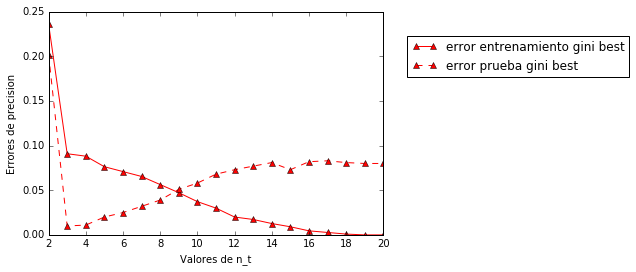

In [29]:
#Errores para criterio Gini y partición Best
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_entrenamiento_gini_best, 'r^-', label='error entrenamiento gini best')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_prueba_gini_best, 'r^--', label='error prueba gini best')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_t')
plt.ylabel('Errores de precision')
plt.show()

Acá se puede apreciar que los errores disminuyen para los datos de entrenamiento y van aumentando de manera progresiva para los datos de prueba, aún así estos errores no son mayores al 10%.

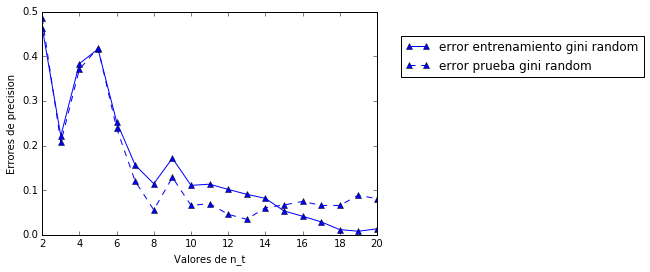

In [28]:
#Errores para criterio Gini y partición Random
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_entrenamiento_gini_random, 'b^-', label='error entrenamiento gini random')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_prueba_gini_random, 'b^--', label='error prueba gini random')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_t')
plt.ylabel('Errores de precision')
plt.show()

Para este gráfico los errores siguen siendo bastante bajos, aunque la direrencia entre los errores es menor en comparación al gráfico anterior.

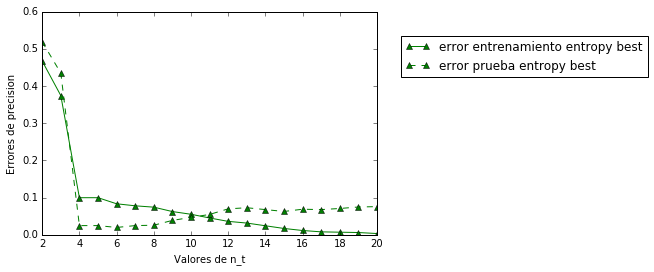

In [32]:
#Errores para criterio Entropy y partición Best
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_entrenamiento_entropy_best, 'g^-', label='error entrenamiento entropy best')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_prueba_entropy_best, 'g^--', label='error prueba entropy best')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_t')
plt.ylabel('Errores de precision')
plt.show()

Al igual que con el primer gráfico de errores "gini-best" aquí se aprecia aumentando los valores de n_t un aumento de los errores de prueba y una disminución de los errores de entrenamiento. En sí el gráfico es idéntico al primero, por la influencia que aplica la partición best a los datos en general.

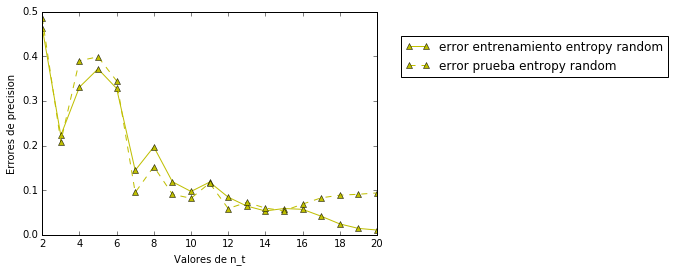

In [26]:
#Errores para criterio Entropy y partición Random
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_entrenamiento_entropy_random, 'y^-', label='error entrenamiento entropy random')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_prueba_entropy_random, 'y^--', label='error prueba entropy random')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_t')
plt.ylabel('Errores de precision')
plt.show()

Análogamente con el gráfico de errores "gini-random", para este gráfico los errores van disminuyendo progresivamente a medida que aumentan la cantidad de niveles.

El gráfico que muestra todas las variantes de los árboles sería el siguiente:

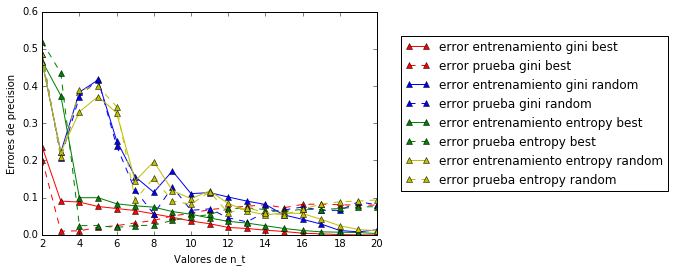

In [33]:
#Los errores adjuntados
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_entrenamiento_gini_best, 'r^-', label='error entrenamiento gini best')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_prueba_gini_best, 'r^--', label='error prueba gini best')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_entrenamiento_gini_random, 'b^-', label='error entrenamiento gini random')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_prueba_gini_random, 'b^--', label='error prueba gini random')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_entrenamiento_entropy_best, 'g^-', label='error entrenamiento entropy best')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_prueba_entropy_best, 'g^--', label='error prueba entropy best')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_entrenamiento_entropy_random, 'y^-', label='error entrenamiento entropy random')
plt.plot([2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20], errores_prueba_entropy_random, 'y^--', label='error prueba entropy random')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=2)
plt.xlabel('Valores de n_t')
plt.ylabel('Errores de precision')
plt.show()

Con esto queda demostrado que los árboles de clasificación múltiples resuelven el problema XOR de manera concreta y satisfactoria.